In [1]:
import numpy as np
###list of data files
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import time
import math
from itertools import groupby
from operator import itemgetter
import more_itertools as mit
import time
from numpy import array
from numpy.random import rand
import datetime

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\.libs\libopenblas.IPBC74C7KURV7CB2PKT5Z5FNR3SIBV4J.gfortran-win_amd64.dll
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\.libs\libopenblas.NOIJJG62EMASZI6NYURL6JBKM4EVBGM7.gfortran-win_amd64.dll
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\.libs\libopenblas.PYQHXLVVQ7VESDPUVUADXEVJOBGHJPAY.gfortran-win_amd64.dll
  stacklevel=1)


In [2]:
def transfer_to_list_of_pd(clusters_list):
    clusters_data_list = []
    for i in clusters_list:
        temp_data = pd.DataFrame(i, columns =['SecurityID', 'Sector', 'Industry','Sub_Industry','Seniority','Issuedby','Country','Rating','AmountIssued','Coupon','IssueDate','MaturityDate'])
        clusters_data_list.append(temp_data)
    return clusters_data_list

In [3]:
def assign_rating(x):
    x = float(x)
    if x < 0:
        return 'NR'
    elif x >0 and x<=0.5:
        return 'D'
    elif x > 0.5 and x<=1.5:
        return 'C'
    elif x > 1.5 and x<=2.5:
        return 'CC-'
    elif x > 2.5 and x<=3.5:
        return 'CC'
    elif x >3.5 and x<=4.5:
        return 'CC+'
    elif x >4.5 and x <=5.5:
        return 'CCC-'
    elif x >5.5 and x <=6.5:
        return 'CCC'
    elif x >6.5 and x<=7.5:
        return 'CCC+'
    elif x >7.5 and x <= 8.5:
        return 'B-'
    elif x>8.5 and x <=9.5:
        return 'B'
    elif x> 9.5 and x <= 10.5:
        return 'B+'
    elif x >10.5 and x<=11.5:
        return 'BB-'
    elif x > 11.5 and x<=12.5:
        return 'BB'
    elif x >12.5 and x<=13.5:
        return 'BB+'
    elif x>13.5 and x <=14.5:
        return 'BBB-'
    elif x>14.5 and x<=15.5:
        return 'BBB'
    elif x>15.5 and x<=16.5:
        return 'BBB+'
    elif x>16.5 and x<=17.5:
        return 'A-'
    elif x > 17.5 and x<=18.5:
        return 'A'
    elif x >18.5 and x<=19.5:
        return 'A+'
    elif x>19.5 and x<=20.5:
        return 'AA-'
    elif x >20.5 and x<=21.5:
        return 'AA'
    elif x>21.5 and x<=22.5:
        return 'AA+'
    else:
        return 'AAA'

In [4]:
def process_rating_data(data):
    #data = data[data['KeyDate']<=end_date]
    rating = data.groupby('SecurityID',as_index=False).mean()
    rating['RatingSP'] = rating['RatingSP'].apply(lambda x:assign_rating(x))
    return rating

In [5]:
def grab_clusters(clusters,bond_spread_list,security_data,rating_data):
    temp_list = []
    for cluster in clusters:
        temp_list2 = []
        for bond_index in cluster:
            bond_id = bond_spread_list[bond_index][1]
            bond_Sector = security_data[security_data['SecurityID']==bond_id].SecuritySector.iloc[0]
            bond_Industry = security_data[security_data['SecurityID'] == bond_id].SecurityIndustry.iloc[0]
            bond_sub_Industry = security_data[security_data['SecurityID'] == bond_id].SecuritySubIndustry.iloc[0]
            bond_Seniority = security_data[security_data['SecurityID'] == bond_id].Seniority.iloc[0]
            bond_Issuer =security_data[security_data['SecurityID'] == bond_id].Issuer.iloc[0]
            bond_countryrisk =security_data[security_data['SecurityID'] == bond_id].CountryRisk.iloc[0]
            bond_amountIssued =security_data[security_data['SecurityID'] == bond_id].AmountIssued.iloc[0]
            bond_coupon =security_data[security_data['SecurityID'] == bond_id].Coupon.iloc[0]
            bond_MaturityDate =security_data[security_data['SecurityID'] == bond_id].MaturityDate.iloc[0]
            bond_issuedate =security_data[security_data['SecurityID'] == bond_id].IssueDate.iloc[0][:4]
            try:
                bond_rating=rating_data[rating_data['SecurityID'] == bond_id].RatingSP.iloc[0]
            except:
                bond_rating = 'Not Founded'
            temp_tuple = (bond_id,bond_Sector,bond_Industry,bond_sub_Industry,bond_Seniority,bond_Issuer,bond_countryrisk,bond_rating,bond_amountIssued,bond_coupon,bond_issuedate,bond_MaturityDate)
            temp_list2.append(temp_tuple)
        temp_list.append(temp_list2)
    return temp_list

In [6]:
def merge_left_right(data1,data2):
    temp_data = data1.append(data2)
    return temp_data

def merg_sort(list_data):
    list_length = len(list_data)
    if list_length == 1:
        output = list_data[0][2]
        return output
    else:
        mid_point = math.floor(list_length/2)
        #print(len(list_data[:mid_point]))
        left = list_data[mid_point:]
        right = list_data[:mid_point]
        return merge_left_right(merg_sort(left), merg_sort(right))

In [7]:
def sliding_windows(data,period_of_time,start_date):
    #transfer start_date to datetime()
    time_list = start_date.split('-')
    year = int(time_list[0])
    month = int(time_list[1])
    date = int(time_list[2])
    start_datetime = datetime.datetime(year, month, date)
    data['KeyDate'] = pd.to_datetime(data['KeyDate'])
    data['MaturityDate'] = pd.to_datetime(data['MaturityDate'])
    data['IssueDate'] = pd.to_datetime(data['IssueDate'])
    ###find the end date:
    end_datetime = start_datetime + datetime.timedelta(days=period_of_time)
    end_date = str(end_datetime.date())
    #####select data before the end_date
    data = data[data['KeyDate'] <= end_date]
    data = data[data['IssueDate'] <= start_datetime]
    data = data[data['MaturityDate'] >= end_date]
    return data

In [8]:
def apply_fill(data_list,index):
    for i in data_list:
        try:
            fill_the_GSpeard(i)
        except:
            index.append(i)
    return index,data_list

In [9]:
def merge_data(lists,initial_data):
    data = initial_data
    for file in lists:
        path = 'C:\\Users\\y437l\\OneDrive\\MMAI\\Capstone\\Data\\{}'.format(file)
        temp_data = pd.read_csv(path)
        print(len(temp_data))
        data = data.append(temp_data)
        print(len(data))
    return data

In [10]:
start_time = time.time()
security_data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
security_data =security_data[['SecurityID','Currency','IssueDate','MaturityDate']]
### merge spread data togther
sc = MinMaxScaler()
data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/1.csv")
file_lists = ['14426.csv','24001.csv','36128.csv','48087.csv','55086.csv']
final_data = merge_data(file_lists,data)
#final_data = data
###left join the currency data into the spread data
final_data = final_data.merge(security_data, on=['SecurityID'], how='left')
final_data.dropna(subset=["ZSpread"],inplace=True)
###select currency as USD
final_data_1 = final_data[final_data.Currency == 'USD']
final_data = final_data_1.groupby('SecurityID')
###create a list of bond with data
bonds_list = [final_data.get_group(x) for x in final_data.groups]

1054948
2103331
961878
3065209
1074473
4139682
869630
5009312
584171
5593483


In [11]:
final_data2 = merge_data(file_lists,data)

1054948
2103331
961878
3065209
1074473
4139682
869630
5009312
584171
5593483


In [12]:
final_data2[(final_data2.SecurityID == 39321)&(final_data2.GSpread < 0)]

,SecurityID,KeyDate,Price,YieldWorst,ModifiedDuration_Plain,WorkoutDate,AmtOutstanding,GSpread,OAS_Spread,ZSpread,AswUsd
106678,39321,2019-01-30 00:00:00,100.193,1.137320,1.85537,2021-02-15 00:00:00,300000000.0,-137.110000,-141.688,-179.772,-151.431
106679,39321,2019-01-31 00:00:00,100.320,-4.181400,1.84828,2021-02-15 00:00:00,300000000.0,-663.510000,-682.297,-721.877,-707.487
106680,39321,2019-02-01 00:00:00,100.266,-3.306180,1.84538,2021-02-15 00:00:00,300000000.0,-580.940000,-592.094,-631.384,-614.874
106681,39321,2019-02-04 00:00:00,100.142,0.432267,1.84209,2021-02-15 00:00:00,300000000.0,-210.270000,-210.429,-255.966,-224.229
106682,39321,2019-02-05 00:00:00,100.122,0.639026,1.83937,2021-02-15 00:00:00,300000000.0,-188.130000,-187.995,-232.031,-202.849
...,...,...,...,...,...,...,...,...,...,...,...
106910,39321,2020-01-03 00:00:00,100.083,-22.040200,1.04246,2021-02-15 00:00:00,151831000.0,-2354.092142,-2534.880,-2445.570,-2568.640
106911,39321,2020-01-06 00:00:00,100.098,-26.437700,1.03992,2021-02-15 00:00:00,151831000.0,-2796.075065,-3041.640,-2902.230,-3080.170
106912,39321,2020-01-07 00:00:00,100.125,-34.541200,1.03744,2021-02-15 00:00:00,151831000.0,-3604.575038,-4011.470,-3713.860,-4062.220
106913,39321,2020-01-08 00:00:00,100.094,-25.304900,1.03468,2021-02-15 00:00:00,151831000.0,-2683.392015,-673.805,-3194.290,-1097.140


In [13]:
security_data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
security_data[security_data.SecurityID == 39321]

,SecurityID,OfficialName,SecurityType,SecuritySubType,SecurityBBGType,SecurityBBGYellowKey,Series,SecuritySector,SecurityIndustry,SecuritySubIndustry,...,Seniority,PaymentRank,IsBailIn,QuoteSize,AmountIssued,MinIncrement,MinPiece,BBGDescription,CallSchedule,AdditionalData
15287,39321,CACC 6.125 02/15/21,Bond,Bond,GLOBAL,Corp,NaN,Financials,Consumer Finance,Finance-Auto Loans,...,Sr Unsecured,Sr Unsecured,N,100,300000000.0,1000.0,2000.0,NaN,"[[2017-02-15T00:00:00""",103.063]


In [14]:
def fill_the_GSpeard(data):
    ##calucate the spread between gspread and z spread if the gspread is not 0.
    data['Spread_G_Z'] = data.GSpread - data.ZSpread
    ###find the nan data's index in the data:
    index_with_indicator = data.GSpread.isna()
    index_with_indicator = index_with_indicator.tolist()
    index_list = []
    for indx in range(0,len(index_with_indicator)):
        if index_with_indicator[indx] == True:
            index_list.append(indx)
    #print(index_list)
    ##find concustive missing value:
    ##example:[(22, 39), 303, (326, 343), 607]
    star_end_dates = find_ranges(index_list)
    missing_date_dict={}
    for periods in star_end_dates:
        if type(periods) !=tuple:
            missing_date_dict[str(periods)] = spread_slope(data,periods)
            value = data.Spread_G_Z.iloc[periods-1]+missing_date_dict[str(periods)][3]
            print(value)
            data.GSpread.iloc[periods] = data.ZSpread.iloc[periods]+value
            print(data.GSpread.iloc[periods])
        else:
            missing_date_dict['{}-{}'.format(periods[0],periods[1])] = spread_slope(data, periods)
            star = missing_date_dict['{}-{}'.format(periods[0],periods[1])][0]
            end = missing_date_dict['{}-{}'.format(periods[0],periods[1])][1]
            slope = missing_date_dict['{}-{}'.format(periods[0],periods[1])][3]
            for days in range(star+1,end):
                value = data.Spread_G_Z.iloc[star] + (days-star)*slope
                data.GSpread.iloc[days] = data.ZSpread.iloc[days]+value
    print(missing_date_dict)
    #if missing_date_dict['{}-{}'.format(periods[0],periods[1])][3] >=1:
        #print(missing_date_dict)
        #print("Warning {}".format(data.SecurityID.iloc[0]))
    return data

In [15]:
def find_ranges(iterable):
    """Yield range of consecutive numbers."""
    for group in mit.consecutive_groups(iterable):
        group = list(group)
        if len(group) == 1:
            yield group[0]
        else:
            yield group[0], group[-1]

In [16]:
def spread_slope(data,input):
    if type(input) != tuple:
        star = input-1
        end = input+1
    else:
        star = input[0] - 1
        end = input[1] + 1
    if end == len(data):
        slope = data.Spread_G_Z.iloc[star]
        end = 'None'
        gap = 1
    else:
        print(input)
        star_point = data.Spread_G_Z.iloc[star]
        print(star_point)
        end_point = data.Spread_G_Z.iloc[end]
        print(end_point)
        gap = (end-star)
        print(gap)
        slope = (end_point - star_point) / gap
        print(slope)
    return (star, end, gap,slope)

In [17]:
def select_data(num,listoftuble):
    temp_list = []
    for i in listoftuble:
        if i[0] == num:
            temp_list.append(i)
    return temp_list

## Select the data with only spread percentage change.
def select_spread_data(listoftuble):
    temp_list = []
    for i in listoftuble:
        temp_list.append(i[2])
    return temp_list

In [18]:
problemtic_data_index =[]
problem_data_index,bonds_list = apply_fill(bonds_list,problemtic_data_index)
print("--- %s seconds ---" % (time.time() - start_time),'Next Step:Percentage Changed')

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a 

{}
{}
{}
{}
{}
{}
{}
276
26.775600999999995
-0.94667400000003
2
-13.861137500000012
12.914463499999982
271.48346349999997
{'276': (275, 277, 2, -13.861137500000012)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
41.79283500000008
59.27663600000005
2
8.741900499999986
50.53473550000007
-2845.6052645
{'276': (275, 277, 2, 8.741900499999986)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
112.42378400000052
190.6316340000003
2
39.10392499999989
151.5277090000004
-4344.442290999999
{'255': (254, 256, 2, 39.10392499999989)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(130, 134)
-26.62099999999998
-26.424000000000035


c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
197
-15.799000000000007
-13.453694000000013
2
1.1726529999999968
-14.62634700000001
164.95465299999998
{'197': (196, 198, 2, 1.1726529999999968)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(130, 134)
0.8833000000000055
3.5382999999999996
6
0.442499999999999
{'130-134': (129, 135, 6, 0.442499999999999)}
{}
{}
{}
{}
{}
284
2.9038739999999734
0.39657999999997173
2
-1.2536470000000008
1.6502269999999726
477.463227
{'284': (283, 285, 2, -1.2536470000000008)}
252
-1.7686459999999329
-3.2033139999999776
2
-0.7173340000000223
-2.4859799999999552
487.58601999999996
{'252': (251, 253, 2, -0.7173340000000223)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(282, 283)
18.773241999999982
15.24031100000002
3
-1.177643666666654
{'282-283': (281, 284, 3, -1.177643666666654)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-2

{}
{}
{}
{}
(211, 212)
-36.450592
-26.250969000000026
3
3.3998743333333246
{'211-212': (210, 213, 3, 3.3998743333333246)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
281
0.9613340000000221
0.3475789999999961
2
-0.306877500000013
0.6544565000000091
471.95145649999995
{'281': (280, 282, 2, -0.306877500000013)}
213
-0.1840629999999237
-2.353304000000037
2
-1.0846205000000566
-1.2686834999999803
279.8283165
{'213': (212, 214, 2, -1.0846205000000566)}
213
-0.1840630000000374
-2.353304000000037
2
-1.0846204999999998
-1.2686835000000372
277.7893164999999
{'213': (212, 214, 2, -1.0846204999999998)}
213
-3.857031999999947
-6.078806999999983
2
-1.1108875000000182
-4.967919499999965
286.03508050000005
{'213': (212, 214, 2, -1.1108875000000182)}
18
2.3288650000000075
-0.872714999999971
2
-1.6007899999999893
0.7280750000000182
258.47607500000004
26
1.5119509999999536
0.5008850000000393
2
-0.5055329999999572
1.0064179999999965
266.163418
{'18': (17, 19, 2, -1.6007899999999893), '26': (25, 

{}
{}
{}
276
21.60366000000002
18.265393000000017
2
-1.669133500000001
19.93452650000002
288.3765265
{'276': (275, 277, 2, -1.669133500000001)}
276
2.2641570000000684
0.7674049999999397
2
-0.7483760000000643
1.515781000000004
544.980781
{'276': (275, 277, 2, -0.7483760000000643)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
5.730520000000013
4.414855999999929
2
-0.6578320000000417
5.072687999999971
509.13568799999996
{'276': (275, 277, 2, -0.6578320000000417)}
252
1.3021700000000465
1.3232160000000022
2
0.010522999999977856
1.3126930000000243
472.78269300000005
{'252': (251, 253, 2, 0.010522999999977856)}
{}
{}
{}
{}
276
-0.1721679999999992
-7.228772000000049
2
-3.528302000000025
-3.700470000000024
337.90653
(290, 291)
-35.78774200000004
-33.74280399999998
3
0.6816460000000196
{'276': (275, 277, 2, -3.528302000000025), '290-291': (289, 292, 3, 0.6816460000000196)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
104.62528399999974
103.94194700000003
2
-0.34166849999985516
104.28

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(127, 131)
-5.442000000000007
-2.040999999999997
6
0.5668333333333351
{'127-131': (126, 132, 6, 0.5668333333333351)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
286
12.426462999999956
20.98335000000003
2
4.278443500000037
16.704906499999993
371.1899065
{'286': (285, 287, 2, 4.278443500000037)}
{}
{}
{}
{}
{}

{}
{}
{}
{}
{}
{}
{}
{}
290
51.746722999999974
8.398564000000022
2
-21.674079499999976
30.072643499999998
-211.5163565
{'290': (289, 291, 2, -21.674079499999976)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
265
4.562595999999985
1.9709179999999833
2
-1.2958390000000009
3.266756999999984
579.851757
(279, 280)
7.553391000000033
9.127791000000002
3
0.5247999999999896
{'265': (264, 266, 2, -1.2958390000000009), '279-280': (278, 281, 3, 0.5247999999999896)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
204
-2.7732259999999656
-4.397977999999966
2
-0.8123760000000004
-3.585601999999966
329.448398
{'204': (203, 205, 2, -0.8123760000000004)}
{}
{}
{}
{}
{}
{}
{}
{}
273
1.2500199999999921
0.48657099999999787
2
-0.38172449999999714
0.868295499999995
8

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
105.42070500000011
13.656588
2
-45.882058500000056
59.538646500000056
-867.6863535
255
108.44788699999998
13.214649000000009
2
-47.616618999999986
60.831267999999994
-2283.038732
{'252': (251, 253, 2, -45.882058500000056), '255': (254, 256, 2, -47.616618999999986)}
{}
{}
{}
249
-10.518748999999957
-13.062992000000008
2
-1.2721215000000257
-11.790870499999983
535.2831295
257
-8.698603000000048
-10.286857999999995
2
-0.7941274999999735
-9.492730500000022
489.24026949999995
{'249': (248, 250, 2, -1.2721215000000257), '257': (256, 258, 2, -0.7941274999999735)}
{}
{}
253
108.99625300000116
184.65828600000168
2
37.83101650000026
146.82726950000142
-15116.072730499998
274
44.915062999998554
63.11333899999772
2
9.099137999999584
54.01420099999814
-14714.585799000002
(288, 289)
58.33986999999979
321.1644039999992
3
87.6081779999998
{'253': (252, 254, 2, 37.83101650000026), '274': (273, 275, 2, 9.099137999999584), '288-289': (287, 290, 3, 87.6081779999998)

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(0, 78)
3.829095000000052
0.6280380000000605
80
-0.040013212499999895
{'0-78': (-1, 79, 80, -0.040013212499999895)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(194, 228)
-5.128819000000021
6.489395999999999
36
0.322728194444445
(270, 271)
5.889080999999919
9.84087599999998
3
1.3172650000000203
{'194-228': (193, 229, 36, 0.322728194444445), '270-271': (269, 272, 3, 1.3172650000000203)}
{}
{}
{}
284
-3.62318700000003
-3.515083999999945
2
0.05405150000004255
-3.5691354999999874
247.78986450000002
{'284': (283, 285, 2, 0.05405150000004255)}
213
11.026089000000013
7.579079999999976
2
-1.7235045000000184
9.302584499999995
372.7675845
276
-1.1343239999999923
-4.167974000000015
2
-1.5168250000000114
-2.651149000000

{}
{}
{}
{}
{}
(130, 134)
0.7336999999999989
2.6433999999999997
6
0.3182833333333335
{'130-134': (129, 135, 6, 0.3182833333333335)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-35.99999600000001
-22.827714999999955
3
4.390760333333351
{'290-291': (289, 292, 3, 4.390760333333351)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
252
6.617291000000023
2.887898000000007
2
-1.864696500000008
4.752594500000015
290.65759449999996
284
2.0189000000000306
0.07303999999999178
2
-0.9729300000000194
1.0459700000000112
321.09897
(290, 291)
5.877414000000044
8.687934999999982
3
0.9368403333333125
{'252': (251, 253, 2, -1.864696500000008), '284': (283, 285, 2, -0.9729300000000194), '290-291': (289, 292, 3, 0.9368403333333125)}
{}
{}
{}
{}
{}
{}
(289, 290)
6.965151999999989
11.030400999999983
3
1.355082999999998
{'289-290': (288, 291, 3, 1.355082999999998)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}


(44, 63)
6.5948190000000295
6.853769000000057
21
0.012330952380953672
(65, 66)
6.853769000000057
4.798491000000013
3
-0.6850926666666813
{'12-14': (11, 15, 4, -0.8474247499999592), '44-63': (43, 64, 21, 0.012330952380953672), '65-66': (64, 67, 3, -0.6850926666666813)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
371.9470269999997
25.099407000000156
2
-173.42380999999978
198.52321699999993
-1581.196783
{'284': (283, 285, 2, -173.42380999999978)}
{}
{}
249
1.9929220000000214
0.9324740000000133
2
-0.530224000000004
1.4626980000000174
353.584698
278
1.8999689999999987
11.379799999999989
2
4.739915499999995
6.639884499999994
347.4758845
{'249': (248, 250, 2, -0.530224000000004), '278': (277, 279, 2, 4.739915499999995)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(15, 23)
11.760232999999971
13.422856000000024
10
0.16626230000000533
(51, 69)
9.80491900000004
9.175211000000104
20
-0.03

{'201-202': (200, 203, 3, -0.5239296666666368)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
13.89841899999999
65.04338699999994
2
25.572483999999974
39.470902999999964
130.03890299999995
{'276': (275, 277, 2, 25.572483999999974)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
223
-9.379619000000048
-10.194433000000004
2
-0.40740699999997787
-9.787026000000026
597.9669739999999
{'223': (222, 224, 2, -0.40740699999997787)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
249
34.267398000000014
16.98532000000003
2
-8.641038999999992
25.626359000000022
281.036359
{'249': (248, 250, 2, -8.641038999999992)}
274
2.8082679999999414
-0.501246999999978
2
-1.6547574999999597
1.1535104999999817
435.5085105
{'274': (273, 275, 2, -1.6547574999999597)}
{}
{}
{}
273
46.394719
65.04038700000001
2
9.322834000000004
55.71755300000001
-5931.1124469999995
{'273': (272, 274, 2, 9.322834000000004)}
{}
{}
{}
{}
(289, 290)
-37.554306000000054


{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
275
13.366705999999994
58.689302000000225
2
22.661298000000116
36.02800400000011
-4651.911996
(289, 290)
-6.549277000000018
22.898485999999963
3
9.815920999999994
{'275': (274, 276, 2, 22.661298000000116), '289-290': (288, 291, 3, 9.815920999999994)}
255
-4.3206180000000245
2.8690459999999973
2
3.594832000000011
-0.7257860000000136
224.32021399999996
{'255': (254, 256, 2, 3.594832000000011)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
-0.8089240000000473
-2.523871999999983
2
-0.8574739999999679
-1.6663980000000151
452.790602
{'276': (275, 277, 2, -0.8574739999999679)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
19.379365999999976
12.961412999999993
2
-3.2089764999999915
16.170389499999985
189.27538949999996
{'255': (254, 256, 2, -3.2089764999999915)}
{}
{}
{}
{}
{}
{}
{}
{}
276
1.8487089999999853
-0.9944150000000036
2
-1.4215619999999944
0.427146

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
-12.704859999999996
-13.528943999999967
2
-0.41204199999998536
-13.116901999999982
376.299098
{'255': (254, 256, 2, -0.41204199999998536)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
-26.895366999999993
-30.101832
2
-1.6032325000000043
-28.498599499999997
134.7384005
{'276': (275, 277, 2, -1.6032325000000043)}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-28.65445299999999
-13.194516000000021
3
5.153312333333322
{'290-291': (289, 292, 3, 5.153312333333322)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(234, 279)
-7.1219619999999395
-4.6

{}
284
-3.251360000000034
-4.252518000000009
2
-0.5005789999999877
-3.7519390000000215
414.64506099999994
{'284': (283, 285, 2, -0.5005789999999877)}
{}
213
1.107592000000011
-0.2611220000000003
2
-0.6843570000000057
0.42323500000000536
433.09823500000005
{'213': (212, 214, 2, -0.6843570000000057)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
198
0.24985700000001998
-1.0851169999999684
2
-0.6674869999999942
-0.4176299999999742
479.52837000000005
261
2.074534999999969
-0.8908410000000231
2
-1.482687999999996
0.5918469999999729
446.513847
{'198': (197, 199, 2, -0.6674869999999942), '261': (260, 262, 2, -1.482687999999996)}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-0.3968099999999595
8.708076000000005
3
3.034961999999988
{'290-291': (289, 292, 3, 3.034961999999988)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
1.438951000000003
0.41488499999999817
2
-0.5120330000000024
0.9269180000000006
19

206
-10.831061999999974
-13.389325999999983
2
-1.2791320000000042
-12.110193999999979
833.789806
214
-9.922631000000024
-10.526681999999937
2
-0.30202549999995654
-10.22465649999998
808.9513435000001
{'206': (205, 207, 2, -1.2791320000000042), '214': (213, 215, 2, -0.30202549999995654)}
{}
{}
{}
{}
270
-2.7049240000000054
-4.997872000000029
2
-1.146474000000012
-3.8513980000000174
338.974602
{'270': (269, 271, 2, -1.146474000000012)}
{}
{}
255
3.3909810000000107
2.23038200000002
2
-0.5802994999999953
2.8106815000000154
313.4506815
{'255': (254, 256, 2, -0.5802994999999953)}
{}
{}
{}
{}
{}
284
-8.263457999999957
-20.50182799999999
2
-6.119185000000016
-14.382642999999973
293.216357
{'284': (283, 285, 2, -6.119185000000016)}
(290, 291)
2.500982000000022
13.884791000000007
3
3.794602999999995
{'290-291': (289, 292, 3, 3.794602999999995)}
248
-2.1124340000000075
-5.186274999999966
2
-1.5369204999999795
-3.649354499999987
317.20564550000006
{'248': (247, 249, 2, -1.5369204999999795)}
(0, 11

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-35.38732799999997
-21.63480999999996
3
4.58417266666667
{'290-291': (289, 292, 3, 4.58417266666667)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
251
112.48378400000001
190.6416339999996
2
39.0789249999998
151.5627089999998
-12928.137291000001
{'251': (250, 252, 2, 39.0789249999998)}
{}
{}
{}
{}
{}
255
3.18625099999997
2.177509999999984
2
-0.5043704999999932
2.681880499999977
300.0178805
{'255': (254, 256, 2, -0.5043704999999932)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
284
15.097283999999945
0.349809999999934
2
-7.3737370000000055
7.7235469999999395
484.33454699999993
{'284': (283, 285, 2, -7.3737370000000055)}
{}
{}
(1, 151)
7.211283999999978
7.425645999999972
152
0.0014102763157894354
(153, 160)
7.425645999999972
3.35921399999998
9
-0.4518257777777769
(164, 168)
7.695076
8.80693199999996
6
0.18530933333332675
(170, 171)
8.80693199999996
10.758711000000005
3
0.650593000000

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
-8.400102000000004
-15.758016999999995
2
-3.6789574999999957
-12.0790595
259.9129405
{'276': (275, 277, 2, -3.6789574999999957)}
275
20.70075799999995
19.767300999999975
2
-0.4667284999999879
20.234029499999963
917.8270295
{'275': (274, 276, 2, -0.4667284999999879)}
275
18.042196999999987
20.816959999999995
2
1.3873815000000036
19.42957849999999
732.4925785
{'275': (274, 276, 2, 1.3873815000000036)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
271
10.940581000000009
-131.563817
2
-71.252199
-60.311617999999996
162.37438200000003
{'271': (270, 272, 2, -71.252199)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-21.359733999999975
-22.39709399999998
3
-0.3457866666666689
{'290-291': (289, 292, 3, -0.3457866666666689)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(290, 291)
-1.610161000000062
-2.6149950000000217
3
-0.3349446666666533
{'290-291': (289, 292, 3, -0.3349446666666533)}
271
13.31009900

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
276
8.385092999999983
6.138785999999982
2
-1.1231535000000008
7.261939499999983
555.8529395
{'276': (275, 277, 2, -1.1231535000000008)}
284
8.149137999999994
7.758088000000043
2
-0.19552499999997508
7.9536130000000185
547.695613
(290, 291)
12.026771000000053
10.830337999999983
3
-0.39881100000002334
{'284': (283, 285, 2, -0.19552499999997508), '290-291': (289, 292, 3, -0.39881100000002334)}
{}
{}
{}
{}
276
-6.916756000000007
-10.417243999999997
2
-1.750243999999995
-8.667000000000002
95.882
{'276': (275, 277, 2, -1.750243999999995)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
255
-2.8781600000000367
-3.9754070000000183
2
-0.5486234999999908
-3.4267835000000275
314.7912165
{'255': (254, 256, 2, -0.5486234999999908)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(211, 261)
-2.053341000000003
4.970364000000004
52
0.13507125000000014
{'211-26

{'22-39': (21, 40, 19, -0.15736842105262908)}
(22, 39)
10.899000000000001
7.4669999999999845
19
-0.18063157894736928
{'22-39': (21, 40, 19, -0.18063157894736928)}
(22, 39)
8.711000000000013
4.532000000000011
19
-0.21994736842105275
{'22-39': (21, 40, 19, -0.21994736842105275)}
(22, 39)
3.0549999999999784
-1.4990000000000236
19
-0.2396842105263159
{'22-39': (21, 40, 19, -0.2396842105263159)}
(22, 39)
14.558999999999969
10.686000000000035
19
-0.2038421052631544
{'22-39': (21, 40, 19, -0.2038421052631544)}
(22, 39)
13.68650000000001
10.962999999999994
19
-0.14334210526315871
{'22-39': (21, 40, 19, -0.14334210526315871)}
(22, 39)
9.024000000000001
4.972000000000008
19
-0.21326315789473646
{'22-39': (21, 40, 19, -0.21326315789473646)}
(22, 39)
9.117999999999995
6.4269999999999925
19
-0.14163157894736855
{'22-39': (21, 40, 19, -0.14163157894736855)}
(22, 39)
12.562000000000012
11.379000000000019
19
-0.06226315789473646
{'22-39': (21, 40, 19, -0.06226315789473646)}
(22, 39)
9.352999999999952


{'22-39': (21, 40, 19, -0.2482105263157899)}
(22, 39)
9.952999999999975
6.867000000000019
19
-0.16242105263157663
{'22-39': (21, 40, 19, -0.16242105263157663)}
(22, 39)
6.315999999999917
1.2309999999999945
19
-0.26763157894736433
252
5.601093999999989
2.167731999999944
2
-1.7166810000000226
3.8844129999999666
412.15041299999996
{'22-39': (21, 40, 19, -0.26763157894736433), '252': (251, 253, 2, -1.7166810000000226)}
{}
{}
(31, 39)
5.135629999999992
-2.373999999999967
10
-0.7509629999999958
{'31-39': (30, 40, 10, -0.7509629999999958)}
(22, 39)
9.04000000000002
5.069999999999993
19
-0.20894736842105407
{'22-39': (21, 40, 19, -0.20894736842105407)}
(22, 39)
9.38900000000001
6.474999999999966
19
-0.1533684210526339
{'22-39': (21, 40, 19, -0.1533684210526339)}
(22, 39)
6.668000000000006
7.081000000000017
19
0.02173684210526373
{'22-39': (21, 40, 19, 0.02173684210526373)}
(22, 39)
7.808000000000106
3.0529999999999973
19
-0.25026315789474257
{'22-39': (21, 40, 19, -0.25026315789474257)}
(22, 3

{'22-39': (21, 40, 19, -0.24352105263157853)}
(22, 39)
-357.252
-167.873
19
9.967315789473686
251
9.636261999999988
5.113639999999975
2
-2.2613110000000063
7.374950999999982
320.90595099999996
{'22-39': (21, 40, 19, 9.967315789473686), '251': (250, 252, 2, -2.2613110000000063)}
(22, 39)
13.62299999999999
10.946999999999974
19
-0.14084210526315874
{'22-39': (21, 40, 19, -0.14084210526315874)}
(22, 39)
12.661999999999992
8.286000000000001
19
-0.23031578947368372
{'22-39': (21, 40, 19, -0.23031578947368372)}
(22, 39)
11.640999999999963
8.013000000000034
19
-0.1909473684210489
{'22-39': (21, 40, 19, -0.1909473684210489)}
(22, 39)
19.20799999999997
16.37299999999999
19
-0.1492105263157884
{'22-39': (21, 40, 19, -0.1492105263157884)}
(22, 39)
10.647000000000048
7.310999999999922
19
-0.17557894736842772
{'22-39': (21, 40, 19, -0.17557894736842772)}
(21, 38)
-14.399999999999977
-11.145999999999958
19
0.17126315789473784
{'21-38': (20, 39, 19, 0.17126315789473784)}
(22, 39)
12.713999999999999
8

{'22-39': (21, 40, 19, -0.03126315789473653)}
(22, 39)
15.639999999999873
15.399999999999864
19
-0.0126315789473689
{'22-39': (21, 40, 19, -0.0126315789473689)}
(22, 39)
15.173000000000002
14.527999999999963
19
-0.03394736842105467
{'22-39': (21, 40, 19, -0.03394736842105467)}
(22, 39)
-357.166
-167.78400000000002
19
9.967473684210525
{'22-39': (21, 40, 19, 9.967473684210525)}
(22, 39)
14.51600000000002
13.756
19
-0.040000000000001014
{'22-39': (21, 40, 19, -0.040000000000001014)}
(22, 39)
14.509200000000007
14.097899999999996
19
-0.021647368421053227
{'22-39': (21, 40, 19, -0.021647368421053227)}
(22, 39)
11.522999999999968
7.7660000000000196
19
-0.19773684210526044
{'22-39': (21, 40, 19, -0.19773684210526044)}
(22, 39)
10.284999999999997
6.874000000000024
19
-0.17952631578947226
{'22-39': (21, 40, 19, -0.17952631578947226)}
(22, 39)
11.760999999999967
8.041000000000054
19
-0.195789473684206
{'22-39': (21, 40, 19, -0.195789473684206)}
(22, 39)
11.610000000000014
7.831999999999994
19
-

{'22-39': (21, 40, 19, -0.1747894736842119)}
{}
{}
{}
(22, 39)
12.883999999999986
8.53200000000001
19
-0.22905263157894606
{'22-39': (21, 40, 19, -0.22905263157894606)}
(22, 39)
5.564999999999998
0.3650000000000091
19
-0.2736842105263152
{'22-39': (21, 40, 19, -0.2736842105263152)}
(22, 39)
8.97999999999999
5.808000000000021
19
-0.16694736842105098
{'22-39': (21, 40, 19, -0.16694736842105098)}
(22, 39)
13.394000000000005
8.718000000000018
19
-0.24610526315789408
{'22-39': (21, 40, 19, -0.24610526315789408)}
(22, 39)
9.358000000000004
5.977999999999952
19
-0.17789473684210802
{'22-39': (21, 40, 19, -0.17789473684210802)}
(22, 39)
14.073000000000036
8.94399999999996
19
-0.26994736842105665
{'22-39': (21, 40, 19, -0.26994736842105665)}
(22, 39)
9.359999999999957
6.074000000000012
19
-0.1729473684210497
{'22-39': (21, 40, 19, -0.1729473684210497)}
(22, 39)
14.478000000000009
9.220999999999947
19
-0.27668421052631903
{'22-39': (21, 40, 19, -0.27668421052631903)}
(22, 39)
9.146000000000015
5

{'22-39': (21, 40, 19, -0.22026315789473697)}
{}
(3, 20)
10.58899999999997
7.175000000000011
19
-0.17968421052631361
{'3-20': (2, 21, 19, -0.17968421052631361)}
{}
(22, 39)
12.628999999999962
8.307000000000016
19
-0.22747368421052347
{'22-39': (21, 40, 19, -0.22747368421052347)}
(22, 39)
9.252999999999986
5.6440000000000055
19
-0.18994736842105162
{'22-39': (21, 40, 19, -0.18994736842105162)}
(22, 39)
13.027000000000015
8.739000000000004
19
-0.22568421052631638
{'22-39': (21, 40, 19, -0.22568421052631638)}
{}
(22, 39)
14.387000000000057
10.981999999999971
19
-0.179210526315794
{'22-39': (21, 40, 19, -0.179210526315794)}
(22, 39)
10.227999999999952
7.275999999999954
19
-0.1553684210526315
{'22-39': (21, 40, 19, -0.1553684210526315)}
(22, 39)
9.77800000000002
5.998000000000047
19
-0.1989473684210512
{'22-39': (21, 40, 19, -0.1989473684210512)}
(22, 39)
1.6189999999999998
-0.5929999999999893
19
-0.11642105263157837
{'22-39': (21, 40, 19, -0.11642105263157837)}
(22, 39)
19.59400000000005
1

{'0-12': (-1, 13, 14, 0.2604531428571408)}
(22, 39)
7.1910000000000025
14.1115
19
0.364236842105263
{'22-39': (21, 40, 19, 0.364236842105263)}
(22, 39)
9.897999999999968
9.337999999999994
19
-0.02947368421052494
{'22-39': (21, 40, 19, -0.02947368421052494)}
(22, 39)
0.6970000000000027
14.259999999999991
19
0.7138421052631573
276
-0.10216799999994919
11.223317000000009
2
5.662742499999979
5.56057450000003
428.8275745
{'22-39': (21, 40, 19, 0.7138421052631573), '276': (275, 277, 2, 5.662742499999979)}
(17, 34)
-7.680000000000064
-11.150000000000091
19
-0.18263157894736987
{'17-34': (16, 35, 19, -0.18263157894736987)}
(17, 34)
9.210000000000036
5.070000000000164
19
-0.21789473684209856
{'17-34': (16, 35, 19, -0.21789473684209856)}
(17, 34)
9.760000000000218
6.860000000000127
19
-0.1526315789473732
{'17-34': (16, 35, 19, -0.1526315789473732)}
{}
(22, 39)
14.983000000000061
9.559999999999945
19
-0.285421052631585
{'22-39': (21, 40, 19, -0.285421052631585)}
(22, 39)
9.129999999999995
6.27999

{'22-39': (21, 40, 19, -0.14905263157894702)}
(22, 39)
-10.262
-5.927199999999999
19
0.2281473684210527
{'22-39': (21, 40, 19, 0.2281473684210527)}
(22, 39)
11.90300000000002
14.855999999999995
19
0.1554210526315776
{'22-39': (21, 40, 19, 0.1554210526315776)}
(22, 39)
9.106400000000008
5.823199999999993
19
-0.1728000000000008
{'22-39': (21, 40, 19, -0.1728000000000008)}
(22, 39)
31.75400000000002
25.968999999999994
19
-0.3044736842105276
{'22-39': (21, 40, 19, -0.3044736842105276)}
{}
(22, 39)
13.722300000000004
10.583399999999997
19
-0.16520526315789508
{'22-39': (21, 40, 19, -0.16520526315789508)}
(22, 39)
14.969999999999999
9.561699999999988
19
-0.2846473684210532
{'22-39': (21, 40, 19, -0.2846473684210532)}
(22, 39)
9.075000000000003
5.881
19
-0.16810526315789487
{'22-39': (21, 40, 19, -0.16810526315789487)}
(22, 39)
7.893000000000001
3.2180000000000035
19
-0.24605263157894722
{'22-39': (21, 40, 19, -0.24605263157894722)}
(22, 39)
9.97300000000007
6.981999999999971
19
-0.1574210526

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
163
4.750998999999979
2.950684000000024
2
-0.9001574999999775
3.8508415000000014
322.7098415
(169, 170)
11.503659999999968
17.547052000000008
3
2.014464000000013
{'163': (162, 164, 2, -0.9001574999999775), '169-170': (168, 171, 3, 2.014464000000013)}
{}
{}
140
-0.40971099999995886
-3.269159000000002
2
-1.4297240000000215
-1.8394349999999804
338.36156500000004
{'140': (139, 141, 2, -1.4297240000000215)}
(165, 166)
-5.414973000000032
-7.242915000000039
3
-0.6093140000000025
{'165-166': (164, 167, 3, -0.6093140000000025)}
{}
{}
{}
{}
135
-15.41383600000006
-16.22035199999999
2
-0.4032579999999655
-15.817094000000026
438.50390600000003
{'135': (134, 136, 2, -0.4032579999999655)}
{}
{}
{}
90
-1.1190780000000586
-1.1221190000001116
2
-0.001520500000026459
-1.120598500000085
539.9704015
{'90': (89, 91, 2, -0.001520500000026459)}
{}
{}
{}
(22, 39)
4.156999999999982
3.105000000000018
19
-0.055368421052629686
{'22-39': (21, 40, 19, -0.0553684210526296

{}
{}
{}
{}
(22, 39)
14.906000000000006
9.48999999999998
19
-0.2850526315789487
{'22-39': (21, 40, 19, -0.2850526315789487)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
54
1.6191899999999464
0.5541729999999916
2
-0.5325084999999774
1.086681499999969
387.39468149999993
(131, 132)
6.509560000000022
8.054042999999979
3
0.5148276666666524
{'54': (53, 55, 2, -0.5325084999999774), '131-132': (130, 133, 3, 0.5148276666666524)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
119
2.5881200000000035
2.1675710000000095
2
-0.21027449999999703
2.3778455000000065
400.12684550000006
{'119': (118, 120, 2, -0.21027449999999703)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
39
-8.112696
-10.732185000000015
2
-1.3097445000000079
-9.422440500000008
247.2345595
{'39': (38, 40, 2, -1.3097445000000079)}
{}
{}
{}
{}
{}
{}
{}
{}
101
-6.126255000000015
-9.548585000000003
2
-1.711164999999994
-7.837420000000009
272.40758
{'101': (100, 10

{}
{}
{}
(22, 39)
15.070000000000618
10.450000000000728
19
-0.24315789473683636
{'22-39': (21, 40, 19, -0.24315789473683636)}
(22, 39)
10.190000000000055
7.349999999999909
19
-0.14947368421053397
{'22-39': (21, 40, 19, -0.14947368421053397)}
{}
(22, 39)
-17.53
-14.263000000000005
19
0.1719473684210524
{'22-39': (21, 40, 19, 0.1719473684210524)}
{}
{}
(22, 39)
-356.40500000000003
-167.00900000000001
19
9.96821052631579
{'22-39': (21, 40, 19, 9.96821052631579)}
{}
(22, 39)
-8.563000000000017
-4.1129999999999995
19
0.23421052631579037
{'22-39': (21, 40, 19, 0.23421052631579037)}
{}
{}
{}
{}
(22, 39)
8.685000000000002
4.393999999999949
19
-0.22584210526316073
{'22-39': (21, 40, 19, -0.22584210526316073)}
{}
{}
{}
{}
{}
{}
{}
(22, 39)
17.296999999999912
13.81000000000006
19
-0.18352631578946593
{'22-39': (21, 40, 19, -0.18352631578946593)}
{}
(22, 39)
14.27200000000002
9.174000000000007
19
-0.2683157894736849
{'22-39': (21, 40, 19, -0.2683157894736849)}
(22, 39)
8.211999999999989
2.14600000

{'22-39': (21, 40, 19, -0.27157894736842536)}
{}
{}
{}
{}
{}
{}
{}
(22, 39)
1.8400000000001455
-2.399999999999636
19
-0.22315789473683062
{'22-39': (21, 40, 19, -0.22315789473683062)}
(22, 39)
38.97399999999993
23.019999999999982
19
-0.8396842105263133
{'22-39': (21, 40, 19, -0.8396842105263133)}
{}
(22, 39)
0.6689999999999827
-5.6559999999999775
19
-0.3328947368421032
{'22-39': (21, 40, 19, -0.3328947368421032)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(22, 39)
13.688999999999993
11.144000000000005
19
-0.13394736842105198
{'22-39': (21, 40, 19, -0.13394736842105198)}
{}
{}
{}
{}
{}
{}
{}
38
31.613056999999998
31.316436000000067
2
-0.14831049999996537
31.464746500000032
767.7577465
{'38': (37, 39, 2, -0.14831049999996537)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
89
-10.157933999999955
-15.592407999999978
2
-2.7172370000000114
-12.875170999999966
514.6358290000001
(103, 104)
-31.570599000000072
-11.004966999999965
3
6.855210666666703

{}
{}
{}
{}
9
1.1279200000000174
-1.7194810000000302
2
-1.4237005000000238
-0.29578050000000644
285.14621950000003
{'9': (8, 10, 2, -1.4237005000000238)}
{}
22
-10.745849000000021
-11.675797999999986
2
-0.4649744999999825
-11.210823500000004
290.7901765
{'22': (21, 23, 2, -0.4649744999999825)}
{}
{}
{}
(29, 30)
5.740659999999991
8.949051999999995
3
1.069464000000001
{'29-30': (28, 31, 3, 1.069464000000001)}
{}
{}
23
-5.790458000000001
-7.148889000000054
2
-0.6792155000000264
-6.469673500000027
345.16732649999994
{'23': (22, 24, 2, -0.6792155000000264)}
{}
{}
{}
{}
{}
{}
{}
23
381.48477099999945
45.529405000000224
2
-167.97768299999962
213.50708799999984
-6512.682912
{'23': (22, 24, 2, -167.97768299999962)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
45
-6.489445000000046
-9.88457900000003
2
-1.6975669999999923
-8.187012000000038
473.39198799999997
{'45': (44, 46, 2, -1.6975669999999923)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}

{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
2
-3.151615000000106
-4.499438000000055
2
-0.6739114999999742
-3.8255265000000804
557.2444734999999
{'2': (1, 3, 2, -0.6739114999999742)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
(1, 2)
-8.953925000000027
-9.33719400000001
3
-0.12775633333332811
(4, 9)
-9.33719400000001
-8.856940000000009
7
0.06860771428571459
{'1-2': (0, 3, 3, -0.12775633333332811), '4-9': (3, 10, 7, 0.06860771428571459)}
{}
{}
{}
{}
(0, 6)
-3.368378000000007
-5.817966000000013
8
-0.3061985000000007
{'0-6': (-1, 7, 8, -0.3061985000000007)}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}
{}


In [19]:
bond_spread_list = []
for bond in bonds_list:
    try:
        bond['avg_GSpread'] = bond['GSpread'].rolling(window=7).mean()
        bond.dropna(subset=['avg_GSpread'],inplace=True)
        bond = sliding_windows(bond, 90, '2019-01-15')
        bond_spread_list.append((len(bond.GSpread.values),bond.SecurityID.iloc[0],bond))
    except:
        pass

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value inst

In [20]:
bond_spread_list

[(67,
  64,
      SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
  6           64 2019-01-09  94.7400     5.86738                 6.08968   
  7           64 2019-01-10  94.3312     5.93815                 6.07661   
  8           64 2019-01-11  94.4928     5.91076                 6.07625   
  9           64 2019-01-14  94.0064     5.99462                 6.06718   
  10          64 2019-01-15  93.9685     6.00149                 6.06413   
  ..         ...        ...      ...         ...                     ...   
  68          64 2019-04-09  98.2207     5.29441                 6.02718   
  69          64 2019-04-10  98.7497     5.20595                 6.03090   
  70          64 2019-04-11  99.2241     5.12712                 6.02884   
  71          64 2019-04-12  99.4689     5.08654                 6.02916   
  72          64 2019-04-15  99.4793     5.08484                 6.02674   
  
          WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread   Asw

In [21]:
sc = MinMaxScaler()

In [22]:
new_data = merg_sort(bond_spread_list)

In [23]:
from scipy.stats import norm, kurtosis
from scipy.stats import skew 
kurtosis_dict = {}
skewness_dict = {}
mean_dict = {}
for i in bond_spread_list:
    security = i[1]
    a = kurtosis(i[2].GSpread.values)
    b = skew(i[2].GSpread.values)
    c = np.mean(i[2].GSpread.values)
    kurtosis_dict[security] = a
    skewness_dict[security] = b
    mean_dict[security] = c

In [24]:
mean_data = pd.DataFrame(mean_dict.items(),columns = ['SecurityID','mean'])
mean_data.head()

,SecurityID,mean
0,64,308.189254
1,72,239.556119
2,78,144.264776
3,82,224.960746
4,83,130.172985


In [25]:
kurtosis_data = pd.DataFrame(kurtosis_dict.items(),columns = ['SecurityID','kurtosis'])
kurtosis_data.head()

,SecurityID,kurtosis
0,64,0.780266
1,72,0.062736
2,78,-0.600873
3,82,1.445507
4,83,-0.714453


In [26]:
skewness_data = pd.DataFrame(skewness_dict.items(),columns = ['SecurityID','skewness'])
skewness_data.head()

,SecurityID,skewness
0,64,-0.581124
1,72,0.588129
2,78,0.495845
3,82,-1.281871
4,83,0.746923


In [27]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from influxdb import InfluxDBClient
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.graphics.tsaplots import plot_acf
from scipy.stats import linregress
import statistics 
plot_acf(bond_spread_list[0][2].GSpread.values, lags=60)
plt.show()

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


<Figure size 640x480 with 1 Axes>

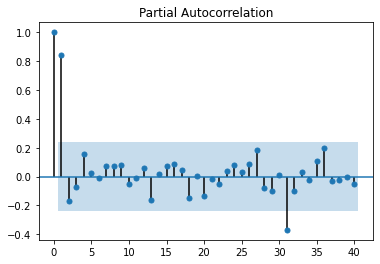

In [28]:
plot_pacf(bond_spread_list[0][2].GSpread.values, lags=40)
plt.show()

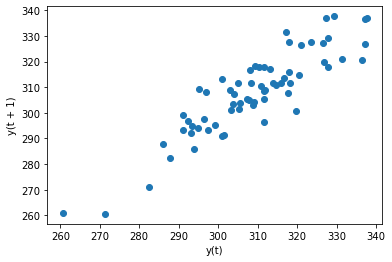

In [29]:
from pandas import read_csv
from matplotlib import pyplot
from pandas.plotting import lag_plot
series = bond_spread_list[0][2].GSpread
lag_plot(series)
pyplot.show()

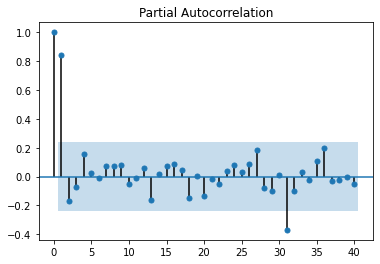

In [30]:
plot_pacf(bond_spread_list[0][2].GSpread.values, lags=40)
plt.show()

In [31]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot
import statistics 
from scipy import stats
def get_trend_seasonal(x):
    try:
        xt, _ = stats.boxcox(x[2].GSpread.values)
        result = seasonal_decompose(xt,model='additive', freq=2)
        xt = result.resid + result.seasonal
        zt = result.resid + result.trend
        yt = result.resid
        yt[1:-1]
        m_seasonal = 1- np.var(yt[1:-1])/np.var(xt[1:-1])
        m_trend = 1- np.var(yt[1:-1])/np.var(zt[1:-1])
        return m_trend,m_seasonal
    except:
        print(x)

In [32]:
get_trend_seasonal(bond_spread_list[10000])

(0.8788768748606955, 0.11663141453015846)

In [33]:
trend_seasonal = pd.DataFrame(columns=['SecurityID', 'm_trend','m_seasonal'])

In [34]:
for i in bond_spread_list:
    try:
        security = i[1]
        m_trend,m_seasonal = get_trend_seasonal(i)
        temp_dict= {'SecurityID':security,'m_trend':m_trend,'m_seasonal':m_seasonal}
        temp_df = pd.DataFrame([temp_dict])
        trend_seasonal = trend_seasonal.append(temp_df)
    except:
        pass

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 402,        SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
22541         402 2019-01-09  100.894     3.41804                1.209780   
22542         402 2019-01-10  100.912     3.38165                1.201910   
22543         402 2019-01-11  100.960     3.31236                1.199500   
22544         402 2019-01-14  100.900     3.38836                1.196550   
22545         402 2019-01-15  100.935     3.33645                1.194080   
...           ...        ...      ...         ...                     ...   
22603         402 2019-04-09  101.009     2.62495                0.971723   
22604         402 2019-04-10  101.043     2.54568                0.969244   
22605         402 2019-04-11  100.981     2.63775                0.971186   
22606         402 2019-04-12  101.022     2.54393                0.968736   
22607         402 2019-04-15  101.115     2.34403                0.966542   

           WorkoutDate  AmtOutstanding  GSpread  OAS_Spread   ZSp

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 3126,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
155057        3126 2019-01-09  125.168     5.73847                 17.0462   
155058        3126 2019-01-10  123.762     5.80497                 16.8729   
155059        3126 2019-01-11  116.344     6.18120                 15.9705   
155060        3126 2019-01-14  120.834     5.94816                 16.5387   
155061        3126 2019-01-15  119.850     5.99777                 16.4148   
...            ...        ...      ...         ...                     ...   
155119        3126 2019-04-09  124.696     5.75987                 17.0031   
155120        3126 2019-04-10  124.811     5.75445                 17.0170   
155121        3126 2019-04-11  127.727     5.62030                 17.3731   
155122        3126 2019-04-12  127.709     5.62113                 17.3706   
155123        3126 2019-04-15  127.969     5.60941                 17.4021   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 4055,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
239963        4055 2019-01-09  101.417     2.92984                 1.60297   
239964        4055 2019-01-10  101.417     2.92389                 1.59497   
239965        4055 2019-01-11  101.472     2.88238                 1.59259   
239966        4055 2019-01-14  101.458     2.89053                 1.58985   
239967        4055 2019-01-15  101.524     2.84087                 1.58752   
...            ...        ...      ...         ...                     ...   
240025        4055 2019-04-09  101.647     2.52361                 1.38153   
240026        4055 2019-04-10  101.669     2.50140                 1.37897   
240027        4055 2019-04-11  101.670     2.48968                 1.37097   
240028        4055 2019-04-12  101.667     2.48864                 1.36829   
240029        4055 2019-04-15  101.669     2.48396                 1.36563   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\optimize\optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)


(67, 4825,         SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
318761        4825 2019-01-09  100.0210   -0.918386                 1.78019   
318762        4825 2019-01-10  100.1110  -30.705800                 1.77289   
318763        4825 2019-01-11  100.2230  -61.262000                 1.77089   
318764        4825 2019-01-14   99.4683    6.796570                 1.76428   
318765        4825 2019-01-15  100.2690  -72.221500                 1.76595   
...            ...        ...       ...         ...                     ...   
318823        4825 2019-04-09  100.4500 -106.477000                 1.54894   
318824        4825 2019-04-10  100.4290 -102.963000                 1.54624   
318825        4825 2019-04-11  100.4410 -104.904000                 1.53851   
318826        4825 2019-04-12  100.4550 -107.140000                 1.53599   
318827        4825 2019-04-15  100.4480 -106.088000                 1.53336   

            WorkoutDate  AmtOutstanding 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


(67, 5327,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
360489        5327 2019-01-09  101.047     4.66995                 2.66643   
360490        5327 2019-01-10  100.924     4.81469                 2.65788   
360491        5327 2019-01-11  101.194     4.46359                 2.71579   
360492        5327 2019-01-14  100.778     4.99656                 2.71070   
360493        5327 2019-01-15  100.618     5.20120                 2.70714   
...            ...        ...      ...         ...                     ...   
360551        5327 2019-04-09  101.182     3.82860                 2.49245   
360552        5327 2019-04-10  101.161     3.85691                 2.48973   
360553        5327 2019-04-11  101.406     3.37227                 2.48339   
360554        5327 2019-04-12  101.283     3.58624                 2.48007   
360555        5327 2019-04-15  101.315     3.51511                 2.47766   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 6425,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
454949        6425 2019-01-09  98.6616     2.82542                1.049210   
454950        6425 2019-01-10  98.7631     2.73704                1.041510   
454951        6425 2019-01-11  98.7958     2.70840                1.038940   
454952        6425 2019-01-14  98.8103     2.69732                1.036280   
454953        6425 2019-01-15  98.7898     2.72034                1.033440   
...            ...        ...      ...         ...                     ...   
455011        6425 2019-04-09  99.1590     2.58907                0.809272   
455012        6425 2019-04-10  99.1612     2.58980                0.806548   
455013        6425 2019-04-11  99.1546     2.60875                0.798311   
455014        6425 2019-04-12  99.1588     2.60698                0.795597   
455015        6425 2019-04-15  99.1437     2.62988                0.792787   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  



(67, 6737,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
486778        6737 2019-01-09  98.9956     2.77959                 1.28868   
486779        6737 2019-01-10  98.9749     2.80075                 1.28040   
486780        6737 2019-01-11  99.0450     2.74711                 1.27804   
486781        6737 2019-01-14  99.0574     2.73887                 1.27538   
486782        6737 2019-01-15  99.0476     2.74820                 1.27260   
...            ...        ...      ...         ...                     ...   
486840        6737 2019-04-09  99.3576     2.61238                 1.04548   
486841        6737 2019-04-10  99.4059     2.56757                 1.04300   
486842        6737 2019-04-11  99.3679     2.60879                 1.03465   
486843        6737 2019-04-12  99.3289     2.64830                 1.03173   
486844        6737 2019-04-15  99.3359     2.64323                 1.02904   

            WorkoutDate  AmtOutstanding  GSpread  O

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 6997,         SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
514236        6997 2019-01-09   99.0250     6.37684                 3.79440   
514237        6997 2019-01-10   99.1355     6.34868                 3.78768   
514238        6997 2019-01-11   99.3750     6.28662                 3.87687   
514239        6997 2019-01-14   99.2740     6.31288                 3.87352   
514240        6997 2019-01-15   99.2640     6.31552                 3.87088   
...            ...        ...       ...         ...                     ...   
514298        6997 2019-04-09  101.9900     4.24207                 3.67652   
514299        6997 2019-04-10  101.9890     4.22623                 3.67395   
514300        6997 2019-04-11  101.9550     4.30290                 3.66600   
514301        6997 2019-04-12  101.9710     4.21840                 3.66356   
514302        6997 2019-04-15  101.9760     4.18022                 3.66103   

            WorkoutDate  AmtOutstanding 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 7516,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
559355        7516 2019-01-09  104.250     4.89506                 4.28853   
559356        7516 2019-01-10  104.070     4.95273                 4.27937   
559357        7516 2019-01-11  104.167     4.91885                 4.27768   
559358        7516 2019-01-14  103.833     5.03143                 4.27222   
559359        7516 2019-01-15  104.126     4.93063                 4.27226   
...            ...        ...      ...         ...                     ...   
559417        7516 2019-04-09  104.764     4.40017                 4.16253   
559418        7516 2019-04-10  104.952   -46.04080                 4.16150   
559419        7516 2019-04-11  104.889   -28.38720                 4.15336   
559420        7516 2019-04-12  104.980   -53.07680                 4.15155   
559421        7516 2019-04-15  104.724     4.41245                 4.14694   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 8843,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
664733        8843 2019-01-09  99.0508     2.80408                1.047510   
664734        8843 2019-01-10  99.0597     2.80257                1.039380   
664735        8843 2019-01-11  99.1050     2.76101                1.036880   
664736        8843 2019-01-14  99.0785     2.78901                1.034020   
664737        8843 2019-01-15  99.1165     2.75440                1.031490   
...            ...        ...      ...         ...                     ...   
664795        8843 2019-04-09  99.4617     2.56409                0.808833   
664796        8843 2019-04-10  99.4466     2.58514                0.806032   
664797        8843 2019-04-11  99.4169     2.62945                0.797709   
664798        8843 2019-04-12  99.4041     2.64817                0.794920   
664799        8843 2019-04-15  99.4214     2.62869                0.792281   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


(67, 9345,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
693342        9345 2019-01-09  98.7351     2.77185                 1.30336   
693343        9345 2019-01-10  98.7359     2.77725                 1.29518   
693344        9345 2019-01-11  98.7790     2.74551                 1.29267   
693345        9345 2019-01-14  98.7968     2.73359                 1.29004   
693346        9345 2019-01-15  98.7776     2.75056                 1.28721   
...            ...        ...      ...         ...                     ...   
693404        9345 2019-04-09  99.1362     2.61309                 1.05988   
693405        9345 2019-04-10  99.2048     2.55006                 1.05750   
693406        9345 2019-04-11  99.1770     2.58247                 1.04917   
693407        9345 2019-04-12  99.1658     2.59531                 1.04639   
693408        9345 2019-04-15  99.2758     2.49163                 1.04421   

            WorkoutDate  AmtOutstanding  GSpread  OA

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 10145,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
744600       10145 2019-01-09  116.913     4.77230                 20.2108   
744601       10145 2019-01-10  116.575     4.78663                 20.1598   
744602       10145 2019-01-11  116.952     4.77063                 20.2149   
744603       10145 2019-01-14  116.347     4.79633                 20.1254   
744604       10145 2019-01-15  115.288     4.84186                 19.9684   
...            ...        ...      ...         ...                     ...   
744662       10145 2019-04-09  124.792     4.45875                 21.2974   
744663       10145 2019-04-10  125.299     4.43982                 21.3676   
744664       10145 2019-04-11  124.515     4.46918                 21.3304   
744665       10145 2019-04-12  123.313     4.51483                 21.1592   
744666       10145 2019-04-15  124.036     4.48728                 21.2615   

            WorkoutDate  AmtOutstanding  GSpread  O

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


(67, 11667,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
794618       11667 2019-01-09  100.379     5.01243                 3.30542   
794619       11667 2019-01-10  100.347     5.03090                 3.29738   
794620       11667 2019-01-11  100.402     4.99695                 3.29515   
794621       11667 2019-01-14  100.280     5.07147                 3.29172   
794622       11667 2019-01-15  100.404     4.99470                 3.28995   
...            ...        ...      ...         ...                     ...   
794680       11667 2019-04-09  101.729     3.36962                 3.14181   
794681       11667 2019-04-10  101.750     3.31308                 3.13933   
794682       11667 2019-04-11  101.779    -5.13918                 3.13168   
794683       11667 2019-04-12  101.600     3.59491                 3.12794   
794684       11667 2019-04-15  101.608     3.56734                 3.12538   

            WorkoutDate  AmtOutstanding  GSpread  O

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 12095,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
860563       12095 2019-01-09  104.081     5.57060                 17.8087   
860564       12095 2019-01-10  107.540     5.38999                 18.3624   
860565       12095 2019-01-11  104.442     5.55126                 17.8663   
860566       12095 2019-01-14  104.018     5.57406                 17.7979   
860567       12095 2019-01-15  103.563     5.59868                 17.7245   
...            ...        ...      ...         ...                     ...   
860625       12095 2019-04-09  121.510     4.76166                 20.5487   
860626       12095 2019-04-10  121.812     4.74957                 20.5944   
860627       12095 2019-04-11  123.377     4.68792                 20.8304   
860628       12095 2019-04-12  122.782     4.71118                 20.7403   
860629       12095 2019-04-15  122.832     4.70921                 20.7476   

            WorkoutDate  AmtOutstanding  GSpread  O

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 12255,         SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
885501       12255 2019-01-09   99.0000     7.51973                 1.87627   
885502       12255 2019-01-10   98.4814     7.79777                 1.86560   
885503       12255 2019-01-11   98.0370     8.03698                 1.86048   
885504       12255 2019-01-14   98.2177     7.94131                 1.85895   
885505       12255 2019-01-15   97.9688     8.07663                 1.85495   
...            ...        ...       ...         ...                     ...   
885563       12255 2019-04-09  101.8130   -14.51260                 1.70170   
885564       12255 2019-04-10  101.6880     4.91703                 1.69847   
885565       12255 2019-04-11  101.6850     4.90024                 1.69071   
885566       12255 2019-04-12  101.7500     4.81375                 1.68847   
885567       12255 2019-04-15  101.7760    -2.23546                 1.68602   

            WorkoutDate  AmtOutstanding

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


(67, 13308,         SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
981459       13308 2019-01-09  103.010     5.01920                 2.80737   
981460       13308 2019-01-10  102.773     5.12849                 2.79814   
981461       13308 2019-01-11  102.665     5.17934                 2.79488   
981462       13308 2019-01-14  102.749     5.13695                 2.79284   
981463       13308 2019-01-15  102.750     5.13489                 2.79028   
...            ...        ...      ...         ...                     ...   
981521       13308 2019-04-09  103.476   -60.46080                 2.64016   
981522       13308 2019-04-10  103.469   -58.71180                 2.63753   
981523       13308 2019-04-11  103.626   -92.30700                 2.63072   
981524       13308 2019-04-12  103.565   -80.47820                 2.62778   
981525       13308 2019-04-15  103.568   -81.06950                 2.62522   

            WorkoutDate  AmtOutstanding  GSpread  O

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 14897,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
1108900       14897 2019-01-09   99.0045     4.66498                 15.1477   
1108901       14897 2019-01-10   98.5737     4.69350                 15.1145   
1108902       14897 2019-01-11   99.7054     4.61905                 15.1843   
1108903       14897 2019-01-14   99.5202     4.63116                 15.1707   
1108904       14897 2019-01-15   98.8747     4.67361                 15.1280   
...             ...        ...       ...         ...                     ...   
1108962       14897 2019-04-09  100.9350     3.40713                 15.2952   
1108963       14897 2019-04-10  100.9610     3.37071                 15.2948   
1108964       14897 2019-04-11  100.9080     3.42562                 15.2858   
1108965       14897 2019-04-12  100.8260     3.52611                 15.2789   
1108966       14897 2019-04-15  100.8350     3.51103                 15.2775   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 15124,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1140537       15124 2019-01-09  98.0456     2.83381                 1.98850   
1140538       15124 2019-01-10  98.0495     2.83581                 1.98034   
1140539       15124 2019-01-11  98.0580     2.83281                 1.97766   
1140540       15124 2019-01-14  98.1471     2.78843                 1.97540   
1140541       15124 2019-01-15  98.1356     2.79562                 1.97262   
...             ...        ...      ...         ...                     ...   
1140599       15124 2019-04-09  98.7489     2.56161                 1.76009   
1140600       15124 2019-04-10  98.7621     2.55511                 1.75743   
1140601       15124 2019-04-11  98.7543     2.56285                 1.74922   
1140602       15124 2019-04-12  98.6942     2.59869                 1.74618   
1140603       15124 2019-04-15  98.6307     2.63665                 1.74313   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 15327,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1176870       15327 2019-01-09  100.342     2.73421                 1.57976   
1176871       15327 2019-01-10  100.270     2.77826                 1.57131   
1176872       15327 2019-01-11  100.317     2.74850                 1.56885   
1176873       15327 2019-01-14  100.304     2.75600                 1.56609   
1176874       15327 2019-01-15  100.390     2.70125                 1.56384   
...             ...        ...      ...         ...                     ...   
1176932       15327 2019-04-09  100.634     2.48163                 1.35216   
1176933       15327 2019-04-10  100.629     2.48443                 1.34944   
1176934       15327 2019-04-11  100.627     2.48330                 1.34134   
1176935       15327 2019-04-12  100.537     2.54890                 1.33819   
1176936       15327 2019-04-15  100.553     2.53583                 1.33558   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 15489,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1211296       15489 2019-01-09  98.6151     2.77689                 1.78601   
1211297       15489 2019-01-10  98.7621     2.69679                 1.77860   
1211298       15489 2019-01-11  98.8016     2.67534                 1.77609   
1211299       15489 2019-01-14  98.7939     2.68072                 1.77333   
1211300       15489 2019-01-15  98.8226     2.66537                 1.77075   
...             ...        ...      ...         ...                     ...   
1211358       15489 2019-04-09  99.1659     2.53837                 1.54388   
1211359       15489 2019-04-10  99.2056     2.51343                 1.54137   
1211360       15489 2019-04-11  99.1208     2.57165                 1.53277   
1211361       15489 2019-04-12  99.1107     2.57927                 1.52999   
1211362       15489 2019-04-15  99.1006     2.58695                 1.52722   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(47, 16606,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1397430       16606 2019-02-07  99.2858     2.59279                1.045840   
1397431       16606 2019-02-08  99.3081     2.57312                1.043230   
1397432       16606 2019-02-11  99.2673     2.61412                1.040300   
1397433       16606 2019-02-12  99.2713     2.61210                1.037590   
1397434       16606 2019-02-13  99.2352     2.64895                1.034690   
1397435       16606 2019-02-14  99.2679     2.62481                1.023950   
1397436       16606 2019-02-15  99.1979     2.69551                1.020880   
1397437       16606 2019-02-19  99.2617     2.63471                1.018470   
1397438       16606 2019-02-20  99.2653     2.63315                1.015760   
1397439       16606 2019-02-21  99.2074     2.69665                1.007300   
1397440       16606 2019-02-22  99.2451     2.66111                1.004760   
1397441       16606 2019-02-25  99.3750 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 17354,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1447995       17354 2019-01-09  101.615     5.02452                 3.29942   
1447996       17354 2019-01-10  101.563     5.05156                 3.29132   
1447997       17354 2019-01-11  101.514     5.07902                 3.28840   
1447998       17354 2019-01-14  101.866     4.86785                 3.28825   
1447999       17354 2019-01-15  101.934     4.82544                 3.28614   
...             ...        ...      ...         ...                     ...   
1448057       17354 2019-04-09  103.499  -111.70100                 3.08013   
1448058       17354 2019-04-10  103.500  -111.83800                 3.07756   
1448059       17354 2019-04-11  103.317   -81.48870                 3.13647   
1448060       17354 2019-04-12  103.211   -57.43550                 3.13321   
1448061       17354 2019-04-15  103.197   -53.87670                 3.13053   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


(67, 18002,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1488729       18002 2019-01-09  100.959     3.06506                 2.85139   
1488730       18002 2019-01-10  100.972     3.05980                 2.84344   
1488731       18002 2019-01-11  101.062     3.02870                 2.84129   
1488732       18002 2019-01-14  101.099     3.01564                 2.83883   
1488733       18002 2019-01-15  101.130     3.00469                 2.83634   
...             ...        ...      ...         ...                     ...   
1488791       18002 2019-04-09  102.438     2.49050                 2.65550   
1488792       18002 2019-04-10  102.535     2.45413                 2.65336   
1488793       18002 2019-04-11  102.422     2.49278                 2.64470   
1488794       18002 2019-04-12  102.315     2.53122                 2.64144   
1488795       18002 2019-04-15  102.336     2.52283                 2.63887   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 19138,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1594493       19138 2019-01-09  99.0751     2.71912                1.061780   
1594494       19138 2019-01-10  99.0451     2.75446                1.053450   
1594495       19138 2019-01-11  99.0579     2.74463                1.050790   
1594496       19138 2019-01-14  99.0350     2.76889                1.047950   
1594497       19138 2019-01-15  99.0817     2.72639                1.045450   
...             ...        ...      ...         ...                     ...   
1594555       19138 2019-04-09  99.3629     2.62373                0.822253   
1594556       19138 2019-04-10  99.3884     2.59502                0.819653   
1594557       19138 2019-04-11  99.3555     2.64324                0.811309   
1594558       19138 2019-04-12  99.3358     2.67037                0.808485   
1594559       19138 2019-04-15  99.3638     2.63813                0.805897   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 19810,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1682417       19810 2019-01-09  101.468     4.58721                 2.71941   
1682418       19810 2019-01-10  101.314     4.66589                 2.71066   
1682419       19810 2019-01-11  101.375     4.63227                 2.70840   
1682420       19810 2019-01-14  101.089     4.78449                 2.70410   
1682421       19810 2019-01-15  101.365     4.63570                 2.70311   
...             ...        ...      ...         ...                     ...   
1682479       19810 2019-04-09  102.558     3.59982                 2.49025   
1682480       19810 2019-04-10  102.596     3.54086                 2.48785   
1682481       19810 2019-04-11  102.670     3.41712                 2.48043   
1682482       19810 2019-04-12  102.707    -1.45718                 2.47803   
1682483       19810 2019-04-15  102.609     3.48954                 2.47484   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 20804,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1845689       20804 2019-01-09  104.252     5.00536                 4.06440   
1845690       20804 2019-01-10  103.958     5.94995                 4.05426   
1845691       20804 2019-01-11  103.946     5.95356                 4.05169   
1845692       20804 2019-01-14  103.894     5.97784                 4.04874   
1845693       20804 2019-01-15  103.875     5.98490                 4.04611   
...             ...        ...      ...         ...                     ...   
1845751       20804 2019-04-09  104.250   -64.46210                 3.95543   
1845752       20804 2019-04-10  104.230   -59.69230                 3.95279   
1845753       20804 2019-04-11  104.169   -44.29960                 3.94485   
1845754       20804 2019-04-12  104.307   -76.88720                 3.94358   
1845755       20804 2019-04-15  104.300   -75.46860                 3.94105   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 21445,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
1907970       21445 2019-01-09  102.999     2.86880                 2.13600   
1907971       21445 2019-01-10  103.146     2.79769                 2.12880   
1907972       21445 2019-01-11  103.069     2.83070                 2.12574   
1907973       21445 2019-01-14  103.262     2.74172                 2.12411   
1907974       21445 2019-01-15  103.199     2.76826                 2.12112   
...             ...        ...      ...         ...                     ...   
1908032       21445 2019-04-09  103.384     2.51367                 1.89897   
1908033       21445 2019-04-10  103.483     2.46160                 1.89684   
1908034       21445 2019-04-11  103.382     2.50549                 1.91560   
1908035       21445 2019-04-12  103.284     2.55295                 1.91244   
1908036       21445 2019-04-15  103.286     2.54938                 1.90979   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 22471,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2007326       22471 2019-01-09  102.591     4.87202                 3.91308   
2007327       22471 2019-01-10  102.651     4.75627                 3.90589   
2007328       22471 2019-01-11  102.548     4.91921                 3.90251   
2007329       22471 2019-01-14  102.460     4.97024                 3.89924   
2007330       22471 2019-01-15  102.795     4.49226                 3.89938   
...             ...        ...      ...         ...                     ...   
2007388       22471 2019-04-09  102.758     3.67495                 3.77012   
2007389       22471 2019-04-10  102.900     3.24947                 3.76860   
2007390       22471 2019-04-11  102.861     3.30003                 3.76060   
2007391       22471 2019-04-12  103.012     1.73776                 3.75916   
2007392       22471 2019-04-15  102.953     2.98122                 3.75615   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 24073,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
2111813       24073 2019-01-09   99.5126     4.79420                 1.62473   
2111814       24073 2019-01-10   99.5975     4.74333                 1.61722   
2111815       24073 2019-01-11   99.4513     4.83392                 1.61380   
2111816       24073 2019-01-14   99.4663     4.82521                 1.61123   
2111817       24073 2019-01-15   99.4395     4.84235                 1.60844   
...             ...        ...       ...         ...                     ...   
2111875       24073 2019-04-09  100.1200   -35.00190                 1.40903   
2111876       24073 2019-04-10  100.0860   -24.61390                 1.40620   
2111877       24073 2019-04-11  100.1290   -37.74600                 1.39846   
2111878       24073 2019-04-12  100.1480   -43.12950                 1.39590   
2111879       24073 2019-04-15  100.1040   -30.36900                 1.39303   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(53, 26508,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2166358       26508 2019-01-09  106.688     6.27637                 3.50553   
2166359       26508 2019-01-10  107.086     5.46357                 3.50192   
2166360       26508 2019-01-11  107.170     5.28106                 3.61586   
2166361       26508 2019-01-14  107.255     5.09392                 3.61416   
2166362       26508 2019-01-15  107.430     4.73246                 3.61320   
2166363       26508 2019-01-16  107.740   -59.61610                 3.61336   
2166364       26508 2019-01-17  107.125     5.20021                 3.59865   
2166365       26508 2019-01-18  107.250     4.92552                 3.59728   
2166366       26508 2019-01-22  107.250     4.89894                 3.59488   
2166367       26508 2019-01-23  107.188     4.99821                 3.59196   
2166368       26508 2019-01-24  107.875   -87.83760                 3.59041   
2166369       26508 2019-01-25  107.875 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 28968,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
2288374       28968 2019-01-09  100.0620     6.03182                 1.89435   
2288375       28968 2019-01-10  100.0620     5.97338                 1.88661   
2288376       28968 2019-01-11   99.9417     6.77612                 1.88335   
2288377       28968 2019-01-14  100.0620     5.92835                 1.88144   
2288378       28968 2019-01-15  100.0420     6.15403                 1.87875   
...             ...        ...       ...         ...                     ...   
2288436       28968 2019-04-09  100.2660   -71.10290                 1.70377   
2288437       28968 2019-04-10  100.1410   -39.00830                 1.70052   
2288438       28968 2019-04-11  100.2500   -67.43250                 1.69334   
2288439       28968 2019-04-12  100.2140   -58.55240                 1.69056   
2288440       28968 2019-04-15  100.1260   -34.60250                 1.68751   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 29952,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2349250       29952 2019-01-09  105.625    7.830390                 2.42315   
2349251       29952 2019-01-10  105.719    0.285042                 2.41647   
2349252       29952 2019-01-11  105.755  -11.516900                 2.41428   
2349253       29952 2019-01-14  105.669    7.729500                 2.41131   
2349254       29952 2019-01-15  105.719    0.284790                 2.40920   
...             ...        ...      ...         ...                     ...   
2349312       29952 2019-04-09  106.156 -102.086000                 2.20812   
2349313       29952 2019-04-10  106.250 -115.954000                 2.20627   
2349314       29952 2019-04-11  106.250 -115.892000                 2.19899   
2349315       29952 2019-04-12  106.408 -134.907000                 2.19753   
2349316       29952 2019-04-15  106.293 -121.535000                 2.19439   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 30582,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2379929       30582 2019-01-09  101.597     5.57134                 3.34123   
2379930       30582 2019-01-10  101.459     5.64683                 3.33257   
2379931       30582 2019-01-11  101.533     5.60270                 3.33053   
2379932       30582 2019-01-14  101.476     5.63412                 3.32757   
2379933       30582 2019-01-15  101.613     5.55374                 3.32598   
...             ...        ...      ...         ...                     ...   
2379991       30582 2019-04-09  102.333   -44.93050                 3.11592   
2379992       30582 2019-04-10  102.300   -35.80160                 3.11312   
2379993       30582 2019-04-11  102.330   -43.97280                 3.10565   
2379994       30582 2019-04-12  102.320   -41.35770                 3.10302   
2379995       30582 2019-04-15  102.300   -35.77370                 3.10032   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 30725,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2410307       30725 2019-01-09  100.390    -97.3343                 1.79008   
2410308       30725 2019-01-10  100.388    -96.8968                 1.78227   
2410309       30725 2019-01-11  100.433   -104.8950                 1.77991   
2410310       30725 2019-01-14  100.334    -86.5185                 1.77678   
2410311       30725 2019-01-15  100.357    -91.0142                 1.77430   
...             ...        ...      ...         ...                     ...   
2410369       30725 2019-04-09  100.620   -130.7340                 1.55712   
2410370       30725 2019-04-10  100.501   -114.5450                 1.55389   
2410371       30725 2019-04-11  100.777   -147.3490                 1.54753   
2410372       30725 2019-04-12  100.553   -122.0720                 1.54375   
2410373       30725 2019-04-15  100.438   -104.4860                 1.54055   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 32177,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2470735       32177 2019-01-09  102.003     6.41107                0.856163   
2470736       32177 2019-01-10  102.001     6.39202                0.848516   
2470737       32177 2019-01-11  102.000     6.38628                0.845964   
2470738       32177 2019-01-14  102.031     6.34278                0.843569   
2470739       32177 2019-01-15  102.095     6.26079                0.841331   
...             ...        ...      ...         ...                     ...   
2470797       32177 2019-04-09  101.948     5.63595                0.626673   
2470798       32177 2019-04-10  101.979     5.57447                0.624274   
2470799       32177 2019-04-11  101.973     5.54500                0.616603   
2470800       32177 2019-04-12  101.978     5.52392                0.614079   
2470801       32177 2019-04-15  101.948     5.55787                0.611391   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 32511,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2511806       32511 2019-01-09  102.306     5.93422                 2.56282   
2511807       32511 2019-01-10  102.533     5.80118                 2.55653   
2511808       32511 2019-01-11  102.184     5.99561                 2.55186   
2511809       32511 2019-01-14  102.331     5.91105                 2.55019   
2511810       32511 2019-01-15  102.457     5.83801                 2.54840   
...             ...        ...      ...         ...                     ...   
2511868       32511 2019-04-09  103.265     4.80390                 2.33842   
2511869       32511 2019-04-10  103.266     4.79218                 2.33587   
2511870       32511 2019-04-11  103.242     4.80068                 2.32806   
2511871       32511 2019-04-12  103.340     4.63534                 2.32608   
2511872       32511 2019-04-15  103.368     4.57933                 2.32369   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 33113,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
2642836       33113 2019-01-09   97.3845     7.97589                 1.50098   
2642837       33113 2019-01-10   97.9188     7.62402                 1.49602   
2642838       33113 2019-01-11   97.9540     7.60263                 1.49361   
2642839       33113 2019-01-14   97.8810     7.65418                 1.49062   
2642840       33113 2019-01-15   97.9167     7.63248                 1.48820   
...             ...        ...       ...         ...                     ...   
2642898       33113 2019-04-09  100.1210   -33.67190                 1.30733   
2642899       33113 2019-04-10  100.1110   -30.70680                 1.30468   
2642900       33113 2019-04-11  100.0000     6.22601                 1.29630   
2642901       33113 2019-04-12  100.2400   -65.51440                 1.29491   
2642902       33113 2019-04-15  100.2100   -58.19950                 1.29215   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 33290,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2681614       33290 2019-01-09  101.870     4.85155                 3.25637   
2681615       33290 2019-01-10  102.002     4.65140                 3.24956   
2681616       33290 2019-01-11  101.952     4.71760                 3.24663   
2681617       33290 2019-01-14  101.731     5.02737                 3.24253   
2681618       33290 2019-01-15  101.827     4.88626                 3.24062   
...             ...        ...      ...         ...                     ...   
2681676       33290 2019-04-09  102.140   -26.65480                 3.09588   
2681677       33290 2019-04-10  102.132   -24.23220                 3.09324   
2681678       33290 2019-04-11  102.238   -53.86500                 3.08617   
2681679       33290 2019-04-12  102.253   -57.72570                 3.08368   
2681680       33290 2019-04-15  102.202   -44.32860                 3.08077   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 33630,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2748806       33630 2019-01-09  102.295   -22.56530                 3.33740   
2748807       33630 2019-01-10  102.390   -49.37380                 3.33039   
2748808       33630 2019-01-11  101.965     5.47832                 3.32484   
2748809       33630 2019-01-14  102.271   -14.92430                 3.32445   
2748810       33630 2019-01-15  102.302   -24.68680                 3.32211   
...             ...        ...      ...         ...                     ...   
2748868       33630 2019-04-09  102.333   -33.42190                 3.10759   
2748869       33630 2019-04-10  102.390   -48.70990                 3.10543   
2748870       33630 2019-04-11  102.250    -7.83031                 3.09679   
2748871       33630 2019-04-12  102.396   -50.21540                 3.09525   
2748872       33630 2019-04-15  102.386   -47.66220                 3.09262   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 33818,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2781314       33818 2019-01-09  98.0325     2.36961                 23.5313   
2781315       33818 2019-01-10  98.0592     2.36848                 23.5261   
2781316       33818 2019-01-11  97.9715     2.37226                 23.5179   
2781317       33818 2019-01-14  97.9865     2.37162                 23.5166   
2781318       33818 2019-01-15  97.9867     2.37162                 23.5143   
...             ...        ...      ...         ...                     ...   
2781376       33818 2019-04-09  98.4613     2.35149                 23.5453   
2781377       33818 2019-04-10  98.4857     2.35044                 23.5445   
2781378       33818 2019-04-11  98.4503     2.35197                 23.5352   
2781379       33818 2019-04-12  98.4050     2.35393                 23.5299   
2781380       33818 2019-04-15  98.4189     2.35333                 23.5285   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(47, 34365,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
2870838       34365 2019-02-07   97.4265     8.28920                 3.25725   
2870839       34365 2019-02-08   97.0541     8.40619                 3.25252   
2870840       34365 2019-02-11   96.9886     8.42733                 3.24953   
2870841       34365 2019-02-12   96.9915     8.42702                 3.24694   
2870842       34365 2019-02-13   96.6795     8.52586                 3.24254   
2870843       34365 2019-02-14   96.4314     8.60714                 3.23067   
2870844       34365 2019-02-15   96.2889     8.65314                 3.22724   
2870845       34365 2019-02-19   96.6719     8.53235                 3.22683   
2870846       34365 2019-02-20   96.4878     8.59142                 3.22317   
2870847       34365 2019-02-21   97.3750     8.31286                 3.22041   
2870848       34365 2019-02-22   97.2500     8.35283                 3.21709   
2870849       34365 2019-02-

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 34591,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2901468       34591 2019-01-09  100.595     5.78492                 4.26028   
2901469       34591 2019-01-10  100.754     5.72789                 4.25407   
2901470       34591 2019-01-11  100.725     5.73803                 4.25126   
2901471       34591 2019-01-14  100.757     5.72628                 4.24901   
2901472       34591 2019-01-15  100.757     5.72609                 4.24647   
...             ...        ...      ...         ...                     ...   
2901530       34591 2019-04-09  103.982     4.49041                 4.15447   
2901531       34591 2019-04-10  104.000     4.48241                 4.15206   
2901532       34591 2019-04-11  104.125     4.42305                 4.14538   
2901533       34591 2019-04-12  104.576   -19.24450                 4.14640   
2901534       34591 2019-04-15  104.375     4.15952                 4.14225   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 34955,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
2945485       34955 2019-01-09  101.335    -181.141                 2.74599   
2945486       34955 2019-01-10  101.329    -180.910                 2.73796   
2945487       34955 2019-01-11  101.387    -182.770                 2.73563   
2945488       34955 2019-01-14  101.413    -183.563                 2.73311   
2945489       34955 2019-01-15  101.421    -183.780                 2.73049   
...             ...        ...      ...         ...                     ...   
2945547       34955 2019-04-09  101.763    -190.885                 2.50860   
2945548       34955 2019-04-10  101.819    -191.726                 2.50625   
2945549       34955 2019-04-11  101.732    -190.358                 2.49777   
2945550       34955 2019-04-12  100.993    -164.816                 2.49096   
2945551       34955 2019-04-15  101.008    -165.681                 2.48838   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


(67, 36476,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3082847       36476 2019-01-09  98.2476     2.71853                 18.7750   
3082848       36476 2019-01-10  98.1533     2.72364                 18.7633   
3082849       36476 2019-01-11  98.2587     2.71795                 18.7659   
3082850       36476 2019-01-14  98.3078     2.71531                 18.7658   
3082851       36476 2019-01-15  98.3069     2.71536                 18.7634   
...             ...        ...      ...         ...                     ...   
3082909       36476 2019-04-09  98.9702     2.68008                 18.5932   
3082910       36476 2019-04-10  98.9785     2.67964                 18.5911   
3082911       36476 2019-04-11  98.9940     2.67883                 18.5847   
3082912       36476 2019-04-12  98.9627     2.68052                 18.5808   
3082913       36476 2019-04-15  98.9582     2.68077                 18.5782   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 39276,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3166469       39276 2019-01-09  101.632     4.93314                 2.01003   
3166470       39276 2019-01-10  101.392     5.24349                 2.00099   
3166471       39276 2019-01-11  101.472     5.12369                 1.99887   
3166472       39276 2019-01-14  101.573     4.97288                 1.99687   
3166473       39276 2019-01-15  101.356     5.27294                 1.99308   
...             ...        ...      ...         ...                     ...   
3166531       39276 2019-04-09  101.806     3.42734                 1.82275   
3166532       39276 2019-04-10  101.799     3.42000                 1.82014   
3166533       39276 2019-04-11  101.900   -22.39760                 1.81296   
3166534       39276 2019-04-12  101.867   -11.75690                 1.81021   
3166535       39276 2019-04-15  101.896   -20.97550                 1.80779   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 39465,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3198654       39465 2019-01-09  107.770     5.23587                 18.6769   
3198655       39465 2019-01-10  107.121     5.26826                 18.5764   
3198656       39465 2019-01-11  107.469     5.25083                 18.6296   
3198657       39465 2019-01-14  106.955     5.27660                 18.5502   
3198658       39465 2019-01-15  106.643     5.29233                 18.5020   
...             ...        ...      ...         ...                     ...   
3198716       39465 2019-04-09  115.157     4.89155                 19.8100   
3198717       39465 2019-04-10  115.950     4.85701                 19.9270   
3198718       39465 2019-04-11  115.623     4.87117                 19.8776   
3198719       39465 2019-04-12  114.730     4.91029                 19.7448   
3198720       39465 2019-04-15  115.010     4.89794                 19.7860   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


(67, 39659,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3240363       39659 2019-01-09  101.350     4.85638                 3.15996   
3240364       39659 2019-01-10  101.223     4.93556                 3.15132   
3240365       39659 2019-01-11  101.038     5.05595                 3.14747   
3240366       39659 2019-01-14  100.956     5.10943                 3.14431   
3240367       39659 2019-01-15  101.019     5.06701                 3.14215   
...             ...        ...      ...         ...                     ...   
3240425       39659 2019-04-09  101.875     3.01154                 2.99649   
3240426       39659 2019-04-10  101.762     3.31602                 2.99318   
3240427       39659 2019-04-11  101.839     3.03102                 2.98587   
3240428       39659 2019-04-12  101.799     3.12658                 2.98303   
3240429       39659 2019-04-15  101.750     3.25386                 2.98012   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 40076,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
3302187       40076 2019-01-09   98.3133     4.86373                 20.3811   
3302188       40076 2019-01-10   97.3931     4.91005                 20.2026   
3302189       40076 2019-01-11   98.2040     4.86916                 20.3595   
3302190       40076 2019-01-14   97.2029     4.91972                 20.1655   
3302191       40076 2019-01-15   97.0279     4.92865                 20.1315   
...             ...        ...       ...         ...                     ...   
3302249       40076 2019-04-09  102.8710     4.64577                 21.2365   
3302250       40076 2019-04-10  102.9890     4.64036                 21.2587   
3302251       40076 2019-04-11  102.2830     4.67278                 21.1247   
3302252       40076 2019-04-12  102.5810     4.65905                 21.1808   
3302253       40076 2019-04-15  102.8500     4.64670                 21.2314   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 40207,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3333043       40207 2019-01-09  131.776     5.19208                 18.6066   
3333044       40207 2019-01-10  131.448     5.20544                 18.5655   
3333045       40207 2019-01-11  131.031     5.22258                 18.5139   
3333046       40207 2019-01-14  132.085     5.17947                 18.6427   
3333047       40207 2019-01-15  129.711     5.27744                 18.3509   
...             ...        ...      ...         ...                     ...   
3333105       40207 2019-04-09  135.069     5.06049                 18.9707   
3333106       40207 2019-04-10  135.338     5.05004                 19.0024   
3333107       40207 2019-04-11  134.635     5.07745                 18.9170   
3333108       40207 2019-04-12  133.752     5.11224                 18.8105   
3333109       40207 2019-04-15  133.977     5.10335                 18.8371   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 40401,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3378605       40401 2019-01-09  103.907    6.924590                 3.55559   
3378606       40401 2019-01-10  103.875    6.932080                 3.54790   
3378607       40401 2019-01-11  104.750    6.642720                 3.55241   
3378608       40401 2019-01-14  104.635    6.679160                 3.54902   
3378609       40401 2019-01-15  104.875    6.599340                 3.54845   
...             ...        ...      ...         ...                     ...   
3378667       40401 2019-04-09  106.625    0.340265                 3.35380   
3378668       40401 2019-04-10  106.625   -0.035780                 3.35132   
3378669       40401 2019-04-11  106.673   -2.407680                 3.34424   
3378670       40401 2019-04-12  106.469    1.359320                 3.34019   
3378671       40401 2019-04-15  106.244    5.871190                 3.33597   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 40520,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3408082       40520 2019-01-09  100.875    5.848040                 3.02498   
3408083       40520 2019-01-10  100.705    5.970150                 3.01615   
3408084       40520 2019-01-11  100.500    6.121090                 3.01223   
3408085       40520 2019-01-14  100.500    6.120250                 3.00966   
3408086       40520 2019-01-15  100.635    6.019000                 3.00798   
...             ...        ...      ...         ...                     ...   
3408144       40520 2019-04-09  102.156    3.385470                 2.80191   
3408145       40520 2019-04-10  102.000    4.213550                 2.79833   
3408146       40520 2019-04-11  102.000    4.107810                 2.79061   
3408147       40520 2019-04-12  102.250    2.583500                 2.78965   
3408148       40520 2019-04-15  102.520    0.903598                 2.78881   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 42015,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3551128       42015 2019-01-09  102.017     5.59738                 3.79754   
3551129       42015 2019-01-10  102.000     5.60187                 3.78977   
3551130       42015 2019-01-11  102.151     5.53395                 3.78838   
3551131       42015 2019-01-14  102.023     5.58948                 3.78485   
3551132       42015 2019-01-15  101.787     5.69325                 3.78049   
...             ...        ...      ...         ...                     ...   
3551190       42015 2019-04-09  103.566     4.50343                 3.57989   
3551191       42015 2019-04-10  104.000     2.09382                 3.58059   
3551192       42015 2019-04-11  103.917     2.36591                 3.57232   
3551193       42015 2019-04-12  103.588     4.22803                 3.56730   
3551194       42015 2019-04-15  103.621     3.99007                 3.56501   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 42230,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3585298       42230 2019-01-09  102.422     2.55795                 2.24353   
3585299       42230 2019-01-10  102.313     2.60171                 2.23493   
3585300       42230 2019-01-11  102.010     2.73290                 2.23065   
3585301       42230 2019-01-14  102.114     2.68651                 2.22852   
3585302       42230 2019-01-15  102.240     2.63022                 2.22652   
...             ...        ...      ...         ...                     ...   
3585360       42230 2019-04-09  102.360     2.46678                 2.00250   
3585361       42230 2019-04-10  102.409     2.44182                 2.00008   
3585362       42230 2019-04-11  102.361     2.46078                 1.99180   
3585363       42230 2019-04-12  102.290     2.49385                 1.98875   
3585364       42230 2019-04-15  102.215     2.52864                 1.98569   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 42416,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3631460       42416 2019-01-09  133.394     5.18669                 18.6747   
3631461       42416 2019-01-10  132.720     5.21381                 18.5912   
3631462       42416 2019-01-11  133.114     5.19790                 18.6392   
3631463       42416 2019-01-14  133.063     5.19997                 18.6326   
3631464       42416 2019-01-15  132.808     5.21026                 18.6010   
...             ...        ...      ...         ...                     ...   
3631522       42416 2019-04-09  140.532     4.91336                 19.4994   
3631523       42416 2019-04-10  141.502     4.87823                 19.6132   
3631524       42416 2019-04-11  142.123     4.85601                 19.6846   
3631525       42416 2019-04-12  142.888     4.82883                 19.7738   
3631526       42416 2019-04-15  142.687     4.83594                 19.7498   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]



(67, 43052,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3672491       43052 2019-01-09  104.023     5.65362                 4.51369   
3672492       43052 2019-01-10  103.973     5.68195                 4.50574   
3672493       43052 2019-01-11  103.781     5.77626                 4.50148   
3672494       43052 2019-01-14  103.836     5.75135                 4.49948   
3672495       43052 2019-01-15  103.741     5.78852                 4.49611   
...             ...        ...      ...         ...                     ...   
3672553       43052 2019-04-09  104.412     2.73465                 4.29231   
3672554       43052 2019-04-10  104.333     3.02555                 4.28910   
3672555       43052 2019-04-11  104.394     2.60942                 4.28215   
3672556       43052 2019-04-12  104.324     2.87353                 4.27902   
3672557       43052 2019-04-15  104.055     4.07730                 4.27407   

                 WorkoutDate  AmtOutst

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 43761,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3728398       43761 2019-01-09  100.085    -22.3955                 1.82877   
3728399       43761 2019-01-10  100.040     -7.7014                 1.82072   
3728400       43761 2019-01-11  100.143    -40.6611                 1.85654   
3728401       43761 2019-01-14  100.142    -40.2145                 1.85393   
3728402       43761 2019-01-15  100.214    -59.5215                 1.85171   
...             ...        ...      ...         ...                     ...   
3728460       43761 2019-04-09  100.483   -112.2730                 1.63433   
3728461       43761 2019-04-10  100.463   -109.0780                 1.63162   
3728462       43761 2019-04-11  100.519   -117.7360                 1.62410   
3728463       43761 2019-04-12  100.510   -116.3760                 1.62145   
3728464       43761 2019-04-15  100.568   -124.4230                 1.61914   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 44148,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3767670       44148 2019-01-09  101.458     7.99709                 2.68125   
3767671       44148 2019-01-10  101.688     7.87891                 2.67534   
3767672       44148 2019-01-11  101.791     7.82590                 2.67355   
3767673       44148 2019-01-14  101.708     7.86654                 2.67049   
3767674       44148 2019-01-15  101.689     7.87525                 2.66787   
...             ...        ...      ...         ...                     ...   
3767732       44148 2019-04-09  103.939     6.53751                 2.54909   
3767733       44148 2019-04-10  103.947     6.52968                 2.54663   
3767734       44148 2019-04-11  104.446   -15.41800                 2.54218   
3767735       44148 2019-04-12  104.290     6.20236                 2.53871   
3767736       44148 2019-04-15  104.375     6.10141                 2.53673   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\optimize\optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)


(67, 45391,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3874075       45391 2019-01-09  100.183     4.75703                 1.41558   
3874076       45391 2019-01-10  100.113     4.89540                 1.40731   
3874077       45391 2019-01-11  100.000     5.12500                 1.42629   
3874078       45391 2019-01-14  100.048     5.02540                 1.42390   
3874079       45391 2019-01-15  100.016     5.09178                 1.42110   
...             ...        ...      ...         ...                     ...   
3874137       45391 2019-04-09  100.617     2.72026                 1.20265   
3874138       45391 2019-04-10  100.547     2.96401                 1.19967   
3874139       45391 2019-04-11  100.625     2.58419                 1.19214   
3874140       45391 2019-04-12  100.625     2.55618                 1.18951   
3874141       45391 2019-04-15  100.615     2.56634                 1.18682   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 46425,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3930726       46425 2019-01-09  104.250     7.53483                 3.16831   
3930727       46425 2019-01-10  104.351     7.46748                 3.16180   
3930728       46425 2019-01-11  104.387     7.44360                 3.15965   
3930729       46425 2019-01-14  104.152     7.57311                 3.15542   
3930730       46425 2019-01-15  104.100     7.59903                 3.15260   
...             ...        ...      ...         ...                     ...   
3930788       46425 2019-04-09  105.389   -89.91830                 2.95833   
3930789       46425 2019-04-10  105.433   -97.73750                 2.95624   
3930790       46425 2019-04-11  105.425   -96.24380                 2.94888   
3930791       46425 2019-04-12  105.625  -125.35300                 2.94794   
3930792       46425 2019-04-15  105.599  -122.01500                 2.94531   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 46663,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
3970576       46663 2019-01-09  106.822     4.37035                 22.3704   
3970577       46663 2019-01-10  106.170     4.39773                 22.2489   
3970578       46663 2019-01-11  106.550     4.38172                 22.3190   
3970579       46663 2019-01-14  105.942     4.40742                 22.2059   
3970580       46663 2019-01-15  105.731     4.41635                 22.1666   
...             ...        ...      ...         ...                     ...   
3970638       46663 2019-04-09  108.733     4.29178                 22.7414   
3970639       46663 2019-04-10  108.972     4.28214                 22.7849   
3970640       46663 2019-04-11  108.112     4.31697                 22.6260   
3970641       46663 2019-04-12  107.257     4.35218                 22.4678   
3970642       46663 2019-04-15  107.523     4.34118                 22.5167   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 46887,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4012196       46887 2019-01-09  104.400     3.52225                 4.06579   
4012197       46887 2019-01-10  104.000     5.92897                 4.05465   
4012198       46887 2019-01-11  103.996     5.92880                 4.05216   
4012199       46887 2019-01-14  103.875     5.98725                 4.04856   
4012200       46887 2019-01-15  103.875     5.98490                 4.04611   
...             ...        ...      ...         ...                     ...   
4012258       46887 2019-04-09  104.250   -64.46210                 3.95543   
4012259       46887 2019-04-10  104.260   -66.74360                 3.95305   
4012260       46887 2019-04-11  104.125   -32.19420                 3.94446   
4012261       46887 2019-04-12  104.250   -64.40660                 3.94308   
4012262       46887 2019-04-15  104.250   -64.39550                 3.94061   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\stats\morestats.py:910: RuntimeWarning: divide by zero encountered in log
  return (lmb - 1) * np.sum(logdata, axis=0) - N/2 * np.log(variance)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\optimize\optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages

(67, 47488,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4097604       47488 2019-01-09  101.820     5.05374                 3.81529   
4097605       47488 2019-01-10  101.723     5.09418                 3.80684   
4097606       47488 2019-01-11  101.769     5.07299                 3.80461   
4097607       47488 2019-01-14  101.824     5.04710                 3.80245   
4097608       47488 2019-01-15  101.787     5.06307                 3.79960   
...             ...        ...      ...         ...                     ...   
4097666       47488 2019-04-09  102.076     4.82012                 3.58555   
4097667       47488 2019-04-10  102.024     4.86235                 3.58259   
4097668       47488 2019-04-11  102.042     4.84184                 3.57500   
4097669       47488 2019-04-12  102.065     4.81847                 3.57260   
4097670       47488 2019-04-15  101.930     4.90321                 3.56902   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 48167,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4149149       48167 2019-01-09  101.4400     4.62538                 21.3028   
4149150       48167 2019-01-10   99.4058     4.72133                 20.9134   
4149151       48167 2019-01-11   99.7690     4.70392                 20.9829   
4149152       48167 2019-01-14   99.2319     4.72970                 20.8796   
4149153       48167 2019-01-15   98.9091     4.74531                 20.8173   
...             ...        ...       ...         ...                     ...   
4149211       48167 2019-04-09  104.1590     4.50247                 21.7930   
4149212       48167 2019-04-10  102.8260     4.56182                 21.5432   
4149213       48167 2019-04-11  102.0670     4.59629                 21.3995   
4149214       48167 2019-04-12  102.7710     4.56429                 21.5318   
4149215       48167 2019-04-15  101.5400     4.62051                 21.2995   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 48309,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4175242       48309 2019-01-09  100.156     5.56722                 4.30215   
4175243       48309 2019-01-10  100.116     5.58145                 4.29411   
4175244       48309 2019-01-11  100.372     5.49016                 4.29380   
4175245       48309 2019-01-14  100.102     5.58678                 4.28885   
4175246       48309 2019-01-15  100.196     5.55311                 4.28712   
...             ...        ...      ...         ...                     ...   
4175304       48309 2019-04-09  102.851    -7.73833                 4.18511   
4175305       48309 2019-04-10  102.745     4.46852                 4.18169   
4175306       48309 2019-04-11  102.757     4.44360                 4.17407   
4175307       48309 2019-04-12  102.675     4.53877                 4.17084   
4175308       48309 2019-04-15  102.739     4.45759                 4.16878   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 48426,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4204409       48426 2019-01-09   99.1250     6.76074                 3.28771   
4204410       48426 2019-01-10   99.1033     6.76778                 3.27988   
4204411       48426 2019-01-11   99.0150     6.79487                 3.27668   
4204412       48426 2019-01-14   99.0681     6.77885                 3.27451   
4204413       48426 2019-01-15   99.3782     6.68452                 3.27419   
...             ...        ...       ...         ...                     ...   
4204471       48426 2019-04-09  101.1370     5.72256                 3.07168   
4204472       48426 2019-04-10  101.1260     5.72899                 3.06904   
4204473       48426 2019-04-11  101.2920     5.61272                 3.06253   
4204474       48426 2019-04-12  101.3770     5.55353                 3.06057   
4204475       48426 2019-04-15  101.4830     5.47954                 3.05876   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 48655,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4235517       48655 2019-01-09  100.961     5.52101                 2.82119   
4235518       48655 2019-01-10  101.000     5.50018                 2.81368   
4235519       48655 2019-01-11  100.775     5.61055                 2.80964   
4235520       48655 2019-01-14  100.875     5.56072                 2.80770   
4235521       48655 2019-01-15  101.000     5.49849                 2.80591   
...             ...        ...      ...         ...                     ...   
4235579       48655 2019-04-09  102.375     4.69467                 2.65532   
4235580       48655 2019-04-10  102.964     4.29934                 2.65619   
4235581       48655 2019-04-11  102.977     4.27132                 2.64847   
4235582       48655 2019-04-12  102.750     4.48199                 2.64454   
4235583       48655 2019-04-15  102.813     4.44210                 2.64231   

                 WorkoutDate  AmtOutsta

(67, 49247,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4283431       49247 2019-01-09  101.940     5.37553                 3.34365   
4283432       49247 2019-01-10  101.902     5.39233                 3.33570   
4283433       49247 2019-01-11  102.094     5.17760                 3.33448   
4283434       49247 2019-01-14  101.625     5.54841                 3.32862   
4283435       49247 2019-01-15  102.015     5.26593                 3.32881   
...             ...        ...      ...         ...                     ...   
4283493       49247 2019-04-09  102.327   -43.14760                 3.11587   
4283494       49247 2019-04-10  102.356   -50.96190                 3.11352   
4283495       49247 2019-04-11  102.299   -35.59710                 3.10544   
4283496       49247 2019-04-12  102.269   -26.87640                 3.10267   
4283497       49247 2019-04-15  102.275   -28.58470                 3.10015   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(42, 49365,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4312650       49365 2019-02-14  104.016    1.514730                0.691897   
4312651       49365 2019-02-15  103.996    1.520670                0.689178   
4312652       49365 2019-02-19  103.935    1.584540                0.686255   
4312653       49365 2019-02-20  104.170    1.235210                0.684784   
4312654       49365 2019-02-21  104.130    1.223050                0.676721   
4312655       49365 2019-02-22  104.133    1.194930                0.674116   
4312656       49365 2019-02-25  104.115    1.196320                0.671409   
4312657       49365 2019-02-26  104.113    1.175760                0.668777   
4312658       49365 2019-02-27  103.565    1.895160                0.658235   
4312659       49365 2019-02-28  103.543    1.863730                0.650262   
4312660       49365 2019-03-01  103.602    1.754940                0.647930   
4312661       49365 2019-03-04  104.011 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 49790,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4387341       49790 2019-01-09  102.750     6.84483                 2.44121   
4387342       49790 2019-01-10  103.377     6.46948                 2.43752   
4387343       49790 2019-01-11  103.156     6.59628                 2.43364   
4387344       49790 2019-01-14  103.190     6.57353                 2.43134   
4387345       49790 2019-01-15  103.245     6.53839                 2.42916   
...             ...        ...      ...         ...                     ...   
4387403       49790 2019-04-09  104.531   -69.72670                 2.22543   
4387404       49790 2019-04-10  104.352   -24.34340                 2.22183   
4387405       49790 2019-04-11  104.364   -27.80820                 2.21435   
4387406       49790 2019-04-12  104.367   -28.82880                 2.21185   
4387407       49790 2019-04-15  104.352   -24.31850                 2.20924   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 50445,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4416541       50445 2019-01-09  102.026     2.73018                 2.24143   
4416542       50445 2019-01-10  101.641     2.89578                 2.23136   
4416543       50445 2019-01-11  101.842     2.80660                 2.22975   
4416544       50445 2019-01-14  101.668     2.88223                 2.22615   
4416545       50445 2019-01-15  101.691     2.87112                 2.22360   
...             ...        ...      ...         ...                     ...   
4416603       50445 2019-04-09  101.978     2.65189                 2.00048   
4416604       50445 2019-04-10  102.161     2.56174                 1.99877   
4416605       50445 2019-04-11  102.277     2.50147                 1.99136   
4416606       50445 2019-04-12  102.200     2.53735                 1.98828   
4416607       50445 2019-04-15  102.213     2.52991                 1.98567   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 50596,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4442105       50596 2019-01-09  101.693     8.24264                 2.64694   
4442106       50596 2019-01-10  101.645     8.26431                 2.63917   
4442107       50596 2019-01-11  101.696     8.23719                 2.63705   
4442108       50596 2019-01-14  101.503     8.33502                 2.63324   
4442109       50596 2019-01-15  101.550     8.31006                 2.63109   
...             ...        ...      ...         ...                     ...   
4442167       50596 2019-04-09  104.329     6.60180                 2.51893   
4442168       50596 2019-04-10  104.399     6.51771                 2.51686   
4442169       50596 2019-04-11  104.396     6.49809                 2.50936   
4442170       50596 2019-04-12  104.293     6.60715                 2.50622   
4442171       50596 2019-04-15  104.446     6.42701                 2.50467   

                 WorkoutDate  AmtOutsta

(67, 50928,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4488491       50928 2019-01-09   99.8750     5.91877                 2.70697   
4488492       50928 2019-01-10   99.6574     5.99835                 2.69779   
4488493       50928 2019-01-11   99.8014     5.94601                 2.69613   
4488494       50928 2019-01-14   99.6411     6.00464                 2.69250   
4488495       50928 2019-01-15   99.9684     5.88539                 2.69202   
...             ...        ...       ...         ...                     ...   
4488553       50928 2019-04-09  101.4400     4.03108                 2.54084   
4488554       50928 2019-04-10  101.2980     4.20396                 2.53740   
4488555       50928 2019-04-11  101.4170     4.03594                 2.53030   
4488556       50928 2019-04-12  101.5810   -30.74750                 2.52867   
4488557       50928 2019-04-15  101.5670   -26.71770                 2.52599   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


(67, 51088,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4515913       51088 2019-01-09   95.9157     6.24438                 3.00911   
4515914       51088 2019-01-10   95.6750     6.33066                 2.99967   
4515915       51088 2019-01-11   96.2549     6.13160                 3.00082   
4515916       51088 2019-01-14   95.8750     6.26360                 2.99572   
4515917       51088 2019-01-15   96.2645     6.13017                 2.99563   
...             ...        ...       ...         ...                     ...   
4515975       51088 2019-04-09  101.1960     3.74590                 2.80625   
4515976       51088 2019-04-10  101.1690     3.76883                 2.80346   
4515977       51088 2019-04-11  101.2050     3.72708                 2.79580   
4515978       51088 2019-04-12  101.2620     3.67058                 2.79352   
4515979       51088 2019-04-15  101.2250     3.70210                 2.79067   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 51390,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4552586       51390 2019-01-09  101.819     5.69142                 2.54235   
4552587       51390 2019-01-10  101.954     5.60925                 2.53544   
4552588       51390 2019-01-11  102.206     5.46323                 2.53438   
4552589       51390 2019-01-14  102.197     5.46681                 2.53175   
4552590       51390 2019-01-15  102.674     5.19214                 2.53204   
...             ...        ...      ...         ...                     ...   
4552648       51390 2019-04-09  103.492   -30.74520                 2.32069   
4552649       51390 2019-04-10  103.378     3.76308                 2.31744   
4552650       51390 2019-04-11  103.367     3.74255                 2.30965   
4552651       51390 2019-04-12  103.435   -13.46670                 2.30748   
4552652       51390 2019-04-15  103.290     3.84675                 2.30405   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 51879,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4625966       51879 2019-01-09  107.326     6.69056                 3.93623   
4625967       51879 2019-01-10  107.062     6.88011                 3.92653   
4625968       51879 2019-01-11  107.362     6.04856                 3.92704   
4625969       51879 2019-01-14  107.375     5.81369                 3.92478   
4625970       51879 2019-01-15  107.750     1.31382                 3.92600   
...             ...        ...      ...         ...                     ...   
4626028       51879 2019-04-09  108.054  -154.86900                 3.84869   
4626029       51879 2019-04-10  107.875  -139.44500                 3.84471   
4626030       51879 2019-04-11  108.115  -159.11100                 3.83960   
4626031       51879 2019-04-12  108.000  -150.63100                 3.83618   
4626032       51879 2019-04-15  108.055  -154.85500                 3.83426   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 52047,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4658995       52047 2019-01-09   97.6562     6.80015                 4.20305   
4658996       52047 2019-01-10   97.9167     6.73886                 4.19790   
4658997       52047 2019-01-11   97.6810     6.79543                 4.19316   
4658998       52047 2019-01-14   97.6250     6.80914                 4.19010   
4658999       52047 2019-01-15   98.3333     6.64045                 4.19420   
...             ...        ...       ...         ...                     ...   
4659057       52047 2019-04-09  102.4690     5.30014                 4.11610   
4659058       52047 2019-04-10  102.4650     5.30069                 4.11353   
4659059       52047 2019-04-11  103.1710    -9.76338                 4.11166   
4659060       52047 2019-04-12  103.0620     4.91979                 4.10822   
4659061       52047 2019-04-15  102.8670     5.13254                 4.10409   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\stats\morestats.py:910: RuntimeWarning: divide by zero encountered in log
  return (lmb - 1) * np.sum(logdata, axis=0) - N/2 * np.log(variance)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\optimize\optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\optimize\optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)


(67, 52284,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4694725       52284 2019-01-09  101.695     5.28984                 3.90582   
4694726       52284 2019-01-10  101.973     5.17264                 3.90042   
4694727       52284 2019-01-11  101.827     5.23247                 3.89667   
4694728       52284 2019-01-14  101.199     5.49317                 3.88899   
4694729       52284 2019-01-15  101.967     5.17314                 3.89269   
...             ...        ...      ...         ...                     ...   
4694787       52284 2019-04-09  102.750     3.69638                 3.77006   
4694788       52284 2019-04-10  102.703     3.81351                 3.76714   
4694789       52284 2019-04-11  102.776     3.54983                 3.75997   
4694790       52284 2019-04-12  102.845     3.32570                 3.75792   
4694791       52284 2019-04-15  102.782     3.49305                 3.75488   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 52596,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4722911       52596 2019-01-09   99.1500     6.87846                 2.24288   
4722912       52596 2019-01-10   99.1724     6.86920                 2.23526   
4722913       52596 2019-01-11   99.0907     6.90631                 2.23220   
4722914       52596 2019-01-14   98.9753     6.95878                 2.22896   
4722915       52596 2019-01-15   98.9089     6.98922                 2.22599   
...             ...        ...       ...         ...                     ...   
4722973       52596 2019-04-09  100.1120   -30.71050                 2.01551   
4722974       52596 2019-04-10  100.0630   -15.10630                 2.01264   
4722975       52596 2019-04-11  100.3400   -86.70810                 2.00643   
4722976       52596 2019-04-12  100.0630   -15.09600                 2.00228   
4722977       52596 2019-04-15  100.0770   -19.79230                 1.99978   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_

(67, 52845,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4764798       52845 2019-01-09  144.225     5.45203                 17.7892   
4764799       52845 2019-01-10  144.578     5.43827                 17.8268   
4764800       52845 2019-01-11  144.992     5.42226                 17.8715   
4764801       52845 2019-01-14  144.329     5.44796                 17.7990   
4764802       52845 2019-01-15  144.099     5.45689                 17.7738   
...             ...        ...      ...         ...                     ...   
4764860       52845 2019-04-09  148.792     5.27905                 18.2503   
4764861       52845 2019-04-10  149.056     5.26937                 18.2780   
4764862       52845 2019-04-11  148.110     5.30422                 18.1762   
4764863       52845 2019-04-12  147.165     5.33944                 18.0750   
4764864       52845 2019-04-15  147.460     5.32842                 18.1061   

                 WorkoutDate  AmtOutsta

(5, 53282,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4795257       53282 2019-02-28  99.9375     2.71305                     NaN   
4795258       53282 2019-03-01  99.9375     2.75452                     NaN   
4795277       53282 2019-03-28  99.8750     2.39356                     NaN   
4795278       53282 2019-03-29  99.8750     2.42219                     NaN   
4795279       53282 2019-04-01  99.8750     2.50017                     NaN   

                 WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread  \
4795257  2042-10-01 00:00:00     226290000.0   -25.95         NaN -8.75515   
4795258  2042-10-01 00:00:00     226290000.0   -26.20         NaN -8.80494   
4795277  2042-10-01 00:00:00     226290000.0   -30.88    -47.6392 -8.11363   
4795278  2042-10-01 00:00:00     226290000.0   -28.21         NaN -8.09161   
4795279  2042-10-01 00:00:00     226290000.0   -29.50         NaN -7.95845   

          AswUsd Currency  IssueDate Maturity

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 53507,          SecurityID    KeyDate     Price  YieldWorst  ModifiedDuration_Plain  \
4834198       53507 2019-01-09   99.6839     5.14613                 2.09477   
4834199       53507 2019-01-10   99.8951     5.04614                 2.08803   
4834200       53507 2019-01-11   99.7500     5.11528                 2.08460   
4834201       53507 2019-01-14   99.8815     5.05275                 2.08269   
4834202       53507 2019-01-15   99.9523     5.01906                 2.08045   
...             ...        ...       ...         ...                     ...   
4834260       53507 2019-04-09  100.2190   -13.83450                 1.86069   
4834261       53507 2019-04-10  100.2140   -19.17180                 1.85803   
4834262       53507 2019-04-11  100.1510   -43.61520                 1.88178   
4834263       53507 2019-04-12  100.2250   -63.15850                 1.87954   
4834264       53507 2019-04-15  100.2250   -63.15130                 1.87690   

                 WorkoutDat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 53671,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4866251       53671 2019-01-09  98.1015     5.30226                 18.5382   
4866252       53671 2019-01-10  97.8490     5.31618                 18.4947   
4866253       53671 2019-01-11  97.9990     5.30793                 18.5586   
4866254       53671 2019-01-14  97.7575     5.32123                 18.5173   
4866255       53671 2019-01-15  97.6730     5.32589                 18.5027   
...             ...        ...      ...         ...                     ...   
4866313       53671 2019-04-09  99.8305     5.20854                 18.8463   
4866314       53671 2019-04-10  99.8905     5.20536                 18.8561   
4866315       53671 2019-04-11  99.8820     5.20581                 18.8538   
4866316       53671 2019-04-12  99.5435     5.22382                 18.7968   
4866317       53671 2019-04-15  99.6310     5.21915                 18.8112   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


(67, 54211,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
4943602       54211 2019-01-09  107.260     7.83865                 3.87391   
4943603       54211 2019-01-10  107.559     7.72824                 3.86988   
4943604       54211 2019-01-11  107.875     7.57371                 3.87068   
4943605       54211 2019-01-14  107.625     7.69301                 3.86586   
4943606       54211 2019-01-15  107.522     7.73530                 3.86251   
...             ...        ...      ...         ...                     ...   
4943664       54211 2019-04-09  108.313   -97.92560                 3.80026   
4943665       54211 2019-04-10  108.445  -117.91900                 3.79911   
4943666       54211 2019-04-11  108.500  -124.90700                 3.79253   
4943667       54211 2019-04-12  108.500  -124.88700                 3.79017   
4943668       54211 2019-04-15  108.513  -126.45100                 3.78792   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 55084,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5008984       55084 2019-01-09  101.680     8.24913                 2.64686   
5008985       55084 2019-01-10  101.735     8.21821                 2.63980   
5008986       55084 2019-01-11  101.807     8.18060                 2.63781   
5008987       55084 2019-01-14  101.688     8.24061                 2.63451   
5008988       55084 2019-01-15  101.820     8.17182                 2.63294   
...             ...        ...      ...         ...                     ...   
5009046       55084 2019-04-09  104.329     6.60180                 2.51893   
5009047       55084 2019-04-10  104.375     6.54385                 2.51672   
5009048       55084 2019-04-11  104.245     6.66759                 2.50842   
5009049       55084 2019-04-12  104.237     6.66926                 2.50588   
5009050       55084 2019-04-15  104.271     6.62396                 2.50359   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:205: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\stats\morestats.py:908: RuntimeWarning: overflow encountered in powe

(67, 56186,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5103971       56186 2019-01-09  102.746     5.88188                 4.15395   
5103972       56186 2019-01-10  102.766     5.87274                 4.14661   
5103973       56186 2019-01-11  102.837     5.84674                 4.14476   
5103974       56186 2019-01-14  102.170     6.08417                 4.13614   
5103975       56186 2019-01-15  102.228     6.06290                 4.13417   
...             ...        ...      ...         ...                     ...   
5104033       56186 2019-04-09  103.236     5.54042                 4.03552   
5104034       56186 2019-04-10  103.293     5.46572                 4.03349   
5104035       56186 2019-04-11  103.335     5.40132                 4.02628   
5104036       56186 2019-04-12  103.333     5.39892                 4.02374   
5104037       56186 2019-04-15  103.438     5.26462                 4.02209   

                 WorkoutDate  AmtOutsta

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\stats\morestats.py:910: RuntimeWarning: divide by zero encountered in log
  return (lmb - 1) * np.sum(logdata, axis=0) - N/2 * np.log(variance)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\scipy\optimize\optimize.py:2371:

(2, 61199,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5331997       61199 2019-04-12  110.156     10.4006                 2.25462   
5331998       61199 2019-04-15  110.156     10.3992                 2.25217   

                 WorkoutDate  AmtOutstanding  GSpread  OAS_Spread  ZSpread  \
5331997  2020-06-21 00:00:00     100000000.0   802.68     499.867  781.921   
5331998  2020-06-21 00:00:00     100000000.0   799.10     499.709  782.007   

          AswUsd Currency  IssueDate MaturityDate  Spread_G_Z  avg_GSpread  
5331997  463.959      USD 2017-06-21   2022-06-21      20.759   803.714286  
5331998  462.804      USD 2017-06-21   2022-06-21      17.093   802.751429  )
(2, 61201,          SecurityID    KeyDate    Price  YieldWorst  ModifiedDuration_Plain  \
5332585       61201 2019-04-12  97.8935     7.86083                 2.88096   
5332586       61201 2019-04-15  97.4165     8.02955                 2.87517   

                 WorkoutDate  AmtOu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_

(67, 62177,          SecurityID    KeyDate   Price  YieldWorst  ModifiedDuration_Plain  \
5389421       62177 2019-01-09  102.93  -134.59000                 5.30848   
5389422       62177 2019-01-10  102.93  -227.51800                 5.30128   
5389423       62177 2019-01-11  102.93  -287.90900                 5.29888   
5389424       62177 2019-01-14  102.93  -369.23500                 5.29648   
5389425       62177 2019-01-15  102.93    -3.07976                 5.37664   
...             ...        ...     ...         ...                     ...   
5389483       62177 2019-04-09  102.93  -132.91200                 5.17285   
5389484       62177 2019-04-10  102.93  -154.64000                 5.17042   
5389485       62177 2019-04-11  102.93  -285.67200                 5.16314   
5389486       62177 2019-04-12  102.93  -367.98100                 5.16071   
5389487       62177 2019-04-15  102.93    -2.95476                 5.24175   

                 WorkoutDate  AmtOutstanding   GSpr

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


In [35]:
trend_seasonal

,SecurityID,m_trend,m_seasonal
0,64,0.969848,0.035364
0,72,0.993533,0.003840
0,78,0.996602,0.013542
0,82,0.987229,0.017719
0,83,0.993551,0.123906
...,...,...,...
0,64585,0.956955,0.141298
0,64586,0.712938,0.005830
0,64587,0.966162,0.110414
0,64588,0.842530,0.046052


In [36]:
import warnings
import itertools
import numpy as np
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")
plt.style.use('fivethirtyeight')
import pandas as pd
import statsmodels.api as sm
import matplotlib

In [55]:
import itertools 
from arch import arch_model
from sklearn.preprocessing import MinMaxScaler
def get_garchparmater(x):
    train = x[2].GSpread.pct_change().dropna()
    #train = x[2].GSpread.values
    min_aic = 1000000000
    min_pdq = ()
    p = range(1, 3)
    q = range(0, 3)
    pd = list(itertools.product(p,q))
    #for parm in pd:
    try:
        for param in pd:
            garch11 = arch_model(train, p=param[0], q=param[1])
            res = garch11.fit(update_freq=0)
            if res.aic < min_aic:
                min_aic = res.aic
                min_pd = (param[0],param[1])
        return min_pd,res.params
    except:
        pass

In [56]:
start_time = time.time()
min_pdq,res = get_garchparmater(bond_spread_list[2])
min_pdq
print("--- %s seconds ---" % (time.time() - start_time))

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.70183097753838
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.33297205239836
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.33845907055758
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.58569796178887
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.33297438590094
            Iterations: 14
            Functi

In [57]:
res

mu         -1.011931e-02
omega       4.329107e-06
alpha[1]    2.339852e-13
alpha[2]    1.637245e-13
beta[1]     1.000000e+00
beta[2]     0.000000e+00
Name: params, dtype: float64

In [58]:
garch_data = pd.DataFrame(columns=['SecurityID', 'v_mu','omega','alpha1','alpha2','beta1','beta2','p','q'])

In [59]:
def merge_left_right(data1,data2):
    temp_data = data1.append(data2)
    return temp_data

def merg_sort_2(list_data):
    list_length = len(list_data)
    if list_length == 1:
        try:
            security = list_data[0][1]
            min_pdq,res = get_garchparmater(list_data[0])
            res = res.to_dict()
            print(res)
            temp_dict= {'SecurityID':security, 'p':min_pdq[0],'q':min_pdq[1],
                    'v_mu':res["mu"],'omega':res["omega"],
                    'alpha1':res["alpha[1]"],'alpha2':res["alpha[2]"],
                    'beta1':res["beta[1]"],
                    'beta2':res["beta[2]"]
                   }
            temp_df = pd.DataFrame([temp_dict])
            return temp_df
        except:
            garch_data = pd.DataFrame(columns=['SecurityID', 'v_mu','omega','alpha1','alpha2','beta1','beta2','p','q'])
            return garch_data
    else:
        mid_point = math.floor(list_length/2)
        #print(len(list_data[:mid_point]))
        left = list_data[mid_point:]
        right = list_data[:mid_point]
        return merge_left_right(merg_sort_2(left), merg_sort_2(right))

In [62]:
start_time = time.time()
garch_data = merg_sort_2(bond_spread_list)
print("--- %s seconds ---" % (time.time() - start_time),'Next Step:Percentage Changed')

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.32314147485468
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.54547488228968
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.70963100345443
            Iterations: 23
            Function evaluations: 180
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.75527000895471
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.54547515348587
            Iterations: 10
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.96310644038566
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.96310662046557
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.1012766969307
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.10127652022771
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.10127673013518
            Iterations: 11
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.21656005606738
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.20453767529327
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.004475814729121439, 'omega': 2.3556473646208486e-05, 'alpha[1]': 0.0049999762010658946, 'alpha[2]': 0.0049999762010658946, 'beta[1]': 0.445000416739808, 'beta[2]': 0.4450001067973297}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.89581894468813
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.04091206424248
            Iterations: 8
            Function evaluations: 63
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.93476287312966
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.002657538609304046, 'omega': 0.0003841152327596308, 'alpha[1]': 0.2614376007961615, 'alpha[2]': 3.726295581710376e-10, 'beta[1]': 1.455819338518805e-09, 'beta[2]': 1.4622938729253846e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.39412527476681
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.580160911817146
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.53532921572573
            Iterations: 8
            Function evaluations: 6

{'mu': -0.0007009145795033735, 'omega': 7.546003757638886e-06, 'alpha[1]': 7.385023222213289e-13, 'alpha[2]': 4.024489401497812e-13, 'beta[1]': 0.1263345547818784, 'beta[2]': 0.8736654452163094}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.29682512350323
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.31283395480682
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.05439681684723
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.2968250540567
            Iterations: 15
            Function evaluations: 10

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.71910562179602
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.99445019643267
            Iterations: 20
            Function evaluations: 195
            Gradient evaluations: 19
{'mu': -0.004904653564402293, 'omega': 9.814766281800243e-06, 'alpha[1]': 2.7464781284360367e-12, 'alpha[2]': 2.2324889322272734e-12, 'beta[1]': 0.9310606368924491, 'beta[2]': 9.405066155416548e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.22283374079652
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.47687709668074
            Iterations: 16
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.51352970301778
            Iterations: 22
            Function evaluations: 216
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.5213819131168
            Iterations: 18
            Function evaluations: 162
            Gradient evaluations: 17
{'mu': 0.0006799579911391134, 'omega': 4.829944081061455e-06, 'alpha[1]': 1.5348440361895158e-09, 'alpha[2]': 0.31453296202021325, 'beta[1]': 0.6064734278158547, 'beta[2]': 0.0789936071020589}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.66245193046953
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.66245190172344
            Iterations: 11
            Function evaluations

            Current function value: -92.1942258470879
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.00041681357622513015, 'omega': 0.0007230473949565668, 'alpha[1]': 0.3732692235154921, 'alpha[2]': 7.361327109965775e-12, 'beta[1]': 6.015492753881699e-12, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.41377913860998
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.55311936072302
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.50334951369359
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.21781849370927
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.43228173412088
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.61309244763795
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.48141718118978
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.3815667677357
            Iterations: 17
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.80654368102631
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.11568361836672
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.80634428605299
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.80654333785107
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.1157296757251
            Iterations: 16
            Functi

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.5019516820677
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.4076120252174
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.50195162633239
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.80833599109975
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.01010940147750005, 'omega': 0.0007995658985406308, 'alpha[1]': 0.19006602993406532, 'alpha[2]': 0.41630288308254165, 'beta[1]': 0.0, 'beta[2]': 0.

            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.39086417298833
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.00972428417475
            Iterations: 4
            Function evaluations: 53
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.59857192672487
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.38603749039243
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.47623523892366
        

{'mu': -0.0005848850288993403, 'omega': 3.0467026469461024e-05, 'alpha[1]': 5.636863352525005e-11, 'alpha[2]': 0.007435456406502493, 'beta[1]': 0.2717096936919294, 'beta[2]': 0.720854856406768}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.8896692174286
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.19205766447266
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.69469380711865
            Iterations: 20
            Function evaluations: 161
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.8896687600833
            Iterations: 12
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.50756256678412
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.5348888753483
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.44679644031504
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.5075633387308
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.5075714614107
            Iterations: 20
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.21347902965988
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.2134788882423
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.36800546665256
            Iterations: 19
            Function evaluations: 142
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.4707471211386
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.4707470296131
            Iterations: 15
            Funct

            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.002583782110349368, 'omega': 0.0008598061503342055, 'alpha[1]': 0.14569822023726292, 'alpha[2]': 4.251524428805885e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.53229147973737
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.60092515179521
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.63570266766305
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.5322914120337

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.07370694807022
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.07370697211238
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.07370698884328
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.07370667796218
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.07370670118866
            Iterations: 11
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.25867771035894
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
{'mu': -0.0005274905499819355, 'omega': 4.4390019262463485e-05, 'alpha[1]': 0.02499950001524822, 'alpha[2]': 0.024999500009019578, 'beta[1]': 0.42499150004935554, 'beta[2]': 0.4249915000492367}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.020257838760024
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.0586181338667
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.05861814523236
            Iterations: 11
            Function evaluations: 85
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.6914311123038
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.76013688478722
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.72967497240484
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.34164098190766
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': 0.003150932761335518, 'omega': 0.0002725201316400968, 'alpha[1]': 0.0953425495106808, 'alpha[2]': 0.30071770696446576, 'beta[1]': 0.0, 'beta[2

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.94118789942317
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.64568935674905
            Iterations: 21
            Function evaluations: 186
            Gradient evaluations: 21
{'mu': -0.009178490857224008, 'omega': 0.0010181437323318627, 'alpha[1]': 0.14384331923403368, 'alpha[2]': 0.8302231377607432, 'beta[1]': 0.009732106562324483, 'beta[2]': 0.016201436442898627}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.36714031697382
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.22640047271918
            Iterations: 19
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.2184197581136
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.001395268342553425, 'omega': 0.000165673288935178, 'alpha[1]': 3.1572335615788285e-12, 'alpha[2]': 0.05143397370868891, 'beta[1]': 2.034352012934779e-11, 'beta[2]': 0.690741649665176}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 28.69528333501964
            Iterations: 19
            Function evaluations: 106
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 29.400270809142256
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 29.40027029808793
            Iterations: 15
            Function evaluations: 11

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.59038394444129
            Iterations: 19
            Function evaluations: 161
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.59038447427399
            Iterations: 22
            Function evaluations: 194
            Gradient evaluations: 21
{'mu': -0.007440259151679375, 'omega': 8.57302024473416e-05, 'alpha[1]': 0.21780694219444316, 'alpha[2]': 0.49497385860139337, 'beta[1]': 0.287219241997868, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 81.89486656290582
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 62.24979496647869
            Iterations: 29
            Function evaluations: 202
            Gradi

            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.46005547893137
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.7466544779679
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.74665396677477
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0044058694560347, 'omega': 4.472607387208033e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.68048073521618
            Iterations: 11


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -222.8034844843905
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -219.82832825400487
            Iterations: 4
            Function evaluations: 49
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -223.22426768609253
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -223.7099625723056
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 9
{'mu': 0.0010128486155269506, 'omega': 3.4371412598476374e-05, 'alpha[1]': 0.08901000196108684, 'alpha[2]': 0.19891018075941846, 'beta[1]': 0.133514985361567

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.4221362671364
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.41436294319485
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.78173094524905
            Iterations: 18
            Function evaluations: 130
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.32115446865913
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.2349134697393
            Iterations: 5
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.86719166188928
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.21960823027476
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.24822597904878
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.67412909578647
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.00543154796119907, 'omega': 7.31032480232732e-05, 'alpha[1]': 0.09999982678090176, 'alpha[2]': 0.10000155897294129, 'beta[1]': 0.149999740171176

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.76321573210492
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.76321572470601
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.82759858198528
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.76321534531047
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.76321584101396
            Iterations: 18
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.66082669588593
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.66082189737307
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 12
{'mu': 0.002315605921990048, 'omega': 0.00017152358839242599, 'alpha[1]': 0.705073050519107, 'alpha[2]': 9.687808163201668e-18, 'beta[1]': 6.856007721192417e-18, 'beta[2]': 2.259604324593423e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.37860453962747
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.66618625927268
            Iterations: 9
            Function evaluations:

            Current function value: -114.01076669214342
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.3759412349584
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.11396427983786
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.11396400959818
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.004908930528328304, 'omega': 0.0003901841441840268, 'alpha[1]': 0.0, 'alpha[2]': 0.04922263366618581, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
           

            Function evaluations: 73
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.36259753690854
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.35879831038133
            Iterations: 10
            Function evaluations: 96
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.63520349192217
            Iterations: 20
            Function evaluations: 186
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.2916480278865
            Iterations: 2
            Function evaluations: 31
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current funct

            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.54668394252482
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.54668100399172
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.54689802581066
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.54689808970633
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.53445269972914
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0012532361179861803, 'omega': 0.0006654035373872949, 'alpha[1]': 0.09258348287122681, 'alpha[2]': 0.32028037122754505, 'beta[1]': 4.647541187787517e-14, 'beta[2]': 7.279095830596767e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.47615535115717
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.56572450695988
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.56572452339829
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.77403210215147
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.27873138793709
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.5382781510825
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0021389916431061467, 'omega': 0.00021994597608209732, 'alpha[1]': 0.11932588609775216, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6974870598411645}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.66628699634973
            Iterations: 8
            Function evaluations: 54
            Gradient evaluati

            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.21925595444299
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.0022565113835
            Iterations: 24
            Function evaluations: 187
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.01414741376337
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.0141477218611
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.0028845310044955967, 'omega': 0.0001650559

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.17772357672497
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.004826404537069004, 'omega': 0.0015066605896206318, 'alpha[1]': 2.352073346555555e-15, 'alpha[2]': 0.09141681683388386, 'beta[1]': 0.31236199036798123, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.39300769609048
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.48340746978124
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.4834064815236
            Iterations: 13
            Function evaluations: 108
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.46728247510816
            Iterations: 24
            Function evaluations: 252
            Gradient evaluations: 22
{'mu': -0.0008226036693469996, 'omega': 2.340119541971116e-06, 'alpha[1]': 2.357953783900241e-09, 'alpha[2]': 2.3450627251224895e-09, 'beta[1]': 0.2005800638850056, 'beta[2]': 0.799419873566064}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3830018965034
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.80216127907417
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.5065344677452
            Iterations: 6
            Function evaluations: 4

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.31046407860276
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.63179437087098
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.63179471168118
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.31047177243008
            Iterations: 22
            Function evaluations: 201
            Gradient evaluations: 22
{'mu': -0.0051923780369578605, 'omega': 7.540732662080547e-05, 'alpha[1]': 1.6314141297743552e-10, 'alpha[2]': 1.5680022392292901e-10, 'beta[1]': 0.9

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.63137212629448
            Iterations: 20
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.6313721882523
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.63137190367632
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.63083200022825
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.63137214961623
            Iterations: 10
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.61256659586974
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.6527812600586
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.6736929904147
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.38594610261316
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.6532419993871
            Iterations: 10
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.52523319231753
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.361222945904
            Iterations: 7
            Function evaluations: 37
            Gradient evaluations: 3
{'mu': -0.002501289031729719, 'omega': 5.436667075138763e-06, 'alpha[1]': 0.10000335013174501, 'alpha[2]': 0.09999962779338441, 'beta[1]': 0.38999854829180886, 'beta[2]': 0.3899985482927953}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.21805710203157
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.21805742429856
            Iterations: 6
            Function evaluations: 45
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.0969228172152
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.09692280543679
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.09692269457109
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.09692258324542
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.09692281886242
            Iterations: 19
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.38204175150904
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.38203771398528
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0013838762768721088, 'omega': 0.0005821778833754225, 'alpha[1]': 0.4432874942172827, 'alpha[2]': 1.8768083707249997e-07, 'beta[1]': 2.814770666815944e-07, 'beta[2]': 2.815145540084888e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.96188488436567
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.96188458735116
            Iterations: 14
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.2310531385792
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.2310531636389
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 17
{'mu': 0.0002047966998565753, 'omega': 0.00011074455667524061, 'alpha[1]': 0.34687029252541673, 'alpha[2]': 0.3126700602923793, 'beta[1]': 1.052180594586248e-14, 'beta[2]': 4.317111087575716e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.0755705574144
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.4748213652226
            Iterations: 9
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.49094103226591
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.03555637692277
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.19282333798864
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.19282321306258
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': 0.00672516413692247, 'omega': 0.0036859201028387138, 'alpha[1]': 0.11024269145238666, 'alpha[2]': 0.4295612153699882, 'beta[1]': 0.0788964181964082

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.2214923809188
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.15660937328352
            Iterations: 23
            Function evaluations: 202
            Gradient evaluations: 22
{'mu': -0.005406583570302377, 'omega': 6.603220852688096e-05, 'alpha[1]': 8.671085407309194e-13, 'alpha[2]': 0.16502411583272542, 'beta[1]': 0.019722568566352232, 'beta[2]': 0.5859544684735811}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.70459847558644
            Iterations: 18
            Function evaluations: 111
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.78583930825877
            Iterations: 13
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.2449422241734
            Iterations: 14
            Function evaluations: 130
            Gradient evaluations: 14
{'mu': -0.002830647473922213, 'omega': 2.7494412112104314e-05, 'alpha[1]': 0.0557996905971932, 'alpha[2]': 1.5649007519046706e-12, 'beta[1]': 0.0, 'beta[2]': 0.9376597955856786}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.1962733039544
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.3553401350636
            Iterations: 20
            Function evaluations: 148
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.35534074486887
            Iterations: 21
            Function evaluations: 162
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.54743464408298
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.0773325797378
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.94669564217696
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.0034711305009018484, 'omega': 9.012257350334489e-05, 'alpha[1]': 0.4920766139098107, 'alpha[2]': 0.03351920172441151, 'beta[1]': 1.3561118051990576e-16, 'beta[2]': 0.3688096410257046}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.2922565432903
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.9131174050996
            Iterations: 19
            Function evaluations: 156
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.40781845180248
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.98061748793342
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.11008095177726
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0029020316137204905, 'omega': 8.934098617913385e-05, 'alpha[1]': 0.1000016203454683, 'alpha[2]': 0.09999981996137967, 'beta[1]': 0.249999549906

            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.26821589602207
            Iterations: 7
            Function evaluations: 62
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.24359718885424
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.49188829370135
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.8596206146167
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.27136232241284
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -6.544949066239109e-05, 'omega': 0.00040557091805950223, 'alpha[1]': 0.27749872861016706, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.04594202786413
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.08117935879278
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.0811794068666
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optim

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.2206666970543
            Iterations: 18
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.94992712415362
            Iterations: 15
            Function evaluations: 155
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.12073456966638
            Iterations: 14
            Function evaluations: 132
            Gradient evaluations: 10
{'mu': -0.0005821328398583168, 'omega': 4.628193333751317e-06, 'alpha[1]': 0.10004037018197635, 'alpha[2]': 0.09999641105432665, 'beta[1]': 0.38998363485382215, 'beta[2]': 0.3899836342453332}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.9463272312214
            Iterations: 10
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.56537294132994
            Iterations: 18
            Function evaluations: 155
            Gradient evaluations: 14
{'mu': -0.005503144479835796, 'omega': 1.7499175255070657e-08, 'alpha[1]': 2.687815464933746e-10, 'alpha[2]': 3.6367135180593407e-10, 'beta[1]': 4.832852473932174e-10, 'beta[2]': 0.9886083693932048}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.79499654499332
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.83497239403698
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.8349723719052
            Iterations: 8
            Function evaluat

            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.88362055615823
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.88362052711958
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.90003272156304
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.90003284292303
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.9000328525108
    

            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.68767774095751
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.22732542153801
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.95582328533219
            Iterations: 28
            Function evaluations: 243
            Gradient evaluations: 25
{'mu': -0.0003403616085976222, 'omega': 0.00023968843272289346, 'alpha[1]': 3.048513321445216e-09, 'alpha[2]': 0.07697780868718042, 'beta[1]': 4.978780744684913e-09, 'beta[2]': 0.9230204600214131}
Optimization terminated successfully.    (Exit mode 0)
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.34467553539987
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.34467552711696
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': 0.003232881712491229, 'omega': 0.0005896247516839821, 'alpha[1]': 0.2651667021993116, 'alpha[2]': 0.7048552364779725, 'beta[1]': 0.0, 'beta[2]': 1.0227546469960657e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.80575588082093
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.41081052832854
            Iterations: 8
            Function evaluations: 62
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.5346334581405
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.57910626065862
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.7721908958638
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.007777460751791941, 'omega': 0.00031599850636682445, 'alpha[1]': 0.4181751972680957, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.15878506318580404}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.18643944225244
            Iterations: 10
            Function evaluations: 64
            Gradient evaluation

            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.109041105893
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.67363355664725
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.40098273916043
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.68340332595987
            Iterations: 20
            Function evaluations: 170
            Gradient evaluations: 16
{'mu': -0.008588764712173005, 'omega': 0.00028735756747

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.8455884325791
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.13026923618256
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.31343926541214
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.31343989316778
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.0027120894181402425, 'omega': 6.622704351359578e-05, 'alpha[1]': 0.03008290715359832, 'alpha[2]': 0.1805891330332935, 'beta[1]': 0.432748635

            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.63483564115054
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 7
{'mu': -0.004507633138593895, 'omega': 4.826292622369584e-06, 'alpha[1]': 0.000286898148973737, 'alpha[2]': 0.00028688792134401827, 'beta[1]': 0.3009046206409112, 'beta[2]': 0.6796454647411584}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.41257401812743
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.23234068241203
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.3976536182711
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.36046441718253
            Iterations: 28
            Function evaluations: 186
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.3604544657549
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.3604539222013
            Iterations: 31
            Function evaluations: 283
            Gradient evaluations: 28
{'mu': -0.0035370337798395902, 'omega': 0.00015970771977463544, 'alpha[1]': 0.032778816282928384, 'alpha[2]': 0.9672211837443171, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.45061393214147
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.49716600215163
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.9223814057819
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.9223817845263
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.00526976874729071, 'omega': 0.00023705244956184, 'alpha[1]': 1.5916344166844523e-12, 'alpha[2]': 0.1483729454409698, 'beta[1]': 0.35026582297434

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.5191270526622
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.51912688816418
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.6569058619299
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.65690586285575
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.65690592630895
            Iterations: 12
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.74897848798537
            Iterations: 13
            Function evaluations: 122
            Gradient evaluations: 13
{'mu': -0.004097066094992178, 'omega': 0.00023834519273510763, 'alpha[1]': 0.10321038559579626, 'alpha[2]': 0.1916679939749126, 'beta[1]': 0.17571769605465618, 'beta[2]': 0.14149612279289772}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.34841790256957
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.51909522283015
            Iterations: 14
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.52741318036425
            Iterations: 24
            Function evaluations:

            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.64859396003231
            Iterations: 18
            Function evaluations: 165
            Gradient evaluations: 18
{'mu': -0.0006661320682850273, 'omega': 1.5416441973650935e-05, 'alpha[1]': 0.30395182782549646, 'alpha[2]': 0.11216097462584552, 'beta[1]': 0.5562859469865109, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.53640855462194
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.56762684761458
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function valu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.9762156303735
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.97621600710335
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.97621593328165
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.0007924346384952403, 'omega': 0.0001135790696360184, 'alpha[1]': 0.48674962181857695, 'alpha[2]': 0.053863105046903476, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.24444439932702
            Iterations: 10
            Function evaluations: 67
            Gradient eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.52678048496514
            Iterations: 8
            Function evaluations: 84
            Gradient evaluations: 8
{'mu': -0.007022878954033775, 'omega': 0.0002648076241093472, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 4.630697961504903e-06, 'beta[2]': 0.5946250393916257}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.45484361002144
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.4747585653947
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.48245613539152
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.7713449871739
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0004051099231546663, 'omega': 0.00024195389042561927, 'alpha[1]': 0.3332233729222765, 'alpha[2]': 6.37418844679645e-17, 'beta[1]': 0.0, 'beta[2]': 0.4187760332485587}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.52835226146422
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.44997166123144
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.4499709848047
            Iterations: 12
            Function evaluations: 98
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.61472662840046
            Iterations: 25
            Function evaluations: 162
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.724088308958848
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9.374231971085932
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.597810260073928
            Iterations: 24
            Function evaluations: 178
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.72311914426948
            Iterations: 25
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.20944471637975
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.84708720568113
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.72480749259347
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.34891490424516
            Iterations: 7
            Function evaluations: 38
            Gradient evaluations: 3
{'mu': -0.00016764824977780345, 'omega': 1.0160618762652162e-05, 'alpha[1]': 0.09999932847692454, 'alpha[2]': 0.09999932837970958, 'beta[1]': 0.389997379691818

{'mu': -0.0050160024520419216, 'omega': 2.786116815310391e-05, 'alpha[1]': 2.9113474168995657e-09, 'alpha[2]': 4.049201591003806e-09, 'beta[1]': 0.9617056964428538, 'beta[2]': 0.0002471410726429747}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.56636226473603
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -215.2824432177352
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -215.28244161690222
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.14913932058144
            Iterations: 10
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.4543453802681
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.45434535720736
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.0033085373062804076, 'omega': 0.0001506965125849605, 'alpha[1]': 0.2528096197374009, 'alpha[2]': 0.5700294257203039, 'beta[1]': 0.1771609564856351, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.6206833551493
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.6206834097336
            Iterations: 9
            Function evaluations: 64
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.57441957810599
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.59512820746698
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.73276962709117
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.73276961265618
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.00206132447638398, 'omega': 0.0007624461441205122, 'alpha[1]': 0.12007906564312928, 'alpha[2]': 0.33728229644970964, 'beta[1]': 0.37321274214390

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.00407774693144
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.77246063443837
            Iterations: 8
            Function evaluations: 88
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.35216823648543
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.00407763481965
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.08851487083362
            Iterations: 7
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.82178691392568
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8510577259489
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.70926902543323
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.83263648790407
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.97693341150642
            Iterations: 10
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.45582468343937
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.45589353285604
            Iterations: 17
            Function evaluations: 163
            Gradient evaluations: 16
{'mu': -0.004140981656856817, 'omega': 2.5024599993199367e-05, 'alpha[1]': 6.065830878151537e-12, 'alpha[2]': 8.340091197015091e-12, 'beta[1]': 0.9714240464838197, 'beta[2]': 1.5455168339692204e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.74661560527396
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.32772326721727
            Iterations: 14
            Function eval

{'mu': -0.005393676096363707, 'omega': 1.681026085619717e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999999954866134, 'beta[2]': 2.5797258898885607e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5636761464575
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.21004677844618
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.21004729793415
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.21004728613153
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.07732395933326
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.15507648215728
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.91832331710415
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.0773239606808
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 14
{'mu': 0.0032204192695518712, 'omega': 0.0003566541687256435, 'alpha[1]': 0.42703160297494136, 'alpha[2]': 4.414127483670649e-13, 'beta[1]': 2.2528513

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.0957628148416
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.57563776247613
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.1307545688072
            Iterations: 17
            Function evaluations: 182
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.19656249638962
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.56523426285483
            Iterations: 9
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.85615719529238
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.8561576408119
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.0028805660031066055, 'omega': 0.00013055568691609733, 'alpha[1]': 0.009033081295904367, 'alpha[2]': 0.04208958672473443, 'beta[1]': 0.6439294028255719, 'beta[2]': 3.86971893977916e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.90196350004783
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.90196361589835
            Iterations: 13
            Function evaluations: 8

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.40743244588202
            Iterations: 34
            Function evaluations: 265
            Gradient evaluations: 30
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.79761473570792
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.30750778358666
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 10
{'mu': -0.001618134525637591, 'omega': 2.3253784356530103e-05, 'alpha[1]': 0.0998662691592274, 'alpha[2]': 0.10120357666138753, 'beta[1]': 0.24966567283355348, 'beta[2]': 0.24966567238167045}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.46206179096332
            Iterations: 13
            Function evaluations: 

            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.5611049790719
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.003193298872271692, 'omega': 0.0002295510148102323, 'alpha[1]': 0.030538142623861245, 'alpha[2]': 0.10958479240248459, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.53942524494855
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.64701286677389
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.87764668167407
            Iteratio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.35751077368465
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.88775225821814
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.88775229782445
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.023087089312
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.02308702020002
            Iterations: 19
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.73902012789955
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': 4.213598368352103e-05, 'omega': 0.00040673300339605427, 'alpha[1]': 0.06605244596319573, 'alpha[2]': 0.060587602780018845, 'beta[1]': 8.040795308766037e-11, 'beta[2]': 8.075276410821227e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.75541056207481
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.04606955558333
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.96150734157501
            Iterations: 17
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.97746217999892
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.0322466983829
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.003063611490069473, 'omega': 0.00020070398814889818, 'alpha[1]': 0.06939704392736729, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.07433754559077
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.70309049877068
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.16602331803892
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.61210539440114
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.1659767897629
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.16599365131418
            Iterations: 18
            Function evaluations: 166
            Gradient evaluations: 16
{'mu': -0.0065513332369247805, 'omega': 1.631336392796896e-05, 'alpha[1]': 2.94815748238146e-10, 'alpha[2]': 2.5833176916928567e-10, 'beta[1]': 0.9694

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.83701802847858
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.8370179474794
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.83701803075206
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': -0.006469412756687281, 'omega': 0.0005007482035012702, 'alpha[1]': 0.0, 'alpha[2]': 0.07020728156497111, 'beta[1]': 9.523044001525644e-11, 'beta[2]': 8.326746113740149e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.06146868892188
            Iterations: 6
            Function evaluations: 16
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.88816101328337
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.88816098315795
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.00028003108166758554, 'omega': 0.00027456644884906226, 'alpha[1]': 0.46454152312321356, 'alpha[2]': 1.688539378220711e-08, 'beta[1]': 0.02787625549567921, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.81740367902657
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.88383590245954
            Iterations: 9
            Function evaluations: 67
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.52894001819543
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.54159077091269
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': 0.0008469579309739104, 'omega': 0.001292469065430118, 'alpha[1]': 0.948443267337798, 'alpha[2]': 8.549211567132328e-14, 'beta[1]': 1.066515674561899e-12, 'beta[2]': 0.012286959590485858}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.28958598400683
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.1235134353789
            Iterations: 17
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1515262371607
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.9535740133341
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.95357390537745
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.003669245337281994, 'omega': 0.00018838492760242805, 'alpha[1]': 0.1649867433180104, 'alpha[2]': 0.5299813140248123, 'beta[1]': 0.30503194247473536, 'beta[2]': 2.0893142292091303e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.47622772239342
            Iterations: 14
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.27705366828974
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.27705345425986
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.27705367328225
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.004482826767552129, 'omega': 0.001035742870470713, 'alpha[1]': 0.4403937520247693, 'alpha[2]': 0.029267363007151742, 'beta[1]': 2.3556389762878775e-11, 'beta[2]': 2.374934284397471e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.73960757403148
            Iterations: 1
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.39002301393796
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.64995375740314
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.30183500985886
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.29111639828659
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.001272122048667304, 'omega': 0.00023581437286774313, 'alpha[1]': 0.22159871882202753, 'alpha[2]': 0.21072794660140542, 'beta[1]': 0.100297933690

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.65769104700345
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.6576910348022
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.002175697205919425, 'omega': 6.836937199912327e-05, 'alpha[1]': 0.6905331784884493, 'alpha[2]': 0.30946682152041, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.55883381302434
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.62929036753509
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.70783484135622
            Iterations: 24
            Function evaluations: 197
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.30170665564661
            Iterations: 19
            Function evaluations: 135
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.30170663722629
            Iterations: 20
            Function evaluations: 154
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.30170660133425
            Iterations: 28
            Function evaluations: 232
            Gradient evaluations: 25
{'mu': 0.008228441636407723, 'omega': 0.0005767821452680685, 'alpha[1]': 1.0, 'alpha[2]': 1.0569323194431493e-17, 'beta[1]': 1.0427214647279472e-17,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.13777285396338
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0016148292134174605, 'omega': 0.00030909498457809813, 'alpha[1]': 0.22667499061636592, 'alpha[2]': 0.0, 'beta[1]': 3.6991924065719355e-14, 'beta[2]': 4.3514581133480924e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.38823097679904
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.55999505418913
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.56000557879608
            Iterations: 12
            Function evaluations: 108
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.1509553809249
            Iterations: 15
            Function evaluations: 147
            Gradient evaluations: 15
{'mu': -0.005993591962701455, 'omega': 1.0544808649965275e-05, 'alpha[1]': 2.3119004756007077e-09, 'alpha[2]': 2.4177145509656247e-09, 'beta[1]': 1.710204669390973e-11, 'beta[2]': 0.9648401426690094}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.06635547806303
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.79569593432254
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.91045730927624
            Iterations: 6
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.15683363462702
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.50695531824454
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.56336440379394
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.86834545734158
            Iterations: 18
            Function evaluations: 147
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.4167814952146
            Iterations: 17
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.16340647429266
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.6993873569359
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.69938288630598
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.9313097107001
            Iterations: 5
            Function evaluations: 47
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.86763052462575
            Iterations: 12
            Function e

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.77750010149816
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.004071704656002795, 'omega': 0.0002863569265771719, 'alpha[1]': 0.06421675282412195, 'alpha[2]': 0.08192873402689702, 'beta[1]': 7.802151379084514e-15, 'beta[2]': 9.208047942866066e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.67796740920024
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.89699924115548
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.85599504688543
            Iterations: 6
            Function evaluations: 2

            Gradient evaluations: 12
{'mu': -0.002180748297975248, 'omega': 0.0004725628012279012, 'alpha[1]': 0.12658236386720675, 'alpha[2]': 0.013623678387366637, 'beta[1]': 3.2189407822815907e-18, 'beta[2]': 0.28006470342904793}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 158.3489844953153
            Iterations: 7
            Function evaluations: 37
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 134.22925364560433
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 134.44409879817763
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 158.1281931885128
            Iterations: 8
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.7718033868765
            Iterations: 22
            Function evaluations: 200
            Gradient evaluations: 21
{'mu': -0.003642213314609396, 'omega': 6.688061004390458e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.168620945146865, 'beta[1]': 0.0, 'beta[2]': 0.6749183974253584}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.96326815699754
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.41386641276137
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.62363839168785
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 11

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.84358877717276
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 7
{'mu': -0.002633756224759043, 'omega': 2.364253270156075e-13, 'alpha[1]': 4.091652017201852e-11, 'alpha[2]': 4.089013719635326e-11, 'beta[1]': 0.3788651815475043, 'beta[2]': 0.6195705339046618}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.7433093301225
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.8700161443973
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.87086207076825
            Iterations: 8
            Function evaluations: 75
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.02978647975397
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.02978647817001
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.00771855362082089, 'omega': 0.001967246685671348, 'alpha[1]': 0.3167223096745356, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.61139017291765
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.61138915066778
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 8
Optimization te

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.88076105075578
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.88076147333257
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.89125160675141
            Iterations: 6
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.1006986880613
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.10133645856973
            Iterations: 11
            Function 

{'mu': -0.005362148295947953, 'omega': 0.0005907563163126297, 'alpha[1]': 0.2231701983170089, 'alpha[2]': 0.0730328618566171, 'beta[1]': 0.2725695675694183, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.1063853208775
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.5251747738501
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.6425069857259
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.71599919045167
            Iterations: 15
            Function evaluations: 114
            Gradient eva

            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.01030177407813
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.94403048772968
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.01618599887098
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.47733492330184
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 11
{'mu': -0.0018272512759631846, 'omega': 1.1013200426

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.76982068953117
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.75532249161863
            Iterations: 7
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.78290659275534
            Iterations: 18
            Function evaluations: 161
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.6682706027039
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.75532520336473
            Iterations: 7
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.58370648558774
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.58370661467242
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.25360553950225
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.14192754104612
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.54824044404114
            Iterations: 15
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.22077884759568
            Iterations: 16
            Function evaluations: 133
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.22077472937744
            Iterations: 15
            Function evaluations: 145
            Gradient evaluations: 15
{'mu': -0.005637737047767737, 'omega': 5.119646019297013e-05, 'alpha[1]': 5.1432770691999745e-09, 'alpha[2]': 5.317906896540431e-09, 'beta[1]': 0.9410343248286447, 'beta[2]': 3.3022882081799108e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.00664268968856
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.48751483957784
            Iterations: 15
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.75503663220914
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.21723823918663
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.2845718071313
            Iterations: 2
            Function evaluations: 32
            Gradient evaluations: 2
{'mu': -8.984853374030182e-06, 'omega': 2.374368584605313e-05, 'alpha[1]': 0.004999983102679175, 'alpha[2]': 0.004999983102631288, 'beta[1]': 0.4450000741346236, 'beta[2]': 0.44500029717525774}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.87925818878736
            Iterations: 8
            Function evaluations: 58


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.80797288663078
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.04913812130357
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.0044310097497274326, 'omega': 0.00023629557514869215, 'alpha[1]': 0.11842120747635135, 'alpha[2]': 0.29679067742153664, 'beta[1]': 0.0, 'beta[2]': 0.2431459696502103}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.54623471595096
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.02412380267594
            Iterations: 13
            Function evaluations: 89
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.96212539935516
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.15249180899878
            Iterations: 9
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.24096825475598
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.67699004271878
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.24209475192666
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.39777909699734
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.10198444300607
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.5083807492848
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.3977820775047
            Iterations: 23
            Function evaluations: 188
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.12685548867796
            Iterations: 6
            Functio

            Function evaluations: 49
            Gradient evaluations: 4
{'mu': -0.000912756544255374, 'omega': 4.111778198297417e-05, 'alpha[1]': 0.09999735944141039, 'alpha[2]': 0.09999735966458827, 'beta[1]': 0.3899896990604361, 'beta[2]': 0.38998969971942365}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.11544187867324
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.15942318126127
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.15942293028445
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.03584267

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.660282938554041
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.66028281985956
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 12
{'mu': -0.019523798347047986, 'omega': 7.380505811078917e-05, 'alpha[1]': 0.0, 'alpha[2]': 6.30254527673132e-14, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.72810618096968
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.72810643626798
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.48838763035337
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.54044080647782
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.54043763072985
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.48838815880723
            Iterations: 25
            Function evaluations: 223
            Gradient evaluations: 25
{'mu': -0.00512474505062846, 'omega': 3.1663012860206604e-05, 'alpha[1]': 1.5384037139074644e-10, 'alpha[2]': 1.480372230643218e-10, 'beta[1]': 0.9133

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.61168818701344
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.004043128981766424, 'omega': 0.0005016049471187135, 'alpha[1]': 0.12221593403369439, 'alpha[2]': 0.29258119380987196, 'beta[1]': 3.971817871749733e-12, 'beta[2]': 4.019397045765689e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.0433085350376
            Iterations: 19
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.0433088076729
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.1797852687354
            Iterations: 14
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.55428398897052
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.1995325926434
            Iterations: 13
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.1995292905207
            Iterations: 14
            Function evaluations: 135
            Gradient evaluations: 14
{'mu': -0.0023054220637852892, 'omega': 1.8881781667429298e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.12563044895088177, 'beta[1]': 0.7839164874648317, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.47530921684627
            Iterations: 8
            Function evaluations: 50
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.92478302151866
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.92480998250097
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': 0.0017995739760232618, 'omega': 0.0014358384337933938, 'alpha[1]': 0.5850609031549487, 'alpha[2]': 6.620825067394751e-08, 'beta[1]': 1.6546370642306466e-07, 'beta[2]': 3.3473100101307784e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.977690036848735
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.105245826557585
            Iterations: 7
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.00380398394346
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.13326237652065
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.95219073139855
            Iterations: 22
            Function evaluations: 183
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.9531599946709
            Iterations: 22
            Function evaluations: 191
            Gradient evaluations: 20
{'mu': 0.0034492952837595326, 'omega': 9.844034619111981e-05, 'alpha[1]': 3.3005156298999863e-13, 'alpha[2]': 1.6521517849502131e-12, 'beta[1]': 0.04225313

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.41908216334582
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.683165765189216
            Iterations: 17
            Function evaluations: 147
            Gradient evaluations: 15
{'mu': 0.0035531370054470955, 'omega': 5.7037958990200665e-12, 'alpha[1]': 6.195766480553963e-13, 'alpha[2]': 2.800578548604022e-13, 'beta[1]': 1.276259887518975e-14, 'beta[2]': 0.9625644002565281}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.50282065635002
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.54298662930503
            Iterations: 12
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.89233652447723
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.004691033527609926, 'omega': 1.1807693708258149e-05, 'alpha[1]': 0.004999990782381173, 'alpha[2]': 0.004999990782381173, 'beta[1]': 0.44499917963192437, 'beta[2]': 0.44499917963192437}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.13848502943364
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.5556791444391
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.5556837392246
            Iterations: 9
            Function evaluations: 87


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.12985540913206
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.1298553574471
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.004238626065358267, 'omega': 0.00048183178386545627, 'alpha[1]': 0.10586418719221197, 'alpha[2]': 0.20575438651967304, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.97111261690667
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.09920950254737
            Iterations: 9
            Function evaluations: 70
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.43251574301246
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.43251573815553
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.6975291700389
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.006942108303680506, 'omega': 0.0006541716968891736, 'alpha[1]': 0.1955552757242276, 'alpha[2]': 5.3327697772847574e-15, 'beta[1]': 5.600463874475562e-15, 'beta[2]': 0.43055684276651035}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.82802180405191
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.62557593679958
            Iterations: 18
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.5639178088702
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.22549021209272
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0019654946767880634, 'omega': 6.47089701507008e-05, 'alpha[1]': 0.09999966351946638, 'alpha[2]': 0.09999966351946638, 'beta[1]': 0.24999915879866588, 'beta[2]': 0.24999915879866588}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.9395546574196
            Iterations: 10
            Function evaluations: 63
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.812614637729176
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.58659732604064
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.46299797325259
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.874961367176034
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.586597330213635
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.89707192727017
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.729267196691424
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.380716536806545
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.3806805131589
            Iterations: 19
            Function evaluations: 164
            Gradient evaluations: 18
{'mu': 0.0063653894905927495, 'omega': 0.000177861046345508, 'alpha[1]': 8.687225982314363e-08, 'alpha[2]': 7.854954383099698e-15, 'beta[1]': 0.999711347

            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.71206667711365
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.3574120925557
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.63119697423696
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.71206728426733
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.002539308985895007, 'omega': 0.0001141601201968362, 'alpha[1]': 0.2

{'mu': -0.0024928192374182186, 'omega': 0.00010385925979811464, 'alpha[1]': 1.2066589163724018e-16, 'alpha[2]': 0.06960625340129234, 'beta[1]': 0.5896598988140642, 'beta[2]': 4.051446386452895e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.10154207663354
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.39673767999383
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.39673765593113
            Iterations: 25
            Function evaluations: 234
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.0965067686987
            Iterations: 13
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.54729532398076
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.54729528501355
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': 6.879088716325681e-05, 'omega': 0.0001880441559824925, 'alpha[1]': 0.1746297813638998, 'alpha[2]': 0.15126518572748623, 'beta[1]': 0.3214717080494035, 'beta[2]': 3.431211283762224e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.36670898494194
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.4849362721808
            Iterations: 8
            Function evaluations: 60

            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.38317681260355
            Iterations: 16
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.0037946676695612986, 'omega': 0.00012921306362399183, 'alpha[1]': 0.0, 'alpha[2]': 0.12282702389672306, 'beta[1]': 0.1308286360987237, 'beta[2]': 0.5541588354522818}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.71305320378877
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.73322233894096
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.84067924639588
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.11049588424962
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.98969604857118
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 13
{'mu': 0.00024372015987869153, 'omega': 5.895842080608717e-05, 'alpha[1]': 0.9265137658121648, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.63614397616853
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.72828821971629
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.22464092535097
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': 0.0053655178602082035, 'omega': 0.00028347927088027286, 'alpha[1]': 0.03403545004892131, 'alpha[2]': 0.5613160895256117, 'beta[1]': 1.830388425059446e-06, 'beta[2]': 0.4046466809211519}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.70732975777416
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.70732984457916
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.48588032143329
            Iterations: 5
            Function evaluations: 56
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.47967566029794
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.64099772806185
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': 0.0005080216448693564, 'omega': 8.129975458846812e-05, 'alpha[1]': 0.23171687492551485, 'alpha[2]': 0.0, 'beta[1]': 1.1775413273374171e-14, 'beta[2]': 0.6585215941721604}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.60922962719604
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.732061963192
            Iterations: 11
            Function evaluations: 79
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.11590734142226
            Iterations: 17
            Function evaluations: 146
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.91690458798954
            Iterations: 5
            Function evaluations: 54
            Gradient evaluations: 4
{'mu': -0.003722779168399666, 'omega': 2.6616619237434137e-05, 'alpha[1]': 0.004999223253873101, 'alpha[2]': 0.004999223646247464, 'beta[1]': 0.44500243837984876, 'beta[2]': 0.4450146514653657}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.1045146127849
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.33842639524102
            Iterations: 15
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.03790041614965
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.96797193039114
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.2359709899981
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.99225175235493
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.006573407878810698, 'omega': 0.00019161657727225962, 'alpha[1]': 0.16415767525604774, 'alpha[2]': 0.4770121488096084, 'beta[1]': 1.785372655

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 488.3615107690108
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 486.54259001895736
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 18
{'mu': -40.85072005235864, 'omega': 17643.27749619566, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.02865072264838445, 'beta[2]': 0.9051022486705977}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.77807399784825
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.77807416150262
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.3283598748305
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.01300421478527
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.00911540073676
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.0005041086946105975, 'omega': 1.135677817257249e-05, 'alpha[1]': 0.04999993097001529, 'alpha[2]': 0.049999931034668814, 'beta[1]': 0.3999994432678553, 'beta[2]': 0.3999994432772879}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.31810220946912
            Iterations: 10
            Function evaluations: 62
     

            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.01424964593414
            Iterations: 19
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.7349986477942
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.00316089091172
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.00316126520954
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.05560833449582
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.0556081819825
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.05560828745064
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.00010935952109448616, 'omega': 0.0002728132302842217, 'alpha[1]': 0.18200506858167062, 'alpha[2]': 0.0, 'beta[1]': 1.5624527466488815e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.4061473380524
            Iterations: 10
            Function evaluations: 63
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.29744919906691
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.29744921488805
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.297448819757975
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.29744870268706
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.003434184164098125, 'omega': 0.007718746961167636, 'alpha[1]': 0.4307674383095086, 'alpha[2]': 2.3092672649274216e-14, 'beta[1]': 1.7871374619100

            Current function value: -184.25062372771376
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.0157530770024
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.91656008858257
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.31128471072938
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.88461618969427
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Opt

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.77979584036287
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.4428277188278
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.03925626751972
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.28449771254506
            Iterations: 29
            Function evaluations: 201
            Gradient evaluations: 29
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.97015102111266
            Iterations: 18
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.73410333799873
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.08422372934766
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.94000790292043
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.73639053264733
            Iterations: 17
            Function evaluations: 153
            Gradient evaluations: 17
{'mu': -0.0012247597212902668, 'omega': 0.0001688755755705282, 'alpha[1]': 0.28220866332444305, 'alpha[2]': 0.008427431792918891, 'beta[1]': 0.0267582

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.87683587756658
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.87683570600598
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.8768359027459
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.87683250353143
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.87683530502156
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.38708940852018
            Iterations: 7
            Function evaluations: 39
            Gradient evaluations: 3
{'mu': 3.4326508447729526e-05, 'omega': 3.6391290910715474e-06, 'alpha[1]': 0.09999991392985502, 'alpha[2]': 0.0999999143791651, 'beta[1]': 0.38999961840426645, 'beta[2]': 0.38999961890677354}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.9501183861761
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.67038897359194
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.03321282143966
            Iterations: 8
            Function evaluations: 44
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.01475407759173
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0013541217024136333, 'omega': 0.0007171882805969184, 'alpha[1]': 2.2102908852223953e-09, 'alpha[2]': 0.19486238917989654, 'beta[1]': 0.29377237344995166, 'beta[2]': 2.9252193983012376e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.28582753200152
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.32501791920689
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.32502237934662
            Iterations: 20
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.9627622924508
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.97506707214797
            Iterations: 22
            Function evaluations: 173
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.31816883907524
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0027653567349156917, 'omega': 0.00023146771171192565, 'alpha[1]': 0.19761213919649834, 'alpha[2]': 0.014121639492495277, 'beta[1]': 0.0, 'beta[2]': 0.3577839211691505}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.31042813704926
            Iterations: 6
            Function evaluations: 16
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.96909108487674
            Iterations: 21
            Function evaluations: 194
            Gradient evaluations: 20
{'mu': -0.003131732845857032, 'omega': 2.030677471306286e-05, 'alpha[1]': 2.103535972947627e-13, 'alpha[2]': 2.2462865265542155e-13, 'beta[1]': 0.9709461832911486, 'beta[2]': 4.936621388900952e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.13401804164616
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.28366151591905
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.2836616071586
            Iterations: 11
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.8783754523713
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.0027697444148622056, 'omega': 0.0003399393954074512, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.264223080075808, 'beta[2]': 0.5018407359900332}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.94829353557125
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.94829348707373
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.94829350612596
            Iterations: 13
            Function evaluations: 101
            Gradient evaluatio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.30587841443906
            Iterations: 19
            Function evaluations: 139
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.34764501247633
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.61379765020112
            Iterations: 28
            Function evaluations: 282
            Gradient evaluations: 27
{'mu': -0.0008456136371026195, 'omega': 1.81510741843925e-06, 'alpha[1]': 3.801190110284948e-11, 'alpha[2]': 1.0727504311509367e-12, 'beta[1]': 0.9999993597643649, 'beta[2]': 6.401215427714195e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.54854282225014
            Iterations: 11
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.36612470312492
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.36612465422727
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.35081261931602
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.7442701456578
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.74427017614642
            Iterations: 13
            Functio

            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.8454028851003
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.93178559353738
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.26694488013393
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.84540295292872
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.667405538018
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.744976901703
            Iterations: 18
            Function evaluations: 147
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.3592506539631
            Iterations: 8
            Function evaluations: 80
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.7104289848931
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.7414603516603
            Iterations: 9
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.45636646007483
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.71783459909136
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.71655372107855
            Iterations: 14
            Function evaluations: 131
            Gradient evaluations: 13
{'mu': -0.005373204981240173, 'omega': 3.301740088966238e-05, 'alpha[1]': 0.02845326740807107, 'alpha[2]': 0.0, 'beta[1]': 9.627567569125278e-14, 'beta[2]': 0.9715467325923027}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.87981330840272
            Iterations: 11
            Function evaluations: 65
          

            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.62498995130989
            Iterations: 15
            Function evaluations: 126
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.029506630835
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.6249993090641
            Iterations: 9
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.62498124015772
            Iterations: 16
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.003493085608438154, 'omega': 1.2176102869450

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.466091468477
            Iterations: 3
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.26789681507677
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.2678969481125
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.005853518078489881, 'omega': 0.0007190389020378733, 'alpha[1]': 0.08759968088002233, 'alpha[2]': 0.04084356155655865, 'beta[1]': 2.7511279941021783e-13, 'beta[2]': 3.152406690521888e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.8928108849048
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.02909174575288
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.06757973665347
            Iterations: 24
            Function evaluations: 217
            Gradient evaluations: 21
{'mu': -0.002127511855946029, 'omega': 1.8636873958977737e-05, 'alpha[1]': 0.3263381604002341, 'alpha[2]': 0.002934992405777096, 'beta[1]': 3.6009829666428973e-12, 'beta[2]': 0.6707268471506529}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.71935428046748
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.76802189282634
            Iterations: 17
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.93240825452338
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.93240821332435
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.95288753562298
            Iterations: 18
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.72133381705575
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.72133370856142
            Iterations: 13
            

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.46710794604232
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.5243681068988
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.79082007622333
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.004102105519065125, 'omega': 0.0008208779925239422, 'alpha[1]': 0.08892518654852889, 'alpha[2]': 0.0, 'beta[1]': 3.029270623013428e-14, 'beta[2]': 0.19055304326727804}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.32025120767477
            Iterations: 9
            Function evaluations: 61
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.0212586152372
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.28330785416317
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.73474714554416
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.021258407863215
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.009147842223418046, 'omega': 0.0007469205990585099, 'alpha[1]': 0.3414520223351776, 'alpha[2]': 0.0, 'beta[1]': 0.4253972546429464, 'beta[2]': 0.

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.51705555494203
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.00841708532622
            Iterations: 8
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.00841711216916
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0005434982936760843, 'omega': 0.00015664413417365689, 'alpha[1]': 0.16106620062550767, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.45775132450345
            Iterations: 5
            Function evaluations: 49
            Gradient evaluations: 4
Optimizatio

            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.61730102354548
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.0026660989339621723, 'omega': 0.00014570531856852604, 'alpha[1]': 4.675975787899316e-12, 'alpha[2]': 1.818182861928637e-11, 'beta[1]': 0.9553563112004432, 'beta[2]': 8.324163957498662e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.40919811951514
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.88580670565452
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.6162927678849
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.28803782464595
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.3104450665029
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.80931547763984
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.80931590278567
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.984610536348534
            Iterations: 17
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.0075019599035437284, 'omega': 0.004166674850394795, 'alpha[1]': 0.964240077132654, 'alpha[2]': 9.997336270675563e-12, 'beta[1]': 9.848122292767623e-12, 'beta[2]': 8.526512821688377e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.23477863403957
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.83572893285822
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.83572904729252
            Iterations: 12
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.6226693368202
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.002237328543810833, 'omega': 0.00041440885561726536, 'alpha[1]': 0.4165713110560866, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.15175480054930263}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.22163854150085
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.32554452353497
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.58797775145537
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.04081494022748
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.41216694715953
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.35975222450494
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.22908701192625
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.34519001054161
            Iterations: 23
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.52922427793658
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.4727665524479
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.9102319637317
            Iterations: 13
            Function evaluations: 122
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.7081039956061
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.11897548307815
            Iterations: 14
            Function 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.4661447116692
            Iterations: 83
            Function evaluations: 1263
            Gradient evaluations: 80
{'mu': -0.0014022393545775043, 'omega': 7.000451266116263e-06, 'alpha[1]': 0.0, 'alpha[2]': 8.239003158406489e-13, 'beta[1]': 0.10439064775619868, 'beta[2]': 0.895609352246109}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.1889598531552
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.3773144547841
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.64529637326555
            Iterations: 12
            Function evaluations: 89
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.84353494751352
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.04767994567527
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.04767871382782
            Iterations: 19
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.0034056798141808243, 'omega': 0.0002494901455805731, 'alpha[1]': 5.084624308430166e-09, 'alpha[2]': 5.023857220562682e-09, 'beta[1]': 0.9681373204823146, 'beta[2]': 2.242074736074676e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3.7383058911168217
            Iterations: 9
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.590642779498392
            Iterations: 1
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.590642779498392
            Iterations: 1
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.003364880190510962, 'omega': 0.005966069005672115, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.245, 'beta[2]': 0.245}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.06194849241432
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.135859697389
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated succe

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.63943022687171
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.7016566347784
            Iterations: 19
            Function evaluations: 133
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.63943007893498
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.63943025783324
            Iterations: 11
            Function evaluations: 106
            Gradient evaluations: 11
{'mu': 0.002671448290828836, 'omega': 4.5952243522560105e-05, 'alpha[1]': 2.1002646820255733e-10, 'alpha[2]': 8.59636064099809e-11, 'beta[1]': 0.99999

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.35119344257292
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.35441869200181
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.32896472137188
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.68271510632306
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.68271466728659
            Iterations: 16
            Function 

{'mu': 0.001971380188400229, 'omega': 0.0, 'alpha[1]': 0.1732702387241017, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7629344254578693}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 24.83468432634209
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.90948645510096
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.909487506333935
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 24.83468437157076
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization termin

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 12.92856199211265
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': 0.022089541967317355, 'omega': 0.004594021763240184, 'alpha[1]': 0.25334380083573393, 'alpha[2]': 0.0, 'beta[1]': 0.07865129003677303, 'beta[2]': 0.6680049091073013}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.7016162637347
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.71250473892434
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.52926886227016
            Iterations: 12
            Function evaluations: 108
            Grad

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


36
            Function evaluations: 316
            Gradient evaluations: 32
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.41316019834633
            Iterations: 31
            Function evaluations: 264
            Gradient evaluations: 27
{'mu': 0.007184717236420209, 'omega': 0.000569508909981682, 'alpha[1]': 0.09421373097097405, 'alpha[2]': 0.9057862690189495, 'beta[1]': 0.0, 'beta[2]': 5.6270002699982564e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.6314020371852
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.73187012195478
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.73199552546018
 

            Iterations: 3
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.35099472636733
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.35099442559476
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.66888841725245
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.91654482401975
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.09049698137261
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.006181330160230371, 'omega': 0.0011692791560953828, 'alpha[1]': 0.0, 'alpha[2]': 0.09739259731630996, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.39341516753295
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.60600971922646
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.60601141733683
            Iterations: 20
            Function evaluations: 160
            Gradient evaluations: 19
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.6967408147088
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.69674081300217
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.0010728679481352055, 'omega': 0.0010525471761480794, 'alpha[1]': 0.16944487258252006, 'alpha[2]': 0.014343409918092603, 'beta[1]': 6.515280774325521e-15, 'beta[2]': 9.845852603549824e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.08577181303716
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.160754704547
            Iterations: 12
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.85654621230762
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.85655610519515
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 9
{'mu': -0.004853504649893431, 'omega': 0.0004962538361326841, 'alpha[1]': 0.29074564767165506, 'alpha[2]': 6.243894290491882e-18, 'beta[1]': 1.9095836023552696e-18, 'beta[2]': 5.662137425588301e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.01589820922739
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.91429032878392
            Iterations: 9
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.77695673290717
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.24389282568526
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.007072300296606873, 'omega': 0.00020237177924178873, 'alpha[1]': 0.5331352558341205, 'alpha[2]': 3.8286886545328144e-08, 'beta[1]': 0.10810377071520817, 'beta[2]': 0.24761246559750788}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.2561360099322
            Iterations: 41
            Function evaluations: 334
            Gradient evaluations: 38
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.81142388332225
            Iterations: 16
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.47139229802033
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0061327383980544015, 'omega': 0.00042046096386901384, 'alpha[1]': 0.16087695803534452, 'alpha[2]': 0.48237099339571554, 'beta[1]': 0.0, 'beta[2]': 2.129885461327428e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5450552119095
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.37773045846887
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.37916836603418
            Iterations: 9
            Function evaluations: 75
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.43212951030202
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.64959834116868
            Iterations: 18
            Function evaluations: 149
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.70921471029666
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.43212958039373
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': 6.477784948718744e-05, 'omega': 3.241312165663308e-05, 'alpha[1]': 0.6402742059642629, 'alpha[2]': 2.7274188667517203e-12, 'beta[1]': 7.90684

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3585231037091
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.34798158640533
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.34798163302204
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.34798180595928
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.006581802180910786, 'omega': 0.00042711106156156117, 'alpha[1]': 0.12312305199201738, 'alpha[2]': 0.27149354393632724, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.46955801886602
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.4695579986406
            Iterations: 9
            Function evaluations: 81
            Gradient evaluations: 9
{'mu': -0.0015964666871681368, 'omega': 0.0007186903204505734, 'alpha[1]': 0.21849131686675374, 'alpha[2]': 0.0, 'beta[1]': 1.0091705511671002e-14, 'beta[2]': 3.890700846878491e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 233.02364662259868
            Iterations: 12
            Function evaluations: 60
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 230.6335588543157
            Iterations: 8
            Function evaluations: 50
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.88875082072883
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.88875089785398
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.88875090327195
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.88875083364923
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.88875090165755
            Iterations: 13
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.66109891372915
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.40287828132723
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.40287820662807
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.71977856657064
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.83827430566751
            Iterations: 14
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.3473574074991
            Iterations: 4
            Function evaluations: 36
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.7780361879875
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.7780360737041
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.0646575647744
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.7780362815712
            Iterations: 8
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.1294478690134
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.21377178083912
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.03649391281064
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.12944793211437
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.21377120960992
            Iterations: 13
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.14641862778348
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.33321786570232
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.33321807603934
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.33321804538545
            Iterations: 19
            Function evaluations: 139
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.33321800301167
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.20567611249777
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.93914929501557
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.08260630536114
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.40715851353022
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.40715840106577
            Iterations: 18
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.5568026754483
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.004514935233481158, 'omega': 4.255460470189242e-05, 'alpha[1]': 0.29603429813235443, 'alpha[2]': 0.020132478221732062, 'beta[1]': 6.215549015661077e-13, 'beta[2]': 0.5929722988804456}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.46081069953867
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.2060335367125
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.20967787228994
            Iterations: 9
            Function evaluations: 76
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.914063905145
            Iterations: 9
            Function evaluations: 88
            Gradient evaluations: 9
{'mu': -0.0017573443725579473, 'omega': 2.8079179453986834e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.22213953727635
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.59310591131248
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.03646542812746
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 14
Optimization terminated su

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.4407114020122
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0043480509789651485, 'omega': 0.0002814826741125944, 'alpha[1]': 0.589671133848183, 'alpha[2]': 2.2188924790258954e-05, 'beta[1]': 0.0, 'beta[2]': 0.4103066772271327}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.52675017357245
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.52675037072913
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.52675007899526
            Iterations: 11
            Function evaluations: 87
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.88531405858599
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.09616845643747
            Iterations: 18
            Function evaluations: 165
            Gradient evaluations: 17
{'mu': -0.010637326801736482, 'omega': 0.0006790095788011903, 'alpha[1]': 5.789759663686872e-16, 'alpha[2]': 0.10234262146682002, 'beta[1]': 3.267738734816367e-16, 'beta[2]': 0.784622632183104}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 86.61133759191608
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 69.085801197187
            Iterations: 11
            Function evaluations: 78
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.49739492141684
            Iterations: 24
            Function evaluations: 209
            Gradient evaluations: 22
{'mu': -0.00022874951892831662, 'omega': 0.00017178953616903998, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9040291601875048, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.01087830098147
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.57803855731979
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.57803856181815
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Opti

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.66051148888894
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.05575603691966
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.05553181655274
            Iterations: 20
            Function evaluations: 184
            Gradient evaluations: 20
{'mu': 0.0031949090537143118, 'omega': 0.00014807774329427583, 'alpha[1]': 8.165766459034894e-08, 'alpha[2]': 0.0, 'beta[1]': 0.9998911555940759, 'beta[2]': 0.00010875036344709512}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.56233987568942
            Iterations: 9
            Function evaluations: 58
          

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.13017851374038
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.13017861982871
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.13017862032889
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.13017862040643
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.1427130914137
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 9
{'mu': 0.0021146813083965143, 'omega': 0.00015337917872667429, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9305919248041532}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.03331806671045
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.9568724768803
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.9568723469855
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization ter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.25698087734824
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.2569810166437
            Iterations: 16
            Function evaluations: 147
            Gradient evaluations: 16
{'mu': -0.0006025625196182696, 'omega': 8.833297323228511e-05, 'alpha[1]': 5.791850600248636e-13, 'alpha[2]': 0.7061852998713611, 'beta[1]': 0.26340694756950855, 'beta[2]': 2.2982866985083213e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.90679598571862
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.976306568969
            Iterations: 2
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.55162160499268
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.96158860261488
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.01612310529214
            Iterations: 6
            Function evaluations: 49
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.7844075474207
            Iterations: 20
            Function evaluations: 142
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.0014257696871
            Iterations: 9
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.4853222847671
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': 0.006990477281886277, 'omega': 0.00024085041234223262, 'alpha[1]': 1.0, 'alpha[2]': 2.833827371011128e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.66031087132245
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.25392893657636
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.2539234523247
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 17
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.65070143820836
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.7656083362221
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00010301390800881863, 'omega': 1.8082807888631008e-05, 'alpha[1]': 0.024999937364515383, 'alpha[2]': 0.0249999376696285, 'beta[1]': 0.4249989281569222, 'beta[2]': 0.42499892815176854}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.1302730046152
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.91801106398734
            Iterations: 9
            Function evaluations: 69
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.11626186618957
            Iterations: 19
            Function evaluations: 139
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.1772508425321
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.9789110903233
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.000552072416898701, 'omega': 7.74102639567594e-05, 'alpha[1]': 0.10000272019441955, 'alpha[2]': 0.09999969775978083, 'beta[1]': 0.24999924439239174, 'beta[2]': 0.24999924439193694}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.1411042039815
            Iterations: 8
            Function evaluations: 40
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.48329027843327
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.48329011775242
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.48329027576517
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.48329028423329
            Iterations: 17
            Function evaluations: 147
            Gradient evaluations: 16
{'mu': -0.011369076567908285, 'omega': 0.004479462521806766, 'alpha[1]': 0.29148581981740823, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.44799015126645
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.1878762117301
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.18787580325628
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.45122041398815
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 17
{'mu': -0.0018230346360124023, 'omega': 0.00010765810294460971, 'alpha[1]': 0.08239996212571869, 'alpha[2]': 0.7233673235203156, 'beta[1]': 4.94143897

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.236700733459
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.26239677701338
            Iterations: 24
            Function evaluations: 210
            Gradient evaluations: 24
{'mu': -0.005832385407001159, 'omega': 6.01036286896946e-05, 'alpha[1]': 0.02474604326128022, 'alpha[2]': 0.0, 'beta[1]': 3.1321578980636383e-12, 'beta[2]': 0.9468581179989893}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -2.577526101257472
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.5527881614888486
            Iterations: 12
            Function evaluations: 83
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.52251521787221
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.5225151450045
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.52251498152528
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 16
{'mu': -0.01236689580038663, 'omega': 0.001377657483553996, 'alpha[1]': 0.053286116432611615, 'alpha[2]': 0.5464488564928827, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.86911657072505
            Iterations: 4
            Function evaluations: 35
            Gradient evaluation

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -176.7262746822282
            Iterations: 19
            Function evaluations: 178
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.7285291554404
            Iterations: 22
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.67427646038925
            Iterations: 20
            Function evaluations: 167
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.6742768210226
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.0026555740815198056, 'omega': 7.54100783816069e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.9651918411244705, 'beta[1]': 0.034808413830008336

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


17
            Function evaluations: 158
            Gradient evaluations: 13
{'mu': -0.0027304116051749617, 'omega': 3.841384585043044e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.11110138064853
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.60201391395105
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.00886497800482
            Iterations: 23
            Function evaluations: 187
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.19885842309068
            Iterations: 12
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.29948917728144
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.96360752243145
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.96360741030124
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.96360607760397
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0014343808967170572, 'omega': 0.0004764555204551499, 'alpha[1]': 0.3343738022695315, 'alpha[2]': 0.4805353150049862, 'beta[1]': 0.0, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.06623568256617
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.7069407648307
            Iterations: 18
            Function evaluations: 168
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.70594207636
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5832756405846
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.70693805961366
            Iterations: 16
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.23609521110654
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.40959735949696
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.40960299905986
            Iterations: 17
            Function evaluations: 159
            Gradient evaluations: 17
{'mu': -0.009439693850959475, 'omega': 0.00019229275245106228, 'alpha[1]': 5.284769980540088e-13, 'alpha[2]': 4.591298600076275e-13, 'beta[1]': 0.8916173203734048, 'beta[2]': 2.327917692044448e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.44602771708854
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.36374349307673
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.3637438452449
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.50162266621842
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.0067623287967493225, 'omega': 0.00024153466831716946, 'alpha[1]': 0.2684741819380855, 'alpha[2]': 0.0, 'beta[1]': 5.449949705384029e-14, 'beta[2]': 0.3071933659354462}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.24606013410924
            Iterations: 9
            Function evaluations: 53
           

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.86813308167116
            Iterations: 14
            Function evaluations: 118
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.76797481488643
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.86813198357362
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.91883967184245
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.005652757172727231, 'omega': 5.671210902313247e-05, 'alpha[1]': 0.034210185144696065, 'alpha[2]': 0.10341282796267605, 'beta[1]': 0.0, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 76.34283153474402
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 76.41844156350454
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 92.04096454596478
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 76.34284197581515
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 76.41844160071588
            Iterations: 9
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.51109398882664
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0016929092994392705, 'omega': 5.061001953091029e-06, 'alpha[1]': 0.09999979376486377, 'alpha[2]': 0.09999979379083813, 'beta[1]': 0.3899991954924111, 'beta[2]': 0.3899991955021213}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.02869271711239
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.49694876451501
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.49694898414234
            Iterations: 14
            Function evaluations: 110

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.72153375994807
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.65946772962013
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.35497760409243
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.78528937808397
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.78528950824534
            Iterations: 17
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.9865570977558
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.06858531086016
            Iterations: 24
            Function evaluations: 168
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.2184180623464
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.9865590048328
            Iterations: 12
            Function evaluations: 121
            Gradient evaluations: 11
{'mu': -0.003052424488469687, 'omega': 2.6435234926741208e-05, 'alpha[1]': 7.11359172636045e-11, 'alpha[2]': 5.6455142008864475e-12, 'beta[1]': 7.4562345

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.6220425595957
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.61782115956788
            Iterations: 22
            Function evaluations: 181
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.75391241139732
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.81622186211746
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.8162224149294
            Iterations: 15
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.131998318294
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.40800548459504
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.1319983193224
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.13199829943764
            Iterations: 7
            Function evaluations: 66
            Gradient evaluations: 7
{'mu': -0.00284042648697937, 'omega': 0.00048576129783528126, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 6.144678827659877e-14, 'beta[2]': 5.904616158942262e-

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.20738708227063
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.58193871061142
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': 0.005067863544646318, 'omega': 0.0014299436485358307, 'alpha[1]': 0.2532858506310848, 'alpha[2]': 0.3247092532497746, 'beta[1]': 9.52222307568996e-10, 'beta[2]': 0.2155335512291316}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.74954277197676
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.0280712276311
            Iterations: 14
            Function evaluations: 101

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.15601109088604
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.61035465556458
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3235904864225
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.8636102393795
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.61035356090738
            Iterations: 8
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.32011738278774
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.3201173947468
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.3201173871226
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.32011738223694
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.32011729544386
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.05680329408924
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.85179757219157
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.85179768425874
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.85179730039852
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0019825604263847057, 'omega': 0.00010063697527380952, 'alpha[1]': 0.34203624433379515, 'alpha[2]': 0.2692268694858489, 'beta[1]': 5.16035170

            Current function value: -122.94010509169104
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.98422543232971
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.98422546049147
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.98155160907541
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.98422545373148
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2967288838863
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0036925897211094435, 'omega': 5.355140843494012e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -240.9887257132844
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -250.81883227021564
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -250.5723665247145
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated suc

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.1723526610207
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.57935961976608
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 9.593317346210726e-06, 'omega': 3.416560527093896e-05, 'alpha[1]': 0.10000114848007649, 'alpha[2]': 0.09999987239110261, 'beta[1]': 0.24999968097775652, 'beta[2]': 0.24999968097775652}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.35842079000554
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.56189242726145
            Iterations: 11
            Function evaluations: 81
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.54045846170868
            Iterations: 15
            Function evaluations: 140
            Gradient evaluations: 14
{'mu': -0.002461614413688397, 'omega': 9.36087992620443e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.10413334780730125, 'beta[1]': 0.5336551419272227, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.84277064137414
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.84277052390911
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.92264531084543
            Iterations: 15
            Function evaluations: 117
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.99744155632158
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.27211188961527
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.2721161611249
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.9021088295713
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.27211615669827
            Iterations: 7
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.05438965481662
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.05438967449496
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.05438962508373
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.05438941175294
            Iterations: 22
            Function evaluations: 170
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.29016552801795
            Iterations: 8
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.56647867616007
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.56647881718311
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.56647888624498
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.56647878332232
            Iterations: 17
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.00592548296049082, 'omega': 0.00046703823879656675, 'alpha[1]': 0.9613202707347246, 'alpha[2]': 3.0494716043518857e-12, 'beta[1]': 5.881573

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.83921829936318
            Iterations: 39
            Function evaluations: 309
            Gradient evaluations: 35
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.2714243796547
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.08620741635255
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.12044255469831
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.0032391284333585543, 'omega': 5.0430759305781035e-05, 'alpha[1]': 0.0499995, 'alpha[2]': 0.0499995, 'beta[1]': 0.399996, 'beta[2]': 0.399996}
Optim

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.67041764388813
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.66887638869602
            Iterations: 20
            Function evaluations: 147
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.3140920129257
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.4566751787436
            Iterations: 31
            Function evaluations: 274
            Gradient evaluations: 29
{'mu': -0.0016483276301152018, 'omega': 2.7322385654760124e-05, 'alpha[1]': 4.057647161454528e-11, 'alpha[2]': 2.0242617595797307e-11, 'beta[1]': 0.0, 'b

            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.86863050427363
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.74609373568606
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.87358348572397
            Iterations: 21
            Function evaluations: 152
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.87358503312353
            Iterations: 26
            Function evaluations: 251
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit m

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.45524320498052
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.45524305566909
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 19
{'mu': -0.0007990025290445598, 'omega': 0.0006195954141243423, 'alpha[1]': 0.0, 'alpha[2]': 0.1371111068934649, 'beta[1]': 0.524794794402187, 'beta[2]': 7.382419047636796e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.72231441885255
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.12078923215776
            Iterations: 16
            Function evaluations: 122
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.31928617992799
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.75538319233638
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.7590894423403
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.75908912080087
            Iterations: 8
            Function evaluations: 81
            Gradient evaluations: 8
{'mu': -0.0022901229735787848, 'omega': 0.00024239930315681312, 'alpha[1]': 0.04125221889000586, 'alpha[2]': 7.536233996287455e-15, 'beta[1]': 0.104783854510

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.9712168893155
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.96106331837032
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.96106321680112
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.006465779341682115, 'omega': 0.00041325999510276204, 'alpha[1]': 0.47803794775069464, 'alpha[2]': 0.17884220503337825, 'beta[1]': 0.34311984721565075, 'beta[2]': 1.4910064932195352e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.6990150724058
            Iterations: 12
            Function evaluatio

            Function evaluations: 135
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.5105335970988
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.25988365755813
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.2598834539265
            Iterations: 27
            Function evaluations: 214
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.65244442950188
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
{'mu': -0.0008668053056053149, 'omega': 0.0001845652435872078, 'alpha[1]': 0.0999

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.63848484970097
            Iterations: 20
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.77714353762832
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.71112989397648
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 12
{'mu': -0.0009388031708475378, 'omega': 0.00012135516690003525, 'alpha[1]': 1.1714059993345664e-07, 'alpha[2]': 0.13538476033061195, 'beta[1]': 1.3818724009050495e-06, 'beta[2]': 0.5947491188847637}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.0969630878865
            Iterations: 6
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.75677705662437
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.7567771711061
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.0020398238191149097, 'omega': 0.00025354809793899397, 'alpha[1]': 0.12011381227919272, 'alpha[2]': 0.27926411518730054, 'beta[1]': 0.003680679526419098, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.43739100705434
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.47354092303138
            Iterations: 10
            Function evaluations: 72
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 3.582868630875808
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 3.5828686114759765
            Iterations: 20
            Function evaluations: 150
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 1.6104119630252915
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': -0.004695243809903684, 'omega': 0.008334959055692648, 'alpha[1]': 8.096239936649058e-11, 'alpha[2]': 0.5777410566874598, 'beta[1]': 4.74065726187583e-11, 'beta[2]': 0.4222589434133027}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.14913421310038
            Iterations: 12
            Function evaluations: 72

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.1432640697888
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.52569215900678
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.5378985060224
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.14326484356326
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.52569081199746
            Iterations: 14
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.95650238354102
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.03557633803283
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.71823351382787
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.25830052487862
            Iterations: 19
            Function evaluations: 169
            Gradient evaluations: 18
{'mu': 0.0016364684269101037, 'omega': 7.834505278649192e-05, 'alpha[1]': 0.7133634894034149, 'alpha[2]': 0.05567412945550042, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.72974240681168
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.12159071441852
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.24745023527637
            Iterations: 18
            Function evaluations: 164
            Gradient evaluations: 18
{'mu': 0.000676600600196264, 'omega': 0.0001244790029167851, 'alpha[1]': 1.3918390755308278e-08, 'alpha[2]': 0.9128725668858139, 'beta[1]': 0.054205379575020425, 'beta[2]': 0.03292186417865515}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.65672723326952
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.50550379303695
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.4728082680823
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.7187164440146
            Iterations: 21
            Function evaluations: 145
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.9814620642588
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.98146253301772
            Iterations: 25
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11368012402343
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.35622190434452
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.3562215915073
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.3562216877163
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': 0.0012543875160599218, 'omega': 0.0016125186108754627, 'alpha[1]': 0.32562781603556784, 'alpha[2]': 0.14348571619010236, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 94.2841791248069
            Iterations: 21
            Function evaluations: 189
            Gradient evaluations: 21
{'mu': 0.026294820970283884, 'omega': 0.0008825064917160972, 'alpha[1]': 0.02053468679682851, 'alpha[2]': 0.48379695856785687, 'beta[1]': 0.020479804897129562, 'beta[2]': 0.4751885504385731}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.73156477909014
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.26937062328852
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.36280877489601
            Iterations: 13
            Function evaluations: 105
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.04558367720176
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.57476208047572
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.57476246843325
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.0011923848452768098, 'omega': 8.721274497034037e-05, 'alpha[1]': 0.08569519758435222, 'alpha[2]': 0.06210991280399342, 'beta[1]': 0.4975605839270231, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.5968114285807
            Iterations: 12
            Function evaluations: 74
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.2192381966108
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.2358545035005
            Iterations: 17
            Function evaluations: 123
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.04195962688203
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.22459269898644
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 4
{'mu': -0.0014710400105173546, 'omega': 1.4279499088439457e-05, 'alpha[1]': 0.09999962921069806, 'alpha[2]': 0.09999962933494809, 'beta[1]': 0.3499987021826228

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.73035109234198
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.68307551208602
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.47253263459558
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 16
{'mu': -0.0069762761613635605, 'omega': 2.7152909978794015e-05, 'alpha[1]': 0.3068612605518108, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6931387394498237}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.61691763498936
            Iterations: 17
            Function evaluations: 108
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.20666219759297
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.490184967222035
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003312503477230456, 'omega': 0.00427865197633053, 'alpha[1]': 0.0989622715525959, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5285831456464469}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.0618737682685
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.55276400686472
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10

            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.75504450485354
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.92095705105285
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.02667851018242
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.005167478533341883, 'omega': 2.82534536016011e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.5909620721951
            Iterations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.4193970836612
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.41940057624632
            Iterations: 19
            Function evaluations: 170
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.57257236970705
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.4193991446905
            Iterations: 11
            Function evaluations: 109
            Gradient evaluations: 11
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -186.39286031789018
            Iterations: 19
   

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.39460080542008
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.43964168278396
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.43964176813333
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.4831887145132
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.48318880138996
            Iterations: 13
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.1407207517189
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.006127981438315679, 'omega': 0.0008278278051791259, 'alpha[1]': 0.8380008589710852, 'alpha[2]': 2.705377380626685e-10, 'beta[1]': 3.600989188626317e-10, 'beta[2]': 0.1619991388795803}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.1486840211533
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.69067642734828
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.6677177428528
            Iterations: 16
            Function evaluations:

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.2204905601686
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.22049027460577
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.22049006924382
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.00288606385454283, 'omega': 0.0006564994179266081, 'alpha[1]': 0.18888313688716324, 'alpha[2]': 0.26806907517690576, 'beta[1]': 3.0342304421782384e-08, 'beta[2]': 3.036162800226519e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.8093201559638
            Iterations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.51830105071502
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.51830147340476
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.51830135937334
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.518301424176
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.51830147248555
            Iterations: 12
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.58253233837633
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.52002136387773
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.57699369680085
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.0033076761778336127, 'omega': 0.000948127648765958, 'alpha[1]': 0.06625090624130332, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8930579390375243}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.79898775068114
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -223.51479262060212
            Iterations: 1
            Function evaluations: 13
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -234.52056664718987
            Iterations: 4
            Function evaluations: 57
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -234.51918008168607
            Iterations: 3
            Function evaluations: 47
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -224.49112501494332
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -234.58886194572918
            Iterations: 3
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.6494556726037
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.002479123407578419, 'omega': 0.0004444314417385572, 'alpha[1]': 4.058271072290878e-13, 'alpha[2]': 0.023970603268376325, 'beta[1]': 0.10248311213178027, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.30570850653973
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.06398296176707
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.94571798686422
            Iterations: 6
            Function evaluations: 20
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.9316246031183
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.93152884402284
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.9316249365162
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.93162478011584
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.93162454541914
            Iterations: 18
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.66540485869
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.67374428397912
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0003651104138183694, 'omega': 1.1514061677179021e-05, 'alpha[1]': 0.09999973221195534, 'alpha[2]': 0.09999973221195534, 'beta[1]': 0.38999895562662584, 'beta[2]': 0.38999895562662584}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.67535027693776
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.65251588168007
            Iterations: 13
            Function evaluations: 91
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.74615003921704
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.36847370642766
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.77651199417573
            Iterations: 20
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.78813176741068
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.78813177848744
            Iterations: 24
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.81782045010914
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.005465874436457343, 'omega': 0.0008503915727238401, 'alpha[1]': 0.28675105520118704, 'alpha[2]': 1.0846178175232304e-12, 'beta[1]': 3.067133506502067e-13, 'beta[2]': 4.818544875713056e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.373623208442
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.9198810460965
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.9059026489526
            Iterations: 8
            Function evaluations: 4

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.16907322407926
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.16907339961608
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0014751043968706807, 'omega': 0.0006005454915502632, 'alpha[1]': 0.41305016443325665, 'alpha[2]': 0.03157047972836053, 'beta[1]': 0.0, 'beta[2]': 5.630687007055156e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.3279584863417
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.81920343017526
            Iterations: 18
            Function evaluations: 126
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.7534361323597
            Iterations: 13
            Function evaluations: 113
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.78548448513655
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.67147198205504
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.75173268258519
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.0059117901867687846, 'omega': 0.00019745930010933678, 'alpha[1]': 5.1914143396527036e-11, 'alpha[2]': 0.049256894050982845, 'beta[1]': 3.7703388

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.60822857675133
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.60822825091162
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.60822850484413
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.00636449708889377, 'omega': 0.0013118975320902371, 'alpha[1]': 0.2703820645219758, 'alpha[2]': 0.184128895865242, 'beta[1]': 4.868466113858869e-16, 'beta[2]': 5.05282224840101e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.19265583171162
            Iterations: 6
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.3966129843488
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.39661312552198
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.003606173519403307, 'omega': 0.0013634804696312397, 'alpha[1]': 0.30636611857713314, 'alpha[2]': 0.05517021974173247, 'beta[1]': 4.194559981208365e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.60068409872085
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.67147756098072
            Iterations: 9
            Function evaluations: 68
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.9496933990425
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.320410010323
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.9496943889645
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.94969367717965
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 15
{'mu': -0.008398337013703175, 'omega': 5.097475664345945e-06, 'alpha[1]': 7.01401498387857e-13, 'alpha[2]': 6.760063905847329e-13, 'beta[1]': 0.9999999988364

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.66388103750985
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.34249163351579
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.84724285618348
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.67687401735527
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.67687400325723
            Iterations: 17
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.57516754768614
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.5751672652657
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.57516759172465
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.57516743644663
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.57516761586957
            Iterations: 15
            Functi

            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.2853129181544
            Iterations: 24
            Function evaluations: 225
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.00099153113797
            Iterations: 21
            Function evaluations: 171
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.07827356530635
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.81302930523339
            Iterations: 16
            Function evaluations: 179
            Gradient evaluations: 13
{'mu': -0.002016212518696518, 'omega': 1.2545772852831053e-05, 'alpha[1]': 0.004999875975011852, 'alpha[2]': 0.0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.07444978230758
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.008489541812513523, 'omega': 0.0009005860836455282, 'alpha[1]': 0.0831593916748767, 'alpha[2]': 0.4383761594838845, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.54831988488525
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.77035298618806
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.38884439796556
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.97871474820039
            Iterations: 9
            Function evaluations: 88
            Gradient evaluations: 8
{'mu': 0.005219933128165605, 'omega': 5.3546887941054145e-05, 'alpha[1]': 3.281553393525235e-07, 'alpha[2]': 3.8703796437465006e-07, 'beta[1]': 3.156426303082155e-05, 'beta[2]': 0.9999606318295969}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.22807148611057
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.91445508825512
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.85198526494017
            Iterations: 20
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.01886930203477
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 12
{'mu': -0.0024012448256724122, 'omega': 1.1341290453144053e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.9911895288237
            Iterations: 10
            Function evaluations: 54
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.02013820124347
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.0201379876969
            Iterations: 6
            Function evaluations: 52
            Gradient evaluations: 6
Optimization terminated succ

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.37466829512458
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.9512074627403
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.95120321237859
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.0018422034625438998, 'omega': 6.902393481812653e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9786413173200041, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.13474756593382
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 13
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.008492952388433
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.95579925801078
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 12
{'mu': 0.009587203770065673, 'omega': 0.0011251815857434972, 'alpha[1]': 0.010241186048648447, 'alpha[2]': 0.0, 'beta[1]': 1.2697243748766279e-11, 'beta[2]': 0.9897588139921052}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.01755271488284
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.75304408506585
            Iterations: 9
            Function evaluations: 68
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.2805251621416
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.98298536643438
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.93389469309437
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.28052517807896
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 16
{'mu': -0.003953218335087409, 'omega': 0.00017331897751716896, 'alpha[1]': 0.24306472281443958, 'alpha[2]': 4.6578338377193935e-14, 'beta[1]': 2.40730

            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.00392229002039695, 'omega': 0.0005508897588276625, 'alpha[1]': 0.19584072853019632, 'alpha[2]': 0.0, 'beta[1]': 0.008091274557493205, 'beta[2]': 7.870201950118886e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.29284221890357
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.28628625687365
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.28628631629911
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.4589471996006
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.72472073265925
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.006124663848336408, 'omega': 0.00023900047923012223, 'alpha[1]': 0.44493300133958474, 'alpha[2]': 0.4333798191513197, 'beta[1]': 0.0, 'beta[2]': 0.12168725229803985}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.84985631994833
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.79968442947394
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.97193398297235
            Iterations: 10
            Function evaluations: 84
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.18666263700084
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.98515848546083
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.9850297790786
            Iterations: 20
            Function evaluations: 172
            Gradient evaluations: 19
{'mu': -0.004330030802958371, 'omega': 8.153604104834029e-05, 'alpha[1]': 1.8048399909736867e-06, 'alpha[2]': 3.872696604737668e-07, 'beta[1]': 0.9151996740273117, 'beta[2]': 0.002689735453006642}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.18722218295312
            Iterations: 6
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.87436213478642
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.87412304272553
            Iterations: 17
            Function evaluations: 143
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.62954635919476
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.87426711781845
            Iterations: 21
            Function evaluations: 177
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.60058412289675
            Iterations: 4
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.23015286202175
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.89139455217034
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.8913943987784
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.89139411739393
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0051758879934083605, 'omega': 0.000748338618777329, 'alpha[1]': 0.2915323071180637, 'alpha[2]': 0.12225882983911575, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4047723145642
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.40477397347374
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.40552395131786
            Iterations: 9
            Function evaluations: 92
            Gradient evaluations: 9
{'mu': -0.0011589780456866552, 'omega': 0.0003229638419306417, 'alpha[1]': 2.3910365776073785e-09, 'alpha[2]': 1.9352412171957743e-11, 'beta[1]': 4.417720210175744e-10, 'beta[2]': 0.5988680469163054}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.30075286959612
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.9287384427208
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.0009530845133629811, 'omega': 2.9753538513667304e-05, 'alpha[1]': 0.02278261658319017, 'alpha[2]': 0.07296266566532182, 'beta[1]': 0.0, 'beta[2]': 0.9042547180868524}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.56107907188476
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.6557736313994
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.6557872620382
            Iterations: 16
            Function evaluations: 136
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.39385384607152
            Iterations: 19
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.39385427801756
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.41022368736148
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.39385427701032
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.39385417951513
            Iterations: 11
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.28852986113034
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 12
{'mu': -0.003541537172612817, 'omega': 2.768769022279014e-05, 'alpha[1]': 0.010742855440743397, 'alpha[2]': 0.015730049910158774, 'beta[1]': 0.33058035880754433, 'beta[2]': 0.5984335436269645}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.1505690493175
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.82274125679157
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.82274736423847
            Iterations: 12
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.992986182035
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.16486418035547
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.75910913756955
            Iterations: 3
            Function evaluations: 39
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.68183686001417
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.16486501562159
            Iterations: 10
            Function ev

            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
{'mu': -0.003313487324745514, 'omega': 0.0011590695162565269, 'alpha[1]': 0.18945240964205035, 'alpha[2]': 2.101486562315461e-10, 'beta[1]': 1.053242631469526e-08, 'beta[2]': 1.0521292369413904e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.00529986038921
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.00530001761274
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.00530001319743
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Cur

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.61686569933366
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 5
{'mu': -0.0021733730691709694, 'omega': 0.00011113475082595876, 'alpha[1]': 0.4136640733853292, 'alpha[2]': 0.06514815957554083, 'beta[1]': 0.16287039892402222, 'beta[2]': 0.16287039892406033}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.04792427396526
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.80741045398352
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.8074104732318
            Iterations: 9
            Function evaluations: 79
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.05796337463855
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.21972853388937
            Iterations: 14
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.35429999622124
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.0017200865726663028, 'omega': 3.7202441487972496e-05, 'alpha[1]': 0.10000338602416849, 'alpha[2]': 0.09999962378488832, 'beta[1]': 0.34999868321849054, 'beta[2]': 0.34999868321893596}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.72725727915957
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.70886634743016
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.76071050158666
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.86876889556024
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.005653673873635663, 'omega': 0.0005074565365031133, 'alpha[1]': 0.17206133151037342, 'alpha[2]': 0.25969736317018577, 'beta[1]': 0.0, 'beta[2]': 0.1602547104330981}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.66056464905768
            Iterations: 16
            Function evaluations: 94
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.9454035470395
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.9455253172037
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.0025189851774760214, 'omega': 0.00011456435088677101, 'alpha[1]': 0.03549320191316853, 'alpha[2]': 0.40570814813890593, 'beta[1]': 1.657561761017534e-13, 'beta[2]': 0.003554992058265885}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.01120569650683
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.37309073177488
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.50429688437373
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.004796645458399501, 'omega': 0.00024144605417620172, 'alpha[1]': 0.3036190143060285, 'alpha[2]': 5.768951682210227e-16, 'beta[1]': 0.0, 'beta[2]': 0.41532217396975346}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.47272568314543
            Iterations: 18
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.90940472227723
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.28010013180668
            Iterations: 8
            Function evaluations: 42
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.06047346299823
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.002071086119355181, 'omega': 0.00015833262591562425, 'alpha[1]': 3.5446954845139334e-09, 'alpha[2]': 0.09927605343400589, 'beta[1]': 2.3701746061277843e-07, 'beta[2]': 2.3692826797893655e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.0453764657592
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.0695173964631
            Iterations: 6
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.06951160163828
            Iterations: 12
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.74276559856747
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.74276526869558
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.0045367904991178406, 'omega': 0.0008710726113362987, 'alpha[1]': 0.391158991607382, 'alpha[2]': 0.21275119887280594, 'beta[1]': 0.11380100113514728, 'beta[2]': 1.7801427801227316e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.0255700497353
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.02557000362214
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.35446713378884
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.710942834929
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.68558013030334
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': 0.0038061111696562496, 'omega': 9.181709913646436e-05, 'alpha[1]': 8.692310991369418e-11, 'alpha[2]': 2.0756473706190567e-10, 'beta[1]': 3.601711452982919e-09, 'beta[2]': 0.955862098218459}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.91663623515221
            Iterations: 8
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.933751575565175
            Iterations: 20
            Function evaluations: 163
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.14483095084682
            Iterations: 30
            Function evaluations: 212
            Gradient evaluations: 30
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.141628099864846
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.93376931172456
            Iterations: 47
            Function evaluations: 499
            Gradient evaluations: 43
{'mu': -0.001698510071596078, 'omega': 0.001827373776182251, 'alpha[1]': 0.810363783753003, 'alpha[2]': 1.5783504429075394e-14, 'beta[1]': 2.744921871

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.69676003912883
            Iterations: 17
            Function evaluations: 153
            Gradient evaluations: 17
{'mu': 4.659852974619972e-06, 'omega': 5.6986742701461725e-05, 'alpha[1]': 0.9427111724645614, 'alpha[2]': 0.057288827525847165, 'beta[1]': 3.0925684942519814e-11, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.21431702907773
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.75008000472279
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.57693035114369
            Iterations: 11
            Function evaluations: 92
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.0906857103982
            Iterations: 24
            Function evaluations: 187
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.9079815759776
            Iterations: 21
            Function evaluations: 142
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.11819666395938
            Iterations: 17
            Function evaluations: 142
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.09068566771441
            Iterations: 22
            Function evaluations: 193
            Gradient evaluations: 21
{'mu': 0.00013736288546869072, 'omega': 0.00022315811804730755, 'alpha[1]': 7.626937854817489e-10, 'alpha[2]': 9.972399729289293e-10, 'beta[1]': 0.040

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.41964067199183
            Iterations: 26
            Function evaluations: 180
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.4196687638118
            Iterations: 26
            Function evaluations: 216
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.68249123031936
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.41964742122167
            Iterations: 24
            Function evaluations: 189
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.419651931992
            Iterations: 28
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.835136004568
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.74621170275302
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.71918504701004
            Iterations: 9
            Function evaluations: 95
            Gradient evaluations: 9
{'mu': -0.0021525800864160426, 'omega': 9.838990563131474e-05, 'alpha[1]': 0.137987666642046, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8620127143209286}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.07737848915512
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Opt

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.59743747404644
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.6681515911639
            Iterations: 27
            Function evaluations: 211
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.32609914054785
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.59743734920093
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.66815906620337
            Iterations: 20
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.5661992966202
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.72990202337112
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.92948138024906
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.56619932539397
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': 0.0011437121314675335, 'omega': 0.0002674354150672444, 'alpha[1]': 0.17407661608081398, 'alpha[2]': 3.8407946515334757e-13, 'beta[1]': 0.11448599

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.42532284850265
            Iterations: 15
            Function evaluations: 126
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.80486685492346
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.82031783745515
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.8203176710597
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 13
{'mu': -0.0026167011471643956, 'omega': 0.0001742894821191205, 'alpha[1]': 0.1684047318557678, 'alpha[2]': 0.18210809117578478, 'beta[1]': 0.0723635972

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.27293345523302
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.37252194823452
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.37252244810594
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.33570716587445
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.37252039786992
            Iterations: 9
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.3420453535171
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.003191712460091496, 'omega': 6.26364990382775e-05, 'alpha[1]': 0.0, 'alpha[2]': 2.395972430122872e-12, 'beta[1]': 0.02620446687880457, 'beta[2]': 0.9737955331111591}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.42770825384093
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.1722138690272
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.04804362525377
            Iterations: 8
            Function evaluations: 48
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.4599599604375
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 7
{'mu': 0.0005944903860445844, 'omega': 5.30785153675591e-05, 'alpha[1]': 0.004998781543383731, 'alpha[2]': 0.004998785517536642, 'beta[1]': 0.4447631060843864, 'beta[2]': 0.44476310581253703}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.59427777761238
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.25050287935574
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.25049326451943
            Iterations: 27
            Function evaluations: 227


c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.17546249563273
            Iterations: 24
            Function evaluations: 186
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.17546256141952
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.02265603985842
            Iterations: 29
            Function evaluations: 256
            Gradient evaluations: 26
{'mu': -0.004869029086045185, 'omega': 1.825261236393471e-05, 'alpha[1]': 2.571605962643122e-08, 'alpha[2]': 2.581762277857987e-08, 'beta[1]': 0.9358011852815551, 'beta[2]': 7.567881922789687e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.70633136370105
            Iterations: 6
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.0344905163073
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.93301010762352
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.93303120455008
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.0344906372875
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0031722887352852265, 'omega': 0.0006580668945427522, 'alpha[1]': 0.10911727007873058, 'alpha[2]': 3.4828336807455546e-13, 'beta[1]': 0.0, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.1594648022259
            Iterations: 15
            Function evaluations: 94
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.7035785689292
            Iterations: 4
            Function evaluations: 46
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.1594647960282
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.08973624633202
            Iterations: 22
            Function evaluations: 165
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.1594593775804
            Iterations: 18
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.89191221967658
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.891912179988
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.8919118960691
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.35300753037743
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.8919121199795
            Iterations: 8
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.05215640335985
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.10317092060987
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.007637833249633169, 'omega': 0.0001723204651760729, 'alpha[1]': 0.5034746555214404, 'alpha[2]': 0.0, 'beta[1]': 7.434763405860486e-16, 'beta[2]': 0.3138168869944899}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.3100310369005
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.78406274729346
            Iterations: 8
            Function evaluations: 64
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.77822809074914
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.78174978193212
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.7817495154763
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.78174973279178
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': 0.0005256972274991616, 'omega': 0.0005893271536969159, 'alpha[1]': 0.35027675632054256, 'alpha[2]': 0.015880443340447494, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.51862919582722
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.72428903915919
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.72428954299014
            Iterations: 18
            Function evaluations: 137
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.88562890849519
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.72428902008974
            Iterations: 10
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.30637653886677
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0022988104185190806, 'omega': 4.4098017097833515e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.76627900647748
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.78465082602568
            Iterations: 17
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.81589694395646
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
Optimization term

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.52835293658356
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.52835268751656
            Iterations: 6
            Function evaluations: 49
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.29774048921422
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.29774059785768
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.2977406947526
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.94317290915056
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': 0.0012583991727410189, 'omega': 0.00011639052272156242, 'alpha[1]': 0.21321428569647355, 'alpha[2]': 5.448924457167246e-13, 'beta[1]': 0.0, 'beta[2]': 0.7867857143074685}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.73726323937518
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.84836101765924
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.07963025425676
            Iterations: 11
            Function evaluations: 76
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.62270546514654
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.7148716822679
            Iterations: 17
            Function evaluations: 156
            Gradient evaluations: 17
{'mu': -0.0012302936552121698, 'omega': 4.502274220969983e-05, 'alpha[1]': 0.20004729104555363, 'alpha[2]': 0.03270623367239564, 'beta[1]': 0.03878805403055951, 'beta[2]': 0.587545070039968}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.91720945720702
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.03412881277274
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.61945725578525
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.4573510832083
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.38532437292216
            Iterations: 6
            Function evaluations: 63
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.45486909172644
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 4
{'mu': -0.0015680123310947778, 'omega': 4.3596152930346705e-05, 'alpha[1]': 0.10186802539262226, 'alpha[2]': 0.09979244162599867, 'beta[1]': 0.249481104069920

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.86254361475332
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.86250217828223
            Iterations: 21
            Function evaluations: 196
            Gradient evaluations: 21
{'mu': -0.004612876586988924, 'omega': 8.975372140856358e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8314392455057128, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.27558786303916
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.63787595777876
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 14
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.85492771799233
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.7296555488406
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.7296555651678
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.02068133038722
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.73874132376568
            Iterations: 13
            Functio

            Gradient evaluations: 13
{'mu': 0.002098593402820041, 'omega': 0.0005578759413823188, 'alpha[1]': 0.2623121108942716, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.5683263181689
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.50888528443687
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.69501704027255
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.52839313983674
            Iterations: 15
            Function evaluations: 102
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.20416976337965
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.20416972377193
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.005383533117670443, 'omega': 0.0007758067086075682, 'alpha[1]': 0.2440671726771055, 'alpha[2]': 0.3323657850500979, 'beta[1]': 0.3859534474535518, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 82.21216037588609
            Iterations: 29
            Function evaluations: 162
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 84.59371068383037
            Iterations: 19
            Function evaluations: 129
            Gradie

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.3935401254345
            Iterations: 14
            Function evaluations: 130
            Gradient evaluations: 14
{'mu': -0.0023908398233312153, 'omega': 0.0001040072760377797, 'alpha[1]': 0.35322983780991013, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.26834985825327656}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.8899017622585
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.63362251995036
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.63362255407782
            Iterations: 10
            Function evaluations: 86
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.83615796536816
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.83615816448653
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.83615820616646
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.0023133234623558658, 'omega': 0.0001484393277529613, 'alpha[1]': 0.19563794964648407, 'alpha[2]': 0.006931791090615801, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.97870433241843
            Iterations: 11
            Function evaluations: 68
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.6768313305542
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.12662885770484
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.9639947592371
            Iterations: 28
            Function evaluations: 225
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.31587011245102
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 6
{'mu': -0.00035963926542352905, 'omega': 6.823914218775508e-05, 'alpha[1]': 0.0714038420794459, 'alpha[2]': 0.35736541902017444, 'beta[1]': 0.10710576347

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.8841813808443
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.11469970204203
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 9
{'mu': -0.0014111605716444842, 'omega': 3.432850824946942e-05, 'alpha[1]': 0.04939740060832807, 'alpha[2]': 0.04939740017416502, 'beta[1]': 0.3951792108110575, 'beta[2]': 0.39517921087174335}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.9073259912844
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.3133759647177
            Iterations: 28
            Function evaluations: 205
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.918900260744
            Iterations: 6
            Function evaluations: 69
            Gradient evaluations: 6
{'mu': -0.0028406288546389837, 'omega': 0.00013326800138691158, 'alpha[1]': 2.5639958404827193e-11, 'alpha[2]': 2.577044782179855e-11, 'beta[1]': 0.02539156997436543, 'beta[2]': 0.029984003787193125}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.76162548839187
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.83504248267832
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.8350424160157
            Iterations: 6
            Function evaluations: 50

            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.93868492509648
            Iterations: 18
            Function evaluations: 157
            Gradient evaluations: 17
{'mu': -0.0007560321896966038, 'omega': 0.0002961312521834668, 'alpha[1]': 0.742598404239402, 'alpha[2]': 8.149087140173987e-08, 'beta[1]': 1.1723259140656527e-07, 'beta[2]': 1.1767336773784589e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.2673244966235
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.21975060147093
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            

            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.2126767234418
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.28005181660416
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.198130120277
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.042321132752
            Iterations: 4
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.3315015951536
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': -0.005025594525922793, 'omega': 0.00045538952391047024, 'alpha[1]': 0.4135666761189351, 'alpha[2]': 0.2618691722238407, 'beta[1]': 0.32455332090078925, 'beta[2]': 8.176739608587537e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.47838110237402
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.67152668768617
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.2176880119382
            Iterations: 15
            Function evaluations: 115


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.85581697017201
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.85582011989754
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.935174614089
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0060276406576571274, 'omega': 0.00048100000821985794, 'alpha[1]': 0.1479594148027731, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.17844062481063655}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.62911684664923
            Iterations: 11
            Function evaluations: 67
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.14886623632538
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.14886629957633
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.06646122443593
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.06646120715854
            Iterations: 14
            Function evaluations: 118
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.06646122763297
            Iterations: 23
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.78507667892028
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.53486258436622
            Iterations: 19
            Function evaluations: 170
            Gradient evaluations: 18
{'mu': -0.003170104058923115, 'omega': 0.0002863367095550371, 'alpha[1]': 3.5029756872972957e-22, 'alpha[2]': 0.415136163538179, 'beta[1]': 1.2462919585232164e-21, 'beta[2]': 0.5414885103754666}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.78972360046245
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.06392003298475
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.85434145670123
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 6
{'mu': -0.0014204050856854785, 'omega': 0.00026733004515941964, 'alpha[1]': 0.09408035476412607, 'alpha[2]': 0.15327663927640348, 'beta[1]': 0.23520091406892293, 'beta[2]': 0.2352009388342695}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.14812890164734
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.59464029763055
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.79628247777447
            Iterations: 8
            Function evaluations: 40


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.54262512025295
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.09005718876548
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.18405472483235
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00145425790221517, 'omega': 2.5195482822332606e-05, 'alpha[1]': 0.004999981134181236, 'alpha[2]': 0.0049999812427350444, 'beta[1]': 0.4449983058017948, 'beta[2]': 0.44499830580107563}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.71639966258485
            Iterations: 9
            Function evaluations: 57


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.00367467663102
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.004663171637821214, 'omega': 0.00035412408615081493, 'alpha[1]': 0.2533474277521282, 'alpha[2]': 0.0, 'beta[1]': 8.442884411043926e-10, 'beta[2]': 0.11612342460568974}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.35599335059052
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.35905029223719
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.35904962366615
            Iterations: 12
            Function evaluations: 96
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.79122522972673
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.9164921839855
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.9488246926357
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 10
{'mu': -0.0064923105206264676, 'omega': 8.00228399347115e-08, 'alpha[1]': 2.795350356166183e-10, 'alpha[2]': 3.0125138572145725e-10, 'beta[1]': 0.07666309408235493, 'beta[2]': 0.9054669887369419}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.0335877539104
            Iterations: 9
            Function evaluations: 46
 

            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.11634354468683
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.85596393641445
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.21119188007692
            Iterations: 21
            Function evaluations: 281
            Gradient evaluations: 21
{'mu': 0.002814900121489315, 'omega': 0.00021901848381261543, 'alpha[1]': 4.894673865928533e-10, 'alpha[2]': 0.0, 'beta[1]': 2.8627842401922552e-08, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.7251389

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.07356885800635
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.005836853126468698, 'omega': 0.00034069708470799067, 'alpha[1]': 0.23142008293202385, 'alpha[2]': 2.652112613149911e-11, 'beta[1]': 1.425164964968464e-09, 'beta[2]': 1.4317461717199466e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.03836195479442
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.80223602269098
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.8022362271077
            Iterations: 10
            Function evaluati

            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.5725091028246
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.81363377304694
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.81363376769482
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.81363367289866
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.007528525840820515, 'omega': 0.00148747545612

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.33306318663495
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.3330631556281
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 13
{'mu': -0.014690346157417501, 'omega': 0.00525335219308983, 'alpha[1]': 0.6108380218344603, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.87533789235798
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.87522232040914
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 7
Optimization te

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.65409273564887
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.27123789347422
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.81546846485367
            Iterations: 26
            Function evaluations: 236
            Gradient evaluations: 23
{'mu': -3.721146247472924e-05, 'omega': 0.00010134966856488018, 'alpha[1]': 0.1336843830404909, 'alpha[2]': 0.0, 'beta[1]': 2.0316585187733578e-12, 'beta[2]': 0.6117052147931963}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.82555984322975
            Iterations: 10
            Function evaluations: 58
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.53008330668474
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.04104972942928
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.04104910776528
            Iterations: 24
            Function evaluations: 201
            Gradient evaluations: 20
{'mu': -0.005219496060717032, 'omega': 1.0558322576574e-05, 'alpha[1]': 0.0, 'alpha[2]': 8.218021319494484e-12, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.39339126052795
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.23681206740184
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.31970466560284
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.83436872237908
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.77022067201358
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.39591592794793
            Iterations: 15
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.3168777569083
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.8479371064004
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.43647633962766
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.4090501091788
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0011108954688708616, 'omega': 1.9944576244040844e-05, 'alpha[1]': 0.024999921207795046, 'alpha[2]': 0.024999921207795046, 'beta[1]': 0.4249986605325157, '

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -34.307890099111496
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -34.162921298910675
            Iterations: 20
            Function evaluations: 138
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -34.40640167039201
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -34.406401939589514
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': 0.008606638964328617, 'omega': 0.005244693562431229, 'alpha[1]': 0.769919666253328, 'alpha[2]': 0.1311336576257316, 'beta[1]': 0.0989466761230

{'mu': -0.0016408017619381258, 'omega': 3.09830743865115e-06, 'alpha[1]': 0.0998998219750359, 'alpha[2]': 0.09989982444562986, 'beta[1]': 0.38960934740687253, 'beta[2]': 0.3896093469159487}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.10813862464337
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.3711332099175
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.32134789761682
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.716204655044
            Iterations: 8
            Function evaluations: 40
     

            Iterations: 21
            Function evaluations: 193
            Gradient evaluations: 19
{'mu': -0.008157640147795048, 'omega': 7.87652859901026e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.23550273733231583, 'beta[2]': 0.7644972626681759}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.87427559570307
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.27627828775542
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.27627423294936
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.702963561

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.47420621874355
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.004191160465920562, 'omega': 0.00015731486504897235, 'alpha[1]': 0.6901109947258106, 'alpha[2]': 0.0, 'beta[1]': 0.19444282320075218, 'beta[2]': 0.11544618235005151}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.9405961336977
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.7408700316204
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.82344385593157
            Iterations: 6
            Function evaluations: 20
            Gradien

            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.85712755866444
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.85712757846395
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.005782283529920379, 'omega': 0.0010908434822642136, 'alpha[1]': 0.5343396875758308, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.44261664808954
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.42846692057537
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 53.8150355239799
            Iterations: 41
            Function evaluations: 284
            Gradient evaluations: 41
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 70.11570331357049
            Iterations: 21
            Function evaluations: 165
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 53.81503555687679
            Iterations: 34
            Function evaluations: 291
            Gradient evaluations: 32
{'mu': -0.04286434975638356, 'omega': 0.02704982100392331, 'alpha[1]': 0.9977102769005508, 'alpha[2]': 0.0022897231645660266, 'beta[1]': 3.242227781178296e-11, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.55471144709085
            Iterations: 6
            Function evaluations: 16
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -25.009330003575215
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -25.009330013681865
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -25.61150991957319
            Iterations: 19
            Function evaluations: 127
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -25.64434783400839
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -25.644440568441954
            Iterations: 17
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.8164666894462
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.0609495443891
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.00507293387695288, 'omega': 5.294388668909884e-09, 'alpha[1]': 2.659742433868672e-08, 'alpha[2]': 0.0, 'beta[1]': 0.5841152296685814, 'beta[2]': 0.41049042972656524}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.78255075683386
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.90372175191968
            Iterations: 8
            Function evaluations: 62
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.8527156866487
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.53381667837031
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.62062002031757
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.004979275602181624, 'omega': 0.0001399033892913907, 'alpha[1]': 0.07323472784191261, 'alpha[2]': 0.0, 'beta[1]': 0.48463743865827097, 'beta[2]': 0.44212783349992557}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 172.84129517887197
            Iterations: 6
            Function evaluations: 32
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 244.2117742941577
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 243.91967351268468
            Iterations: 29
            Function evaluations: 204
            Gradient evaluations: 28
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 243.93184252634265
            Iterations: 21
            Function evaluations: 172
            Gradient evaluations: 21
{'mu': -1.907189957809144, 'omega': 22.04414717626463, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7856251197956092}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.81605135842474
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization termina

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.83778126250276
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0009684330756845878, 'omega': 0.0006580570490020635, 'alpha[1]': 0.23153966979228033, 'alpha[2]': 2.963696664731023e-18, 'beta[1]': 0.29713259573551315, 'beta[2]': 0.1484191268981092}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.55799642931734
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.55799632723826
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.72918415857295
            Iterations: 14
            Function evaluations: 10

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.54860782303075
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.5486077405176
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.004132066056800115, 'omega': 0.0002342350067008483, 'alpha[1]': 0.16772913784135932, 'alpha[2]': 0.0, 'beta[1]': 0.26258265244794277, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.0613273063028
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.6937977127299
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations:

{'mu': -0.004190699147829342, 'omega': 0.0014377832145585333, 'alpha[1]': 0.3749500400425009, 'alpha[2]': 0.12679684702446942, 'beta[1]': 8.3036942361076e-15, 'beta[2]': 2.3563655024980705e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.57076080009941
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.42258252433417
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.42258213256031
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.49849571043919
            Iterations: 15
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.2524282335036
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 15
{'mu': -0.007155830846273018, 'omega': 0.00040116128068188385, 'alpha[1]': 0.26135782308356437, 'alpha[2]': 0.7386425767909794, 'beta[1]': 1.0604850331219498e-17, 'beta[2]': 2.76045852842799e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.70127423224375
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.43622368442416
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.43622415639328
            Iterations: 13
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.80375351360055
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.80375372494025
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0035961647913114385, 'omega': 0.0025717105454663015, 'alpha[1]': 0.3472167745539783, 'alpha[2]': 0.12490223322159477, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.19692548709541
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.26304770893198
            Iterations: 23
            Function evaluations: 128
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.90999039164224
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.909990394060706
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.52283430611187
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.008529546564979913, 'omega': 0.00080015294780398, 'alpha[1]': 0.14053480084330425, 'alpha[2]': 0.0, 'beta[1]': 0.04644573244793009, 'beta[2]': 0.8130194667088518}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.60524459233852
            Iterations: 8
            Function evaluations: 51
            Gradient

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.3172876955978
            Iterations: 3
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.98218782658745
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.9821880497183
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.97793030348112
            Iterations: 22
            Function evaluations: 176
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.91727560019973
            Iterations: 10
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -218.79607585001133
            Iterations: 25
            Function evaluations: 226
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -219.03344613019215
            Iterations: 14
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': -0.000324147159629955, 'omega': 1.107772019895957e-05, 'alpha[1]': 0.20273326743471273, 'alpha[2]': 0.0, 'beta[1]': 0.3457830581297789, 'beta[2]': 0.32876060617689074}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.25140220257427
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.8582150243733
            Iterations: 19
            Function evaluations: 138
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.82005881228054
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.21103964337746
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.24037272091265
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 12
{'mu': -0.005585717667560429, 'omega': 0.00011757739174091708, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8998064335884751}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.61142958847398
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.13076518294807
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.54386316477255
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.5308986629563
            Iterations: 26
            Function evaluations: 296
            Gradient evaluations: 25
{'mu': -0.003973232090361369, 'omega': 9.37275976277285e-06, 'alpha[1]': 0.006486806768020102, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9935131932320723}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.78773606072811
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.204483722614816
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': 0.04171279036951107, 'omega': 0.03618578118267624, 'alpha[1]': 0.49597377130254566, 'alpha[2]': 0.047286824349715616, 'beta[1]': 0.09096512483735915, 'beta[2]': 2.4198538417690386e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.11799019650145
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.82686760539137
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.82686800032909
            Iterations: 15
            Function evaluations: 

{'mu': -0.0004608585668221419, 'omega': 0.00019299782430925064, 'alpha[1]': 1.539763010905813e-14, 'alpha[2]': 1.5590584697771905e-14, 'beta[1]': 5.4596916277270165e-14, 'beta[2]': 0.8593871772505287}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.5098798332561
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.5889900409628
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.58899017696757
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.6018446830959
            Iterations: 11
            Function evaluatio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.47757196640237
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.4775721843335
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.4775720356517
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.47757216151408
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 13
{'mu': -0.0017315852926881265, 'omega': 0.0005392366327395041, 'alpha[1]': 0.33343245494981705, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimiz

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.96097787643555
            Iterations: 20
            Function evaluations: 172
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.8311945182383
            Iterations: 19
            Function evaluations: 137
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.97184141059165
            Iterations: 23
            Function evaluations: 198
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.97178812734026
            Iterations: 24
            Function evaluations: 224
            Gradient evaluations: 23
{'mu': -0.002311615321826726, 'omega': 4.9597552276682414e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9064421299713992, 'beta[2]': 0.0}
Optim

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.14719351994165
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1471935216633
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1471934936726
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1471934726893
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1471935244381
            Iterations: 13
            Funct

{'mu': -0.0037568286326943624, 'omega': 9.187686092603146e-05, 'alpha[1]': 0.36320167563190703, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5183022775803359}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.30602313522593
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.30602304601035
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.30602301392028
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.9157686106355
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4.719760196053334
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': 0.01597212030660411, 'omega': 0.03211286325731258, 'alpha[1]': 0.5351239022067559, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.8876219637284
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.8465080922839
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.5870950253024
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 11
Optimization term

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.45606463985004
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.45414508898135
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.45606460330924
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.45606431758179
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.008097001575309, 'omega': 0.0007590573543641296, 'alpha[1]': 0.4828658288204822, 'alpha[2]': 0.0, 'beta[1]': 0.08583602964692995, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.81939499617604
            Iterations: 25
            Function evaluations: 199
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.84086658608996
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.98733533207343
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.28941049977763
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0027897202890317303, 'omega': 2.020984959528459e-05, 'alpha[1]': 0.024999924060046794, 'alpha[2]': 0.024999924060046794, 'beta[1]': 0.424998709020

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.28212197105165
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.3752885166617
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.04876985192098
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.05219304483958
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.04437398947323
            Iterations: 6
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.38730967726792
            Iterations: 12
            Function evaluations: 132
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.1351631176155
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.41034213592297
            Iterations: 3
            Function evaluations: 44
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.2835337436352
            Iterations: 18
            Function evaluations: 166
            Gradient evaluations: 17
{'mu': -0.0008730741764435092, 'omega': 1.6047395135885648e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.38826993450152525, 'beta[1]': 0.6117300654968223, 'beta[2]

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.50880492835128
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': -0.004081437787267947, 'omega': 0.000793438887442052, 'alpha[1]': 0.3442404795522789, 'alpha[2]': 0.35460493301912244, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.1218488999346
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.6446542383753
            Iterations: 3
            Function evaluations: 36
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.69471321036977
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.49842942916739
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.61867017411905
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.85741592172954
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.001900402672391856, 'omega': 0.0009268503388322243, 'alpha[1]': 0.2609304767311194, 'alpha[2]': 0.22690008958763877, 'beta[1]': 0.0, 'beta[2]': 0.15883868342151583}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.78614236498674
            Iterations: 13
            Function evaluations: 79
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.94569640772521
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.03508502429919
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.47518753358735
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.9769172130426
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': 0.0026933459975577124, 'omega': 0.00021524866750830985, 'alpha[1]': 0.004999799137153855, 'alpha[2]': 0.004999799137153855, 'beta[1]': 0.44498212320669

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.70170736487114
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.22167092550387
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.15331177813465
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.2532752965396
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.13770994974453
            Iterations: 6
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.83530985971763
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.83530995418027
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.82712657692707
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.8353097496412
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.83530962466538
            Iterations: 14
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.1656290872336
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.16562951723367
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.56923206230462
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.006573479072140625, 'omega': 0.0002182374110516537, 'alpha[1]': 0.33276423984235903, 'alpha[2]': 2.7340042376159574e-11, 'beta[1]': 9.73995085706294e-10, 'beta[2]': 0.21369091659522219}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.01885743073
            Iterations: 16
            Function evaluations: 1

{'mu': 0.01425478849738195, 'omega': 0.018260420012006135, 'alpha[1]': 0.12175806488494322, 'alpha[2]': 0.13933381628918182, 'beta[1]': 2.1089154820161332e-15, 'beta[2]': 3.461235862056264e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.36481366026968
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.800675580384
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.55086789926685
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.24617653745565
            Iterations: 5
            Function evaluations: 6
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.11169181860822
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.1405705058555
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.9507733719569
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.11298234732902
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.16414835568818
            Iterations: 6
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.10065827276142
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.64931144746467
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0004513165634048746, 'omega': 5.193419650736042e-05, 'alpha[1]': 0.10000108944325703, 'alpha[2]': 0.09999987894957608, 'beta[1]': 0.14999981843100724, 'beta[2]': 0.14999981843271595}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.79971088779382
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.79971076587022
            Iterations: 11
            Function evaluations: 78


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.59687119794597
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.0008246648089410366, 'omega': 3.84575855013006e-05, 'alpha[1]': 0.1589583276309673, 'alpha[2]': 0.09344850743107157, 'beta[1]': 0.32706978102099576, 'beta[2]': 0.32706978192107844}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.69730228025712
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.51344705709313
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.51344710606345
            Iterations: 13
            Function evaluations: 101
    

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.47735371078343
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.53600331574756
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.3011345974206
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.5802421707286
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.49082885033897
            Iterations: 6
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.33600299378678
            Iterations: 21
            Function evaluations: 147
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.3294663409092
            Iterations: 26
            Function evaluations: 217
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.26168821084995
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.33600631481985
            Iterations: 22
            Function evaluations: 173
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.33600390553187
            Iterations: 16
            Fu

            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0014933178595197174, 'omega': 0.00016586470932917038, 'alpha[1]': 0.27667152450661703, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0556034167763327}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.63442245269954
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.96412687374965
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.17238122414932
            Iterations: 23
            Function evaluations: 179
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.00207210

{'mu': -0.007341154499567512, 'omega': 0.00012797385450176506, 'alpha[1]': 0.0, 'alpha[2]': 0.017740946197298886, 'beta[1]': 0.0, 'beta[2]': 0.9822590537898271}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.84975069557223
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.120954224752
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.1209541705059
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.26690735364292
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 

            Function evaluations: 290
            Gradient evaluations: 29
{'mu': -0.0030857909065918183, 'omega': 5.328200350043002e-06, 'alpha[1]': 0.09655484084341895, 'alpha[2]': 0.0, 'beta[1]': 0.014255450840985697, 'beta[2]': 0.8101150095805716}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.8311591104813
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.52506091069725
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.5250598491624
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.377682932387
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.32383509493218
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 9
{'mu': -0.0033846913628193614, 'omega': 4.1034647432983795e-06, 'alpha[1]': 1.062114858285668e-12, 'alpha[2]': 0.00038236101553195344, 'beta[1]': 0.4759262029684093, 'beta[2]': 0.5215074030166275}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.6409940415599
            Iterations: 15
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.9654622676815
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.89096740347657
            Iterations: 19
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.73939947683556
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.31643238654277
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.31643297610285
            Iterations: 18
            Function evaluations: 158
            Gradient evaluations: 17
{'mu': -0.004866066834492723, 'omega': 8.905555874795703e-05, 'alpha[1]': 0.00019332172735626968, 'alpha[2]': 0.24477115367333446, 'beta[1]': 0.5317038204219509, 'beta[2]': 4.611971135149753e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.56391282222216
            Iterations: 8
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.1216992749045
            Iterations: 7
            Function evaluations: 63
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.22582560458414
            Iterations: 5
            Function evaluations: 62
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.2362515059912
            Iterations: 7
            Function evaluations: 77
            Gradient evaluations: 6
{'mu': -0.0021069105888167163, 'omega': 1.857447726377023e-05, 'alpha[1]': 0.004977700755898489, 'alpha[2]': 0.004977700952474066, 'beta[1]': 0.44278724953102055, 'beta[2]': 0.44278724953564585}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.6238378187285
            Iterations: 23
            Function evaluations: 159
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.21318861429452
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.2131888957913
            Iterations: 7
            Function evaluations: 65
            Gradient evaluations: 7
{'mu': -0.0013208557060967465, 'omega': 0.0001924633124537311, 'alpha[1]': 0.014087401369551627, 'alpha[2]': 1.859367961072933e-14, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.81137285494813
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.5845233951989
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.95269832845872
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.14716380668466
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.0022157003941110677, 'omega': 0.00018355222389477747, 'alpha[1]': 0.2492141095684172, 'alpha[2]': 4.5601741207607943e-14, 'beta[1]': 0.0, 'beta[2]': 0.2523680643018829}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.2241141770829
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.85392425482969
            Iterations: 15
            Function evaluations: 90
          

            Iterations: 27
            Function evaluations: 199
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.52770708665332
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.5277071079066
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.004024712057996135, 'omega': 9.118888538477551e-05, 'alpha[1]': 0.28717889390870155, 'alpha[2]': 0.49785031234519295, 'beta[1]': 1.9234241268150447e-15, 'beta[2]': 9.740957639898778e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.02046827373294
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
          

            Current function value: -109.51342723793891
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.52630464716708
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.52630601223142
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.51342753450211
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.52630426328219
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.54349370304455
            Iterations: 19
            Function evaluations: 128
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.54349374306831
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.54349374106826
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 15
{'mu': -0.01175139710258159, 'omega': 0.0021242162832675127, 'alpha[1]': 0.2731777233874784, 'alpha[2]': 0.726822276606023, 'beta[1]': 1.4522838018428741e-11, 'beta[2]': 3.2869160768629866e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.49974396517334
            Iterations: 11
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.02901069577705
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.36715307095683
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.36715300575183
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.55836266689765
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.55836266568042
            Iterations: 11
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.43008220347878
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.002365193439252364, 'omega': 0.00044695090923873535, 'alpha[1]': 8.68574787392753e-14, 'alpha[2]': 0.2341314213484636, 'beta[1]': 0.0, 'beta[2]': 1.3628439417249566e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 198.4135591732697
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 192.94340292462667
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 192.9434027344504
            Iterations: 12
            Function evaluations: 88
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.2330290415744
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.63169791295817
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.52174956321302
            Iterations: 25
            Function evaluations: 197
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.5025368749609
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.50253727329314
            Iterations: 13
            Function

            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 13.170297103433581
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': 0.013148661622465677, 'omega': 0.026967639609166733, 'alpha[1]': 0.7485383622330936, 'alpha[2]': 0.2514616374302646, 'beta[1]': 1.0259193579014917e-10, 'beta[2]': 1.274379982147318e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.12116264696138
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.50253484040032
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Curr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.8499687662805
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.8499682942818
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.84996834803275
            Iterations: 19
            Function evaluations: 134
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.84996840655242
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.8499682937815
            Iterations: 13
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.78401469592373
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.005878958044449291, 'omega': 0.00027842790592860935, 'alpha[1]': 0.04019423600366581, 'alpha[2]': 0.2752045252901683, 'beta[1]': 0.4201367234354456, 'beta[2]': 7.698352329868867e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.91015266344672
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.80832512303739
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.80832511753162
            Iterations: 17
            Function evaluations: 13

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.05164076637092
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.01966499009606
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.24947826154113
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 10
{'mu': -0.0019023070680867233, 'omega': 1.0511313658546879e-08, 'alpha[1]': 1.2313672350033987e-05, 'alpha[2]': 1.2311688454231259e-05, 'beta[1]': 0.0007066223564557328, 'beta[2]': 0.9482442531783378}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.4889127318166
            Iterations: 6
            Function evaluat

            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.39749603175156
            Iterations: 23
            Function evaluations: 177
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.39749607234288
            Iterations: 18
            Function evaluations: 164
            Gradient evaluations: 17
{'mu': -0.0018745151836539677, 'omega': 6.528869011550293e-05, 'alpha[1]': 0.7273141651317213, 'alpha[2]': 0.24826327340743695, 'beta[1]': 3.6476366572414346e-14, 'beta[2]': 1.2672341567265315e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.69884386284048
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
       

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.51283924981108
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.01067290965520846, 'omega': 0.002261818124345971, 'alpha[1]': 0.32681962913088525, 'alpha[2]': 0.095798250189253, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.89626704098747
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.89626750756133
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.94399951013379
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Opt

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.21212574493777
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0035273913058285417, 'omega': 0.00021024872622773456, 'alpha[1]': 0.04044817641606233, 'alpha[2]': 0.1509902540292695, 'beta[1]': 5.891763014840629e-10, 'beta[2]': 5.906612260700835e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.60675476432455
            Iterations: 20
            Function evaluations: 116
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.11636184467588
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.11636154931361
            Iterations: 14
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.1672888074484
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.16728871002968
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.16728861939316
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.004913279492822039, 'omega': 0.0006858357303765588, 'alpha[1]': 0.2074997688567371, 'alpha[2]': 3.264576937641232e-09, 'beta[1]': 4.278297988580782e-08, 'beta[2]': 4.280320139425563e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.44962298853883
            Iterations: 6
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.47598269767556
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
{'mu': -0.0018541720546303017, 'omega': 2.1853015817003478e-06, 'alpha[1]': 8.366300505249715e-05, 'alpha[2]': 8.366341516494535e-05, 'beta[1]': 0.44838953954536437, 'beta[2]': 0.5408782976190001}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.39347162977836
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.02796303963567
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.00844965082055
            Iterations: 12
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.46079765687837
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.46079807500901
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 12
{'mu': -0.0040796705491403405, 'omega': 0.0002608066036970141, 'alpha[1]': 0.0, 'alpha[2]': 0.4095973144288987, 'beta[1]': 0.2044478107337789, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.29811272727102
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.29811241568474
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.15777647254635
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.29418219696197
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.62468216175878
            Iterations: 19
            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.2817455029993
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.73053713316224
            Iterations: 10
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.78245301651444
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0015991807876842739, 'omega': 0.0007749249616365727, 'alpha[1]': 0.20481863051392596, 'alpha[2]': 0.055241394093937995, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.06596051953386
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.06596049080156
            Iterations: 6
            Function evaluations: 43
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.93659003751372
            Iterations: 7
            Function evaluations: 31
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.37852132275762
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.14315299855573
            Iterations: 20
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.03340179568357
            Iterations: 18
            Function evaluations: 127
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.05650559476531
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.05650573788489
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.22946400900148
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.22835018452855
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.31229770445586
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.22946403973475
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.22834186857853
            Iterations: 9
            Func

            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.52293197868318
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.99065311318424
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.10681619017652
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.25726477491887
            Iterations: 2
            Function evaluations: 31
            Gradient evaluations: 2
{'mu': -0.0014937524518078822, 'omega': 5.797502020789185

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.63787035636183
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.5792289133537
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.11216646478873
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.60221656712952
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -8.264469555707148e-05, 'omega': 0.00016185333095281788, 'alpha[1]': 0.06181133295106234, 'alpha[2]': 0.4668

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.76566039425514
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.7994873147965
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.79948722121021
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.79948726693027
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.008937139102701348, 'omega': 0.0006476436890018288, 'alpha[1]': 0.7187045791856697, 'alpha[2]': 0.12824067236672784, 'beta[1]': 0.0, 'beta[

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.6129805021602
            Iterations: 2
            Function evaluations: 31
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.0730042556464
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.96883599618252
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.96883628942058
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.001488056008535271, 'omega': 4.5032084855661856e-05, 'alpha[1]': 8.675139226431697e-14, 'alpha[2]': 0.4469492155739107, 'beta[1]': 0.2094034011924

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.30774014794977
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.3077404735103
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.30774047270145
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.30774030395017
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.004226996821955294, 'omega': 0.0004984189709851958, 'alpha[1]': 0.1569859957299399, 'alpha[2]': 1.2636852601343872e-12, 'beta[1]': 1.093374346

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.34270186779992
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.34858251650094
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.89529521471489
            Iterations: 23
            Function evaluations: 181
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.3427018728864
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.34857841680655
            Iterations: 15
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.84774315997538
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.2515291184366
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.43260103153048
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.43260100415526
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.0019692106381827127, 'omega': 0.00030032489631080664, 'alpha[1]': 0.13216454368832853, 'alpha[2]': 0.05985433006141165, 'beta[1]': 0.413207388

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.80483663575754
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.82725153886314
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.29905079626467
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.32666875135675
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.0035770551844752324, 'omega': 0.0028091667509112695, 'alpha[1]': 0.06645057894643489, 'alpha[2]': 0.15127076427039515, 'beta[1]': 4.06097973655726

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.06008574445505
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.06008570722634
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.06008589872786
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.0600857986404
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.1821466386481
            Iterations: 15
            Functi

            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.98343257553711
            Iterations: 22
            Function evaluations: 189
            Gradient evaluations: 21
{'mu': 0.001229155442812998, 'omega': 0.0009652130583674813, 'alpha[1]': 4.563912328450182e-08, 'alpha[2]': 0.43852347678526166, 'beta[1]': 3.0666001864388796e-06, 'beta[2]': 0.24723914503748096}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.5913160511193
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5335792173337
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Cur

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.07570428712885
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.075704276868976
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.07570422884642
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': 0.012701885818394144, 'omega': 0.012075886209626602, 'alpha[1]': 0.33192230207257567, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.02591230922005
            Iterations: 10
            Function evaluations: 61
            Gr

            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.45359302854857
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.004904789868464939, 'omega': 0.00027938263946113194, 'alpha[1]': 0.05905567065821509, 'alpha[2]': 0.2132736130636881, 'beta[1]': 0.0, 'beta[2]': 0.44475002773383393}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.85498927306446
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.3547286935957
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function valu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.519515645222
            Iterations: 10
            Function evaluations: 101
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.37703360799634
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 8
{'mu': -1.970952539547742e-05, 'omega': 2.697242962795658e-05, 'alpha[1]': 0.024594039263376336, 'alpha[2]': 0.03987568663401858, 'beta[1]': 0.3197225060104455, 'beta[2]': 0.3197225060189633}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9199725011923
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.05248352690737
            Iterations: 4
            Function evaluations: 46
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12.300841383028349
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.997722561170164
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.997722483466166
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -14.773981953848795
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.012004609308950155, 'omega': 0.01712816041328601, 'alpha[1]': 0.02139890450300196, 'alpha[2]': 0.3883101750339681, 'beta[1]': 4.4805486590846

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.17642966181455
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.17642959268022
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 15
{'mu': -0.0023821359836987688, 'omega': 0.00018095970894699354, 'alpha[1]': 0.35388439169447816, 'alpha[2]': 0.3305835349699252, 'beta[1]': 9.386141495114353e-17, 'beta[2]': 6.791256061200804e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.23921239263117
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.45319896574082
            Iterations: 10
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.005318012142
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.9538285245111
            Iterations: 23
            Function evaluations: 203
            Gradient evaluations: 22
{'mu': -0.0008828809210468775, 'omega': 5.2996673552593886e-05, 'alpha[1]': 0.4428409798400585, 'alpha[2]': 3.080631304783386e-14, 'beta[1]': 1.7472633533292287e-14, 'beta[2]': 0.41448844850454736}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.1116963420803
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.63456607769558
            Iterations: 8
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.39346343835538
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.88989042302757
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.0675971857364
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0007974747767779688, 'omega': 1.0329816487563107e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.84447839492333
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.96700065407721
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.96700065036913
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 17
{'mu': -0.004636849119043815, 'omega': 0.00044042641841302775, 'alpha[1]': 0.728549547562425, 'alpha[2]': 0.27145045243772825, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.88545065852085
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.0944451595853
            Iterations: 15
            Function evaluations: 107
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.02644702585488
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.4695673185058
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.43981589501175
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 4
{'mu': 0.0019369599689414787, 'omega': 4.6101321910164586e-05, 'alpha[1]': 0.11042746229216233, 'alpha[2]': 0.04681938070935543, 'beta[1]': 0.374555158885195, 'beta[2]': 0.37455515937710954}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.6463381490778
            Iterations: 8
            Function evaluations: 51
       

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: 12.979980762473872
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 12.97998052911452
            Iterations: 17
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 11.83670967165073
            Iterations: 22
            Function evaluations: 190
            Gradient evaluations: 22
{'mu': -0.0052707677432103014, 'omega': 0.015444121436577248, 'alpha[1]': 0.0, 'alpha[2]': 0.682674476319917, 'beta[1]': 0.0, 'beta[2]': 0.3173255241664138}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.79791498553672
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.68614547108
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.68614549903097
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.23000095568729
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.99410270430313
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.83562646929086
            Iterations: 15
            Functi

            Iterations: 20
            Function evaluations: 146
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 150.17740407663973
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 149.71402760910848
            Iterations: 21
            Function evaluations: 150
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 149.71402738291943
            Iterations: 22
            Function evaluations: 179
            Gradient evaluations: 21
{'mu': -0.30057644417565477, 'omega': 0.6647498875910653, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8897819148909548, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.6878802495508
            Iter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.71879478625812
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.73788233014292
            Iterations: 19
            Function evaluations: 170
            Gradient evaluations: 18
{'mu': 0.0006919036631654024, 'omega': 0.0001393730276334182, 'alpha[1]': 9.882936398014826e-15, 'alpha[2]': 7.636427778038954e-15, 'beta[1]': 0.887585692107637, 'beta[2]': 1.3303213676672694e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.5973955830391
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.80848272947226
            Iterations: 12
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.88073739700775
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.88073744179556
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.46167405828857
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.34721127024798
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.003761368124863625, 'omega': 3.281423160016212e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization term

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.34812572795767
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.7027282779252
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.7027332516614
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9661008166632
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.73200987050873
            Iterations: 8
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.33686161933807
            Iterations: 18
            Function evaluations: 165
            Gradient evaluations: 18
{'mu': -2.000203853236906e-05, 'omega': 3.582110020577809e-05, 'alpha[1]': 0.17701798864016968, 'alpha[2]': 0.28260034130045786, 'beta[1]': 5.3941118072911986e-17, 'beta[2]': 0.42783825369013984}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.53949999598137
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.4926785066339
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.64197587414478
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.67719155268561
            Iterations: 11
            Function evaluations: 105
            Gradient evaluations: 11
{'mu': -0.005735714965134317, 'omega': 0.0003042518166474019, 'alpha[1]': 0.08820735539224372, 'alpha[2]': 0.25990666445030997, 'beta[1]': 0.2686879428344359, 'beta[2]': 0.3028476888929259}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.511531155203393
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.766029747985876
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.94451328848617
            Iterations: 14
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.18802051117046
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.0470190538362
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00017692390617741853, 'omega': 9.699691590699239e-06, 'alpha[1]': 0.09999989572585435, 'alpha[2]': 0.09999989572585435, 'beta[1]': 0.3499996350404902, 'beta[2]': 0.3499996350404902}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.44920469494465
            Iterations: 8
            Function evaluations: 34
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.81654244907511
            Iterations: 6
            Function evaluations: 18
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.00878090433483
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.00842285005996
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': 0.0013460779303841517, 'omega': 8.568097060211908e-05, 'alpha[1]': 1.2408799227252142e-06, 'alpha[2]': 1.3942208396739962e-06, 'beta[1]': 0.8855025869552393, 'beta[2]': 0.004823196535115685}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.55803981693043
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.64356058341107
            Iterations: 16
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.2005484011447
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.0017147595413294007, 'omega': 0.00010673168485689687, 'alpha[1]': 2.836035279188642e-14, 'alpha[2]': 0.1540091459917719, 'beta[1]': 0.0, 'beta[2]': 0.0051726527371802385}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.16157275560548
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.20841843618663
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.20645028227003
            Iterations: 17
            Function evaluations: 131
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.5929025366835
            Iterations: 19
            Function evaluations: 150
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.80498814977463
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.80498810727005
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.5929024837655
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0021753125962444917, 'omega': 0.00014750681598499783, 'alpha[1]': 0.2479010536858847, 'alpha[2]': 1.2373442725388708e-11, 'beta[1]': 1.383807

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.65916258830677
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.40724818726905
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.40719680430563
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.65916257575418
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.40724667426178
            Iterations: 10
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.83791470470766
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.8379146127268
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.83791432456248
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.001826302363392489, 'omega': 0.001066070254437646, 'alpha[1]': 0.043127160353588094, 'alpha[2]': 0.3974844140176061, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.286610060821236
            Iterations: 10
            Function evaluations: 60
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.87644221364386
            Iterations: 27
            Function evaluations: 205
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.05488144286377
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.06698666770302
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.06698632408177
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.00840589476842516, 'omega': 0.0007762923229778148, 'alpha[1]': 0.0, 'alpha[2]': 0.18745350533781202, 'beta[1]': 0.08146289330261641, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.08107570334798
            Iterations: 16
            Function evaluations: 97
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.02608261745513
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.1445489716159
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.0810757408026
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.8441527068748
            Iterations: 8
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.70408036152654
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.2077537283184
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.07395157173696
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.70235563884626
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 4
{'mu': -0.0036772007412172866, 'omega': 2.1772561106310193e-05, 'alpha[1]': 0.004998977285885362, 'alpha[2]': 0.004998977288184256, 'beta[1]': 0.444908968687398

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.052072549455
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.0534398542622
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11395111466832
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11395105546961
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.83197772049793
            Iterations: 14
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.58577295011409
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.03485123051492
            Iterations: 23
            Function evaluations: 179
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.03579070544428
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 15
{'mu': -0.0034900848451175377, 'omega': 0.00012407242932962228, 'alpha[1]': 5.0435471502075566e-08, 'alpha[2]': 0.2485602923908924, 'beta[1]': 0.61749149622715, 'beta[2]': 0.05018591959350169}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.8829530138384
            Iterations: 10
            Function evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.89639481911595
            Iterations: 3
            Function evaluations: 45
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.07905168047165
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 6
{'mu': -0.0036325466174259385, 'omega': 3.4213124819461473e-06, 'alpha[1]': 0.09999771526988362, 'alpha[2]': 0.09999771538211209, 'beta[1]': 0.3899884284301968, 'beta[2]': 0.3899884283926947}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.0381419472136
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.64307570679344
            Iterations: 13
            Function evaluations: 94
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.52016321739634
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 15
{'mu': -0.004091908032640804, 'omega': 0.0003672203368884242, 'alpha[1]': 0.2574035024990037, 'alpha[2]': 0.5259085495432442, 'beta[1]': 5.844365795110969e-15, 'beta[2]': 1.117906487295433e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.45206706117247
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4868879709219
            Iterations: 20
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4868744072574
            Iterations: 17
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.48297736112463
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.80464366085545
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': 0.0010534021120193519, 'omega': 0.0001014039073230989, 'alpha[1]': 0.6872122997193431, 'alpha[2]': 0.04088810124514992, 'beta[1]': 9.74963062117207e-16, 'beta[2]': 0.27189959903550637}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.44394091154778
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.61519852419234
            Iterations: 14
            Function evaluations: 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.3162066741541
            Iterations: 26
            Function evaluations: 177
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.42936873657794
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.42936863278732
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.84212356193845
            Iterations: 22
            Function evaluations: 207
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.4922227118565
            Iterations: 17
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.91746472782987
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.51882832515534
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.4643323242436
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.9661565659443
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.9661564207012
            Iterations: 13
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.42506868856808
            Iterations: 14
            Function evaluations: 132
            Gradient evaluations: 12
{'mu': -0.0014096453107260698, 'omega': 5.532199047846202e-05, 'alpha[1]': 0.0023021306551769065, 'alpha[2]': 0.002304460167057499, 'beta[1]': 0.3464593462247344, 'beta[2]': 0.41768080718906825}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.18410151733642
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.45311177485715
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.4597920454076
            Iterations: 10
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.51274888923842
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.86614684220402
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.0034529838120828274, 'omega': 0.00010940522138048175, 'alpha[1]': 0.5699218521112382, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.31024812708444494}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.19566720686103
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.19566719978155
            Iterations: 12
            Function evaluations: 84
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.02750108631915
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.43498959167619
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.01378643125568
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.09595658757206
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.4349909544979
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.4028759805942
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.4028759781682
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.43185185861915
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.03058285134742
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.4028758801188
            Iterations: 13
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.88870501288645
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.88870541604375
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.58694393093813
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.88870600481648
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.88870542934605
            Iterations: 15
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.2825529893163
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.4701470505979
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.49831658394692
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.28255229373013
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.47014737240954
            Iterations: 19
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.28463009308118
            Iterations: 14
            Function evaluations: 130
            Gradient evaluations: 14
{'mu': -0.0008239337282470096, 'omega': 4.386860687668554e-05, 'alpha[1]': 0.1962594835338095, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6607624569859185}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.43701118135343
            Iterations: 19
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.68180403610597
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.41514089997685
            Iterations: 9
            Function evaluations: 58
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.83403178775976
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.0952779371975
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.83402963947213
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.003533415200445621, 'omega': 0.0006962010167612477, 'alpha[1]': 0.679196328623962, 'alpha[2]': 1.6425333301002412e-08, 'beta[1]': 3.8065012313552745e-08, 'beta[2]': 3.748609417133759e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.57106421225285
            Iterations: 8
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.20936471401345
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.20936624877007
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.5098974679103
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.40464022689497
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.80450392930345
            Iterations: 33
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.9761825620083
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.38895016626522
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0036244217554770534, 'omega': 0.0009724756859182363, 'alpha[1]': 0.3580723546144088, 'alpha[2]': 1.0482965084091903e-13, 'beta[1]': 0.1540405925124393, 'beta[2]': 0.15073553566884593}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.51796184037593
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.26843543587245
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.3645762888449
            Iterations: 4
            Function evaluations: 59
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.7651655421792
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.3236436821415
            Iterations: 3
            Function evaluations: 44
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.38659636579806
            Iterations: 6
            Function evaluations: 57
            Gradient evaluations: 4
{'mu': -0.0020334373216786927, 'omega': 1.0448481836839519e-05, 'alpha[1]': 0.004925489032172878, 'alpha[2]': 0.004925489032172878, 'beta[1]': 0.445012122629656

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.58000831576673
            Iterations: 18
            Function evaluations: 127
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.55377081989803
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.57186212039387
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 13
{'mu': 0.0037108007515607813, 'omega': 9.972480087079834e-05, 'alpha[1]': 3.280772798363398e-12, 'alpha[2]': 1.841491375868253e-12, 'beta[1]': 8.215397656831734e-14, 'beta[2]': 0.9531207232312555}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.31669647679745
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1900365565731
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.52043149329612
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.52043161642578
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.62684356529803
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.62684334894666
            Iterations: 10
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 126.2438042769111
            Iterations: 17
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': 0.2675943302097822, 'omega': 0.061005528967053725, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 1.5327958113918808e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.94328458651836
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.74983616240226
            Iterations: 7
            Function evaluations: 65
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.67164412936168
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization ter

            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.42522919139545
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.17494840307705
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 18
{'mu': -0.008497802423022453, 'omega': 0.0006081813053973245, 'alpha[1]': 0.23602529949773557, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3916714713359099}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.48060493265534
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.54140109528068
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.3064678250641
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0009099626956186318, 'omega': 0.0005516053390302209, 'alpha[1]': 0.25900751197510374, 'alpha[2]': 0.1233755533290917, 'beta[1]': 0.2090494777997338, 'beta[2]': 5.237989528840868e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.14394644312125
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.4713297194245
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.95515240515917
            Iterations: 7
            Function evaluations: 28


Optimization terminated successfully.    (Exit mode 0)
            Current function value: 19.883020239476725
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 19.883020148964363
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 15
{'mu': 0.04112724148883222, 'omega': 0.0018925241558942648, 'alpha[1]': 5.902614706594933e-10, 'alpha[2]': 7.319419087397907e-10, 'beta[1]': 0.9932109115072569, 'beta[2]': 2.5499938943136583e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.98425419363267
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.09226998463308
            Iterations: 13
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.55283446951285
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.90777855790657
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.84286721328817
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': -0.0030768193301528583, 'omega': 8.855401486141296e-05, 'alpha[1]': 0.14386793657611557, 'alpha[2]': 0.08982056490054234, 'beta[1]': 0.00024961776971594, 'beta[2]': 0.6182184715446992}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.25141344706796
            Iterations: 15
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.00340277109046
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.24541178754723
            Iterations: 37
            Function evaluations: 289
            Gradient evaluations: 33
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.26342072324763
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.3106119043755
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.03018926104178
            Iterations: 6
            Funct

            Gradient evaluations: 16
{'mu': -0.005974020409592262, 'omega': 0.00036595300503302844, 'alpha[1]': 0.66591429571897, 'alpha[2]': 0.16132561346847837, 'beta[1]': 2.7108503318335174e-13, 'beta[2]': 1.4923028761943247e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.8364235895214
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.78275806955028
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.74397452063766
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.43421894290736
            Iterations: 2
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.72271201897786
            Iterations: 25
            Function evaluations: 212
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.73441482745415
            Iterations: 25
            Function evaluations: 230
            Gradient evaluations: 21
{'mu': -0.002961322680477656, 'omega': 1.4158693816686093e-06, 'alpha[1]': 5.8556903798212296e-05, 'alpha[2]': 1.6783477459734312e-06, 'beta[1]': 5.381985837031843e-05, 'beta[2]': 0.9761183993244749}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.1009625311913
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.20454175102742
            Iterations: 10
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.40031046576215
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.21546672850374
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.002150167591240301, 'omega': 0.0003327543307694736, 'alpha[1]': 0.17799006739512405, 'alpha[2]': 6.769750169851862e-11, 'beta[1]': 6.3543145525365696e-09, 'beta[2]': 6.36705401508488e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.01452565256136
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.01452550076553
            Iterations: 14
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.10874994111524
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.10875009915344
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.23511013363094
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.28491597819368
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.2849160585917
            Iterations: 12
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.68949427707253
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.009611532117470392, 'omega': 2.3593015679051593e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 8.050893285371786e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.858213697929
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.49196651946312
            Iterations: 6
            Function evaluations: 58
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.46976813493472
            Iterations: 9
            Function evaluations: 96
            Gradient evaluations: 9
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.50632443139786
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.0025039250748363487, 'omega': 0.0008807333265896408, 'alpha[1]': 0.2956407306228372, 'alpha[2]': 0.09345767484078309, 'beta[1]': 0.0, 'beta[2]': 0.4632040947337417}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.5244859490026
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.18412876696502
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.18412850814906
            Iterations: 15
            Function evaluations: 119
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.2995663480825
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.7552060285905
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.7653999288137
            Iterations: 27
            Function evaluations: 237
            Gradient evaluations: 26
{'mu': -0.0010099624796668896, 'omega': 0.00010438039223291996, 'alpha[1]': 2.8316894672249378e-12, 'alpha[2]': 0.010942475597931258, 'beta[1]': 3.969016240920604e-11, 'beta[2]': 0.7518487378948553}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.25547712226422
            Iterations: 10
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.8458567357749
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': 0.0022811982108160173, 'omega': 0.0002271432195121054, 'alpha[1]': 0.17423056668016074, 'alpha[2]': 0.0, 'beta[1]': 0.4275249909240478, 'beta[2]': 0.31685618879063226}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.22498278167674
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.15657900797342
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.1566037995108
            Iterations: 24
            Function evaluations: 193
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.2519700283593
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.72380683884637
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.9476329901472
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.25196948380264
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.005859044292946578, 'omega': 0.00021173259767132556, 'alpha[1]': 0.2105624833258505, 'alpha[2]': 8.201256410156491e-13, 'beta[1]': 4.663801099374

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.5583864547869
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8132008794836
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8132011005384
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8132009534196
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0005864345442335049, 'omega': 0.000577348096935107, 'alpha[1]': 0.11141025543173644, 'alpha[2]': 0.13635963364278458, 'beta[1]': 1.734364425455030

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.93384972443603
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.9338494517283
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.93384972411866
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 6
{'mu': -0.005827095184209488, 'omega': 0.0005135454823769389, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 2.4886807673811045e-11, 'beta[2]': 2.5185920331248683e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.32952652779443
            Iterations: 9
            Function evaluations: 53
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.62620756000757
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.9696318657261
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.19816907967885
            Iterations: 22
            Function evaluations: 185
            Gradient evaluations: 18
{'mu': -0.0028910388229251393, 'omega': 3.0775836739934646e-05, 'alpha[1]': 5.287671427013558e-06, 'alpha[2]': 5.2871760847871765e-06, 'beta[1]': 0.8655476335511505, 'beta[2]': 2.554798664774636e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.247086058942
            Iterations: 6
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.05542521193348
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.77088676768457
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.77088714376913
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.004509001301788284, 'omega': 4.199103594431541e-05, 'alpha[1]': 0.04598624896093774, 'alpha[2]': 0.07084872378170065, 'beta[1]': 0.883165027323892, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.98074480478067
            Iterations: 9
            Function evaluations: 56
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.72993808599648
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.7299380382311
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.72993766748006
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.7299380702889
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.005197509023737942, 'omega': 0.0018653572300494337, 'alpha[1]': 0.1961500725567333, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.71586031401185
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.72351502417686
            Iterations: 21
            Function evaluations: 200
            Gradient evaluations: 19
{'mu': -0.0032282407414398816, 'omega': 8.04855904802184e-05, 'alpha[1]': 1.495962962414373e-11, 'alpha[2]': 1.5347186383322095e-11, 'beta[1]': 1.9760767145514887e-07, 'beta[2]': 0.8752197919409181}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.83233594166315
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.91166644194362
            Iterations: 7
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.76176553004345
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.15659521107264
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.77344029575264
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0037185188488123512, 'omega': 0.00039903743249013396, 'alpha[1]': 0.12567823179270468, 'alpha[2]': 0.0, 'beta[1]': 1.651936962345926e-14, 'beta[2]': 0.07810481114370535}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.62323772542192
            Iterations: 15
            Function evaluations: 94
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.73897150135062
            Iterations: 15
            Function evaluations: 126
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.73897163364865
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.73897163197498
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.73897147207492
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': 0.006856060911009972, 'omega': 0.0005536110530939883, 'alpha[1]': 0.999999999963583, 'alpha[2]': 1.5914174833221242e-12, 'beta[1]': 5.51883227

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.18051820280778
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.23167431580222
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.2316743528623
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.23167393346284
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.004129567330828369, 'omega': 0.00032216261667167414, 'alpha[1]': 0.05609932322740935, 'alpha[2]': 0.3515623667796361, 'beta[1]': 0.0, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.30702196041182
            Iterations: 11
            Function evaluations: 114
            Gradient evaluations: 9
{'mu': -0.002466063309282147, 'omega': 4.774464781304649e-05, 'alpha[1]': 0.004993909924012161, 'alpha[2]': 0.004993905900425808, 'beta[1]': 0.4449325292110519, 'beta[2]': 0.4452014435595248}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.3930650448003
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.76710362243418
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.76705135303897
            Iterations: 15
            Function evaluations: 134

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.46705845135861
            Iterations: 33
            Function evaluations: 283
            Gradient evaluations: 31
{'mu': -0.004785637690312812, 'omega': 0.00023782021167695577, 'alpha[1]': 0.0, 'alpha[2]': 2.9910841574709723e-12, 'beta[1]': 0.0, 'beta[2]': 0.8523380589234887}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.10092613578706
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.10092604980831
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.48794009307706
            Iterations: 13
            Function evaluations: 113
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.40747297554122
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.87000707620575
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.87000676153582
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.0017287483515589157, 'omega': 0.00020159795182919513, 'alpha[1]': 0.11376356757763793, 'alpha[2]': 0.11652812527462214, 'beta[1]': 3.101073358103139e-16, 'beta[2]': 1.392178632358107e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.26944953384734
            Iterations: 11
            Function evaluatio

            Function evaluations: 191
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.69961777197273
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.15847613392222
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.15847613216073
            Iterations: 23
            Function evaluations: 214
            Gradient evaluations: 22
{'mu': -0.004681733498137174, 'omega': 6.771351739849898e-06, 'alpha[1]': 5.659042304814925e-16, 'alpha[2]': 4.878605345871332e-16, 'beta[1]': 0.9999999999999999, 'beta[2]': 1.8742933074904415e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.5071752082142
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.50717489349404
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.5071751915429
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.50717515538716
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.50717517059462
            Iterations: 6
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.06035829463232
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.0603584279203
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.06035850366996
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.06035818484187
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.06035843605235
            Iterations: 12
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.396851335708426
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.930589640602
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.93058968522192
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.90801738851864
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.06685666403554
            Iterations: 10
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.2912501305182
            Iterations: 19
            Function evaluations: 138
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.90688913107945
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.29125008430674
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.29124967892352
            Iterations: 28
            Function evaluations: 222
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.2912497797346
            Iterations: 13
            Fu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.81868544828552
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.38033305080782
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.0024016889124999817, 'omega': 1.575379473845065e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.06706751228895624, 'beta[1]': 3.14356694281262e-09, 'beta[2]': 0.9329324852081998}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.44471837598036
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.75442914985635
            Iterations: 12
            Function evaluations: 95
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.1768138372411
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.46687841166113
            Iterations: 25
            Function evaluations: 180
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.99816866917027
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.1768138059725
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.0028952794672587193, 'omega': 0.00018122945521615655, 'alpha[1]': 0.17771285630670203, 'alpha[2]': 1.7933145157065787e-12, 'beta[1]': 0.332952

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.2729681053129
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.5883997907561
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.27296858306804
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.27296856371402
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.5883992045346
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.23316300877306
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0027066057054996847, 'omega': 0.00035119099760918827, 'alpha[1]': 0.0823603140814062, 'alpha[2]': 5.642779268328506e-15, 'beta[1]': 0.0, 'beta[2]': 7.289168618207127e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.2268915790228
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.2875738303359
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.73050368377977
            Iterations: 11
            Function evaluations: 88
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.08622669686054
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.18021376611844
            Iterations: 4
            Function evaluations: 61
            Gradient evaluations: 4
{'mu': -0.0016497670528929098, 'omega': 1.29679834382027e-05, 'alpha[1]': 0.004999986095703116, 'alpha[2]': 0.004999986312523876, 'beta[1]': 0.44499868285291194, 'beta[2]': 0.4449986828500609}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -222.34813856575428
            Iterations: 8
            Function evaluations: 81
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -225.84573229289444
            Iterations: 14
            Function evaluations: 104
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.68237700377654
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.27015514677728
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.7228389147632
            Iterations: 21
            Function evaluations: 186
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.68237679650463
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.98918055129832
            Iterations: 3
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.08649682369696
            Iterations: 15
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.15379386588089
            Iterations: 19
            Function evaluations: 135
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.15382556756657
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.08649674353254
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.12969577510674
            Iterations: 10
            F

            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.16646462461966
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.323354481991
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.30795585027454
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.30795585685667
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.3079557652253
        

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.65172465891405
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.67015377848008
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.07147348800933
            Iterations: 25
            Function evaluations: 217
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.85792412840328
            Iterations: 32
            Function evaluations: 386
            Gradient evaluations: 30
{'mu': -0.0035320449605678807, 'omega': 3.8574710904882305e-05, 'alpha[1]': 0.20262992968245108, 'alpha[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.13349399376557
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.13349373556656
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.13349401621974
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.13349396559383
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.007211220229442368, 'omega': 0.0003393066613728352, 'alpha[1]': 1.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.99790049639756
            Iterations: 19
            Function evaluations: 164
            Gradient evaluations: 17
{'mu': -0.006612982826903932, 'omega': 6.866641235725974e-05, 'alpha[1]': 0.09998064320042425, 'alpha[2]': 0.8999622304509101, 'beta[1]': 1.6659924024447954e-05, 'beta[2]': 1.666014598186584e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.82620032742682
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.82620033475197
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.82619976937423
            Iterations: 19
            Function evaluat

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -157.16207643774393
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 14
{'mu': -0.0018703373791324894, 'omega': 1.200243060124634e-05, 'alpha[1]': 8.07446363992881e-12, 'alpha[2]': 6.012750466410923e-12, 'beta[1]': 0.3552621212534746, 'beta[2]': 0.6466342573498972}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.50606635430682
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.62447354305831
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.62447333685114
            Iterations: 21
            Function ev

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.64536057183363
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.7167854482095
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.0011799208299502365, 'omega': 9.030146889159454e-05, 'alpha[1]': 0.004999941959473968, 'alpha[2]': 0.004999941969735413, 'beta[1]': 0.44499483347628016, 'beta[2]': 0.4449948334761881}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.84782188343043
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.84782187714785
            Iterations: 9
            Function evaluations: 64
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.0021940530785
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.2138013526745
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.19943100463055
            Iterations: 9
            Function evaluations: 89
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.30593235507448
            Iterations: 23
            Function evaluations: 185
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.49474859258035
            Iterations: 14
            Function

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.64457577338305
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8499662516215
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.42220387409895
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': 0.0002869967089203947, 'omega': 0.00010835974652197166, 'alpha[1]': 0.2438332310854528, 'alpha[2]': 3.2267849040507456e-12, 'beta[1]': 6.290156501555524e-12, 'beta[2]': 0.4993019127249934}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.55868653992755
            Iterations: 8
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.66082856058543
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.78033741225656
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.00028889023404073664, 'omega': 0.0006907027162874781, 'alpha[1]': 0.20885611997722156, 'alpha[2]': 9.349356442886999e-14, 'beta[1]': 0.0, 'beta[2]': 0.09810479122033877}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.32416054412
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.88758570091414
            Iterations: 11
            Function evaluations: 79
            

            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.88639034086168
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.88638998474667
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.03585340824372
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': 0.0001668079554876317, 'omega': 0.0007582643181692771, 'alpha[1]': 0.04975851403776658, 'alpha[2]': 0.0, 'beta[1]': 2.1536393438465135e-12, 'beta[2]': 0.26857953404101415}
Optimization terminated successfully.    (Exit mode 0)
            Current funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.29938726549624
            Iterations: 18
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.29938730124358
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.13846570795312
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.35275010665522
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.29938727281105
            Iterations: 12
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.80378127200225
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 13
{'mu': -0.0014885250346847363, 'omega': 5.2292007672108676e-05, 'alpha[1]': 0.395825112306486, 'alpha[2]': 0.0, 'beta[1]': 0.2560438767423653, 'beta[2]': 0.17232528783523957}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.53589196602746
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.03816915995569
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.03842992620584
            Iterations: 21
            Function evaluations: 158
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.9934054158608
            Iterations: 18
            Function evaluations: 173
            Gradient evaluations: 17
{'mu': 0.0014069138215868236, 'omega': 4.974146470785957e-06, 'alpha[1]': 8.678133034874866e-08, 'alpha[2]': 9.816505424426166e-08, 'beta[1]': 0.9993735858646586, 'beta[2]': 0.0006259940084030918}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 20.892084128589595
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 16.887608671880912
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 16.887608682416293
            Iterations: 14
            Function evaluations

            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.3271652972279
            Iterations: 14
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.32716528394008
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.32716531226106
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.00012111792477697211, 'omega': 0.00019533573622432837, 'alpha[1]': 0.5123762103619267, 'alpha[2]': 9.294295673110116e-11, 'beta[1]': 1.3829669251756542e-10, 'beta[2]': 1.5078621863350039e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function val

{'mu': -0.00032976706305133354, 'omega': 0.0009927659829836071, 'alpha[1]': 0.0, 'alpha[2]': 1.4855155968797574e-12, 'beta[1]': 0.9814314073146582, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.37980004399432
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.81264599037982
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.8126457980659
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.8641052608299
            Iterations: 14
            Function evaluations: 98
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.75015616975952
            Iterations: 16
            Function evaluations: 162
            Gradient evaluations: 15
{'mu': 0.00091341744010744, 'omega': 4.712997227866039e-06, 'alpha[1]': 1.127114648264109e-13, 'alpha[2]': 2.2701956918000018e-13, 'beta[1]': 0.9999999999999011, 'beta[2]': 2.1989931902816557e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.59281400546143
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.30380735717705
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.2916226141611
            Iterations: 7
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.07002302509926
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.3863430483357
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.49989306092229
            Iterations: 19
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.007974277796346168, 'omega': 0.00042020846158357777, 'alpha[1]': 0.5878276488595384, 'alpha[2]': 0.12603810723489936, 'beta[1]': 0.0, 'beta[2]': 0.2861351982806594}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.5076641744423
            Iterations: 16
            Function evaluations: 94
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.82540788304034
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.69663413749633
            Iterations: 17
            Function evaluations: 121
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.80121058937992
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.86138119694365
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.0034422464458631454, 'omega': 0.0003342105617710107, 'alpha[1]': 0.6131065455814108, 'alpha[2]': 0.1842649546261026, 'beta[1]': 0.01773806

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.766239633277
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.57024848397958
            Iterations: 22
            Function evaluations: 156
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.5702480303658
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.240336429504
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.57024835263923
            Iterations: 16
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.85644667352548
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.51572594059812
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.4086371858291
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.85644627753283
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.0004045785095864126, 'omega': 2.452975815200383e-05, 'alpha[1]': 0.2947269833988211, 'alpha[2]': 2.579447129965894e-13, 'beta[1]': 0.0255335123

{'mu': -0.0011682655466982443, 'omega': 6.250921573956725e-05, 'alpha[1]': 1.2674139414800567e-12, 'alpha[2]': 0.059158355862625654, 'beta[1]': 0.0, 'beta[2]': 0.8300728667871846}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.19849964941142
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.67095383839924
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.715618931964
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.46637497200268
            Iterations: 12
            Function evaluations: 91
            Gradi

            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.8902879462781
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.89028794082694
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.89028783837975
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.004726458819635315, 'omega': 0.0002877409309954837, 'alpha[1]': 0.1769564142874822, 'alpha[2]': 0.21202031283425177, 'beta[1]': 5.483268073105544e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.47015321170292
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.090296277960352
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.09029626236415
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.090296059789228
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': 0.026337129110654195, 'omega': 0.01907804843681564, 'alpha[1]': 0.36945616315663354, 'alpha[2]': 0.0875914162420276, 'beta[1]': 1.8423457347275237e-13, 'beta[2]': 2.211913700900836e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.09898399181728
            Iterations: 9
            Function evaluations: 5

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.86600486482456
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.974696743943
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.002425767936700549, 'omega': 3.500280977525574e-05, 'alpha[1]': 0.16473217661975978, 'alpha[2]': 0.0, 'beta[1]': 0.45573592402636115, 'beta[2]': 0.3795318994095025}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.64493803608872
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.69888304412055
            Iterations: 9
            Function evaluations: 80
            Gradien

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 173.2537202630304
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 173.25372061709925
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 173.25372016739183
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
{'mu': -0.5833540881923858, 'omega': 11.15882466785529, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.9054933320499845e-07, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.41756719621883
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization te

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.10184793874032
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.2671335080133
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 3
{'mu': -0.000872197543706293, 'omega': 2.1408129553261794e-05, 'alpha[1]': 0.024999453328238483, 'alpha[2]': 0.02499945341577732, 'beta[1]': 0.4249907043806578, 'beta[2]': 0.42499070437848746}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.17404809764272
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.2899979476249
            Iterations: 7
            Function evaluations: 68
     

            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.53574311474168
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.53574285060452
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.53571679146333
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 10
{'mu': 0.0006304986764950779, 'omega': 0.00021174741335769926, 'alpha[1]': 0.1482464401231245, 'alpha[2]': 0.21230934551638203, 'beta[1]': 4.352074256530615e-19, 'beta[2]': 3.108624468950439e-19}
Optimization terminated successfully.    (Exit mode 0)
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.2154699948254
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.48956682921974
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.85040641501791
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.21547006984264
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.48956637497567
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.23147392979803
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.43509930881487
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.9373281849644
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.75038579311942
            Iterations: 15
            Function evaluations: 169
            Gradient evaluations: 12
{'mu': -0.0008122257036718978, 'omega': 1.2438550975330136e-05, 'alpha[1]': 0.005360932890220406, 'alpha[2]': 0.0049999528338044875, 'beta[1]': 0.4448415

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.2255967799364
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.05429092989883
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.05429080798754
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.2298314834116
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.03406877010528
            Iterations: 12
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.73273054830068
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.49223230922482
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.3477713990927
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.34777113486513
            Iterations: 10
            Function evaluations: 95
            Gradient evaluations: 10
{'mu': -0.0008742529987628145, 'omega': 0.00013600974533495365, 'alpha[1]': 0.0417204586894808, 'alpha[2]': 0.19023331797653364, 'beta[1]': 0.0, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.17970222328785
            Iterations: 21
            Function evaluations: 209
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.91067727925807
            Iterations: 19
            Function evaluations: 171
            Gradient evaluations: 19
{'mu': -0.0012100227512322984, 'omega': 1.0342545395206577e-05, 'alpha[1]': 0.16207319929338934, 'alpha[2]': 3.4928969538127387e-13, 'beta[1]': 0.4209808039690034, 'beta[2]': 0.4169459967385587}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.29926914801032
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.3007741161844
            Iterations: 10
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.40801912120271
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.40801913325286
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -101.01890210474986
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.40801758459652
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.40801912730211
            Iterations: 18
    

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -153.70012917770714
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.002786894672590816, 'omega': 0.0005171989668759372, 'alpha[1]': 4.2582712376117025e-10, 'alpha[2]': 0.07582877283539881, 'beta[1]': 3.022095917333407e-08, 'beta[2]': 3.0240578882190986e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.31304282979502
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.31304288363143
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.3130428781814
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.18637154227602
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.39492669581193
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.86292965746583
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0023504840760668337, 'omega': 0.0008279127387201767, 'alpha[1]': 0.17614457771619813, 'alpha[2]': 0.0, 'beta[1]': 7.87240169870138e-16, 'beta[2]': 0.4881340809668126}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.64039645605737
            Iterations: 8
            Function evaluations: 52
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.94866457381443
            Iterations: 35
            Function evaluations: 265
            Gradient evaluations: 33
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.88449717282445
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.9486644490094
            Iterations: 34
            Function evaluations: 266
            Gradient evaluations: 32
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.94866400933725
            Iterations: 35
            Function evaluations: 300
            Gradient evaluations: 33
{'mu': -0.005583787877359146, 'omega': 0.0005076121757525212, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9074680535820127, 'beta[2]': 0.0}
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.15119406540208
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.13893447055625
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.004365865253084482, 'omega': 7.309745972764913e-05, 'alpha[1]': 0.0049999393993217095, 'alpha[2]': 0.0049999393993217095, 'beta[1]': 0.44499460653963213, 'beta[2]': 0.44499460653963213}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.65641442279284
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.5102904645306
            Iterations: 12
            Function evaluations: 84

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.35062955512947
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.35451452915717
            Iterations: 6
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.65083938938884
            Iterations: 16
            Function evaluations: 136
            Gradient evaluations: 12
{'mu': 0.0017722414612961893, 'omega': 1.3906603301765237e-06, 'alpha[1]': 2.140848211086713e-09, 'alpha[2]': 1.6792333549041632e-09, 'beta[1]': 0.2913492591219547, 'beta[2]': 0.6987275071910061}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.95027304139936
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.07582729033044
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.3794023761439
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.2270033911031
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.95157942899576
            Iterations: 29
            Function evaluations: 258
            Gradient evaluations: 28
{'mu': -0.00324607227302937, 'omega': 2.37569189720939e-05, 'alpha[1]': 2.1186724747234488e-13, 'alpha[2]': 3.010027540548333e-13, 'beta[1]': 0.921016208290

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.57040261392657
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.58870828050354
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.60689285303852
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.57040262136088
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.58870985018604
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.21791234153592
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.3671677573978
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.05519477676016
            Iterations: 19
            Function evaluations: 163
            Gradient evaluations: 18
{'mu': 0.0006604912560188807, 'omega': 0.0023292817066435352, 'alpha[1]': 0.6688853150519642, 'alpha[2]': 0.0, 'beta[1]': 0.16610638885230936, 'beta[2]': 0.1650082960957231}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.69733836861826
            Iterations: 9
            Function evaluations: 55
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.81552775146486
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8103209682947
            Iterations: 21
            Function evaluations: 175
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.9451632863735
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.81552872555497
            Iterations: 11
            Function evaluations: 106
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8103199178928
            Iterations: 24
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.25170842517389
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.0582269031208
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.60917776365636
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.25170842782498
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.05822612447044
            Iterations: 14
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.50393038848438
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 15
{'mu': -0.0008658333489820325, 'omega': 9.249350050598698e-07, 'alpha[1]': 1.5620595358683065e-07, 'alpha[2]': 1.544218594248493e-07, 'beta[1]': 0.9955098177810282, 'beta[2]': 0.004484536708702079}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.79147470789584
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.82565153472805
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.8256515748095
            Iterations: 17
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.64131235773883
            Iterations: 3
            Function evaluations: 30
            Gradient evaluations: 2
{'mu': -0.00034452844051222856, 'omega': 0.00018506037695368495, 'alpha[1]': 0.10000901383081731, 'alpha[2]': 0.09999899846324325, 'beta[1]': 0.24999749615813496, 'beta[2]': 0.2499974961581403}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.1979680505166
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.68255069220993
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.01666277145884
            Iterations: 11
            Function evaluations: 88


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.82095587383972
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.82095591700572
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.57321269299342
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': 0.0030717518879490153, 'omega': 5.536323429894692e-10, 'alpha[1]': 1.2947020413096665e-07, 'alpha[2]': 1.291570696563342e-07, 'beta[1]': 0.9907562298197882, 'beta[2]': 0.001467248590709499}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.82349823820152
            Iterations: 7
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.9362621589219
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.93626069700042
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.78441178673648
            Iterations: 8
            Function evaluations: 82
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.48291619658193
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.4829161889516
            Iterations: 10
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.1090439019002
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11249034601911
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.35951427735255
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.007018603222280283, 'omega': 0.0014932536363189643, 'alpha[1]': 0.24035569836396428, 'alpha[2]': 0.0, 'beta[1]': 0.008382065912869005, 'beta[2]': 0.27434111268095224}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.82765703590661
            Iterations: 8
            Function evaluations: 51
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.1224837066774
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.33066812547187
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.12248468379687
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.12248462533833
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0017743475897829945, 'omega': 6.275701359833585e-05, 'alpha[1]': 0.3337563941695569, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimiz

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.9753671663107
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.230503900499
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.97699145659874
            Iterations: 18
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.84478182459267
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.2305039655203
            Iterations: 18
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.3390766171746
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.3390766508315
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.33907639883782
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.33907648924986
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.33906916868972
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.4148874365257
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.51389154915591
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.05634944634235
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.05634943090286
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.0563495004873
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.40358128163854
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.23066012312665
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.23065990204654
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.0156668932827
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': -0.00896513341145819, 'omega': 0.00011617311462581921, 'alpha[1]': 0.014951388523478321, 'alpha[2]': 0.30544549280471145, 'beta[1]': 1.97278593693

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.8309939859262
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.83099542872205
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.24760822622545
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.09945613774002
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.09945606150046
            Iterations: 10
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 161.4616266161309
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 161.46162624592776
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 15
{'mu': -0.23100851453518745, 'omega': 1.3407114484425735, 'alpha[1]': 2.003645708340407e-10, 'alpha[2]': 0.5408623037232231, 'beta[1]': 0.45913769564799206, 'beta[2]': 4.806374210702139e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 179.14323733134387
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 161.01376405001687
            Iterations: 13
            Function evaluations: 84
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.7011721187976
            Iterations: 24
            Function evaluations: 216
            Gradient evaluations: 23
{'mu': -0.00034845241283381994, 'omega': 0.00015553058161462788, 'alpha[1]': 0.008084194007918538, 'alpha[2]': 0.991915805993522, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.93345956075049
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.93345940186754
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.93314163779193
            Iterations: 11
            Function evaluations: 85
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.5998660203285
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.004338112553436613, 'omega': 0.0002909233544627065, 'alpha[1]': 0.08257201093988613, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.25487369719322
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.43859923533167
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.438599239534
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization te

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


20
            Function evaluations: 196
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.64384582358582
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.64384581727057
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.68266027116186
            Iterations: 23
            Function evaluations: 207
            Gradient evaluations: 22
{'mu': -0.008930092479960237, 'omega': 0.00020433868253533886, 'alpha[1]': 0.2077300985545982, 'alpha[2]': 0.7854873147412389, 'beta[1]': 0.0, 'beta[2]': 0.006782586705332552}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.53813774467

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.72526484429596
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.01911372882248
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.0191139029958
            Iterations: 24
            Function evaluations: 210
            Gradient evaluations: 24
{'mu': -0.008106567728828984, 'omega': 0.0001294962934724703, 'alpha[1]': 0.5495949310745137, 'alpha[2]': 0.02489197394531847, 'beta[1]': 0.40988734396550414, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.2439303898146
            Iterations: 2
            Function evaluations: 24
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.88666354808242
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.9337161915371
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.93371633820256
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.93371629206182
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': 0.0004958174401319536, 'omega': 0.003946410447833852, 'alpha[1]': 0.3358694196489024, 'alpha[2]': 0.04824436012208568, 'beta[1]': 5.783798754923204e-

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.67789815321686
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -194.60545347054736
            Iterations: 24
            Function evaluations: 249
            Gradient evaluations: 20
{'mu': -0.0018253916328380606, 'omega': 1.2577127224524473e-06, 'alpha[1]': 1.8481809867538924e-06, 'alpha[2]': 1.8485581602852365e-06, 'beta[1]': 0.4621654689953924, 'beta[2]': 0.5392469366245984}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.48382650996187
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.72204085303167
            Iterations: 12
            Functio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.32102807181207
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.08990297911473
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.31428332258432
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.32102825539417
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.0033447315632130544, 'omega': 0.00016133818668460952, 'alpha[1]': 0.20578554501844826, 'alpha[2]': 7.053795866625457e-18, 'beta[1]': 0.32537

            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.15659487308923
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.15659481443268
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.23319959843124
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.23319965373426
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.95280417386884
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.67856357529404
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.009084830306726162, 'omega': 9.134884772708473e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.1839075670996784, 'beta[1]': 0.0502224529384815, 'beta[2]': 0.7658699799644472}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.0925319811658
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.6874646716448
            Iterations: 21
            Function evaluations: 166
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.94698547403314
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.007553665185758963, 'omega': 0.0014108474450363069, 'alpha[1]': 0.30708887918368993, 'alpha[2]': 0.002972102160835466, 'beta[1]': 0.0, 'beta[2]': 1.090126079658967e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.14375454814575
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.22814819788171
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.2425024546611
            Iterations: 19
            Function evaluations: 159
            Gr

{'mu': -0.002820778252224954, 'omega': 1.9654243324732926e-05, 'alpha[1]': 0.0049999862858380525, 'alpha[2]': 0.004999986284261301, 'beta[1]': 0.4449987776795313, 'beta[2]': 0.4449987776795787}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.74622499210032
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.67317080631844
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.46433530788694
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.74622535182387
            Iterations: 10
            Function evaluations: 71


Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -141.140408355584
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.0946962924656
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4550247857449
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.41126324052493
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 8
{'mu': -0.004290832052450998, 'omega': 1.8980121626424015e-05, 'alpha[1]': 1.0563982503512247e-06, 'alpha[2]': 1.056188484821661e-06, 'beta[1]': 0.0

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -188.0314804817734
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.0314818106837
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.8515096913497
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.03148169496475
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.031481875331
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12

{'mu': 0.0004645203011705551, 'omega': 1.586550568286295e-05, 'alpha[1]': 0.09999952387649347, 'alpha[2]': 0.10000427904925593, 'beta[1]': 0.24999881342929808, 'beta[2]': 0.24999881407682006}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.75280544469132
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.75280481742834
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.7528054554476
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.75280501360967
            Iterations: 18
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.79084483280185
            Iterations: 21
            Function evaluations: 156
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.83653163497183
            Iterations: 22
            Function evaluations: 191
            Gradient evaluations: 20
{'mu': -0.0020424938052861635, 'omega': 0.00021090632481420745, 'alpha[1]': 0.0, 'alpha[2]': 1.599073567188065e-06, 'beta[1]': 0.0, 'beta[2]': 0.8473082147647065}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.61780933811386
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.89113442978402
            Iterations: 8
            Function evaluations: 64
            Gradient evaluat

            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.5724143963713
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0015369658137825207, 'omega': 0.00018674998119300166, 'alpha[1]': 0.1428342118235501, 'alpha[2]': 0.033983003123052295, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.9606158432546
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.74244682791638
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.6249301

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -137.18479444054336
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.31650766677976
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.99958686513358
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 15
{'mu': -0.003993373081201337, 'omega': 0.00017482813435368608, 'alpha[1]': 0.002706361025132983, 'alpha[2]': 0.002706372508347352, 'beta[1]': 0.26636054192818714, 'beta[2]': 0.5225761451351891}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.37919742918277
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 9
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.48217085770085
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.4821636225733
            Iterations: 5
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.36124812557387
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.48217095751815
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.4821708259591
            Iterations: 8
            Function eval

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -159.14521501410374
            Iterations: 26
            Function evaluations: 219
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.5083103086713
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.80146649016157
            Iterations: 3
            Function evaluations: 46
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.14508782827244
            Iterations: 16
            Function evaluations: 159
            Gradient evaluations: 15
{'mu': 0.0001681919056730061, 'omega': 2.7880167448892646e-05, 'alpha[1]': 0.18978601154024496, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.7216537064896
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.7216558747965
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.6000163916067
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.73300737327733
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.73300766040032
            Iterations: 22
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.36749256557226
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.29546431184568
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.5831668682543
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.02118403548602
            Iterations: 17
            Function evaluations: 127
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.2954637855763
            Iterations: 14
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.4513913777736
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.29994837079263
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.45237348093983
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.4523730626622
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.00043754053797857867, 'omega': 0.00014162286359199617, 'alpha[1]': 0.02645707745867552, 'alpha[2]': 0.12988288500030326, 'beta[1]': 0.2488000

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.45728624900582
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.03462534984504
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.3849761970756
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.57352005710723
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.00014652194005347662, 'omega': 3.7021008029117386e-05, 'alpha[1]': 0.09999969822674679, 'alpha[2]': 0.09999969835189393, 'beta[1]': 0.3499989437624763,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.79586063993543
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.96152026609737
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.03615763748853
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.005595978726188781, 'omega': 0.0015483278580590597, 'alpha[1]': 0.005681979730663968, 'alpha[2]': 0.3139424504932693, 'beta[1]': 0.11298283540536798, 'beta[2]': 0.1834652897544711}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.67250626574744
            Iterations: 7
            Function evaluations: 27


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.51021375940556
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.5038863930302
            Iterations: 18
            Function evaluations: 161
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.59483519760835
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.5101755641408
            Iterations: 13
            Function evaluations: 110
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.50387008304895
            Iterations: 11
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.7190931650998418
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.7190931916421288
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.7190931916599308
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 15
{'mu': 0.01867571658064372, 'omega': 0.033382568464400374, 'alpha[1]': 0.5474060642034092, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.96841029339762
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 8
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.1039447160792
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.30795685905508
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.22029047310014
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.2202918016997
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': 0.001115543052299409, 'omega': 0.0004917961223965527, 'alpha[1]': 0.0, 'alpha[2]': 0.016718815692252198, 'beta[1]': 4.460531510871923e-10, 'beta[2]': 5.

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.64561822423903
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.64562000205001
            Iterations: 13
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': -0.0014524159918236224, 'omega': 0.002168718721572203, 'alpha[1]': 0.247602031277853, 'alpha[2]': 0.5663047825118487, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.28050410456989
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.28050372408127
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.46011523664887
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.41093624345133
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.41093646045212
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.4436465166942
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.006238980605840158, 'omega': 0.000815988646504422, 'alpha[1]': 5.971030263906508e-12, 'alpha[2]': 0.8307211901224325, 'beta[1]': 2.508867201

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.98001778721155
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0030794363811754823, 'omega': 0.00024295350623975302, 'alpha[1]': 0.13445975995963352, 'alpha[2]': 0.29356760297279283, 'beta[1]': 0.0, 'beta[2]': 0.11653383078661668}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.2395810026913
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.23357215522526
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.13499409893507
            Iterations: 5
            Function evaluations: 7
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.59147105469617
            Iterations: 22
            Function evaluations: 209
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.59130520212454
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 14
{'mu': -0.00025713374503339624, 'omega': 9.195676698502243e-05, 'alpha[1]': 0.4501115046463682, 'alpha[2]': 0.5497584830035005, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.36804396579393
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.444767043338
            Iterations: 21
            Function evaluations: 149
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.50687539637178
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.50687546117942
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.50687500761538
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.0031679145082221475, 'omega': 0.000317329118000918, 'alpha[1]': 0.06422780808233314, 'alpha[2]': 0.2877693421935588, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.62656510676308
            Iterations: 15
            Function evaluations: 97
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.1637745385272
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.35468426952016
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.23874920332554
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.2510191375951
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.3546806232845
            Iterations: 24
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.9331198854526
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.64401352149886
            Iterations: 14
            Function evaluations: 117
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.59688032768125
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 13
{'mu': -0.006116208122885982, 'omega': 3.7202944188622034e-06, 'alpha[1]': 0.00014691081132892797, 'alpha[2]': 0.00014691032929731943, 'beta[1]': 0.3967354055015448, 'beta[2]': 0.5844000774223824}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.84538565036505
            Iterations: 3
            Function evaluatio

            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.16061950892546
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.16061950392475
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.004347277649378137, 'omega': 0.00014605669628053818, 'alpha[1]': 0.4702454774499933, 'alpha[2]': 0.3459527364188618, 'beta[1]': 0.011841373696568007, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.13886950259483
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function val

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.23221550850494
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.58133144903917
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.20107409826758
            Iterations: 4
            Function evaluations: 39
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.569634264437
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.58133596947536
            Iterations: 14
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.73146293611592
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.90974091557395
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.008529550501816446, 'omega': 0.0016673081548128567, 'alpha[1]': 0.12242563040848971, 'alpha[2]': 0.4651108198742515, 'beta[1]': 8.031068540072832e-09, 'beta[2]': 0.052699673954186024}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.30010052934038
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.30010065206208
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.8308207115605
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.6313916400852
            Iterations: 35
            Function evaluations: 275
            Gradient evaluations: 35
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.63138582490149
            Iterations: 30
            Function evaluations: 268
            Gradient evaluations: 27
{'mu': 0.0009715104405018133, 'omega': 4.949720597982145e-05, 'alpha[1]': 1.5850182944698134e-08, 'alpha[2]': 1.4788716161780846e-08, 'beta[1]': 0.9087182041444042, 'beta[2]': 0.00017863131869215093}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.0595417767924
            Iterations: 13
            Function evaluati

            Current function value: -177.15325505170355
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.1532553565824
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.52475181973736
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.52475185856875
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.52474824518973
            Iterations: 16
            Function evaluations: 149
            Gradient evaluations:

{'mu': 0.0017905229115868226, 'omega': 0.004526723937039388, 'alpha[1]': 0.34986188023465314, 'alpha[2]': 1.0879686415842596e-13, 'beta[1]': 5.011228161105384e-15, 'beta[2]': 6.340377540039058e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.67110766208603
            Iterations: 5
            Function evaluations: 48
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -216.35901584859434
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -216.26725994093104
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.3616496252918
            Iterations: 7
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.87292752220267
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0028688486143481663, 'omega': 0.0003911594909268698, 'alpha[1]': 0.04301167242455402, 'alpha[2]': 0.361430669030668, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.8237197459204
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.96547320445313
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.89313910673602
            Iterations: 9
            Function evaluations: 85
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.47722721072444
            Iterations: 28
            Function evaluations: 255
            Gradient evaluations: 25
{'mu': -0.00480415653337984, 'omega': 3.5232233833259644e-05, 'alpha[1]': 1.9856782973249906e-10, 'alpha[2]': 2.285865668667905e-10, 'beta[1]': 0.9171726018819372, 'beta[2]': 4.992735888671473e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.79028750556395
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.75979443516533
            Iterations: 19
            Function evaluations: 139
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.75979965805234
            Iterations: 22
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.91760309993418
            Iterations: 14
            Function evaluations: 137
            Gradient evaluations: 14
{'mu': -0.001186247565220127, 'omega': 2.301958066132399e-05, 'alpha[1]': 2.733019035170137e-09, 'alpha[2]': 2.7279035203299905e-09, 'beta[1]': 0.0714974336819602, 'beta[2]': 0.8563410128959836}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.0751719485962
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.44938924350254
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.45039864854857
            Iterations: 9
            Function evaluations: 73

            Iterations: 24
            Function evaluations: 208
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.7362182616542
            Iterations: 28
            Function evaluations: 246
            Gradient evaluations: 27
{'mu': -0.0034423846505228645, 'omega': 3.712874367976842e-05, 'alpha[1]': 2.1753373091986224e-10, 'alpha[2]': 2.933198166890625e-10, 'beta[1]': 0.8431667829315603, 'beta[2]': 5.766984930381699e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.35195901787463
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.52415477446235
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.46116495928638
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.66464113592608
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.66464114218297
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0023389374539809593, 'omega': 0.00016688327473786204, 'alpha[1]': 0.0, 'alpha[2]': 0.0577647618250734, 'beta[1]': 8.952920722314393e-09, 'beta[2]': 7.4366348407401615e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.77455404450401
            Iterations: 4
            Function evaluations: 35
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.3971948474421
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.46780643686668
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.3877770111481
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.14250736061709
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.39719351718317
            Iterations: 15
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.1022173304529
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.10221733586596
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.10221699556791
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.77064645704723
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.1827006850374
            Iterations: 6
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.533385045037804
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.17240811374606
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.58244242638463
            Iterations: 28
            Function evaluations: 193
            Gradient evaluations: 28
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.533384796871786
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.17240808009038
            Iterations: 22
            F

{'mu': -0.007742142497593363, 'omega': 0.00082736366447536, 'alpha[1]': 0.45717746355550065, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.19939548025698692}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -237.40373446308098
            Iterations: 4
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -240.3341940565078
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -239.5763048667434
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -239.01753259822345
            Iterations: 17
            Function evaluations: 161
            Gradient evaluations: 13
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.63864991307534
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 11
{'mu': -0.007927686330072278, 'omega': 0.0003845369624225812, 'alpha[1]': 1.3807431388354213e-07, 'alpha[2]': 0.15937128005031906, 'beta[1]': 0.05257666277028187, 'beta[2]': 5.687933775952796e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.95119411188344
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.18229448978775
            Iterations: 8
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.52056063280554
            Iterations: 6
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.06116593587406
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.20397404835971
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.63047550484067
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.0611664788936
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.20397512692627
            Iterations: 13
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.84787135850908
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.1422220631353
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.27608251738974
            Iterations: 11
            Function evaluations: 112
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.27951512480544
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.27248641440247
            Iterations: 9
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.95567388635374
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.32749745561452
            Iterations: 21
            Function evaluations: 146
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.14261652372878
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.5412110671373
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.19721073951914
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.14629945331083
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.14629929976982
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.49062435866328
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.45449962404219
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.52654659227981
            Iterations: 15
            Func

{'mu': -0.0026539752773272808, 'omega': 4.7826766229029836e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.509735221643
            Iterations: 19
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.74922404430086
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.74922396243687
            Iterations: 23
            Function evaluations: 174
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.79308183304468
            Iterations: 24
            Function evaluations: 176
            Gradient evaluations: 21
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.4808307844155
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.5120412258732
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.8795472583658
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.02624594477066
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.3633938737137
            Iterations: 6
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.37679444890293
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.37679269617024
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.007061384756739582, 'omega': 0.0005019495097507036, 'alpha[1]': 0.37669781237944505, 'alpha[2]': 0.31221319904439215, 'beta[1]': 1.6031141432103423e-07, 'beta[2]': 1.6033291025080214e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.80656458624686
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.463166672956
            Iterations: 10
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.76955303506975
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.76955314049047
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.76955316663324
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.7695530128154
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.00031768275704
            Iterations: 6
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.881270631311665
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.881270987492506
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.03120654399189
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.040922208359596
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.04092219838551
            Iterations: 17
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.98735647522966
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.98735638047938
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.9873563174474
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.002541927981448953, 'omega': 0.00019440972440811782, 'alpha[1]': 0.14285430493630907, 'alpha[2]': 0.22646680912157086, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.94858030970687
            Iterations: 17
            Function evaluations: 107
            Gradient eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.05895125483912
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.0005556726884427379, 'omega': 0.0008116728456527702, 'alpha[1]': 0.45403091546467644, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.037628698942829136}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.5840744946004
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.63258861992833
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.6325881685316
            Iterations: 12
            Function evaluations: 97
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.51836402302133
            Iterations: 30
            Function evaluations: 268
            Gradient evaluations: 28
{'mu': -0.000503714357226115, 'omega': 6.066232834143311e-06, 'alpha[1]': 3.822943344003627e-12, 'alpha[2]': 3.5756666487273725e-12, 'beta[1]': 0.9999999999994791, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.9381235160439
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.64541211365434
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.63971714271185
            Iterations: 22
            Function evaluations: 169
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.98717110728919
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.9871711192266
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.98717088319825
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.00102361736290853, 'omega': 0.00016777256940050535, 'alpha[1]': 0.2019984520452629, 'alpha[2]': 2.3290171171169256e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.22573600965555
            Iterations: 10
            Function evaluations: 62
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.15180072548512
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.27713086962453
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.8141005799567
            Iterations: 15
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0015114583425722351, 'omega': 9.869872286938675e-05, 'alpha[1]': 0.6481981353639669, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.22664448405883172}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8577531552079
            Iterations: 6
            Function evaluations: 16
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.43527697239523
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.13209203750942
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.70967994446254
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.43527692012628
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.008299655267844885, 'omega': 0.0005717326555262779, 'alpha[1]': 0.2650849341086231, 'alpha[2]': 1.7844269944641153e-14, 'beta[1]': 0.23870390314777

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.7116100043722
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.03975457002747
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.5755593580975
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.03674096861667
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.03976177457727
            Iterations: 14
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.94461553863633
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.88966842742207
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.88966858777653
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.61114808846608
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.6111477726053
            Iterations: 20
            Fu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.0429200082497
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.78123270051907
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.70675757319617
            Iterations: 22
            Function evaluations: 207
            Gradient evaluations: 21
{'mu': -0.001390478460431187, 'omega': 2.2563126680374284e-05, 'alpha[1]': 1.3275854964995094e-12, 'alpha[2]': 0.0, 'beta[1]': 0.015177937975818137, 'beta[2]': 0.9848220620314706}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.43329311086327
            Iterations: 10
            Function evaluations: 62
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.16326435258694
            Iterations: 28
            Function evaluations: 206
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.46327021562672
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.20684362163743
            Iterations: 2
            Function evaluations: 33
            Gradient evaluations: 2
{'mu': -0.0009582448579187914, 'omega': 2.7280212178799247e-06, 'alpha[1]': 0.09999990525922076, 'alpha[2]': 0.09999990504521476, 'beta[1]': 0.3899996284293748, 'beta[2]': 0.38999962845645486}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.30503193787746
            Iterations: 10
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8684963338732
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.86570992886183
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.86849634083728
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8684965016465
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.005209442316735051, 'omega': 0.0005247159557191542, 'alpha[1]': 0.2662807262057298, 'alpha[2]': 0.0, 'beta[1]': 0.07188032971720779, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.47725958350074
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.41902433500587
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.4772557158525
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.4772648159874
            Iterations: 17
            Function evaluations: 153
            Gradient evaluations: 16
{'mu': -0.0023455499467113384, 'omega': 2.7964165613658907e-05, 'alpha[1]': 1.6540675725965663e-10, 'alpha[2]': 2.593791704402394e-10, 'beta[1]': 0.97424

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.55332609599954
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.55390624188692
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 17
{'mu': -0.013680765283712369, 'omega': 0.0014176190201838977, 'alpha[1]': 0.8948386618149922, 'alpha[2]': 9.511797868714871e-18, 'beta[1]': 1.36247897965671e-15, 'beta[2]': 0.0024449609460796304}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.7778362519081
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.77783625657094
            Iterations: 13
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.86268178271663
            Iterations: 20
            Function evaluations: 135
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.95066227435024
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.15946718132133
            Iterations: 25
            Function evaluations: 232
            Gradient evaluations: 23
{'mu': -0.0018567715877801589, 'omega': 1.7552939934403866e-05, 'alpha[1]': 3.193051935216155e-08, 'alpha[2]': 2.605757553052674e-08, 'beta[1]': 0.9998609307520516, 'beta[2]': 0.00013900992992690306}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.69710801691502
            Iterations: 6
            Function evalu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.78490621181734
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.07764221510968
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.08754420901838
            Iterations: 7
            Function evaluations: 71
            Gradient evaluations: 7
{'mu': -0.005232563510703309, 'omega': 8.796619300723923e-06, 'alpha[1]': 1.1686492789309053e-11, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.2981890633522
            Iterations: 13
            Function evaluations: 113
            Gradient evaluations: 10
Optim

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.71259177006328
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.71259141236735
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.864165338551
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.71259195234322
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.0663788899212
            Iterations: 9
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.47251874428437
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.9868887587957
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.07006850947664
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
{'mu': -0.0038430500114970305, 'omega': 0.00011488071323741741, 'alpha[1]': 0.004999750113608716, 'alpha[2]': 0.0049997501264027935, 'beta[1]': 0.44497775694995906, 'beta[2]': 0.44497775694989383}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.82475491017439
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.19538130608887
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.181166904554175
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.00938412002733527, 'omega': 0.0008201695521250184, 'alpha[1]': 0.16089754419822688, 'alpha[2]': 1.807623695774647e-10, 'beta[1]': 5.710022508584212e-10, 'beta[2]': 0.8391024550712981}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.30995831476508
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.86583041431646
            Iterations: 14
            Function evaluations: 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.10137452415002
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.44944651375967
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.13158090069511
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.13158069246849
            Iterations: 18
            Function evaluations: 158
            Gradient evaluations: 18
{'mu': -0.0028292293097019697, 'omega': 2.8504799382391844e-05, 'alpha[1]': 2.6387555450791103e-11, 'alpha[2]': 2.4422986767609597e-10, 'beta[1]': 0.9

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.67823236627257
            Iterations: 37
            Function evaluations: 301
            Gradient evaluations: 34
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.86764443704539
            Iterations: 17
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.8702658024172
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.87026650139504
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.0013831088982279624, 'omega': 0.00021934851651443717, 'alpha[1]': 0.0, 'alpha[2]': 0.12482535289002492, 'beta[1]': 0.040232649879651965, 'be

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.35171263329113
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.54271021803643
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.55895601215954
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.582931321954
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 4
{'mu': 0.0005938716197907927, 'omega': 1.663157509243364e-05, 'alpha[1]': 0.024957897713003226, 'alpha[2]': 0.024957897713003226, 'beta[1]': 0.42420800978158624, 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.85278364894597
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.29460035361518
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.04616180122932
            Iterations: 14
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.04616208383595
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.04616205650777
            Iterations: 18
            F

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.16793267278393
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.2151591157399
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.21515903275633
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.94753336879185
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.94753310059
            Iterations: 19
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.12808218337457
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.86984828247705
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.8698488402748
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.8859938296904
            Iterations: 17
            Function evaluations: 126
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.87488756842586
            Iterations: 12
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.50098094570136
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.7367563871023
            Iterations: 8
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.33194167502631
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.50098098915902
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.7367564331403
            Iterations: 11
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.7897469694796
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.95296954513785
            Iterations: 21
            Function evaluations: 188
            Gradient evaluations: 20
{'mu': -0.0025708838100078697, 'omega': 8.094512814621736e-05, 'alpha[1]': 5.9128058225836985e-12, 'alpha[2]': 0.05960442611391719, 'beta[1]': 2.777755458154019e-12, 'beta[2]': 0.7251112801858611}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.9441010619605
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.332850058678
            Iterations: 14
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.69488174702286
            Iterations: 5
            Function evaluations: 55
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.27423234963373
            Iterations: 21
            Function evaluations: 234
            Gradient evaluations: 17
{'mu': -7.63145769180336e-05, 'omega': 5.565540011812431e-06, 'alpha[1]': 0.09615360465920363, 'alpha[2]': 0.04757858916071058, 'beta[1]': 0.4186202337872202, 'beta[2]': 0.41862023378071417}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.29891808599224
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.66303664518516
            Iterations: 8
            Function evaluations: 61
    

            Gradient evaluations: 17
{'mu': -0.0017539785150173428, 'omega': 0.0018216626384680637, 'alpha[1]': 0.6096065851029894, 'alpha[2]': 0.3201333044807966, 'beta[1]': 0.06736585068106378, 'beta[2]': 0.002894259432667845}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.88410533797033
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.88409114342595
            Iterations: 21
            Function evaluations: 136
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.62858251526758
            Iterations: 23
            Function evaluations: 183
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.8841053060127
            Iterations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.43216362692111
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.37475925826745
            Iterations: 23
            Function evaluations: 199
            Gradient evaluations: 19
{'mu': -0.004634609945507924, 'omega': 5.072250719315114e-06, 'alpha[1]': 0.00472638102282289, 'alpha[2]': 9.025265318027325e-06, 'beta[1]': 0.032501066695139934, 'beta[2]': 0.9375251196621619}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.30786090816142
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.45279314525054
            Iterations: 13
            Function evaluations

            Function evaluations: 194
            Gradient evaluations: 20
{'mu': -0.00517658545694739, 'omega': 5.3087537093716285e-06, 'alpha[1]': 2.327289939325259e-08, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.0725946862792
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.36648828371585
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.3664883155449
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.92358930127142
            Iterations: 12
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.7065452555185
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.7991365781322
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.002944155155117782, 'omega': 0.0001240182043477655, 'alpha[1]': 0.11826515785614963, 'alpha[2]': 1.762230642449538e-13, 'beta[1]': 6.247421994697998e-13, 'beta[2]': 0.46205560026400855}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.40214953157658
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.33803824830719
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.8952402855254
            Iterations: 5
            Function evaluations: 50
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -219.00408886374754
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -219.00409441138046
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -217.1921797022019
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -219.60850318505092
            Iterations: 8
            Funct

            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': 0.000562542809180185, 'omega': 0.0007470862096807028, 'alpha[1]': 0.07144506698589989, 'alpha[2]': 0.5124225965794709, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.43414441524673
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.43414443910744
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.73499394829274
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.434144

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.46863742750926
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.3973760105659
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.42462647883187
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.4744174489435
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.002992057824276223, 'omega': 3.897836259310062e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated succ

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.84896118455202
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.953572843119105
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.95357296426141
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 19
{'mu': 0.005721725666067071, 'omega': 0.00020912983504166048, 'alpha[1]': 3.714213576035087e-12, 'alpha[2]': 4.459176199160372e-12, 'beta[1]': 0.9774305566259961, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.47032451087244
            Iterations: 5
            Function evaluations: 45
           

            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.9824714076539
            Iterations: 19
            Function evaluations: 179
            Gradient evaluations: 18
{'mu': -0.0027291428018264147, 'omega': 4.239524877868675e-05, 'alpha[1]': 4.660966909313093e-08, 'alpha[2]': 4.6824341736322197e-08, 'beta[1]': 0.9623918045888207, 'beta[2]': 6.950457306065702e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.94937234367046
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.59561734051317
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.7212951885945
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 11
{'mu': 0.0008997934551718498, 'omega': 0.0001239165085741757, 'alpha[1]': 0.010666976534520792, 'alpha[2]': 0.9746192214579399, 'beta[1]': 2.7355895326763867e-18, 'beta[2]': 2.469136006766349e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.5911171892239
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.51262056516052
            Iterations: 22
            Function evaluations: 178
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.5115759334874
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.88444725661228
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.96916176501827
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.07009179571438
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.16145552295896
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.78331761589072
            Iterations: 16
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.51582175064206
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.21925051208945
            Iterations: 10
            Function evaluations: 96
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.33417987236297
            Iterations: 20
            Function evaluations: 179
            Gradient evaluations: 18
{'mu': -0.003206063386685884, 'omega': 3.64946319370717e-06, 'alpha[1]': 4.484282481765094e-12, 'alpha[2]': 3.113809610871758e-12, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.0333918932164
            Iterations: 10
            Function evaluations: 67
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.02312750001086
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.68889220851977
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.02302853847544
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.41677217072157
            Iterations: 22
            Function evaluations: 175
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.68888774368057
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.41633757926166
            Iterations: 18
            Function evaluations: 137
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.37786420213519
            Iterations: 19
            Function evaluations: 133
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.3810675586014
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.80226700931877
            Iterations: 15
            Function evaluations: 141
            Gradient evaluations: 15
{'mu': 0.005030870505076311, 'omega': 3.163674398083935e-05, 'alpha[1]': 0.015299383907230311, 'alpha[2]': 0.12862101706600504, 'beta[1]': 0.28032564

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.06104229987713
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.06104280552344
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.53393483982444
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.06104226118475
            Iterations: 25
            Function evaluations: 198
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.06090702658898
            Iterations: 20
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.33001752995588
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.35889131878513
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.72700198659841
            Iterations: 17
            Function evaluations: 144
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.33001807174469
            Iterations: 22
            Function evaluations: 198
            Gradient evaluations: 21
{'mu': -0.005527023320128856, 'omega': 0.000421791842230947, 'alpha[1]': 0.9549692820109337, 'alpha[2]': 3.328816645591535e-14, 'beta[1]': 3.3925031

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.11237334312523
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.51676201997958
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.65219791181832
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.11237350678073
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.003997255532102897, 'omega': 4.973666087018155e-05, 'alpha[1]': 0.4826190074560429, 'alpha[2]': 5.173872960343538e-10, 'beta[1]': 1.50249065

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.9289875934304
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.2803599594374
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.91980625074703
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.92899792401454
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 14
{'mu': -0.002746513332231716, 'omega': 1.4723259918833135e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9734126310594139}
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1440363296222
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.14403623638233
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.1440363387822
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.14403628098586
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.14403634022725
            Iterations: 16
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.13011425818917
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.1950168346651
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.30511152895204
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.55606258553726
            Iterations: 21
            Function evaluations: 181
            Gradient evaluations: 17
{'mu': -0.001853892381158081, 'omega': 0.00010580206234519425, 'alpha[1]': 0.5069167976264896, 'alpha[2]': 0.021222901988828022, 'beta[1]': 0.0742803418

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.61355714592152
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.09009012754112
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.0498965030823
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.61355707243125
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.09008910943076
            Iterations: 11
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.27618727717139
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.07510737125565
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.14513751422969
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.73527185721076
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.42219967881013
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.73254982334967
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.63544773837336
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.63920519340942
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0015891448279372654, 'omega': 2.0127193183548293e-05, 'alpha[1]': 0.049999872069054374, 'alpha[2]': 0.04999987206041163, 'beta[1]': 0.3999989764186215, 'beta[2]': 0.39999897641889814}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.064164252641
            Iterations: 14
            Function evaluations: 88


            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 28.498820151602423
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 28.498819972706276
            Iterations: 15
            Function evaluations: 127
            Gradient evaluations: 15
{'mu': 0.06555592299704288, 'omega': 0.03379774384270619, 'alpha[1]': 0.0, 'alpha[2]': 7.937088236822135e-15, 'beta[1]': 0.7631390377006146, 'beta[2]': 1.5532566392927557e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.42185471556627
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.42185461857545
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.19513693553252
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 13
{'mu': 0.00016610022948503593, 'omega': 0.0013211094840504876, 'alpha[1]': 0.2040006838396767, 'alpha[2]': 1.2005058719274562e-15, 'beta[1]': 2.534087255062124e-16, 'beta[2]': 2.5013724649590496e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.99899684080621
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.30798169758769
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.3059418374699
            Iterations: 7
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.870844308776135
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.87084421127278
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 19
{'mu': -0.004286077543695381, 'omega': 0.0002932278871677347, 'alpha[1]': 6.4163322675960345e-12, 'alpha[2]': 1.3788310322760348e-11, 'beta[1]': 0.9999999935569773, 'beta[2]': 6.3061164573401545e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.82524544934827
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.82380593357746
            Iterations: 5
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 179.2354565421145
            Iterations: 26
            Function evaluations: 206
            Gradient evaluations: 25
{'mu': 0.29446131162916195, 'omega': 1.7082374347744367, 'alpha[1]': 9.02812300462237e-10, 'alpha[2]': 8.27294848045588e-10, 'beta[1]': 0.8807816747419336, 'beta[2]': 3.8558045644757e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.2308454975454
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.6591244804209
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.25902208935064
            Iterations: 16
            Function evaluations: 125
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.74279004735374
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.81828451839752
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.82491459738989
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.74278986858371
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.7427900823032
            Iterations: 20
            Function ev

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.95956722421832
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.95956720107762
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.24362419608426
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.24362396826643
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.2436242376301
            Iterations: 12
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.20814601772128
            Iterations: 24
            Function evaluations: 190
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.79372039618445
            Iterations: 8
            Function evaluations: 87
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.18452106154842
            Iterations: 39
            Function evaluations: 396
            Gradient evaluations: 35
{'mu': 0.0008579231905015766, 'omega': 6.746095876745838e-06, 'alpha[1]': 0.33499687426188846, 'alpha[2]': 0.0, 'beta[1]': 0.26736099821583253, 'beta[2]': 0.3976421279893079}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -210.76106585746595
            Iterations: 9
            Function evaluations: 50
            Gra

            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.7867074003156
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.24301270508835
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.7867073476533
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.78670005285196
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': -0.0037585578088379355, 'omega': 0.0001000988

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.24203724963863
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.33857867932372
            Iterations: 3
            Function evaluations: 47
            Gradient evaluations: 3
{'mu': -0.0018334426456362999, 'omega': 1.1561208233560139e-05, 'alpha[1]': 0.004999989848655511, 'alpha[2]': 0.005002004471245566, 'beta[1]': 0.4449991033468595, 'beta[2]': 0.4449991033464806}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.40394800185659
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.40394800807442
            Iterations: 12
            Function evaluations: 83
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.48221791977653
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
{'mu': -0.004334218382076134, 'omega': 0.0003681752759848806, 'alpha[1]': 0.024406226264737225, 'alpha[2]': 3.158614322356499e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.4961702738996
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.52535995113539
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.52535894209706
            Iterations: 11
            Function evaluations: 94
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.15681885096015
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.1568190782657
            Iterations: 6
            Function evaluations: 52
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.31885934199929
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.31885980507172
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.31885968134054
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.63500952215244
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.63500948707897
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.79942743964007
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0069963623559652875, 'omega': 0.0008588434661877869, 'alpha[1]': 0.1870507782916875, 'alpha[2]': 1.3729266921063427e-13, 'beta[1]': 0.0, 'beta[2]': 0.13886562741001335}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 1.6792014598200693
            Iterations: 10
            Function evaluations: 58
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.10324276722565
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.02343723416314
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.023437237675
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.12947075152144
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 5
{'mu': -0.0018136720676480594, 'omega': 3.089074163039625e-05, 'alpha[1]': 0.00499998408865069, 'alpha[2]': 0.004999982413928913, 'beta[1]': 0.444900214005

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.46652498861455
            Iterations: 21
            Function evaluations: 169
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.39433618503647
            Iterations: 19
            Function evaluations: 169
            Gradient evaluations: 18
{'mu': -0.005951701661391134, 'omega': 0.00014070958034455167, 'alpha[1]': 0.052672177991982615, 'alpha[2]': 1.3778504112057801e-11, 'beta[1]': 9.053789250873912e-14, 'beta[2]': 0.7194166899461325}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.39816521066635
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.6719276303137
            Iterations: 16
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.04683764246558
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.25186560457816
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.25186529457585
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.25186558227388
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.007315094729923025, 'omega': 0.004147942687729514, 'alpha[1]': 0.16888478862039222, 'alpha[2]': 0.11645637140639417, 'beta[1]': 6.978840885578135e-1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.01615739705514
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.06806038568396
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0019363622701325132, 'omega': 3.145346956388276e-05, 'alpha[1]': 0.09999966603862172, 'alpha[2]': 0.09999966603832537, 'beta[1]': 0.3499988311254049, 'beta[2]': 0.34999883112595903}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.27833985544487
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.74397794330324
            Iterations: 12
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.26656027300452
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.88046939964175
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.22104940288582
            Iterations: 18
            Function evaluations: 180
            Gradient evaluations: 17
{'mu': -0.00041551083879491673, 'omega': 1.171332013758747e-05, 'alpha[1]': 0.32600667312415954, 'alpha[2]': 0.0, 'beta[1]': 0.3883540664047101, 'beta[2]': 0.28563926046656485}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.89193036086476
            Iterations: 13
            Function evaluations: 78
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.8978294553398
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.97858270671497
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.9785827070247
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3008155904441
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.347168840442
            Iterations: 16
            Functio

            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.72567669116853
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.72567669493415
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.72567665406245
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.005140717615104693, 'omega': 0.0009582527673996082, 'alpha[1]': 0.37112735178458545, 'alpha[2]': 0.5974381647607485, 'beta[1]': 1.2585652290714283e-09, 'beta[2]': 1.2588429709329356e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.95435746167544
            Itera

            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3375473785068
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33754611172992
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.001399207540966963, 'omega': 0.00023541952920416284, 'alpha[1]': 0.3263270671377951, 'alpha[2]': 4.929052690480142e-09, 'beta[1]': 2.2541219102567713e-07, 'beta[2]': 2.251143461084688e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.46574705716364
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.481106143343
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.11416616674046
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0025648255660397383, 'omega': 7.387577691987862e-05, 'alpha[1]': 0.09999969787710906, 'alpha[2]': 0.09999969787724097, 'beta[1]': 0.24999924469315812, 'beta[2]': 0.24999924469320842}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.41714959603448
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.29590202653478
            Iterations: 9
            Function evaluations: 66


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.6768337723298
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.7530159571079
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': 0.00013052369287511846, 'omega': 3.125947324194729e-05, 'alpha[1]': 1.9629331097757844e-09, 'alpha[2]': 1.9658363704208373e-09, 'beta[1]': 0.8775343614895987, 'beta[2]': 1.0416440164501273e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.25357247748717
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.2703154371459
            Iterations: 10
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.33315970638913
            Iterations: 3
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.49576203388395
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.8639897814935
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 13
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -164.98434093184338
            Iterations: 19
            Function evaluations: 171
            Gradient evaluations: 15
{'mu': -0.0014382704273119295, 'omega': 1.0344839418697764e-05, 'alpha[1]': 2.929715234819575e-05, 'alpha[2]': 2.9778734189440148e-05, 'beta[1]': 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.98881997281572
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.12991904218811
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.12991921673788
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.019958468575857854, 'omega': 0.0024106235429412716, 'alpha[1]': 0.06659556878355943, 'alpha[2]': 0.7080974139648388, 'beta[1]': 0.20198414645831717, 'beta[2]': 6.088734049540903e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 164.5030958194768
            Iterations: 11
            Function evaluations: 58

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.46060156075345
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.81630078947248
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.58159448677478
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.0018840595222474295, 'omega': 3.442181321600158e-05, 'alpha[1]': 0.004999990545262244, 'alpha[2]': 0.004999990799140793, 'beta[1]': 0.4449987872810027, 'beta[2]': 0.4449987872624248}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.56503193438573
            Iterations: 9
            Function evaluations: 56
  

            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.8326333464565
            Iterations: 28
            Function evaluations: 237
            Gradient evaluations: 24
{'mu': -0.004897681380222624, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0515589018761443, 'beta[1]': 9.439016906672896e-08, 'beta[2]': 0.9298339378978253}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.0069572089928
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.006953787653
            Iterations: 7
            Function evaluations: 53
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.1964432283
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.61340357188965
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.61340360429935
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.004050187397487397, 'omega': 0.0003019935330503614, 'alpha[1]': 0.36814885833414673, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.86598638597533
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.77054288689564
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.71147299327882
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.88862491695821
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.02202638809845
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.34981570880404
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.34332183827024
            Iterations: 5
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.40825374401734
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.15636960753798
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.06967318221862
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.12441499740532
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.0009169004439183575, 'omega': 0.00013491593675009328, 'alpha[1]': 0.007129132792165572, 'alpha[2]': 0.31222917650437787, 'beta[1]': 0.2196584

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.2006068407699
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00218893456071583, 'omega': 5.02061909659767e-05, 'alpha[1]': 0.004999987089175125, 'alpha[2]': 0.004999987089175125, 'beta[1]': 0.34499910915308357, 'beta[2]': 0.34499910915308357}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.37779019224453
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.37779020202905
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.26268675600338
            Iterations: 6
            Function evaluations: 20
   

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.07119072695048
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.98498489066887
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.0023569471113965706, 'omega': 0.00014818788038745346, 'alpha[1]': 0.09209778763142866, 'alpha[2]': 0.17111737007518793, 'beta[1]': 0.13814669110174999, 'beta[2]': 0.1381466929449214}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.52402174359983
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.9010056394582
            Iterations: 8
            Function evaluations: 40
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.15056392871358
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.15056389565356
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.1505638984097
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 11
{'mu': -0.0014078295061707362, 'omega': 0.00012537704379787822, 'alpha[1]': 0.5149799809266251, 'alpha[2]': 1.8286502431850022e-13, 'beta[1]': 9.14745057184893e-14, 'beta[2]': 5.5110208398732034e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.05212370185632
            Iterations: 12
            Function eval

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.43077370222878
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.62704098135484
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.89708288128577
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.85316371023944
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0004282567359458889, 'omega': 7.881501023462582e-05, 'alpha[1]': 0.09999969781113426, 'alpha[2]': 0.09999969781113426, 'beta[1]': 0.2499992445278356

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.84152671044598
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0029371158198200666, 'omega': 0.0013873572345358097, 'alpha[1]': 4.933005133008823e-08, 'alpha[2]': 0.4063595732065861, 'beta[1]': 0.1754100244609641, 'beta[2]': 7.411504448995704e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.10109393734717
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.22649197438167
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.22649191746983
            Iterations: 12
            Function evaluations: 95

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.01834639361002
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': 0.0031019290684243016, 'omega': 0.0015390993711424156, 'alpha[1]': 0.4448346259313017, 'alpha[2]': 0.10557332067462628, 'beta[1]': 2.6237462590401756e-18, 'beta[2]': 0.15436871705456573}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.88086521104492
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.93451572440313
            Iterations: 8
            Function evaluations: 76
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.93450481118865
            Iterations: 12
            Function evaluations: 

            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.40807926681734
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.40807935431363
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.40807914684055
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 16
{'mu': -0.004173927297941722, 'omega': 0.0003424909633079315, 'alpha[1]': 0.9717754484134496, 'alpha[2]': 2.0966570724366078e-10, 'beta[1]': 1.570002358319298e-10, 'beta[2]': 2.0681792620125725e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.2769862517854
            Iter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.15888047930287
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.01115111426734
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.09085626355125
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.15889023877645
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 16
{'mu': -0.0005462421585004102, 'omega': 5.59380597612944e-05, 'alpha[1]': 0.26267861781997276, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.50971015

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.95327542090635
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96665105434337
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.20205929370343
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.001130702238929496, 'omega': 4.811912418285385e-06, 'alpha[1]': 2.0963160744028509e-10, 'alpha[2]': 3.439675770196001e-10, 'beta[1]': 0.1704351005399956, 'beta[2]': 0.8295648800170315}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.5234449890741
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.71020231298554
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.71020247770925
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.7102024624251
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.71020240970819
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.71020247769229
            Iterations: 9
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.10612667769814
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.13584733018436
            Iterations: 17
            Function evaluations: 179
            Gradient evaluations: 16
{'mu': -0.0021408618869825343, 'omega': 2.9135190179572747e-06, 'alpha[1]': 0.0, 'alpha[2]': 1.7926069943864164e-12, 'beta[1]': 0.9999952054071269, 'beta[2]': 4.7821380957200866e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.98601454625907
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.734773617561
            Iterations: 8
            Function evaluations: 64
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.8000182512815
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.80001863944824
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.80001857988427
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0013468609384289574, 'omega': 0.00021811604740678824, 'alpha[1]': 0.25369195749403184, 'alpha[2]': 0.0, 'beta[1]': 6.957955605042086e-12, 'beta[2]': 6.993923897866278e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.76070343603766
            Iterations: 8
            Function evaluations: 36
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.54398426636052
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.48466411029256
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.40617529490032
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.55192571449192
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.48466782923776
            Iterations: 15
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.82037323685731
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.7597127254301
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.75965512116113
            Iterations: 27
            Function evaluations: 209
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.8789631952097
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.78854817446518
            Iterations: 15
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.37159195773012
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0020832243801738154, 'omega': 0.0001341079583148848, 'alpha[1]': 0.3535079676963146, 'alpha[2]': 0.0, 'beta[1]': 1.9919082811167045e-14, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.70806773087384
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.21520709810545
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.26022838272314
            Iterations: 10
            Function evaluations: 64
            Gradient eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.85083845726868
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.61183319294838
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.42803720671284
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.43964305102162
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.002405335006574379, 'omega': 0.00010158428525899594, 'alpha[1]': 0.00882089095547846, 'alpha[2]': 0.16784445966755135, 'beta[1]': 1.0574525032500

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.44871518746058
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4487150693841
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.44871523811602
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.44871523979296
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.44871512779955
            Iterations: 9
            Fu

            Current function value: -198.36944128245625
            Iterations: 4
            Function evaluations: 50
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.70248000281782
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.70297329507568
            Iterations: 16
            Function evaluations: 167
            Gradient evaluations: 15
{'mu': -0.0025378400290389388, 'omega': 1.9314392549371765e-06, 'alpha[1]': 3.042054251700686e-10, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.06817751497425
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.5104053531744
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.006239947448253161, 'omega': 0.001310695565834459, 'alpha[1]': 0.24707519527983668, 'alpha[2]': 0.0, 'beta[1]': 0.4212106287262479, 'beta[2]': 0.33171427526687025}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.84971828371636
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.52044537529878
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.38184331056937
            Iterations: 10
            Function evaluations: 58
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.12991335681303
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.61595404258293
            Iterations: 5
            Function evaluations: 56
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.75733324959114
            Iterations: 28
            Function evaluations: 248
            Gradient evaluations: 25
{'mu': 0.00017702266226592083, 'omega': 1.9039845086153835e-05, 'alpha[1]': 0.16532448800396882, 'alpha[2]': 2.3390697782974515e-09, 'beta[1]': 5.0150312804165215e-08, 'beta[2]': 0.8346754595517003}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.22289974280831
            Iterations: 8
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.00305839426503
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.0030583396147
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations: 8
{'mu': -0.001185365630717549, 'omega': 0.0005849287351951748, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 6.5432716960540415e-12, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.40922597618675
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.73930260156115
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.55582472934174
            Iterations: 17
            Function evaluations: 158
            Gradient evaluations: 16
{'mu': -0.005560565533091471, 'omega': 0.00014454827858116878, 'alpha[1]': 0.36468055793930076, 'alpha[2]': 0.6353194420635665, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.41613445528418
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.41613445035156
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.4161335844536
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -168.2039647868853
            Iterations: 20
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.0016270704195962555, 'omega': 3.9579530808250305e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9863410062494193, 'beta[2]': 0.014162000603695157}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.9918016179512
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.99180157800996
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.99180157387408
            Iterations: 9
            Function evaluations: 73
            Gradient e

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.47804211646846
            Iterations: 43
            Function evaluations: 380
            Gradient evaluations: 39
{'mu': -0.0050202931395641175, 'omega': 1.5943644631368914e-05, 'alpha[1]': 9.3661505676935e-13, 'alpha[2]': 0.012283000112453046, 'beta[1]': 0.04503514692660513, 'beta[2]': 0.9426818529608811}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.21885177322494
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.22457785599227
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.22520926068482
            Iterations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.16365659239582
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.55408934536422
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.5540903939106
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.12596654034988
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.71663444969786
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.76037011381666
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.51721124510897
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.58158631453142
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.82676647350655
            Iterations: 20
            Function evaluations: 187
            Gradient evaluations: 18
{'mu': -0.004992590768382954, 'omega': 7.883167678756722e-06, 'alpha[1]': 1.538020816294433e-16, 'alpha[2]': 1.3298405467163645e-16, 'beta[1]': 0.986959962

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.71450422398541
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.7145042340584
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': 0.0006193855437062641, 'omega': 0.0003710393849531358, 'alpha[1]': 0.8054476209178821, 'alpha[2]': 0.0, 'beta[1]': 4.795621291908163e-15, 'beta[2]': 8.096538846413069e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4986005707837
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.6336457331748
            Iterations: 7
            Function evaluations: 57
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.62599044009968
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.75208912226984
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0032032835245123315, 'omega': 0.00012294149564403794, 'alpha[1]': 0.10000302070236956, 'alpha[2]': 0.09999966436640338, 'beta[1]': 0.14999949654960507, 'beta[2]': 0.14999949654960507}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.47535407051444
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.47535427805002
            Iterations: 12
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.2243613785857
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.90778107497133
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00033627960478506007, 'omega': 3.709182665124575e-05, 'alpha[1]': 0.10000132302437614, 'alpha[2]': 0.09999985299805102, 'beta[1]': 0.24999963249322882, 'beta[2]': 0.24999963249322882}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.78270955691357
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.78270820173148
            Iterations: 13
            Function evaluations: 96


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.05675245810286
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.05675239388167
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.0567524533647
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.00212911894447466, 'omega': 0.0010739122870156372, 'alpha[1]': 0.21331509375095464, 'alpha[2]': 0.0, 'beta[1]': 3.643976607407832e-16, 'beta[2]': 1.6384620016375721e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.35161978805212
            Iterations: 16
            Function evaluations: 100
        

{'mu': -0.006471512866962893, 'omega': 9.252502436685826e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 9.005435286368879e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.42542047198526
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.2906268036146
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.9034640701769
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.76294797585686
            Iterations: 17
            Function evaluations: 123
            Gradient evaluations: 15
Optimizati

{'mu': -0.001595591950939595, 'omega': 1.749175401271527e-05, 'alpha[1]': 0.0049999872271532155, 'alpha[2]': 0.00499998727547849, 'beta[1]': 0.4449988037409975, 'beta[2]': 0.4449988037391492}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.56995588082992
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.65893706276026
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.65887430691302
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.65893696540715
            Iterations: 12
            Function evaluations: 82
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.25718241721556
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.2571823955576
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.67376631613799
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.00779374460747889, 'omega': 0.0023608534481744394, 'alpha[1]': 1.1524127279632643e-10, 'alpha[2]': 0.417484687716066, 'beta[1]': 0.022910817610924002, 'beta[2]': 0.2169504604815788}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.24137920859715
            Iterations: 11
            Function evaluations: 69


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.6129222011733
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.61017332240158
            Iterations: 9
            Function evaluations: 90
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.72563398360091
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.61281148212146
            Iterations: 15
            Function evaluations: 140
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.61016904051831
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.70159509565102
            Iterations: 26
            Function evaluations: 247
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.31263257309794
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.22679080907102
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -173.71549799302366
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 10
{'mu': -0.002710211891735255, 'omega': 5.534156349673598e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.17089106510818206, 'beta[2]': 0.8

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.50216391270087
            Iterations: 17
            Function evaluations: 138
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.04521712914834
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.1877433443095
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.50216439791006
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.006596707299778434, 'omega': 6.281168775103497e-05, 'alpha[1]': 0.11273138359860746, 'alpha[2]': 1.1278230351323051e-10, 'beta[1]': 9.282477

{'mu': -0.003951021625723347, 'omega': 0.0003337457343837187, 'alpha[1]': 0.0, 'alpha[2]': 0.1423629966741601, 'beta[1]': 0.18295036444799329, 'beta[2]': 4.1159081666156235e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.18425802150648
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.99292972274512
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.12806305433412
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.81027382952706
            Iterations: 12
            Function evaluations: 86
            

            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.0035539725531160745, 'omega': 1.8450836049076924e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0898082258136086, 'beta[1]': 0.8863241308436002, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.17577654158865
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.17577687522268
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.17577525603845
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.17577687

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.0413694548246
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.0012684222039067484, 'omega': 4.826747286142247e-05, 'alpha[1]': 0.04246328532626206, 'alpha[2]': 0.16511489595665915, 'beta[1]': 0.3541134660464446, 'beta[2]': 4.5122843778641875e-28}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.95091377961714
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.8474667659357
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.84746683925957
            Iterations: 16
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.23034148751864
            Iterations: 23
            Function evaluations: 201
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.2447011670405
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 12
{'mu': -0.0021849029792135027, 'omega': 1.661544792587241e-06, 'alpha[1]': 2.5050609217117436e-09, 'alpha[2]': 2.0408368453961145e-09, 'beta[1]': 0.0, 'beta[2]': 0.9999998971977306}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.4157135226123
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.0650730929021
            Iterations: 12
            Function evaluations: 95
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.3194309356853
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.47032354891928
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.47032357397697
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.4717560265378
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.003701824803568086, 'omega': 0.0007101226024833243, 'alpha[1]': 0.05965602916716201, 'alpha[2]': 0.0893330427468252, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.97299417268098
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.9729943052342
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.004201344690620423, 'omega': 0.00026198549919852497, 'alpha[1]': 0.1902649510817132, 'alpha[2]': 0.03588269829970064, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.32945057610817
            Iterations: 4
            Function evaluations: 50
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -216.0039268979669
            Iterations: 3
            Function evaluations: 41
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.33533228278911
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.0009776438478561395, 'omega': 0.00023503830837464529, 'alpha[1]': 0.10359590447505437, 'alpha[2]': 0.017454437404661505, 'beta[1]': 1.0735856648125266e-16, 'beta[2]': 0.6488022220322234}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.17540148309365
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.44211565134938
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.6281839512015
            Iterations: 10
            Function evaluations:

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.18947618558747
            Iterations: 20
            Function evaluations: 154
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.1894762348012
            Iterations: 22
            Function evaluations: 189
            Gradient evaluations: 21
{'mu': -0.003546326017071574, 'omega': 0.0001991012044687709, 'alpha[1]': 0.0, 'alpha[2]': 0.9090451640822691, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.82001015822541
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.78889933816774
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.27986367736645
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.45547072895658
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.9652199686457
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.005533297967971139, 'omega': 0.00012849321946668032, 'alpha[1]': 0.5157981955027121, 'alpha[2]': 2.48460830189824e-12, 'beta[1]': 3.253869979381059e-11, 'beta[2]': 0.23679205647605922}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.61046651376353
            Iterations: 25
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.61468544821267
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.62729365406818
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0007418735545897638, 'omega': 2.133564723248928e-05, 'alpha[1]': 0.004999983501897447, 'alpha[2]': 0.004999983631463918, 'beta[1]': 0.44499848505286127, 'beta[2]': 0.44499848505345724}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.73476674459508
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.81417002763132
            Iterations: 12
            Function evaluations: 94


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.18214926256053
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.18070635412528
            Iterations: 6
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.15611784853925
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.2486820848441
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.21606988973934
            Iterations: 14
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.99270954116044
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.99270954412232
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.99270941032522
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.9927095418982
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 9
{'mu': -0.005212040953730093, 'omega': 0.0014703986746341037, 'alpha[1]': 0.05471314720343245, 'alpha[2]': 0.0, 'beta[1]': 4.195939801826312e-11, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.66964517538236
            Iterations: 19
            Function evaluations: 191
            Gradient evaluations: 15
{'mu': -0.004164852192907975, 'omega': 4.252086767966986e-05, 'alpha[1]': 0.005005148418913293, 'alpha[2]': 0.0050051509798948995, 'beta[1]': 0.4446119052541275, 'beta[2]': 0.4446119052424272}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.6698351485357
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.78137153839162
            Iterations: 19
            Function evaluations: 133
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.7813989092143
            Iterations: 14
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.11257883321717
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.15236438157258
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.96279212858148
            Iterations: 25
            Function evaluations: 234
            Gradient evaluations: 22
{'mu': 0.0037014849510319976, 'omega': 0.00038682099631391664, 'alpha[1]': 0.4533632629257527, 'alpha[2]': 6.496512816439171e-12, 'beta[1]': 4.437268076411734e-12, 'beta[2]': 0.5466367370639542}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.79074636631626
            Iterations: 7
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.34843918896544
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0074146166991892705, 'omega': 0.0016001393894033598, 'alpha[1]': 0.14243535053239473, 'alpha[2]': 4.1284216430118735e-14, 'beta[1]': 2.0803497008067424e-13, 'beta[2]': 0.5044222494912789}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.7114773387726
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.7048430650664
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.71982604191018
            Iterations: 16
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.16487580716415
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.02253023074135
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.90221122964815
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.16486897841014
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 14
{'mu': -0.004708258023125897, 'omega': 6.999830667926224e-05, 'alpha[1]': 0.0, 'alpha[2]': 7.400403249321947e-11, 'beta[1]': 0.0, 'beta[2]': 0.837914574

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.83364437562581
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.83364425358322
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.7174535467086
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.62681779720748
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.2828929855442
            Iterations: 15
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.82067797614138
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.28458169247546
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.93267492543046
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.0239921811656
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0024874922654239935, 'omega': 3.708944475758746e-05, 'alpha[1]': 0.049999759974385334, 'alpha[2]': 0.04999975998408617, 'beta[1]': 0.39999807973469

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.42785949429688
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.42785936536166
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.0999106176692
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.45234375837057
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.1942381598011
            Iterations: 7
            Funct

            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.62487159850522
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.6248717036676
            Iterations: 19
            Function evaluations: 182
            Gradient evaluations: 19
{'mu': -0.001924997109227539, 'omega': 7.535491577392413e-06, 'alpha[1]': 1.088546335541214e-08, 'alpha[2]': 1.67332642929851e-09, 'beta[1]': 0.9999613411105195, 'beta[2]': 3.865408183521943e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.03085051140152
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.03085031358808
            Iterati

            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.73721677693624
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.7774637636529
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.77746342313935
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.66502462481156
            Iterations: 20
            Function evaluations: 187
            Gradient evaluations: 19
{'mu': -0.003763793575621171, 'omega': 1.8529839936

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.51938503398691
            Iterations: 15
            Function evaluations: 147
            Gradient evaluations: 15
{'mu': -0.0024367172578139856, 'omega': 6.046356243226195e-06, 'alpha[1]': 2.445119195273532e-10, 'alpha[2]': 2.556768126581894e-10, 'beta[1]': 0.9982590692008801, 'beta[2]': 5.13500187081038e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.088451386278288
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -15.578946349145019
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.14565932766384
            Iterations: 15
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.6034430281476
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.27692027777604
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0026704113293553487, 'omega': 3.183195029074827e-05, 'alpha[1]': 0.004999976917647652, 'alpha[2]': 0.004999976929737768, 'beta[1]': 0.44500037492591826, 'beta[2]': 0.44500013228931345}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.2537839614888
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.27452055504514
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.76470184344592
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.77981160471495
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.80865580877207
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.77180257448828
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.77981115907218
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.07408652024588
            Iterations: 5
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.0747035249536
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3887318885569
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.08114443523786
            Iterations: 8
            Function evaluations: 79
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.07475181242214
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.83794077985532
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.51019214452346
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.51019211034496
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.93019249780741
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.58801248859405
            Iterations: 8
            Funct

{'mu': -0.004276275638740183, 'omega': 0.0006908179617913549, 'alpha[1]': 5.935245900098007e-17, 'alpha[2]': 0.25046882807680254, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.95464103907054
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.95464137000401
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.95464127866921
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.95464139014518
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.09085669016508
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.0012533705044878577, 'omega': 0.0003284785177175911, 'alpha[1]': 0.0, 'alpha[2]': 0.02873206212288073, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.64932246578584
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.64932274955066
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.6493226909006
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization ter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.4062720545497
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.40627163163506
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.00878720844315
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.001973102864002531, 'omega': 0.00020544357025983738, 'alpha[1]': 0.3446799172584206, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.4658420446193979}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.71955569377626
            Iterations: 8
            Function evaluations: 51
            Gradient evaluation

            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.00018980090090142907, 'omega': 3.5421259112189542e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.47979334834437
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.8915668054213
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.23092223544526
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.48071258236752
            Iterations: 12
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.11158139666895
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.1189021426302
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.11704357019516
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.31207439703695
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.3120739188215
            Iterations: 12
            Funct

            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.15111514264257
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0026729012558313024, 'omega': 5.470940043129334e-05, 'alpha[1]': 0.16265502078572203, 'alpha[2]': 0.3659170337323381, 'beta[1]': 0.044654907734496325, 'beta[2]': 0.14197831439094374}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.78235426462422
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.01313789718506
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.01313816959726
            Iterations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.03077905475422
            Iterations: 15
            Function evaluations: 150
            Gradient evaluations: 15
{'mu': -0.00023554540470348785, 'omega': 5.771575963275752e-05, 'alpha[1]': 0.16534065423657965, 'alpha[2]': 2.0822241913783275e-15, 'beta[1]': 2.622795059635015e-15, 'beta[2]': 0.4938641991681117}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.14928695520011
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.14928682514268
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.14928670570553
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.47765875589377
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.47765875348614
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0010932354992226718, 'omega': 0.0002982049510064068, 'alpha[1]': 0.32100077843144825, 'alpha[2]': 1.6493097758157984e-13, 'beta[1]': 3.8862036925010583e-13, 'beta[2]': 6.096222656101471e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.774434606226
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.80977656826596
            Iterations: 10
            Function eva

            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.77513543885638
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.67018180377647
            Iterations: 10
            Function evaluations: 97
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.6680286630489
            Iterations: 19
            Function evaluations: 153
            Gradient evaluations: 15
{'mu': -0.0018333618106583089, 'omega': 1.387264186494272e-06, 'alpha[1]': 1.3627512521326963e-07, 'alpha[2]': 1.3620010565182322e-07, 'beta[1]': 0.6650022127647934, 'beta[2]': 0.3349956639262903}
Optimization terminated successfully.    (Exit mode 0)
            Cur

            Current function value: -114.33750296299044
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.74233060427376
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.76048739470158
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.33750296093062
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0015511034970913786, 'omega': 0.0002543840020189215, 'alpha[1]': 0.2104075849642867, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6424411309956501}
Optimization terminated successfully.    (Exit

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.42705917553042
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.002830252528753967, 'omega': 0.00012532318308695827, 'alpha[1]': 0.25335575183004855, 'alpha[2]': 0.04453206985273614, 'beta[1]': 0.13772363527345888, 'beta[2]': 9.56419340747023e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.77457659724365
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.62707950871729
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.67946453887811
            Iterations: 6
            Function evaluations: 20

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.07256622376538
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.54126222967722
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.08168182735038
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.1325308883028
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.41853995435807
            Iterations: 12
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.29274964783568
            Iterations: 8
            Function evaluations: 75
            Gradient evaluations: 8
{'mu': -0.0019219997135926318, 'omega': 0.000889612545953128, 'alpha[1]': 0.23978606420501516, 'alpha[2]': 0.0, 'beta[1]': 6.666565420786881e-16, 'beta[2]': 3.7131984912891495e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.9911459307651
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.99114637886731
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.99114628091189
            Iterations: 11
            Function evaluations: 86
            Gradie

            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.22097048601185
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.002965868276661507, 'omega': 0.0002672403803581012, 'alpha[1]': 0.1616707764304908, 'alpha[2]': 3.5131554989747976e-15, 'beta[1]': 0.0, 'beta[2]': 0.06219969925116694}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.08882389423147
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.09787046114255
            Iterations: 23
            Function evaluations: 174
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.9524111661785
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.23889808595177
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.28856593994072
            Iterations: 21
            Function evaluations: 183
            Gradient evaluations: 19
{'mu': 0.0015608831580430993, 'omega': 5.5439061314005416e-05, 'alpha[1]': 0.6838095477437222, 'alpha[2]': 0.024035553030788023, 'beta[1]': 0.0, 'beta[2]': 0.292154899228331}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.72597537410363
            Iterations: 6
            Function evaluations: 16
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.4408324656133
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.1539144872532
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.23060345134638
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.8150979350677
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.51320570751693
            Iterations: 6
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.40958203868308
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.40958229190204
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.40958177129397
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.40958218414615
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.40958224597018
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.33866133349682
            Iterations: 17
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.33866118993387
            Iterations: 20
            Function evaluations: 155
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.33866115873255
            Iterations: 20
            Function evaluations: 177
            Gradient evaluations: 19
{'mu': -0.006389303655150349, 'omega': 0.00016062126109315136, 'alpha[1]': 0.15899045930825817, 'alpha[2]': 0.5204609526017137, 'beta[1]': 0.0, 'beta[2]': 1.224300777521011e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.79263959890167
            Iterations: 22
            Function evaluations: 172
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.0834360013414
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.08351289656068
            Iterations: 20
            Function evaluations: 182
            Gradient evaluations: 18
{'mu': -0.00035038201709931745, 'omega': 8.507616007138452e-06, 'alpha[1]': 6.214579220546228e-10, 'alpha[2]': 5.522159263112904e-10, 'beta[1]': 0.9999985296247038, 'beta[2]': 1.470489645813133e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -17.66119049717116
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.912040493918262
            Iterations: 15
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.4540923011847
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.25282560472394
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.78301925935213
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.29957632296757
            Iterations: 17
            Function evaluations: 163
            Gradient evaluations: 15
{'mu': -0.0013260545700622083, 'omega': 2.474295594733268e-05, 'alpha[1]': 0.08959770254877848, 'alpha[2]': 1.2764098045558987e-05, 'beta[1]': 0.0011743

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.24090691822367
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.82217883469299
            Iterations: 15
            Function evaluations: 138
            Gradient evaluations: 15
{'mu': -0.007908238136285259, 'omega': 0.00016184524743723683, 'alpha[1]': 0.4513617949147628, 'alpha[2]': 8.802176715630511e-17, 'beta[1]': 0.10030182929317989, 'beta[2]': 0.41473355690213665}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.34477443546237
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.97498445247464
            Iterations: 5
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.88598895624851
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.35224814839256
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.20346380742295
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.83264506249034
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 7
{'mu': -0.0031089975788588476, 'omega': 0.00014821128154043366, 'alpha[1]': 0.08997243299114423, 'alpha[2]': 0.08997245871339497, 'beta[1]': 0.3508928689220327,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.33014197394297
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.1171754389501
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.11717496926522
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0029773007043215746, 'omega': 0.0001004482745147273, 'alpha[1]': 3.392554156472558e-11, 'alpha[2]': 0.15846231216256143, 'beta[1]': 0.6596281835318867, 'beta[2]': 1.265076440528732e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.51194403252927
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.20313169476793
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.5644966748483
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.56449651608713
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.56449664303713
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0015778808073560972, 'omega': 0.00026533527320784687, 'alpha[1]': 0.0, 'alpha[2]': 0.20035564629909808, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optim

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.60294789139786
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 10
{'mu': -0.0034995272737832397, 'omega': 0.0005181956338115832, 'alpha[1]': 0.674405442071198, 'alpha[2]': 0.03617717311038565, 'beta[1]': 0.05426575966324268, 'beta[2]': 0.05426575966565208}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.0875043655134
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.71112125991348
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.7101411699677
            Iterations: 9
            Function evaluations: 85
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.44461889734103
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.9707942096844
            Iterations: 29
            Function evaluations: 222
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.97079415253057
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.9707938574506
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0034011285144980364, 'omega': 9.116419514413991e-05, 'alpha[1]': 0.4935501500112721, 'alpha[2]': 1.0873668610677579e-08, 'beta[1]': 1.6211433287

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.121760803594
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.12176084650096
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.35668529279118
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.35668534741112
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.35668539574175
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.92532025971782
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.7184703835446
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.0583375029346
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 15
{'mu': 0.0007725971161194077, 'omega': 0.00016976704985676257, 'alpha[1]': 0.32806249302624124, 'alpha[2]': 0.5416120666029884, 'beta[1]': 1.8365309273349344e-17, 'beta[2]': 0.13031792632301323}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.37235368066442
            Iterations: 14
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.72735458555266
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.98886869917752
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.7273545851657
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.72735446286558
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.98886927446108
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.51154556045813
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.69595410375175
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.68732869722307
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.0036124087636706646, 'omega': 4.845665821368227e-05, 'alpha[1]': 0.0051949321147222085, 'alpha[2]': 1.0453084384869128e-10, 'beta[1]': 2.7663069495450163e-09, 'beta[2]': 0.9948050641684727}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.7123117074543
            Iterations: 12
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.65068977086221
            Iterations: 3
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.30864476459482
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.25946985662344
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0037411144613758167, 'omega': 2.7073261581006147e-05, 'alpha[1]': 0.004999981907375676, 'alpha[2]': 0.004999981892835598, 'beta[1]': 0.444998260186204, 'beta[2]': 0.4449982601900899}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.09385518592438
            Iterations: 2
            Function evaluations: 25
   

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.03525652372923
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.03525655243428
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 17
{'mu': -0.004133157577424337, 'omega': 0.0003465568393235095, 'alpha[1]': 0.2031420298215138, 'alpha[2]': 0.5846593134755792, 'beta[1]': 0.07597693583906051, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.67794362068702
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.8704795328207
            Iterations: 9
            Function evaluations: 68
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.4489020636107
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.438913391582
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.6622783440363
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.44898449036936
            Iterations: 10
            Function evaluations: 104
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.43891704960345
            Iterations: 12
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.63242251499054
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.6383777141126
            Iterations: 7
            Function evaluations: 25
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.8416979761649
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.07540438178006
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.5914084760921
            Iterations: 6
            Function 

            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.21883789531597
            Iterations: 19
            Function evaluations: 187
            Gradient evaluations: 17
{'mu': -0.001022713002014463, 'omega': 8.687748079241741e-06, 'alpha[1]': 4.5983060695563034e-11, 'alpha[2]': 4.8670990087371464e-11, 'beta[1]': 0.4564377551458149, 'beta[2]': 0.49154327700076217}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.61522513076392
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.71281268067375
            Iterations: 22
            Function evaluations: 154
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 149.9228138724413
            Iterations: 21
            Function evaluations: 171
            Gradient evaluations: 19
{'mu': -0.14958060026895215, 'omega': 0.19161866509952566, 'alpha[1]': 2.394417649845206e-10, 'alpha[2]': 1.8426552978953084e-10, 'beta[1]': 1.0, 'beta[2]': 2.2998329205153762e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.6962307469894
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.69623056572172
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.69623074577842
            Iterations: 11
            Function evaluations: 88
          

            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.91578765898916
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.925093219798
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9387867320937
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': 0.00015953593397746173, 'omega': 0.0001389663925791079, 'alpha[1]': 0.39094544306038376, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.1587188400800769}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.1461111

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.57128884063889
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.7655155979426
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.98542935223628
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.04047435960464
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.74691184610265
            Iterations: 6
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.70361782535464
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.72636876765368
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.12806668526574
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.72243370888506
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.72636876691865
            Iterations: 16
            Functi

{'mu': 0.00029749300487054404, 'omega': 0.0001123099689170041, 'alpha[1]': 0.1632350217397499, 'alpha[2]': 0.4869560908302827, 'beta[1]': 1.1956299392418044e-15, 'beta[2]': 2.898534032967916e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.62002256054973
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.23278899442414
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.56629453117802
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.1372422756569
            Iterations: 12
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.58436258417514
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.58436260527424
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.58436248191309
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 20
{'mu': -0.0005397457333403897, 'omega': 0.0011070246894368477, 'alpha[1]': 0.2995644917878969, 'alpha[2]': 0.22709796410745875, 'beta[1]': 2.9679126799081307e-09, 'beta[2]': 1.7127697492419208e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.10985710361292
            Iterations: 9
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.94910756264068
            Iterations: 24
            Function evaluations: 219
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.95498437267663
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -135.41706586744132
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.94953346380933
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 13
{'mu': -0.0031404169812969895, 'omega': 2.1950114350682354e-05, 'alpha[1]': 1.3011137439153275e-09, 'alpha[2]': 1.086818059868153e-09, 'beta[1

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -131.63933731197912
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.63933677187896
            Iterations: 18
            Function evaluations: 153
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.44645987342304
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.3830758711996
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.38307579005166
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.1852393482591
            Iterations: 16
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': 0.0025374719425060948, 'omega': 0.00016586887550775533, 'alpha[1]': 0.9890464485185458, 'alpha[2]': 2.4217495335771626e-12, 'beta[1]': 7.366477570625264e-12, 'beta[2]': 0.010953551449873892}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.5487263609724
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.288344776724
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.2883447758938
            Iterations: 10
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.61230711684982
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.61230713429876
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.6900257931238
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.0017500463519559918, 'omega': 0.00021398184885913193, 'alpha[1]': 0.5660030824687968, 'alpha[2]': 0.0, 'beta[1]': 0.19611860028668301, 'beta[2]': 0.23787840290255047}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.01802348180954
            Iterations: 7
            Function evaluations: 48
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.64884058543609
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.14515737894695
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.16372152907574
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -7.244848106622799e-05, 'omega': 0.0005484211404536688, 'alpha[1]': 0.13508731815604977, 'alpha[2]': 0.020743617738687284, 'beta[1]': 0.15680734278918432, 'beta[2]': 0.34915714487672755}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.49212734804556
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.5737905938579
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.86431720996075
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.8643174158732
            Iterations: 26
            Function evaluations: 235
            Gradient evaluations: 24
{'mu': -0.0012745439544102146, 'omega': 8.198534214909132e-06, 'alpha[1]': 0.0, 'alpha[2]': 1.2554238023468834e-09, 'beta[1]': 1.0, 'beta[2]': 2.6396662633487728e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 148.79659000872402
            Iterations: 8
            Function evaluations: 43
            Gradient eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.71875865281004
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.7187586303333
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.71875828812844
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.004411024333647737, 'omega': 0.0008334417222030626, 'alpha[1]': 0.14309512141606143, 'alpha[2]': 2.6891329815254545e-15, 'beta[1]': 4.318324594921985e-14, 'beta[2]': 4.2694668837782e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.36399248925312
            Iterations: 2
            Function evaluation

            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.44445268210583
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.43907021101663
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.44445405272023
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.44445460150078
            Iterations: 7
            Function evaluations: 65
            Gradient evaluations: 7
{'mu': -0.0008239285739403442, 'omega': 0.000393519992779426, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.254673327879

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.36924686429536
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.36924683492921
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.36924689193692
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.36924689368297
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.36924689343999
            Iterations: 9
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.19491987482766
            Iterations: 27
            Function evaluations: 222
            Gradient evaluations: 26
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.18842750958038
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.19491607219913
            Iterations: 23
            Function evaluations: 198
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.20565997306517
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0019611419292970608, 'omega': 0.0006029652855620501, 'alpha[1]': 5.951538371874201e-13, 'alpha[2]': 0.24081581047082143, 'beta[1]': 1.43838

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


            Function evaluations: 256
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.84414239781495
            Iterations: 20
            Function evaluations: 187
            Gradient evaluations: 20
{'mu': -0.0006845904655258131, 'omega': 6.609567546292071e-05, 'alpha[1]': 1.138727457412592e-15, 'alpha[2]': 4.783839724473411e-16, 'beta[1]': 2.0222293189765167e-08, 'beta[2]': 0.8339761132170934}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.89403808121821
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.48148493395244
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.25068444851905
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003823338975092805, 'omega': 0.0006775529051392328, 'alpha[1]': 0.26314978164079506, 'alpha[2]': 0.13788858869089843, 'beta[1]': 1.2056743134838584e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.2250133080535
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.05878676412343
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.88466428326365
            Iterations: 12
            Function evaluations: 101
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.6955311712543
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.5747949943851
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.007978346438387641, 'omega': 0.003043429769108871, 'alpha[1]': 6.20953309618797e-10, 'alpha[2]': 0.7736762155953313, 'beta[1]': 9.307223429947426e-10, 'beta[2]': 0.019437539060362885}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.57805351302358
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.1546476765674
            Iterations: 13
            Function evaluations: 95
 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -150.94083001548125
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.94082958441084
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.004249711522275811, 'omega': 0.0005040364442204408, 'alpha[1]': 0.1886266392304976, 'alpha[2]': 0.0, 'beta[1]': 6.088394498526118e-16, 'beta[2]': 8.002404704690694e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.36221237324193
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.09116477435785
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated success

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.40717304720301
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.416041116171336
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 9
{'mu': -0.00041352702982163075, 'omega': 5.365428240513002e-09, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9641325178371912}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.7086908420475
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.99485220277924
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.27652278207533
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.36855615976968
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.19412251108058
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.9098987336564
            Iterations: 24
            Function evaluations: 211
            Gradient evaluations: 23
{'mu': -0.007201919834382981, 'omega': 0.000426053623916419, 'alpha[1]': 0.1355712819926001, 'alpha[2]': 5.1203753065069266e-14, 'beta[1]': 5.133461340171091e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.13164087581896
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.0018874772995733859, 'omega': 0.0006051747534095422, 'alpha[1]': 0.013260415267198416, 'alpha[2]': 2.6241624274901156e-17, 'beta[1]': 0.1083914000787074, 'beta[2]': 0.3494658218203908}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.77719394360167
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.8175082187895
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.80534011362278
            Iterations: 20
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.53507836573408
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': 0.0011399070651715495, 'omega': 0.00017475328421420126, 'alpha[1]': 4.22133419729948e-13, 'alpha[2]': 0.27994136815642895, 'beta[1]': 0.39850724193399695, 'beta[2]': 3.1330304537708277e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.95222483929376
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.63279189799769
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.60872368362455
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.79084323981346
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.0007771934604179542, 'omega': 0.00018002101986169754, 'alpha[1]': 0.2775381878794258, 'alpha[2]': 0.050926891559662076, 'beta[1]': 1.1769572047724011e-09, 'beta[2]': 1.1892442187266118e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 163.59650361894555
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 164.89381604875388
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 164.8938173599883
            Iterations: 12
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.1813682597158
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.2756635671501
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.33606605822192
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 18
{'mu': -0.0035185939070471357, 'omega': 0.00015049662946967326, 'alpha[1]': 0.0, 'alpha[2]': 0.006492511369172329, 'beta[1]': 3.9966426760318666e-13, 'beta[2]': 0.9935074886355718}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.83351852869234
            Iterations: 9
            Function evaluations: 58
            Gra

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.26040885920207
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.26040892738513
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.2604084732715
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.2604085233146
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.005618094700031126, 'omega': 0.000541416199878108, 'alpha[1]': 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.0395771310215
            Iterations: 18
            Function evaluations: 159
            Gradient evaluations: 18
{'mu': -0.00584072628771638, 'omega': 0.00026167720763361693, 'alpha[1]': 0.1960528057676611, 'alpha[2]': 0.0, 'beta[1]': 3.786905498222413e-16, 'beta[2]': 0.45313661641472386}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.97362985225818
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.15576358954002
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.2939991591294
            Iterations: 17
            Function evaluations: 141
           

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -159.00629089181825
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.94543221999626
            Iterations: 33
            Function evaluations: 269
            Gradient evaluations: 30
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.79670076852042
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.7967005374209
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.79670068785603
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.65088945977863
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.54962317508668
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.61030297371973
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.68016980992135
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.003858994249363929, 'omega': 0.00040501132818979044, 'alpha[1]': 0.31021966618623614, 'alpha[2]': 0.31174211600311186, 'beta[1]': 4.42838477

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.10513435160657
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 19
{'mu': 0.007924443649394227, 'omega': 0.005478468697665772, 'alpha[1]': 0.7742913231992069, 'alpha[2]': 0.05231588930997644, 'beta[1]': 7.840280971530567e-11, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.803349377457
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.80334935572833
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.80334932299687
            Iterations: 10
            Function evaluations: 80
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.03679717818275
            Iterations: 23
            Function evaluations: 185
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.0367977380122
            Iterations: 27
            Function evaluations: 275
            Gradient evaluations: 24
{'mu': -0.0016253868807234474, 'omega': 7.654509069412408e-05, 'alpha[1]': 1.382837258077747e-12, 'alpha[2]': 0.2673308116582704, 'beta[1]': 0.2907763632556928, 'beta[2]': 1.9618427406326364e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.02845696473807
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.6092486741657
            Iterations: 10
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.719848681698
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.71984902896673
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.719849027373
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 16
{'mu': -0.005369537959843856, 'omega': 0.00026051838690687937, 'alpha[1]': 0.24506334011246925, 'alpha[2]': 0.5194726430153497, 'beta[1]': 9.669514281172905e-14, 'beta[2]': 2.3014292520629923e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.1072138258181
            Iterations: 6
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.71434591726663
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.71434655530106
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.71434661352097
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.7143464071834
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.003715402565610988, 'omega': 0.0002953216845413335, 'alpha[1]': 0.1524829115389146, 'alpha[2]': 1.4311360938159164e-14, 'beta[1]': 0.0, 'beta[

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.60245695166054
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.14352443557095
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.41819561367348
            Iterations: 21
            Function evaluations: 192
            Gradient evaluations: 21
{'mu': -0.002186456512158636, 'omega': 1.1101591202794195e-05, 'alpha[1]': 7.915688463695364e-13, 'alpha[2]': 0.22607385512662637, 'beta[1]': 0.6851698038030775, 'beta[2]': 2.2125704905735354e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.21485768361211
            Iterations: 10
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.31146418227085
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.06727692798059
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.14547699095912
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.31146376596263
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.06727679723745
            Iterations: 13
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.247349594441582
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 14.113395630630444
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8.270463143010792
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.247349548761587
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': 0.022320103998887373, 'omega': 0.002651493412461253, 'alpha[1]': 0.3617671817416716, 'alpha[2]': 5.292490158407982e-11, 'beta[1]': 0.1532513732958475

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -54.54011002799948
            Iterations: 20
            Function evaluations: 150
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.66091513715336
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.0034837224905597767, 'omega': 1.151083626746903e-09, 'alpha[1]': 0.19478172448800668, 'alpha[2]': 1.6033444918582838e-13, 'beta[1]': 1.039901599661454e-14, 'beta[2]': 0.7565018158138854}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.394214458017775
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.987254829838434
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimizat

            Iterations: 25
            Function evaluations: 198
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.9739108804015
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.15726524259375
            Iterations: 19
            Function evaluations: 171
            Gradient evaluations: 18
{'mu': 0.00036795456979825365, 'omega': 5.3109146803642914e-05, 'alpha[1]': 0.0812702061852178, 'alpha[2]': 0.1779143554703377, 'beta[1]': 0.4041915069311535, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.78084619322067
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.73876971507259
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.93174766756218
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.93174889233899
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.73876948996595
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.93174930983567
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.2795558007701
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.11553004270078
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.54976686482368
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.27955580491056
            Iterations: 19
            Function evaluations: 164
            Gradient evaluations: 19
{'mu': -0.0052608567004438275, 'omega': 0.0009935346884141804, 'alpha[1]': 0.46666050576439705, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.107585176

            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': -0.0026046382554014433, 'omega': 0.002223742445301041, 'alpha[1]': 0.27308733250823586, 'alpha[2]': 0.2794925144084443, 'beta[1]': 3.6118294954252834e-12, 'beta[2]': 4.488580767135153e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.4620942661266
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.10696761663107
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.64790234241602
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Cur

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.61730797322073
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.12151037610988
            Iterations: 20
            Function evaluations: 161
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.16899022685445
            Iterations: 36
            Function evaluations: 385
            Gradient evaluations: 33
{'mu': 0.0004014434095207446, 'omega': 0.0001905292034301949, 'alpha[1]': 0.7550210293570377, 'alpha[2]': 0.15233506117415724, 'beta[1]': 3.082413451797999e-13, 'beta[2]': 0.09264390946960394}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.56691810371828
            Iterations: 9
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.31421220878025
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 8
{'mu': -0.0012039822808768011, 'omega': 0.00017806836425120898, 'alpha[1]': 0.5115288846529082, 'alpha[2]': 0.04316226764762969, 'beta[1]': 0.10790566711808924, 'beta[2]': 0.10790568304203028}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.39522404986857
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.38894340864735
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3816812620553
            Iterations: 11
            Function evaluations: 99


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.23900178128153
            Iterations: 14
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': -0.004186578386697894, 'omega': 5.50782664711183e-05, 'alpha[1]': 0.3500080513197294, 'alpha[2]': 0.10704176813028772, 'beta[1]': 0.0, 'beta[2]': 0.5269632888831455}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.0977742507504
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.09777468193386
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.09777475682867
            Iterations: 15
            Function evaluations: 120
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.29574098552803
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.48491462353044
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.48491896808176
            Iterations: 21
            Function evaluations: 196
            Gradient evaluations: 21
{'mu': 9.658390221737979e-05, 'omega': 0.00011654422111511178, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8628894116698309, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.44014601151414
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 10
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.6050844778637
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.39475483178137
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.60508462729317
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.60508476811216
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.0030825870267301753, 'omega': 9.465118872143209e-05, 'alpha[1]': 0.25303902062587225, 'alpha[2]': 9.690684170884379e-15, 'beta[1]': 9.6679642

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.22328139374568
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.22328039294126
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.53014079907513
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.5401134326907
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.5401136533046
            Iterations: 12
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.42746692981146
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.0006637225331664677, 'omega': 0.00018571672385357465, 'alpha[1]': 0.11982957171181634, 'alpha[2]': 2.4412799959259214e-10, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.45110022332594
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.65328812481422
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.76367517446565
            Iterations: 19
            Function evaluations: 160
            Gradient e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.6134480049191
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.82580195854408
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.5557296419847
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.613448073904
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.0825868766721
            Iterations: 6
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.94301204843012
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.94301137405334
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.94301205680438
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.94301156923133
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.94301205685296
            Iterations: 11
            Fu

{'mu': -0.004785944947185569, 'omega': 0.0004353103854741819, 'alpha[1]': 0.3395890163763689, 'alpha[2]': 0.0, 'beta[1]': 1.0623269016858862e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.16429357338596
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.26096742081216
            Iterations: 11
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.46206178438077
            Iterations: 29
            Function evaluations: 227
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.16449400738726
            Iterations: 10
            Function evaluations: 73
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.95676409071365
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.95676391512626
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.11175370476215
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.0004813162241765495, 'omega': 0.00033417154521289856, 'alpha[1]': 0.28312795734707535, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.158205354282771}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.46058146684877
            Iterations: 11
            Function evaluations: 73
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.19270796768323
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.72704942520419
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.72704966699455
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.47915462418102
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.7270494499655
            Iterations: 18
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.5289685670042
            Iterations: 20
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.5218665984672
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.44758804486284
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.528968745866
            Iterations: 22
            Function evaluations: 173
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.52609095663524
            Iterations: 22
            Funct

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.9523095486689
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.8642473946397
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 14
{'mu': -0.0006113283600986689, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.4326191179476102, 'beta[2]': 0.559933625525494}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.99379931999948
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.9172074053269
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization te

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.76272042555607
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.76272040930886
            Iterations: 25
            Function evaluations: 194
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.15684754821801
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 16
{'mu': 0.00076976943954393, 'omega': 0.0007214144525037375, 'alpha[1]': 0.12852029653082722, 'alpha[2]': 0.7283765970700324, 'beta[1]': 0.026406900411464693, 'beta[2]': 0.02640755505226199}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.96849309714132
            Iterations: 12
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.59397540206697
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.75987982751172
            Iterations: 20
            Function evaluations: 168
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.7598527326956
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 12
{'mu': -0.0042355333816792694, 'omega': 3.576210310486316e-06, 'alpha[1]': 1.0909939438982307e-07, 'alpha[2]': 1.0926365962105244e-07, 'beta[1]': 0.9994589527997462, 'beta[2]': 0.0005386198785297297}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.07676599563784
            Iterations: 11
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.54423793880663
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.0507405684724
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.63935027793733
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.63935026567134
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.003326338232852994, 'omega': 3.23733674914015e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.055692541764968684, 'beta[1]': 0.9443074582384373, 'beta[2]': 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.07383607091046
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.07383616650313
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.07383607552725
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.29038250204962
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.436231873469
            Iterations: 6
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.97558020455483
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.0704754999224
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 16
{'mu': -0.0034298122521848494, 'omega': 4.9816217860091133e-11, 'alpha[1]': 0.0013812365582585447, 'alpha[2]': 7.1189881540747e-13, 'beta[1]': 3.5009137548456653e-14, 'beta[2]': 0.9787331927571562}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.35029576109716
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.3502957547926
            Iterations: 12
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.73784756375906
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.39770544185457
            Iterations: 20
            Function evaluations: 153
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.85884109956526
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.004020119972948087, 'omega': 0.007014426521484295, 'alpha[1]': 0.14871700962134393, 'alpha[2]': 4.492608779478713e-15, 'beta[1]': 3.851390120666927e-15, 'beta[2]': 0.3893116210773973}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.92984448404353
            Iterations: 7
            Function evaluations: 46

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.2481723123542
            Iterations: 4
            Function evaluations: 42
            Gradient evaluations: 3
{'mu': -0.004000945488952778, 'omega': 2.755924961375178e-05, 'alpha[1]': 0.004999799916139753, 'alpha[2]': 0.004999799403483659, 'beta[1]': 0.4449956417594445, 'beta[2]': 0.4450087784602617}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.85833988304184
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.39826897773658
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.77583426024057
            Iterations: 16
            Function evaluations: 145


{'mu': -0.006579633834359937, 'omega': 0.00020834120496244794, 'alpha[1]': 0.2876499900470258, 'alpha[2]': 0.4664089384637571, 'beta[1]': 3.8747565211398663e-19, 'beta[2]': 6.544033235702886e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.815922644579146
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.82001859618964
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.82001864674884
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.72760516963733
            Iterations: 14
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.38429563058625
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0005218022866223271, 'omega': 0.001649253175210647, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9216650886262375, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.21111724696357
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.57371241983955
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -162.35082227986015
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 6
Opt

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -153.2391797498932
            Iterations: 25
            Function evaluations: 254
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.78509850112198
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.004718320867615979, 'omega': 2.7603119065960694e-05, 'alpha[1]': 0.1184222911809772, 'alpha[2]': 2.9823137824230765e-11, 'beta[1]': 7.3886130895159175e-09, 'beta[2]': 0.8815777002168936}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.44424003719197
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.44424001441303
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimizati

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.38801225872103
            Iterations: 21
            Function evaluations: 159
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.37459125891502
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.005209581347161161, 'omega': 2.5208009775246584e-05, 'alpha[1]': 1.5143540569789878e-11, 'alpha[2]': 2.2085836964427426e-11, 'beta[1]': 3.86395258210038e-11, 'beta[2]': 0.999999999773621}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.64880334999054
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.70824603312428
            Iterations: 18
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.4419683858665
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.8914992085485
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.89149924310578
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.9175135004068
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.9175139171336
            Iterations: 17
            Funct

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.86602162357826
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.85184619026785
            Iterations: 19
            Function evaluations: 139
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.60384461149096
            Iterations: 38
            Function evaluations: 386
            Gradient evaluations: 35
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.72139498733304
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.003426727477798277, 'omega': 8.140528034116417e-05, 'alpha[1]': 0.09999973666785432, 'alpha[2]': 0.10000236998901645, 'beta[1]': 0.24999934167

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -217.06063374595163
            Iterations: 7
            Function evaluations: 74
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -223.33481706292957
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -224.9666446494732
            Iterations: 23
            Function evaluations: 208
            Gradient evaluations: 20
{'mu': -0.0011178339847308907, 'omega': 1.9116073939282924e-05, 'alpha[1]': 0.2983950649991074, 'alpha[2]': 2.4079734005675703e-13, 'beta[1]': 9.732724899572664e-14, 'beta[2]': 0.39539558189005014}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.66004793761772
            Iterations: 9
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.28740733234892
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.38289318363178
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.38289231569323
            Iterations: 17
            Function evaluations: 146
            Gradient evaluations: 17
{'mu': -0.003656311052783184, 'omega': 0.0004491494925563342, 'alpha[1]': 3.2297332829723196e-09, 'alpha[2]': 3.0485647160461528e-09, 'beta[1]': 0.8714798450842561, 'beta[2]': 3.1262565655753974e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.16311846299408
            Iterations: 7
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33336467312483
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33336466877373
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33336465626894
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33336464611213
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3333646409727
            Iterations: 16
            Fun

            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.63221820948053
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.63220996448283
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.86141329270777
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.81596299950948
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -174.656054391331

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.88797782298636
            Iterations: 22
            Function evaluations: 185
            Gradient evaluations: 18
{'mu': 0.003520264974135963, 'omega': 0.00021163386006528838, 'alpha[1]': 0.9999999999937784, 'alpha[2]': 2.1104099402505102e-11, 'beta[1]': 2.1061277833324913e-11, 'beta[2]': 7.487062477126188e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.56082479886126
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.63132181405942
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.38671187385074
            Iterat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.25564120789102
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.25564189104819
            Iterations: 19
            Function evaluations: 157
            Gradient evaluations: 16
{'mu': -0.002368834921378198, 'omega': 7.962545679029441e-06, 'alpha[1]': 2.133502692401393e-09, 'alpha[2]': 2.8402126006765474e-09, 'beta[1]': 0.999972444130081, 'beta[2]': 2.75456677528349e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.79469872882459
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.14033247006498
            Iterations: 13
            Function evaluatio

{'mu': -0.00021458266434620392, 'omega': 6.0866258170322654e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 1.1496936735966309e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.7339861503785
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.36393554981376
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.3639354504029
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.76390515247522
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optim

{'mu': -0.002548916968558962, 'omega': 2.644587408042839e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999999998766117, 'beta[2]': 1.2739324105382225e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.81108125694075
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.49775681614426
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.52951805681664
            Iterations: 23
            Function evaluations: 180
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.47298376492571
            Iterations: 9
            Function evaluations: 52
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.3488445159433
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 9
{'mu': -0.009222462755116234, 'omega': 0.0004244111018177216, 'alpha[1]': 0.047013921515614523, 'alpha[2]': 0.02275749384285485, 'beta[1]': 5.255759964191515e-07, 'beta[2]': 5.465950686109492e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.11971995565733
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.57367929421397
            Iterations: 4
            Function evaluations: 39
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.7242818837641
            Iterations: 12
            Function evaluations: 123

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.90365463893366
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.9036544777372
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 20
{'mu': 0.003675449929902591, 'omega': 0.0004049016973316823, 'alpha[1]': 0.08944231395620574, 'alpha[2]': 0.8849516407276307, 'beta[1]': 0.025606086814060007, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.49626939038737
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.49626934696968
            Iterations: 15
            Function evaluations: 101
            G

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.58472069562144
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.58472077415024
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.58472036207458
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.004423674604925796, 'omega': 0.0008742881087097716, 'alpha[1]': 0.3505520849701071, 'alpha[2]': 0.0, 'beta[1]': 5.123409663649715e-15, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.49522816796119
            Iterations: 12
            Function evaluations: 72
            Gradient evaluation

            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.1134731813579
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.29971083558496
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.8698666188023
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.24809362470236
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0017388296945547424, 'omega': 6.382899118049

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.16135331794244
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.19627466856383
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.19606807993479
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.16135283746682
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.16135329994405
            Iterations: 8
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.33167276745016
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.46345150945268
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.18141733029168
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.2154438691058
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00043149734918928895, 'omega': 2.6082352587899244e-05, 'alpha[1]': 0.09999968577531, 'alpha[2]': 0.09999968577531, 'beta[1]': 0.34999890021358493

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.7440495069813
            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.22908964481698
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.22185955603837
            Iterations: 20
            Function evaluations: 152
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.61509110784488
            Iterations: 20
            Function evaluations: 149
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.53001925284832
            Iterations: 14
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.0837079955719
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.95692869600602
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.3978727159171
            Iterations: 17
            Function evaluations: 153
            Gradient evaluations: 17
{'mu': 0.0024665532854514084, 'omega': 9.429789089700476e-05, 'alpha[1]': 0.008335873958097663, 'alpha[2]': 0.11626553173357848, 'beta[1]': 1.1682534189638793e-11, 'beta[2]': 0.8083948721990384}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.01471142569218
            Iterations: 3
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.54880526424722
            Iterations: 26
            Function evaluations: 206
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.0020825740967
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.27244672813038
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.27244667976808
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': -0.0068696887969184935, 'omega': 0.0018103355596978115, 'alpha[1]': 0.0991621315898602, 'alpha[2]': 0.22737753625333704, 'beta[1]': 0.20711269627454

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.00798900391976
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.07537821749727
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.07537810731638
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.21998304235906
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.27218895516687
            Iterations: 10
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.66385740122848
            Iterations: 20
            Function evaluations: 183
            Gradient evaluations: 20
{'mu': -0.0018108170688988868, 'omega': 0.0006211052796973312, 'alpha[1]': 0.061761260677305, 'alpha[2]': 9.946689051043347e-15, 'beta[1]': 0.0960214691466387, 'beta[2]': 0.4934078839052689}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.85076877954688
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.06034490231698
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.12808682451012
            Iterations: 18
            Function evaluations: 144

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.16683214617427
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.166832511023
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.16683237616658
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.000628087675391161, 'omega': 0.00018163257627796213, 'alpha[1]': 0.18695057003593216, 'alpha[2]': 0.24361913376130565, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.8314322129332
            Iterations: 7
            Function evaluations: 27
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 157.84269979903283
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 157.84269790751173
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 15
{'mu': -0.250031449518571, 'omega': 0.2348671254599363, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 3.3098250448932e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.45034819066703
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.9205920826098
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization term

            Current function value: -168.5989990316276
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.59899880589208
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.76839437891073
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.0688696754912
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.0688697605928
            Iterations: 23
            Function evaluations: 208
            Gradient evaluations: 

            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.34068152824292
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.002423795150688324, 'omega': 2.1534645750759337e-05, 'alpha[1]': 0.04695028075812186, 'alpha[2]': 4.346493509759168e-12, 'beta[1]': 6.460703169468036e-11, 'beta[2]': 0.9530497191994661}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.70821000465529
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.65274728601915
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.92896064544718
            Iterations: 19
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.9289467362913
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.94016291131672
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.9289606364612
            Iterations: 18
            Function evaluations: 137
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.92896017049944
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.71925557179128
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.57255061907533
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.70666987410505
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.71925557448249
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.009121571170575738, 'omega': 5.565774167589416e-05, 'alpha[1]': 0.019549627617207837, 'alpha[2]': 2.5354824618699295e-11, 'beta[1]': 0.2160

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3.829943325032794
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -3.829943311150667
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.048347008866006
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.048347006836936
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.353410785500318
            Iterations: 11
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.62387399599471
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.61959840845446
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.18316304404351
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.62387411360737
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.61959844218048
            Iterations: 13
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.43066694604668
            Iterations: 24
            Function evaluations: 163
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.49330496042144
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.81575346983588
            Iterations: 24
            Function evaluations: 216
            Gradient evaluations: 20
{'mu': -0.006195826411228467, 'omega': 3.22809299791511e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.8808753666124877}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.2210763065238
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.13967524779083
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.08934551342703
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.04840611923835
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.03140365958104
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.03140366757476
            Iterations: 12
            Functi

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.70625365607833
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.75060898771054
            Iterations: 20
            Function evaluations: 140
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.75059548229873
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.72055080189472
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.7506883522815
            Iterations: 23
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.59657051498337
            Iterations: 18
            Function evaluations: 132
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.20920682046494
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.20920642898335
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0026379296509472755, 'omega': 3.969806495586164e-05, 'alpha[1]': 2.9269197625729077e-13, 'alpha[2]': 0.20850448947070546, 'beta[1]': 0.6912230230737427, 'beta[2]': 7.711151590377706e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.48469945698113
            Iterations: 8
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.894810658477
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.549312762633
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0012498175413042539, 'omega': 4.187425366921419e-05, 'alpha[1]': 0.10000300167622109, 'alpha[2]': 0.099999666480033, 'beta[1]': 0.3499988326833402, 'beta[2]': 0.3499988326837147}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.20345431798518
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.43075521793824
            Iterations: 7
            Function evaluations: 57
      

            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.19710444859214
            Iterations: 21
            Function evaluations: 182
            Gradient evaluations: 21
{'mu': -0.007563953170974293, 'omega': 0.004778323625976168, 'alpha[1]': 0.7220101455935691, 'alpha[2]': 0.037460220459600936, 'beta[1]': 0.0, 'beta[2]': 0.06926540531566544}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.49444532054383
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.67227093589614
            Iterations: 21
            Function evaluations: 166
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function valu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.53925921257752
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.006498530210368991, 'omega': 0.0010493524478873207, 'alpha[1]': 0.2920715602220172, 'alpha[2]': 2.344851674120428e-16, 'beta[1]': 0.0, 'beta[2]': 0.09545102534253153}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.77225732670587
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.8793744514571
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.87937455095187
            Iterations: 9
            Function evaluations: 73
            Gra

            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.94290685820948
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.98432533773428
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0007122677436006183, 'omega': 0.0004093238823856383, 'alpha[1]': 0.45282806005273474, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.08983415382875504}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.84264016688792
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.84263872965172
            Iterations: 11
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.1336726188556
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.005448263741962883, 'omega': 0.00020246599618687, 'alpha[1]': 1.0897390770577362e-10, 'alpha[2]': 0.5696585367086157, 'beta[1]': 1.5419389636947978e-10, 'beta[2]': 0.026566330885862542}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.65881065603247
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.0776138072821
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.0406042698538
            Iterations: 17
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.10808692599923
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.5942552298513
            Iterations: 19
            Function evaluations: 131
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.59420030589642
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.10838436038632
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.59425377853898
            Iterations: 21
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.1834433363603
            Iterations: 20
            Function evaluations: 171
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.36649318655762
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.1664839316822
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.17972854541816
            Iterations: 17
            Function evaluations: 173
            Gradient evaluations: 16
{'mu': -0.0002805112438577955, 'omega': 2.3015939138164644e-05, 'alpha[1]': 2.0957826497383404e-12, 'alpha[2]': 2.157883066651651e-12, 'beta[1]': 0.4746037

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.44966010624827
            Iterations: 26
            Function evaluations: 193
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.4496601520717
            Iterations: 24
            Function evaluations: 209
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.4496313105839
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': 0.0003637928291798931, 'omega': 0.0001775273771512035, 'alpha[1]': 0.02502630669229002, 'alpha[2]': 0.9749720349123498, 'beta[1]': 9.492573624481519e-07, 'beta[2]': 9.461282065009952e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.44198469189132
            Iterations: 6
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.18778335854842
            Iterations: 7
            Function evaluations: 62
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.70275898632035
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.70275900738037
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.70275895676713
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.005781566174211343, 'omega': 0.001572176431443037, 'alpha[1]': 5.264155973906686e-13, 'alpha[2]': 0.15242370818573261, 'beta[1]': 1.419260521466

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.25165806253497
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.2516582601142
            Iterations: 14
            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.25165827107023
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0013141720597735801, 'omega': 0.000471415854798657, 'alpha[1]': 0.1284669178440919, 'alpha[2]': 0.1977272694397786, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.00360567713187
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.84039446067715
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.84039474644868
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.07244535553173
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.42624936527747
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.42624892670244
            Iterations: 18
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.94245267647523
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.75723610593187
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.75699338191902
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.01308702166932
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.01308698288304
            Iterations: 14
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.16973840862426
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.0005126585188706499, 'omega': 0.0002148824617106244, 'alpha[1]': 0.08424086804583092, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7260396850971412}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.7568409433831
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.5933154034657
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.59331537378766
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.98321377362078
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 11
{'mu': 0.001226322394020728, 'omega': 0.0005067228539696995, 'alpha[1]': 0.43975001864463464, 'alpha[2]': 7.227184020512645e-12, 'beta[1]': 3.568570257545846e-12, 'beta[2]': 1.869204769265609e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.9480725533585
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.94807246624828
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.94807228644478
            Iterations: 10
            Function evaluati

            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.16453180652277
            Iterations: 12
            Function evaluations: 120
            Gradient evaluations: 12
{'mu': -0.005876901310693972, 'omega': 1.820650587351191e-05, 'alpha[1]': 1.011997555793886e-20, 'alpha[2]': 1.2903861456267185e-20, 'beta[1]': 0.9746373471163088, 'beta[2]': 7.091354965490048e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.3776716525688
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.17050479909565
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1

            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.63101174159414
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0022891006999198327, 'omega': 0.0006255486998856192, 'alpha[1]': 0.15453549444898804, 'alpha[2]': 0.0392745383689446, 'beta[1]': 0.23508841261612295, 'beta[2]': 3.433802230697826e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.76854575351808
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.7685458178
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.76854566567135
            Iterations: 7
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.19540347569432
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.33704369482044
            Iterations: 23
            Function evaluations: 180
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.20997403414677
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 3
{'mu': 0.0005604961268546194, 'omega': 6.473979220789589e-05, 'alpha[1]': 0.0999990913626373, 'alpha[2]': 0.0999990913626373, 'beta[1]': 0.34999681976923047, 'beta[2]': 0.34999681976923047}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.25366443914882
            Iterations: 12
            Function evaluations: 82
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.05832772840489
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.16667932013911
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.21556067307105
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.34015065615802
            Iterations: 20
            Function evaluations: 178
            Gradient evaluations: 19
{'mu': -0.002617220901913143, 'omega': 0.0009739877517032194, 'alpha[1]': 0.22878705804309443, 'alpha[2]': 0.3153245595222982, 'beta[1]': 1.2607252011664

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.02532763860415
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.076009179324
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.95649733749053
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.8978147968241
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 4
{'mu': -0.004832532916500109, 'omega': 6.563558423854736e-05, 'alpha[1]': 0.0049998845578748475, 'alpha[2]': 0.0049998846107400735, 'beta[1]': 0.344992031367626

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.54030730588744
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.7453853006719
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.11881025881476
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.54030681855804
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.7453857099201
            Iterations: 13
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.54067131407467
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.555046063497
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': 0.0011338464273865166, 'omega': 0.0005166558080413557, 'alpha[1]': 0.3673078989793975, 'alpha[2]': 1.2323134235412667e-05, 'beta[1]': 1.8484527086522816e-05, 'beta[2]': 0.06712590037344163}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.14728131370543
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.15696573739758
            Iterations: 10
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.77422922394373
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.7742291349629
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.77422907991536
            Iterations: 9
            Function evaluations: 81
            Gradient evaluations: 9
{'mu': -0.0024858313649910846, 'omega': 0.001337324078613721, 'alpha[1]': 0.09581041539301899, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.77514416969265
            Iterations: 18
            Function evaluations: 107
            Gradient evaluations: 14
Optimizati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.7507552367509
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.48244283978367
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.48244293503292
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.73975742719415
            Iterations: 19
            Function evaluations: 167
            Gradient evaluations: 19
{'mu': 0.002254267746687547, 'omega': 0.0004136901140207911, 'alpha[1]': 0.4617741875815541, 'alpha[2]': 0.2997140476670358, 'beta[1]': 0.0238841594095

            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.25749052477303
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.2574902177863
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.2877307826452
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.2877307885814
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.82915747016608
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.15691930700379
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.15691835870221
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.67282776699885
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.08115614967332
            Iterations: 13
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.39181284162083
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 10
{'mu': -0.0030192452924916124, 'omega': 0.0007251568665694195, 'alpha[1]': 0.34405705748213006, 'alpha[2]': 1.860985349798406e-07, 'beta[1]': 2.791364211278069e-07, 'beta[2]': 2.7915874680180464e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.4455595423064
            Iterations: 16
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.55427789779026
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.55428043352123
            Iterations: 25
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.37135003966017
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.31399092440648
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.3279048761001
            Iterations: 11
            Function evaluations: 107
            Gradient evaluations: 10
{'mu': -0.003530636896790187, 'omega': 9.04756124326377e-06, 'alpha[1]': 7.531752999057068e-23, 'alpha[2]': 2.7055776094782857e-08, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.2487455162221
            Iterations: 10
            Function evaluations: 62
            Gradient eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.83197516943521
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.49928351724043
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.66645135167082
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.85029046787082
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 2.6947183719123676e-05, 'omega': 0.0001233166774564273, 'alpha[1]': 0.6017499677735427, 'alpha[2]': 0.030863539692289336, 'beta[1]': 6.087918

{'mu': -0.0054613695047043935, 'omega': 0.0005186098828488119, 'alpha[1]': 0.0, 'alpha[2]': 0.6870725983351067, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.91733235201747
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.9173323809879
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.9173323629224
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.91733237577978
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.93567247244563
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': -0.0034230933599334575, 'omega': 0.0011762788634172188, 'alpha[1]': 0.15300189198225403, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.9471700509854
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.53220406257148
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.53220528443674
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.63329248292973
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.63329286708947
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.63329286037398
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.63329285338781
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.63329274818734
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.92185261023847
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.9728914596511
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.93923827432151
            Iterations: 23
            Function evaluations: 204
            Gradient evaluations: 23
{'mu': -0.0022876344250051897, 'omega': 3.929798070532694e-05, 'alpha[1]': 1.7323933051531415e-08, 'alpha[2]': 5.853229390040245e-09, 'beta[1]': 0.10866791940003559, 'beta[2]': 0.8913320817928907}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.85637084635326
            Iterations: 7
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.819941841466036
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -27.421313649088724
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.83333139188941
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.824177590223943
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -27.471951272031124
            Iterations: 13
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.68942833280133
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.96753629972025
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
{'mu': -0.0014800062340033903, 'omega': 3.1901075874709725e-05, 'alpha[1]': 0.004998919064465394, 'alpha[2]': 0.004998919032213035, 'beta[1]': 0.4444886780065699, 'beta[2]': 0.4444886780062116}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.367735320359
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8871295790354
            Iterations: 9
            Function evaluations: 70


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.16679000532307
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.83954501398372
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 8
{'mu': 0.0006710439790964971, 'omega': 8.164484525166516e-05, 'alpha[1]': 0.09250072528191057, 'alpha[2]': 0.09250072507339838, 'beta[1]': 0.31687086241424683, 'beta[2]': 0.3168708627536503}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.33631789777226
            Iterations: 5
            Function evaluations: 58
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.44841169433022
            Iterations: 9
            Function evaluations: 67
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.17018703025087
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.6729149747312
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.67291509004744
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.67291557382862
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 15
{'mu': -0.002197101086122188, 'omega': 0.0002200980274991896, 'alpha[1]': 0.31427257915511786, 'alpha[2]': 0.37840432817903064, 'beta[1]': 9.33026378

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.276097822267
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.80234729790277
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.72225495069412
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.52981127837882
            Iterations: 18
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.52981127590542
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.46619371403474
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.87406905166316
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.8740688669506
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.87397951947133
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.87406152751052
            Iterations: 5
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.5592910573689
            Iterations: 18
            Function evaluations: 159
            Gradient evaluations: 18
{'mu': 0.002499301083195642, 'omega': 0.00014706407588429147, 'alpha[1]': 0.6740766568800557, 'alpha[2]': 0.32592334321122757, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.27670503624364
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.6606870239983
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.77324881824538
            Iterations: 15
            Function evaluations: 117
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.31219326587114
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.0008089942867834576, 'omega': 7.221896102974484e-05, 'alpha[1]': 0.2874696269046203, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.16374823372572092}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.61978034035397
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.32400662633114
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.8096795571281
            Iterations: 19
            Function evaluations: 153
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.5366723781661
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.536672347574
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.77952536567628
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.5366711181395
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.53667237396334
            Iterations: 13
            Funct

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.88533131376714
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.01039285213463
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.25889772762663
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': 0.0010469318957082722, 'omega': 0.00011995174021538022, 'alpha[1]': 1.1983696969514087e-05, 'alpha[2]': 1.1883319492687307e-05, 'beta[1]': 0.851421330574489, 'beta[2]': 0.10574030455728732}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.45775317055305
            Iterations: 14
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.49208869094105
            Iterations: 20
            Function evaluations: 151
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.49208870917383
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.0002309130361899888, 'omega': 0.00014582619071434384, 'alpha[1]': 0.4771855646569935, 'alpha[2]': 0.17300605653936413, 'beta[1]': 0.08378999551996204, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.34982094302217
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.1549905090282
            Iterations: 8
            Function evaluations: 59
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.64463032907138
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.64973168913706
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.64973173964647
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.000516726756218464, 'omega': 0.0016573678992324085, 'alpha[1]': 0.12467316065093713, 'alpha[2]': 0.08421137349505553, 'beta[1]': 0.08389180924921305, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.52130168355816
            Iterations: 11
            Function evaluations: 75
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.1403705006506
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.15208836863027
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': -0.0067776694180928685, 'omega': 0.0002078726220242571, 'alpha[1]': 0.037289055999236036, 'alpha[2]': 0.0, 'beta[1]': 7.414290871695114e-09, 'beta[2]': 1.4501921372696792e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.78932016425679
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.889785882413925
            Iterations: 8
            Function evaluations: 59
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.37917454036952
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.3991042124729
            Iterations: 11
            Function evaluations: 104
            Gradient evaluations: 11
{'mu': -0.004647369644179115, 'omega': 0.00015395496989422582, 'alpha[1]': 0.01210423510119385, 'alpha[2]': 0.25707827299053454, 'beta[1]': 1.4200359682513014e-10, 'beta[2]': 0.09414815815891256}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.30322435839815
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8207072253262
            Iterations: 7
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.45056191107938
            Iterations: 31
            Function evaluations: 284
            Gradient evaluations: 30
{'mu': -0.001240340192672213, 'omega': 0.0003222707911268288, 'alpha[1]': 0.0, 'alpha[2]': 0.6474366174814161, 'beta[1]': 0.1961154009201773, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.32040679321722
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.31405678542262
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.44308567001025
            Iterations: 16
            Function evaluations: 124
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.85515431925455
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
{'mu': -0.0020966974930357804, 'omega': 7.60032276070986e-05, 'alpha[1]': 0.10001799987217269, 'alpha[2]': 0.09999800002546824, 'beta[1]': 0.34999300013560647, 'beta[2]': 0.3499930001518186}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.80745367020137
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3210059397643
            Iterations: 23
            Function evaluations: 177
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.32098091821794
            Iterations: 17
            Function evaluations: 132
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.8368358131206
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.82175777027663
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.0581458502028
            Iterations: 18
            Function evaluations: 138
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.87942023716965
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.8940793634559
            Iterations: 6
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.963019320217
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.02275329686142
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.59470324460847
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.13907763814586
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.02275335455525
            Iterations: 25
            Funct

            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.13776961076343
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.82300908711855
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
{'mu': -0.002582921531440193, 'omega': 0.00011203916761702912, 'alpha[1]': 0.13127971012521927, 'alpha[2]': 0.09652448206889164, 'beta[1]': 0.2413111932452255, 'beta[2]': 0.2413111939156542}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.20558445986666
            Iterations: 15
            Function evaluations: 92
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.04179180332312
            Iterations: 14

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.55602520950328
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.5560255306193
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.5560255403734
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.55602531523527
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 6
{'mu': -0.010960226380691055, 'omega': 0.001154686430467269, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 5.966417588265861e-11, 'beta[2]': 5.630621353216733e-1

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.05919212166322
            Iterations: 32
            Function evaluations: 265
            Gradient evaluations: 29
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.43367501956195
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.05921599096283
            Iterations: 16
            Function evaluations: 133
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.0592193162353
            Iterations: 21
            Function evaluations: 205
            Gradient evaluations: 20
{'mu': -0.006400713595298212, 'omega': 2.747504120163529e-05, 'alpha[1]': 3.7189818969713374e-09, 'alpha[2]': 3.776571891962375e-09, 'beta[1]': 0.958

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.1891284300432
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.72947322460993
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.006875057433408605, 'omega': 0.00012137847267392176, 'alpha[1]': 0.09999956746316582, 'alpha[2]': 0.09999956746340391, 'beta[1]': 0.24999891865543647, 'beta[2]': 0.24999891865582552}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.36654385743807
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.34618454527487
            Iterations: 8
            Function evaluations: 62
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.26419364430407
            Iterations: 30
            Function evaluations: 271
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.26419380452094
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 19
{'mu': -0.002442729383856076, 'omega': 0.00031937286743381933, 'alpha[1]': 0.29401235763931916, 'alpha[2]': 0.7059876670518241, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.0337464241914
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.13209407046043
            Iterations: 6
            Function evaluations: 18
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.33355030664723
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': 0.0028627479048438658, 'omega': 0.001256391295170527, 'alpha[1]': 0.5853715538606639, 'alpha[2]': 0.0, 'beta[1]': 3.791476787166032e-09, 'beta[2]': 3.80942285937702e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.14457796113024
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96056208708063
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.27267392862635
            Iterations: 15
            Function evaluations: 121
            

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.95284002621534
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.9528396394111
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': 0.00160887756870283, 'omega': 0.0003763021507671268, 'alpha[1]': 0.23861038105725815, 'alpha[2]': 0.09889489363585258, 'beta[1]': 4.527083553222432e-12, 'beta[2]': 4.552322230122731e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.3729697990574
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.37296999377145
            Iterations: 9

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.01978423757444
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.3685659369651
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.36855572534859
            Iterations: 14
            Function evaluations: 135
            Gradient evaluations: 14
{'mu': -0.002242587411178614, 'omega': 3.180742627687132e-05, 'alpha[1]': 5.321616180189835e-12, 'alpha[2]': 6.193619388579364e-12, 'beta[1]': 0.8738720985122629, 'beta[2]': 5.798115573421439e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.86741343239967
            Iterations: 9
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.78081212959964
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.7808121341583
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96119171838015
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96119151121317
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96119149137672
            Iterations: 11
            Funct

{'mu': -0.0054909895562305945, 'omega': 0.0006273969091739728, 'alpha[1]': 0.2467753819005446, 'alpha[2]': 1.0357249519271123e-15, 'beta[1]': 2.992897432838616e-16, 'beta[2]': 0.0010002949169543444}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.4500945423234
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.95530549752732
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.9553058881447
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.14968909753273
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.21583825680108
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': -0.003956356233967583, 'omega': 0.00022666664775685576, 'alpha[1]': 0.0, 'alpha[2]': 0.08304270277296569, 'beta[1]': 0.0, 'beta[2]': 0.7064136755302995}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.14697835028534
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.14697874782382
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.1469787207472
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.2567902980856
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.76703839386053
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.76703305123553
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.86815737999538
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.8686175821797
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.50668978850626
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.60068297525899
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.6174654291233
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.59549115971683
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.60123095500097
            Iterations: 12
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.64906787709855
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.73758878383795
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.64906786125393
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.64906787559121
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.73758864458543
            Iterations: 12
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.58221181938612
            Iterations: 13
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.31077862576305
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': 0.0024995207900528307, 'omega': 0.00012924328405129008, 'alpha[1]': 0.4436012300796453, 'alpha[2]': 1.5679744608092396e-06, 'beta[1]': 0.19053224991554, 'beta[2]': 0.36586337774663047}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5359652564574
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.58117355165282
            Iterations: 2
            Function evaluations: 26

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.53409140141176
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.52469743299145
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.0039362355021743956, 'omega': 1.0260138387304549e-05, 'alpha[1]': 0.0032256026340516213, 'alpha[2]': 3.710323747354369e-11, 'beta[1]': 1.9053381776104416e-09, 'beta[2]': 0.9967743953547452}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.76939560333004
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.1387206411246
            Iterations: 11
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.89688434203987
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.89688473424934
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.8968847259177
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.89688472567713
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.002493969651415187, 'omega': 0.0003873284449514923, 'alpha[1]': 0.2444068882046039, 'alpha[2]': 2.3441011556159515e-13, 'beta[1]': 2.088570246

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.77636502431004
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 9
{'mu': -0.0009175571104613834, 'omega': 0.00019907856516386253, 'alpha[1]': 1.7408926164858982e-08, 'alpha[2]': 1.7520514190484517e-08, 'beta[1]': 0.0, 'beta[2]': 0.8771722949297079}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.90964596657416
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.89418789026594
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.82619700620414
            Iterations: 15
            Function evaluations: 118
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.44441665990553
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.44446107742968
            Iterations: 20
            Function evaluations: 192
            Gradient evaluations: 20
{'mu': -0.005467113779686937, 'omega': 2.9868263884991166e-05, 'alpha[1]': 6.704993755062818e-10, 'alpha[2]': 6.387053151074649e-10, 'beta[1]': 0.9513276113384009, 'beta[2]': 1.7197142194745706e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.38785120459013
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.56033909928126
            Iterations: 9
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.75999396244924
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.3904463212654
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.76325720271535
            Iterations: 10
            Function evaluations: 96
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.7599947194096
            Iterations: 14
            Function evaluations: 136
            Gradient evaluations: 14
{'mu': -0.006529657739732261, 'omega': 5.1723545433405505e-05, 'alpha[1]': 3.0771573282633744e-12, 'alpha[2]': 2.660228429187913e-12, 'beta[1]': 0.33775

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.37472882788708
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.26604639060503
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.3747290546687
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.37472904896313
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.26605108877538
            Iterations: 13
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.88696859079033
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.76095822373824
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.80580276720943
            Iterations: 14
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.3540117128989
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.86553777188587
            Iterations: 11
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.40760956177078
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.004530880026699878, 'omega': 0.00016832067011776064, 'alpha[1]': 0.17085796340297726, 'alpha[2]': 8.803049994949499e-16, 'beta[1]': 0.0, 'beta[2]': 0.0021805342854686713}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.9250387606608
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.33446085569025
            Iterations: 5
            Function evaluations: 39
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.33446079370748
            Iterations: 7
            Function evaluations: 58
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.80267403865152
            Iterations: 23
            Function evaluations: 205
            Gradient evaluations: 22
{'mu': -0.008087357095270921, 'omega': 1.0036565110578573e-05, 'alpha[1]': 1.472373505141448e-14, 'alpha[2]': 1.2806104984589718e-14, 'beta[1]': 0.9999998362239272, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.40753859073416
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.14207982500625
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.14207962800475
            Iterations: 11
            Function evaluations: 88
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.41071514838254
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.002533627307105759, 'omega': 0.00013084008101209754, 'alpha[1]': 1.1069832028131478e-09, 'alpha[2]': 0.6021164389199096, 'beta[1]': 1.6644317489000205e-09, 'beta[2]': 1.6667310490694537e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.95647894627618
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.93031417866192
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.87991320746826
            Iterations: 4
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.66633091248406
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.66633013144377
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.23221773706393
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.885432591186
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.88543235873732
            Iterations: 12
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.38833765791298
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.38833731785417
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.38833749618664
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.0013384315938760796, 'omega': 0.0006175402233756978, 'alpha[1]': 0.19671811666718453, 'alpha[2]': 0.0, 'beta[1]': 1.584235826337121e-16, 'beta[2]': 2.1800288246831322e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.40871917475144
            Iterations: 6
            Function evaluations: 16
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.12448074925985
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76150701338355
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76496434645362
            Iterations: 18
            Function evaluations: 171
            Gradient evaluations: 17
{'mu': -0.006226612723323364, 'omega': 2.847663249026813e-05, 'alpha[1]': 1.793907181674308e-13, 'alpha[2]': 1.237503003098897e-08, 'beta[1]': 0.9999999999999994, 'beta[2]': 8.787424119201093e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.50380779209983
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.3458405805383
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.94590878829615
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.94592061114972
            Iterations: 17
            Function evaluations: 163
            Gradient evaluations: 17
{'mu': -0.005421616104165125, 'omega': 3.27135860297429e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9261588452759018, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.89310400370744
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.23981302154846
            Iterations: 3
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.21373140076597
            Iterations: 27
            Function evaluations: 213
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.1058390680614
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.2137319715894
            Iterations: 15
            Function evaluations: 127
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.21333905061198
            Iterations: 17
            Fun

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.07092005939148
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.2013884269717
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.15586518036505
            Iterations: 20
            Function evaluations: 188
            Gradient evaluations: 16
{'mu': -0.0040185567256294415, 'omega': 5.6831935858529215e-06, 'alpha[1]': 2.0129600052928247e-13, 'alpha[2]': 2.13282977124816e-12, 'beta[1]': 1.9764982917127365e-10, 'beta[2]': 0.9999999998029285}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.22677804775533
            Iterations: 9
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.48726664681698
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.3242331372049
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.004291338823810537, 'omega': 4.43819032807857e-05, 'alpha[1]': 0.07886678389783484, 'alpha[2]': 0.14032736335559795, 'beta[1]': 0.0, 'beta[2]': 0.780565600737782}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.95868679221365
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.88428178835176
            Iterations: 11
            Function evaluations: 79
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.52399203851738
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.52398831344124
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.5239919298598
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.5239920241425
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.00192866757942854, 'omega': 0.00017586787900113294, 'alpha[1]': 0.258271124155492, 'alpha[2]': 0.0, 'beta[1]': 2.7391153679160205e-14, 'beta[2]':

            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.003438252546050739, 'omega': 0.00022935002751725924, 'alpha[1]': 0.3040022866266585, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.82313082837297
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.115953110253
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.11595311639354
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.31235937816945
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.50156118528129
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.009696309208683676, 'omega': 0.0007563989295114064, 'alpha[1]': 0.17842163642597467, 'alpha[2]': 0.44107347396490143, 'beta[1]': 1.1226365890426642e-08, 'beta[2]': 1.154689405243323e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.16810780475932
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.30021905714204
            Iterations: 17
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.44739546212567
            Iterations: 18
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.65328095787788
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.004487051480594237, 'omega': 0.0002287791484527103, 'alpha[1]': 0.3521243701606424, 'alpha[2]': 0.42224726180007494, 'beta[1]': 1.04129509989491e-07, 'beta[2]': 0.22562832147201922}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.5790783325342
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.60521872149998
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.60521919541328
            Iterations: 15
            Function evaluations: 11

Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -174.52903484984088
            Iterations: 22
            Function evaluations: 180
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.99978266240458
            Iterations: 15
            Function evaluations: 152
            Gradient evaluations: 15
{'mu': -0.0008467937628854215, 'omega': 1.0422187257730944e-05, 'alpha[1]': 0.06644241847375673, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9335575816627595}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.46712332887586
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.60209987573973
            Iterations: 8
            Function evaluations: 61
            Gradie

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -199.01985492636146
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.31587174749686
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.38190579899415
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0039516890267447015, 'omega': 1.2372723436546482e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.77021457234082
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current f

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.63563718829897
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.63563677629898
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.22793847240038
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.1269955056178
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.12699581171816
            Iterations: 16
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.54295799813718
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.52719527026042
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.5271952871176
            Iterations: 15
            Function evaluations: 138
            Gradient evaluations: 15
{'mu': -0.004462110854215646, 'omega': 0.00016140277924982338, 'alpha[1]': 0.15177073080951062, 'alpha[2]': 0.6773175605122844, 'beta[1]': 0.1709117205702139, 'beta[2]': 4.259735390392512e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.84591167778083
            Iterations: 13
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.0740579533154
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.007067961187543874, 'omega': 7.902863446807132e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.11942278453885957, 'beta[1]': 0.4420512746861159, 'beta[2]': 0.09142167969294265}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.13669618458974
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.7556631704887
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.75566317002057
            Iterations: 10
            Function evaluations: 82
            Gradien

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.15310637601438
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.06177080510432
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.06177118411554
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.94910272103556
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.02050567552484
            Iterations: 12
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.8680099760524
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.86801008414355
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.50612403997604
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.50612394735484
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.50612394450764
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.79780996119854
            Iterations: 19
            Function evaluations: 124
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.79780994106218
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.34860317686054
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.03132900668788
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.0003148722573
            Iterations: 22
            F

            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.00036899754163893496, 'omega': 0.0008026608112271574, 'alpha[1]': 0.40963010119284193, 'alpha[2]': 3.730250156424674e-09, 'beta[1]': 9.370227814415538e-08, 'beta[2]': 0.3334215572393335}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.92747417759213
            Iterations: 5
            Function evaluations: 50
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.11603844981826
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.11603837946413
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Curr

            Function evaluations: 111
            Gradient evaluations: 12
{'mu': 0.0006003659137339727, 'omega': 6.826644951428177e-05, 'alpha[1]': 0.0912807112039544, 'alpha[2]': 0.046789714353808874, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.15387635935906
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.04698374257597
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.73484133961895
            Iterations: 17
            Function evaluations: 128
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.6538230546664
            Iterations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.25958756320995
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.8189471478606
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 10
{'mu': 0.00021670786801476728, 'omega': 0.0002800391095211123, 'alpha[1]': 0.9874414631478704, 'alpha[2]': 0.01255853004246759, 'beta[1]': 1.7347753087186478e-07, 'beta[2]': 1.2471562721642844e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.49838606448074
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8194390580509
            Iterations: 24
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.83199020837608
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.83199024492023
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.83199022881004
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.002016577467503324, 'omega': 0.000165416433735942, 'alpha[1]': 0.20467287551890467, 'alpha[2]': 1.2629030724603152e-09, 'beta[1]': 1.7637607407947511e-09, 'beta[2]': 1.7479114691217052e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.9273862073943
            Iterations: 8
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.92224363047396
            Iterations: 6
            Function evaluations: 61
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.86251437327954
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.50289010011562
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': 6.591418167338881e-05, 'omega': 7.956926946898406e-05, 'alpha[1]': 0.4388894572277309, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.25649821516592447}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.38021192991422
            Iterations: 10
            Function evaluations: 62
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.66268949480455
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.66237990068723
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.008818763768763477, 'omega': 0.0007478364845205633, 'alpha[1]': 0.22149205389701904, 'alpha[2]': 0.6483833622968397, 'beta[1]': 0.0, 'beta[2]': 0.13012458380637998}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.71539373494775
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.56181413447229
            Iterations: 10
            Function evaluations: 75
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.93040515931767
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.93034786133725
            Iterations: 16
            Function evaluations: 150
            Gradient evaluations: 16
{'mu': -0.0001339436394254461, 'omega': 3.998030001233364e-05, 'alpha[1]': 5.73006716222345e-15, 'alpha[2]': 5.6803831339642e-15, 'beta[1]': 0.8888444241409443, 'beta[2]': 1.485347348227402e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.99879038215266
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.63844811100566
            Iterations: 8
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.15104147057644
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.15104141628825
            Iterations: 16
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.0005620635076762259, 'omega': 0.00012879935460152647, 'alpha[1]': 0.3455606312516884, 'alpha[2]': 0.2579268335598165, 'beta[1]': 0.13747443824082642, 'beta[2]': 1.0318393848390667e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.02969781804723
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.8418125303088
            Iterations: 17
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.75823286709829
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.58389813736025
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.70556269884665
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.002419771961965736, 'omega': 0.00010259298292774782, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.56200326047588
            Iterations: 4
            Function evaluations: 51
            Gradient evaluations: 4
Optimization terminated s

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.44808417781306
            Iterations: 25
            Function evaluations: 183
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.44808416341846
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.6120631030693
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.0015272374459588574, 'omega': 7.587550493323893e-05, 'alpha[1]': 0.7884886693732284, 'alpha[2]': 2.791820736362953e-09, 'beta[1]': 2.465338167539037e-08, 'beta[2]': 0.21151135899928264}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.719756831373
            Iterations: 5
            Function evaluation

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.70012984530018
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.6447479125747
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.34247347489537
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.70012953024096
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.64474767778594
            Iterations: 14
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.87714614606585
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.87714611636017
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.87714578406295
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.8771460761866
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.87714591826472
            Iterations: 10
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.3519492459938
            Iterations: 6
            Function evaluations: 54
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.35194727774274
            Iterations: 6
            Function evaluations: 52
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.81323246226205
            Iterations: 20
            Function evaluations: 143
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.81323235114314
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.81739019092925
            Iterations: 22
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.2643407061405
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.26434063992423
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.26434021038392
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.0016329045080627548, 'omega': 0.0012268053536941587, 'alpha[1]': 0.46349153405647947, 'alpha[2]': 0.01353098218968773, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.4825393377245
            Iterations: 10
            Function evaluations: 66
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.3182500093632
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.48046482281808
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.08338241339592
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.8835758719494
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.0003983861608650256, 'omega': 2.9512993556114082e-05, 'alpha[1]': 0.10000168176148039, 'alpha[2]': 0.09999981310699584, 'beta[1]': 0.34999934575860653

            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.09998271526925
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.0999826675179
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.0999826001013
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': 8.102860199289298e-05, 'omega': 0.0005992464811419532, 'alpha[1]': 2.5918194996413015e-17, 'alpha[2]': 0.33872748815167847, 'beta[1]': 1.1617932622691747e-15, 'beta[2]': 3.427402427859435e-15}
Optimization terminated successfully.    (Exit mode 0)
         

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.47452126817754
            Iterations: 23
            Function evaluations: 182
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.90542049238485
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 8
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -189.62522168789602
            Iterations: 31
            Function evaluations: 265
            Gradient evaluations: 27
{'mu': -0.002965503749239721, 'omega': 3.1186712758976077e-05, 'alpha[1]': 0.36301081198033514, 'alpha[2]': 0.5018439066504565, 'beta[1]': 0.13519047173391552, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -265.54704694858725
            Iterations: 4
            Function evaluations: 40
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.32630120408044
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.32630132454685
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 9
{'mu': -0.0039338629365975025, 'omega': 0.0003119171344854811, 'alpha[1]': 0.044383990754906066, 'alpha[2]': 2.1760431602351314e-10, 'beta[1]': 1.5205773567325927e-08, 'beta[2]': 1.7630984898430906e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.10052397929732
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.10052430306881
            Iterations: 10
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.3019824583815
            Iterations: 19
            Function evaluations: 167
            Gradient evaluations: 18
{'mu': -0.004365167878238694, 'omega': 0.00022789437748153707, 'alpha[1]': 0.48404335613635907, 'alpha[2]': 0.5159566438636407, 'beta[1]': 1.487322322042548e-16, 'beta[2]': 1.055173621599684e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.43802267291466
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.22386594239225
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.2238659832001
            Iterations: 12
            Function evaluations: 9

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.42042600877635
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.8893972059411
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.88939599786701
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.4204257522353
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.88939831934238
            Iterations: 11
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.17656177345705
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.2130608065252
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.004554285748078187, 'omega': 0.000341639405430966, 'alpha[1]': 0.11938626199019449, 'alpha[2]': 0.0, 'beta[1]': 0.18877165813770247, 'beta[2]': 0.10133907645199763}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.69827640130933
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.6343695288566
            Iterations: 14
            Function evaluations: 128
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.1007461375524
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.08519342230706
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': 0.002976783113141311, 'omega': 0.00014552300244631203, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.36052025814533
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.53669361468442
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.8585986272361
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.85859722443242
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': -0.00646021512684026, 'omega': 0.0003144915049142799, 'alpha[1]': 4.864939718442018e-13, 'alpha[2]': 0.0, 'beta[1]': 0.8376455066248566, 'beta[2]': 1.1323707945603942e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.45763933999515
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.662965178749
            Iterations: 11
            Function evaluations: 77
            Gr

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.2403029658819
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.3458277324925
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.23153983773105
            Iterations: 20
            Function evaluations: 179
            Gradient evaluations: 19
{'mu': -0.002291596511791515, 'omega': 4.362113270909607e-05, 'alpha[1]': 0.29192210156470894, 'alpha[2]': 1.9058921077632456e-13, 'beta[1]': 5.676326010900905e-14, 'beta[2]': 0.36428535258222994}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.59034845531409
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.72693452589093
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.72693437239226
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.002966274030641348, 'omega': 0.0001207946087488909, 'alpha[1]': 0.3007411156744284, 'alpha[2]': 0.0006572009668289712, 'beta[1]': 2.128756735272708e-14, 'beta[2]': 5.769431173045139e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.36534056970572
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.31109065463792
            Iterations: 12
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.20059324999312
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.37000082311846
            Iterations: 21
            Function evaluations: 179
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.43208254254878
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.4328049268969
            Iterations: 14
            Function evaluations: 150
            Gradient evaluations: 11
{'mu': -0.0018638338563993508, 'omega': 1.4921142852969772e-05, 'alpha[1]': 0.005003566240685905, 'alpha[2]': 0.005003565793821413, 'beta[1]': 0.44497122

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.9571484939967
            Iterations: 8
            Function evaluations: 38
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.55134683816257
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.54380362278684
            Iterations: 32
            Function evaluations: 354
            Gradient evaluations: 32
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.46771028465517
            Iterations: 16
            Function evaluations: 134
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -213.5514031182652
            Iterations: 15
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.6437269659714
            Iterations: 19
            Function evaluations: 169
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.61094242431656
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 6
{'mu': -0.0016254762077638422, 'omega': 2.0157140543499704e-05, 'alpha[1]': 0.0973359864898485, 'alpha[2]': 0.09733599811332731, 'beta[1]': 0.340676023921955, 'beta[2]': 0.34067602269137987}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.32578165162923
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.60968038737354
            Iterations: 11
            Function evaluations: 81
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.59549654616181
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.36762602180755
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.36762515380647
            Iterations: 21
            Function evaluations: 182
            Gradient evaluations: 20
{'mu': -0.00628958148784055, 'omega': 0.0002872466605767556, 'alpha[1]': 3.993064013455791e-07, 'alpha[2]': 0.5217491857503098, 'beta[1]': 0.4782504027839397, 'beta[2]': 1.7669343246544237e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.74823120001335
            Iterations: 11
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.5236485720357
            Iterations: 22
            Function evaluations: 181
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.23919611227308
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.75043902331817
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.75043917797103
            Iterations: 15
            Function evaluations: 140
            Gradient evaluations: 14
{'mu': -0.005390864578343552, 'omega': 0.0002015034669136728, 'alpha[1]': 5.990536877950119e-14, 'alpha[2]': 0.10796059962331975, 'beta[1]': 0.6070148

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.8861576085285
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.5247631658812
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.8861576194277
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.88615763381588
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 9
{'mu': -0.000347751854920678, 'omega': 0.0005014354535768713, 'alpha[1]': 0.2661063843254467, 'alpha[2]': 1.1797873275802295e-14, 'beta[1]': 0.0, 'beta[2]': 4

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.2254789067667
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.2254789007469
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': -0.00043210773769080687, 'omega': 0.0003302416598578307, 'alpha[1]': 0.33696806381952926, 'alpha[2]': 0.26046454065309416, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.66513412617206
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.022013709827
            Iterations: 13
            Function evaluations: 82
            Gradient evaluation

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.39556670414223
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.39556673477273
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.3955668116021
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.39556681159442
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.002451950258417842, 'omega': 0.0007131174770766868, 'alpha[1]': 0.566366321416727, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.6694853883803
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.66948510485977
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.78172863379322
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.7817282514511
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.78172864036415
            Iterations: 13
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.46088706556796
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.0021305046270992897, 'omega': 0.00032573310445777965, 'alpha[1]': 0.12469829858851297, 'alpha[2]': 0.022368530050999893, 'beta[1]': 7.611721453015234e-16, 'beta[2]': 1.6814353763920877e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.96567533453526
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.96567524784228
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.96567521257944
            Iterations: 13
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.21187600009546
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.2118758960352
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': 0.0004030329713465059, 'omega': 0.0002317626544611596, 'alpha[1]': 0.24113268827860482, 'alpha[2]': 0.2055570996509076, 'beta[1]': 0.12189447179703744, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.28091251559184
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.67829313453214
            Iterations: 8
            Function evaluations: 61
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.6264403018527
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.44263708462614
            Iterations: 9
            Function evaluations: 88
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.6747287731744
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.00316816191738934, 'omega': 0.000178713893059393, 'alpha[1]': 0.13802947300451648, 'alpha[2]': 5.002828932119286e-12, 'beta[1]': 1.174725869845873e-10, 'beta[2]': 0.1877856239462756}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.86844303591155
            Iterations: 15
            Function evaluations: 9

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.61298302160303
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.6228721694197
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.64628901920787
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.64365744785013
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003097862696332605, 'omega': 0.001249491965656688, 'alpha[1]': 0.466890755073772, 'alpha[2]': 0.15232464650418376, 'beta[1]': 2.1436770741409114

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.8092694685174
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.80985590203315
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.8106323628703
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.81063226184608
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.0034792239579654223, 'omega': 0.00022752412498888673, 'alpha[1]': 0.35906217018111247, 'alpha[2]': 0.026118381183535475, 'beta[1]': 0.0579727

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27288631207935
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27288632832403
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27288634615275
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27288634656415
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27288608338276
            Iterations: 7
            Function e

{'mu': -0.007388652926703925, 'omega': 0.001254354471845787, 'alpha[1]': 0.10678165105582635, 'alpha[2]': 9.434246392933834e-17, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.76330855336056
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.90802130571504
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.9418432338915
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.5205827714811
            Iterations: 13
            Function evaluations: 96
            Gradient evaluation

            Current function value: -171.48422962182735
            Iterations: 21
            Function evaluations: 161
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.48372540963828
            Iterations: 19
            Function evaluations: 163
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.24468097015537
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.48950824147678
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.48950797315555
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.6487326645974
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.26902827219837
            Iterations: 8
            Function evaluations: 84
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.6771468146034
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.69761265962345
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.6976125663852
            Iterations: 11
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.33762496391518
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.29182492084703
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.002838991379280545, 'omega': 2.1070499522929175e-05, 'alpha[1]': 0.004999984924991754, 'alpha[2]': 0.004999984933003851, 'beta[1]': 0.44499862444630983, 'beta[2]': 0.4449986244477022}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.91997337356793
            Iterations: 18
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.1055728124403
            Iterations: 6
            Function evaluations: 18


c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.5377114024255
            Iterations: 2
            Function evaluations: 30
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.52598957581765
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.14103533153312
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.63157885266656
            Iterations: 3
            Function evaluations: 48
            Gradient evaluations: 3
{'mu': -0.0010145065649137127, 'omega': 1.654881388904453e-05, 'alpha[1]': 0.004999987358049011, 'alpha[2]': 0.0049999876909500324, 'beta[1]': 0.444998925460362

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.5693322764618
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.96516207990518
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.96516116039635
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.69330302717816
            Iterations: 15
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.21969849735518
            Iterations: 11
            Functi

            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.28463199261446
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.34909513484865
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.000850714026575716, 'omega': 1.8347340298963446e-05, 'alpha[1]': 0.049999880580846465, 'alpha[2]': 0.04999988073328818, 'beta[1]': 0.3999990415281976, 'beta[2]': 0.3999990415260657}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.06009599677358
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.48371180450599
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.95606600398439
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.0051282249277751005, 'omega': 7.364051129504739e-05, 'alpha[1]': 0.16853697991253938, 'alpha[2]': 4.628490796445182e-16, 'beta[1]': 0.0600836906895319, 'beta[2]': 0.7713793293979265}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -225.3472957062801
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -228.80640243554586
            Iterations: 12
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.53274292161527
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.07298936760965
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.78484036245261
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.53274394346005
            Iterations: 18
            Function evaluations: 162
            Gradient evaluations: 17
{'mu': -0.001503623276668223, 'omega': 0.000799409339164666, 'alpha[1]': 0.49738319257416364, 'alpha[2]': 6.812743204003515e-14, 'beta[1]': 4.0402266

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.12484163554458
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.12484163514401
            Iterations: 16
            Function evaluations: 107
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.05522139803
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.12484150011664
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.12484161542231
            Iterations: 14
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.89941624724418
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.89941624887837
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.899416060218
            Iterations: 22
            Function evaluations: 172
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.91319690237398
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.8992574794219
            Iterations: 10
            Fun

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.05608601439835
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.002243035298900237, 'omega': 0.0002469418176163157, 'alpha[1]': 0.2218033222047239, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.22092067726963782}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.8541868352969
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.48027102449882
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.49119708289322
            Iterations: 17
            Function evaluations: 132
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.548138615080056
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.54813857266159
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': 0.007275872236582079, 'omega': 0.00949626785127576, 'alpha[1]': 0.0558042192789805, 'alpha[2]': 2.5890218180317314e-14, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.41440595522437
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.41608603964565
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.44766508760813
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.447665055423524
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.447665013475763
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.447665060978355
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.447664971829074
            Iterations: 13
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.69017888947482
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.69017958716407
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.0018818363865058408, 'omega': 0.00025866319969700683, 'alpha[1]': 0.039376727854777194, 'alpha[2]': 2.1088263899114533e-11, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.33324356256267
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.59792926108014
            Iterations: 11
            Function evaluations: 78
            Gradient ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.66926695519632
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.6692646021973
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.66926711538315
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.004320804909655646, 'omega': 0.00032809399906644714, 'alpha[1]': 0.6069578688702663, 'alpha[2]': 1.2632482452826465e-19, 'beta[1]': 7.681915005097173e-20, 'beta[2]': 1.7070922233549274e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.96989573455755
            Iterations: 18
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.8205567643745
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -215.76653950673736
            Iterations: 31
            Function evaluations: 290
            Gradient evaluations: 27
{'mu': -0.0017869417767824877, 'omega': 6.91877816214249e-05, 'alpha[1]': 0.2112410205105248, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.1795003741313
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.66019211553842
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 9
Optimizatio

{'mu': -0.0017486659021322814, 'omega': 0.00019335526878571402, 'alpha[1]': 1.0391920861645266e-13, 'alpha[2]': 0.35770550078490787, 'beta[1]': 0.3278363491878848, 'beta[2]': 8.970502976710073e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.12530457654123
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.12530459335153
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.77851408178302
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.1253045931745
            Iterations: 8
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.1176561545664
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 13
{'mu': -0.0016062604987992315, 'omega': 6.464229628309948e-05, 'alpha[1]': 0.32705826455735143, 'alpha[2]': 6.039613253960854e-19, 'beta[1]': 0.20752029511193493, 'beta[2]': 0.36925984564070263}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.65245988590914
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.76528802482935
            Iterations: 27
            Function evaluations: 190
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.7652929543706
            Iterations: 29
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.65261888883592
            Iterations: 21
            Function evaluations: 166
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.02835078544015
            Iterations: 29
            Function evaluations: 254
            Gradient evaluations: 27
{'mu': -0.00046199791449674126, 'omega': 3.123058933970218e-05, 'alpha[1]': 0.021488945228481257, 'alpha[2]': 0.6048894421483356, 'beta[1]': 0.13424711020170313, 'beta[2]': 0.23937450242147992}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.73591391313795
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.50700357574377
            Iterations: 11
            Function evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.16279629316855
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.16279659536708
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.16279664754705
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.16279644532467
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
{'mu': -0.00273137089971821, 'omega': 0.002312878539946077, 'alpha[1]': 0.016177343033960075, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization term

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.00949152736118
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': -0.006013884613068422, 'omega': 3.561982771263209e-05, 'alpha[1]': 2.5386221581049972e-09, 'alpha[2]': 2.767200840791124e-09, 'beta[1]': 0.0, 'beta[2]': 0.991274381437078}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.86228183420647
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.0525031483926
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.0525036610687
            Iterations: 15
            Function evaluations: 120
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.1425964192307
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.32300392068595
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.32300428670987
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.32300429691995
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.004242051962323601, 'omega': 0.0007124100549727629, 'alpha[1]': 0.06867182950350358, 'alpha[2]': 0.118680661331003, 'beta[1]': 5.014814631030

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.8170908358311
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.82048594600818
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.82047522672173
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.41010888407038
            Iterations: 1
            Function evaluations: 13
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.73629256003449
            Iterations: 2
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.0398301591448
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.72587463852886
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.03982971984033
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.039829929831
            Iterations: 12
            Function evaluations: 118
            Gradient evaluations: 12
{'mu': -0.006017828950721732, 'omega': 3.937319206497187e-06, 'alpha[1]': 6.251290974014484e-11, 'alpha[2]': 4.4020479843421585e-11, 'beta[1]': 0.999999678704

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.95842648458088
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.13974041279047
            Iterations: 25
            Function evaluations: 173
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.15241438918406
            Iterations: 21
            Function evaluations: 172
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.95839229602956
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.15394159309622
            Iterations: 18
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.3974575195615
            Iterations: 24
            Function evaluations: 182
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.48584765629798
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.39751028374118
            Iterations: 26
            Function evaluations: 216
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.39743851593877
            Iterations: 21
            Function evaluations: 197
            Gradient evaluations: 20
{'mu': -0.0024136917575320097, 'omega': 3.6510534128401936e-05, 'alpha[1]': 3.3632176819165237e-07, 'alpha[2]': 3.3380718041056246e-07, 'beta[1]': 0.909

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.68603894630522
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.62835329292253
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.6283429418791
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.29217980494602
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.14258685988543
            Iterations: 6
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.12727781344597
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.17616012735039
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.1761604102569
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.69738572074715
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.17615968809488
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.92462145973172
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.76716959442406
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.92462124560416
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.92462141270359
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.76716957557217
            Iterations: 14
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.8660659404437
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.77768377338114
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.77769750986957
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 10
{'mu': -0.002904194524657516, 'omega': 0.0001843225220584283, 'alpha[1]': 0.06391764517943505, 'alpha[2]': 0.12904709464587347, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.53992928097222
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.04531128989117
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.04531130597428
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.04918966420138
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.0491895279456
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.04918941500028
            Iterations: 13
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 251.98249431111978
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 251.98249455727895
            Iterations: 25
            Function evaluations: 196
            Gradient evaluations: 24
{'mu': -2.1516909569293636, 'omega': 2.4898661547684346, 'alpha[1]': 2.2095594570113944e-10, 'alpha[2]': 1.9481793237965308e-10, 'beta[1]': 0.9999999981443182, 'beta[2]': 1.7554930541711697e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4022000352199
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.668211252369
            Iterations: 10
            Function evaluations: 69
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.71745364661746
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 14
{'mu': -0.005307636653798605, 'omega': 0.00022061646674635693, 'alpha[1]': 0.45132538331963623, 'alpha[2]': 4.5763197918657905e-14, 'beta[1]': 2.704824211829937e-14, 'beta[2]': 0.1233344570787173}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.6751981363497
            Iterations: 20
            Function evaluations: 133
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.2947221479459
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.29472240935843
            Iterations: 29
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.62289634565583
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.33712386730326
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.33712414638198
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.05623141782141
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.65077252570856
            Iterations: 10
            Function

            Iterations: 22
            Function evaluations: 176
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.21038165938944
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.21038165990248
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.31134305046697
            Iterations: 22
            Function evaluations: 201
            Gradient evaluations: 21
{'mu': -0.00331550847309755, 'omega': 0.00011304385957986818, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 2.941375880924704e-11, 'beta[2]': 0.7408979978797515}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.5719659

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.9709537349225
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.99934493876165
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.66183087198922
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.0018811324834
            Iterations: 8
            Function evaluations: 84
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.53766645164373
            Iterations: 24
            Function ev

            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.62911453207678
            Iterations: 23
            Function evaluations: 165
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.62911432371084
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.62911445629987
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.002108590627549332, 'omega': 0.00015785023817778873, 'alpha[1]': 0.2252047913068925, 'alpha[2]': 3.4752734732687118e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.97003364649947
            Iterations: 9
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.78897394756032
            Iterations: 21
            Function evaluations: 189
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.80568238279037
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0019842683297008135, 'omega': 8.019244136858775e-05, 'alpha[1]': 0.07748159731602502, 'alpha[2]': 8.775844796621353e-15, 'beta[1]': 0.0, 'beta[2]': 0.5240413022367957}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.5079899709714
            Iterations: 18
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.7774297070237
            Iterations: 2
            Function evaluations: 25
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.7123295044045
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.33697382327222
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.33698233349023
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 14
{'mu': -0.004109288539919298, 'omega': 0.00010724880802687672, 'alpha[1]': 0.0, 'alpha[2]': 0.4363168504181306, 'beta[1]': 0.32167622661560047, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 10.77773866000876
            Iterations: 9
            Function evaluations: 54
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.42728746464627
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.36133827432595
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.99916444687783
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.008018168183380891, 'omega': 0.0006917091110511755, 'alpha[1]': 0.3167478204489687, 'alpha[2]': 0.0, 'beta[1]': 5.578989836025635e-15, 'beta[2]': 0.2290258886357143}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.46481299077227
            Iterations: 10
            Function evaluations: 62
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.06622403699015
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.6211965066375
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.811032176008
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -6.417890088883306e-05, 'omega': 9.418251250118009e-05, 'alpha[1]': 0.05871677643759461, 'alpha[2]': 2.1320180490728147e-08, 'beta[1]': 4.0994203188542867e-07, 'beta[2]': 0.5630972732175736}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.2025084931013
            Iterations: 15
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.43652096004791
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.77245626607186
            Iterations: 21
            Function evaluations: 158
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.43652051738636
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.82113780220365
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.49809674385318
            Iterations: 6
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.47286559426104
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.45338112659974
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.35083464138538
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.4728608704462
            Iterations: 28
            Function evaluations: 223
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.47277821950078
            Iterations: 17
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.57117763251176
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.57117839415207
            Iterations: 26
            Function evaluations: 263
            Gradient evaluations: 24
{'mu': -0.002340223951434626, 'omega': 0.00011289900178371271, 'alpha[1]': 0.6288563549324423, 'alpha[2]': 0.37114364506756337, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.71163099837872
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.53824283925644
            Iterations: 10
            Function evaluations: 73
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.64558176765678
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.64558175299103
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.64542248296945
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 10
{'mu': -0.0007736830771433146, 'omega': 0.00020973574296775466, 'alpha[1]': 0.37207285405506135, 'alpha[2]': 0.009944110291190791, 'beta[1]': 1.835189858245638e-05, 'beta[2]': 2.9293788845678126e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.14480586506912
            Iterations: 11
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.30953249598866
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.51833866376967
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.69838085587676
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.625222560507
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.5526214597631
            Iterations: 8
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.20848246236636
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.12509217065414
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.12509220445628
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.20848240826265
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.004926787336712985, 'omega': 0.0003359435079646377, 'alpha[1]': 0.20444750612222787, 'alpha[2]': 4.879666674323754e-16, 'beta[1]': 0.01782476

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.40573320474333
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.405733189704158
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.621101572653867
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.405733223589124
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.40573318593367
            Iterations: 10
            Functio

            Function evaluations: 155
            Gradient evaluations: 16
{'mu': -0.0020081398883683623, 'omega': 0.0001939186518506195, 'alpha[1]': 5.056230591067496e-12, 'alpha[2]': 6.202332858852046e-12, 'beta[1]': 7.338420983048521e-09, 'beta[2]': 0.4914356341831425}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.1061368599549
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.92242118132963
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.92242116334887
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.7

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.62377192747712
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.90070132573751
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.90236040411725
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0009733441034750838, 'omega': 0.0001869915567756148, 'alpha[1]': 0.03066988472143854, 'alpha[2]': 0.14809735493356616, 'beta[1]': 1.1211462038484864e-14, 'beta[2]': 0.02706295602573013}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.15609062598391
            Iterations: 8
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.88600191807755
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.0033823461505402526, 'omega': 0.0008493468891085876, 'alpha[1]': 0.3357110041873045, 'alpha[2]': 0.06103046314464455, 'beta[1]': 1.6370062784944959e-19, 'beta[2]': 0.12765230069396216}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.47168282814306
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.94099122725316
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.6026533109003
            Iterations: 6
            Function evaluations: 20

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.48956719060226
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.5911955964132
            Iterations: 25
            Function evaluations: 225
            Gradient evaluations: 22
{'mu': 0.0001456251185504181, 'omega': 1.871150237150535e-05, 'alpha[1]': 3.126266718291215e-10, 'alpha[2]': 3.6629621176878226e-10, 'beta[1]': 0.9999999990200903, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.7198406783536
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.35501218168105
            Iterations: 3
            Function evaluations: 29
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.49288711199922
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.46514405717338
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.46514393707282
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.49288671396812
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.0028523569664672286, 'omega': 0.0007657704506492924, 'alpha[1]': 0.6855324244543711, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0377427565

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 58.186187055546924
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': 0.02335113768834874, 'omega': 3.691060016768673e-11, 'alpha[1]': 0.445546507883372, 'alpha[2]': 0.0, 'beta[1]': 0.25735173100514314, 'beta[2]': 0.2971017951406414}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.92361913449392
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.05589909446815
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.02758003656325
            Iterations: 14
            Function evaluations: 114
            Gradien

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.45657554052045
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.45657598365128
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.45657596275197
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 11
{'mu': 0.0003228730050685949, 'omega': 0.00023341522573041654, 'alpha[1]': 0.383687888473768, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.4569811407868
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.76593853066856
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.9706563503709
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.10707964787008
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.56987945089733
            Iterations: 3
            Function evaluations: 30
            Gradient evaluations: 2
{'mu': -0.0001531018454556677, 'omega': 3.950593376791396e-05, 'alpha[1]': 0.09999980606050433, 'alpha[2]': 0.10000174546041543, 'beta[1]': 0.249999515150035

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.89193926519715
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.89193910964406
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2611098172552
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.89193902184135
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.8919391397688
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.6846881995933
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 16
{'mu': -0.006621536607152399, 'omega': 0.00017955713960339303, 'alpha[1]': 0.9745358521382461, 'alpha[2]': 0.025464143518158844, 'beta[1]': 5.930106073424515e-10, 'beta[2]': 6.978001498203529e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.68474496430883
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.92534376524736
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.50103008782278
            Iterations: 6
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.51201753767683
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 15
{'mu': 0.0011563595893051715, 'omega': 0.00024299430354445429, 'alpha[1]': 0.2464201899996993, 'alpha[2]': 0.4918433646333259, 'beta[1]': 1.5920537484084753e-18, 'beta[2]': 3.2708034930174114e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.29942455920312
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.30432299426494
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.30432306779232
            Iterations: 8
            Function evaluation

            Iterations: 28
            Function evaluations: 233
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.33446307328141
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.0012937125077619824, 'omega': 0.001120706104957341, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 3.485687853892676e-10, 'beta[2]': 0.7443548265718865}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.17996355476592
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.66032690724273
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.40410

{'mu': -0.004921541456638915, 'omega': 2.7536166666964015e-05, 'alpha[1]': 0.36606918076664724, 'alpha[2]': 4.334106188347986e-08, 'beta[1]': 1.6757668170957027e-07, 'beta[2]': 0.6339305999503455}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.06472877039565
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.9696590906339
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.2148332890067
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.06472892379392
            Iterations: 13
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.243246549544324
            Iterations: 19
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': 0.0012720137809829417, 'omega': 0.00024645865344986964, 'alpha[1]': 2.73476578741459e-09, 'alpha[2]': 2.75882863516598e-09, 'beta[1]': 0.9574440341201502, 'beta[2]': 3.558554104142689e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.797568862044
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.80063928070214
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.9785943491983
            Iterations: 7
            Function evaluations: 3

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.0083017529761
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.92538057017902
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.37553842906965
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.53026700519598
            Iterations: 20
            Function evaluations: 146
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.42499757581777
            Iterations: 7
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.18037143233457
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.1803712033453
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.3561754927287
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.0020647211291720054, 'omega': 0.00017682805728882944, 'alpha[1]': 0.27245403412059616, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.20697233681399355}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.29328126054338
            Iterations: 6
            Function evaluations: 16
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.50694844908998
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.24636320268773
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.25533208360433
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.5069485888483
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.0006540798522537923, 'omega': 0.0006650683684097442, 'alpha[1]': 0.35853827807896665, 'alpha[2]': 0.0, 'beta[1]': 3.429544641867931e-16, 'be

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.30806457888832
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.07073398215235
            Iterations: 20
            Function evaluations: 184
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.4192981717435
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.32389961247256
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0034129856781131454, 'omega': 9.89061744228569e-06, 'alpha[1]': 0.004999996508907674, 'alpha[2]': 0.004999996310399907, 'beta[1]': 0.444999457203027

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.41034424532114
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.94445627149125
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.7825575017504
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.78255864831814
            Iterations: 22
            Function evaluations: 204
            Gradient evaluations: 21
{'mu': -0.0038173209388792156, 'omega': 2.7903275370294343e-05, 'alpha[1]': 0.03360673290012905, 'alpha[2]': 0.14574467808528396, 'beta[1]': 0.59343987

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.06345538448717
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.06345543118172
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.08984044490688
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.45912701104092
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.45912702109962
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.18409702952735
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.55539075872176
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.1844099972774
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.18441054513067
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.00237963251492846, 'omega': 5.373287245293699e-06, 'alpha[1]': 1.0032573147685646e-09, 'alpha[2]': 9.226728376766675e-10, 'beta[1]': 0.99998755

{'mu': -0.004029536164856112, 'omega': 0.0001714069319684706, 'alpha[1]': 5.3771575341931945e-15, 'alpha[2]': 0.0, 'beta[1]': 0.07036558076852324, 'beta[2]': 0.7509343990557237}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.464661744919596
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.46466173431291
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.46466168500471
            Iterations: 6
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.464661744931114
            Iterations: 9
            Function evaluations: 62
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.94139959346012
            Iterations: 18
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.94161415302514
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.94161424356108
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.01567424322587
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.95281183796536
            Iterations: 13
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.41033731272884
            Iterations: 22
            Function evaluations: 178
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.3377078053059
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.41033591680826
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.41033708754902
            Iterations: 25
            Function evaluations: 219
            Gradient evaluations: 25
{'mu': -0.005504319257605796, 'omega': 0.00033152481043747774, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9374687171000926, 'beta[2]': 0.0}
Optimization

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.19918392216388
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.19918399711227
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.30417593622062
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.30417584601676
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.3041759846711
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.32140003796076
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.001706945356595863, 'omega': 1.8827676902845283e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.48503488334181
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.48503408689879
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.4850348829935
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminate

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -9.512310979153371
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 12
{'mu': 0.015191905740292269, 'omega': 0.035993683461507366, 'alpha[1]': 0.24706552857889658, 'alpha[2]': 0.0, 'beta[1]': 5.296524614440443e-15, 'beta[2]': 1.0064806222572852e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.59833847359624
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.28340233180438
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.28340205729697
            Iterations: 11
            Function evaluations: 89
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -35.51793559657499
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.794897852133424
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.597079366164024
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.010869804857520829, 'omega': 0.0019248782777055585, 'alpha[1]': 0.2525843078353986, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.729570200973745}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.63516724087967
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.94534286638745
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.45377232216083
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.26400520547276
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.45324447987704
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.66569527773333
            Iterations: 6
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.17227843299504
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.46925988733393
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.01809972833774396, 'omega': 0.0012379899939176943, 'alpha[1]': 0.6767193098329551, 'alpha[2]': 4.501622172522466e-15, 'beta[1]': 0.06754017515403991, 'beta[2]': 0.25574051501300205}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.8615306525526
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.54865314864827
            Iterations: 10
            Function evaluations: 78


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.00433555414229
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.82645684535154
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.80454811598429
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.007213021733577946, 'omega': 8.177911387213255e-05, 'alpha[1]': 1.2788736984369795e-10, 'alpha[2]': 2.2985748603655063e-10, 'beta[1]': 0.03608202157114663, 'beta[2]': 0.9639179777924076}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.59728178596797
            Iterations: 13
            Function evaluati

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


16
            Function evaluations: 118
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 150.61791374623627
            Iterations: 30
            Function evaluations: 271
            Gradient evaluations: 29
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 170.94269356227076
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 145.93230079044068
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 145.93230024358647
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': -0.1628927872374708, 'omega': 0.7805119451623506, 'alpha[1]': 0.0, 'alph

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.45597280641024
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 12
{'mu': -0.00549892056423981, 'omega': 1.5055274898980602e-06, 'alpha[1]': 0.0003710664706031156, 'alpha[2]': 0.00037106959479477395, 'beta[1]': 0.28817634255105873, 'beta[2]': 0.6973118713255106}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.31351661211615
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.1135621155458
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.25819513356821
            Iterations: 16
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.03182590697907
            Iterations: 13
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.03182618421292
            Iterations: 21
            Function evaluations: 191
            Gradient evaluations: 20
{'mu': -0.001086715008313081, 'omega': 2.5057329268798395e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.24482765168953416, 'beta[1]': 0.683863589591574, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.34753928561616
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.80222354134838
            Iterations: 14
            Function evaluations: 104
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.73094820040427
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.58509594537185
            Iterations: 8
            Function evaluations: 81
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.5850130721277
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.005490804728106271, 'omega': 4.713763332879161e-06, 'alpha[1]': 2.347213277212168e-07, 'alpha[2]': 2.4032082320448613e-07, 'beta[1]': 0.9956947939835402, 'beta[2]': 0.004300976938691261}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.51573792220992
            Iterations: 6
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.64851479742318
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.64851479431572
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.64851446090428
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.002978614540857134, 'omega': 0.005345290476318268, 'alpha[1]': 0.35280416125504743, 'alpha[2]': 2.4703653271372126e-10, 'beta[1]': 3.1258694948072405e-10, 'beta[2]': 2.868877709743346e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.01876909141924
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.93435044879553
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.50617076719845
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.93435044400982
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.93434991930255
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.5061707789863
            Iterations: 18
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.8978452810519
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.89784536981713
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.90412969573848
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.90412968174746
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.90412973444393
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.63739674624964
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.63739661075192
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.008978847486002962, 'omega': 0.0003863261967587494, 'alpha[1]': 1.7209414611161395e-17, 'alpha[2]': 0.273132343891554, 'beta[1]': 0.21778607286958127, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.38942699364418
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.39063184568178
            Iterations: 6
            Function evaluations: 60
            G

{'mu': 0.0017686015966901889, 'omega': 0.00041080052957241593, 'alpha[1]': 0.0, 'alpha[2]': 0.030691448703894834, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.8902151527873
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.11793389145464
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.11785543902405
            Iterations: 17
            Function evaluations: 143
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.275850967442
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 7
Optimization 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.00035455726083
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.003856004751350995, 'omega': 0.0008275994283017101, 'alpha[1]': 0.18038056287580526, 'alpha[2]': 6.216362460453386e-10, 'beta[1]': 4.371327724536638e-09, 'beta[2]': 0.38878566417632787}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.01842082408282
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.01842078604413
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.01842059818216
            Iterations: 8
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2443935791136
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.98625180344308
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.39245354595883
            Iterations: 21
            Function evaluations: 169
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.51938395998894
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.39244844049512
            Iterations: 15
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.63261644851445
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.73375003162198
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.63261639940615
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.6326155258845
            Iterations: 22
            Function evaluations: 194
            Gradient evaluations: 21
{'mu': -0.008146689896304732, 'omega': 9.49238629043906e-05, 'alpha[1]': 2.2559204703340408e-12, 'alpha[2]': 2.5793306837916646e-12, 'beta[1]': 0.870

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.50502893724828
            Iterations: 24
            Function evaluations: 197
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.33901169721065
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.50502365411037
            Iterations: 30
            Function evaluations: 239
            Gradient evaluations: 26
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.02696343756185
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 4
{'mu': -0.004400162114428046, 'omega': 0.00016433998601744665, 'alpha[1]': 0.0999975542557437, 'alpha[2]': 0.09999755426888725, 'beta[1]': 0.24999388564

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.7877667856209
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.002801270175700664, 'omega': 9.214702131636306e-05, 'alpha[1]': 0.023637076216331643, 'alpha[2]': 0.31463673571657713, 'beta[1]': 0.09898983859518327, 'beta[2]': 0.4356905003789484}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.75619596645632
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.6541598910461
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.65415986003322
            Iterations: 12
            Function evaluations: 9

            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.4276492258519
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.47662595534925
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.75038119197288
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.006453864602050436, 'omega': 8.980411022766967e-05, 'alpha[1]': 0.09999912617294213, 'alpha[2]': 0.099999126185194, 'beta[1]': 0.34999694156039235, 'beta[2]': 0.34999694155980293}
Optimization terminated successfully.    (Exit mode 0)
            Current f

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.3523134497332
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.33626883049564
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.33626881775353
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.3362687250301
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.33626883055695
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.0028980408454
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8985341200221
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.49400863903833
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 16
{'mu': -0.0037170472248721186, 'omega': 0.00019123684894600568, 'alpha[1]': 0.4202214980172291, 'alpha[2]': 2.8457257019898554e-10, 'beta[1]': 7.127104784983566e-10, 'beta[2]': 0.3543101755261719}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.90790257203412
            Iterations: 9
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.23204336333657
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.88909126910139
            Iterations: 17
            Function evaluations: 114
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.54839294860598
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.8890913964525
            Iterations: 19
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.0032773701378589672, 'omega': 0.000445224994975412, 'alpha[1]': 0.3528315000768702, 'alpha[2]': 0.4177129481853642, 'beta[1]': 0.0, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.50116489227753
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.42773905505123
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.84057245294397
            Iterations: 4
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.5482551134116
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.5188835656096
            Iterations: 7
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.4488745997146
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.73809384337898
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.92054926400908
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.0014515834778778324, 'omega': 3.091064160960781e-05, 'alpha[1]': 0.09780828566297634, 'alpha[2]': 0.09780838041187075, 'beta[1]': 0.34232959961148035, 'beta[2]': 0.3423295949891546}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.63844939774779
            Iterations: 9
            Function evaluations: 56
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.928825770412697
            Iterations: 18
            Function evaluations: 137
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.928826120280053
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': 0.009000998551830336, 'omega': 0.011239692499843272, 'alpha[1]': 0.6974314222384214, 'alpha[2]': 0.0628731164025315, 'beta[1]': 1.0655845565815887e-13, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.75778521778676
            Iterations: 17
            Function evaluations: 110
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.75770498508177
            Iterations: 10
            Function evaluations: 77
           

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -123.97239359837714
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.32807775585263
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.32807800406152
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.32807782119717
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.003413491615553815, 'omega': 0.0008340788364086679, 'alpha[1]': 0.2803140742457506, 'alpha[2]': 0.14853011816835077, 'beta[1]': 1.204061075932085e-12, 'beta[2]': 1.2653462422282275e-12}
Optimizati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.31025354822958
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.001587186571077039, 'omega': 0.000324549361181029, 'alpha[1]': 0.13161333926387914, 'alpha[2]': 1.2515991975227762e-15, 'beta[1]': 0.0, 'beta[2]': 0.23468865718192566}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.06930038537791
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.9178676854639
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.92876399468673
            Iterations: 6
            Function evaluations: 19
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.08847237911826
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.0884724509858
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.08847242571298
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.002013263599526102, 'omega': 0.0003321425914675418, 'alpha[1]': 0.12111597174845658, 'alpha[2]': 0.21750450972346164, 'beta[1]': 2.376690720312279e-10, 'beta[2]': 2.390754213503892e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.1651789882103
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.2429710401846
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.24297153755845
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.0021225211154974758, 'omega': 0.0010171573730497466, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.1004382148242218, 'beta[2]': 6.827419228582178e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.38328137069679
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.18244721972295
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.55913890169856
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.13667801147054
            Iterations: 22
            Function evaluations: 173
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.04070918703627
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.34784685040944
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.13667801217457
            Iterations: 18
            Func

            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.6335216128476
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.63352132041254
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.63352070449486
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': -0.006130329398878237, 'omega': 0.0007386347662402413, 'alpha[1]': 0.36556823209729256, 'alpha[2]': 0.08808915850966254, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.15835289056294
            Iterati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.48626944715195
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.18111877579253
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.78302556747019
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.78496936593268
            Iterations: 6
            Function evaluations: 64
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.82555721079834
            Iterations: 10
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.20598488100674
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.2746088561297
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0018981909242590275, 'omega': 0.0001455346286422052, 'alpha[1]': 2.7240224878722812e-14, 'alpha[2]': 0.22169839150927179, 'beta[1]': 0.0, 'beta[2]': 0.13039280281641102}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.99857788659587
            Iterations: 18
            Function evaluations: 111
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.9985776735112
            Iterations: 11
            Function evaluations: 79
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.5173245343853
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.832403861262
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.00929809548433
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.75547718104937
            Iterations: 18
            Function evaluations: 154
            Gradient evaluations: 14
{'mu': -0.0024584361737879485, 'omega': 4.656591072202237e-09, 'alpha[1]': 4.127677113273602e-09, 'alpha[2]': 4.052247786237254e-09, 'beta[1]': 0.27415714

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.7786320270517
            Iterations: 7
            Function evaluations: 69
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.71450712442595
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.73912865563116
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0034434319264784363, 'omega': 2.7013344383127305e-05, 'alpha[1]': 0.004999991126801531, 'alpha[2]': 0.004999991137740297, 'beta[1]': 0.4449991770932088, 'beta[2]': 0.44499917709374875}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.5362186242676
            Iterations: 20
            Function evaluations: 126
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.01987540383757
            Iterations: 20
            Function evaluations: 163
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.33824893379574
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.33824881141348
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.33824888402881
            Iterations: 19
            Function evaluations: 163
            Gradient evaluations: 19
{'mu': -0.00628977770517117, 'omega': 0.0005534995097741304, 'alpha[1]': 0.05059285851017707, 'alpha[2]': 0.3610409159693306, 'beta[1]': 5.8800736064

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.15769378027997
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.74760215153293
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.51181000343325
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.08301375984837
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.1336232802139
            Iterations: 25
            Fun

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.42375803580475
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.61816195390094
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.61613770834805
            Iterations: 10
            Function evaluations: 109
            Gradient evaluations: 10
{'mu': -0.0010731148858422206, 'omega': 7.080886118729683e-06, 'alpha[1]': 1.6390649827811064e-15, 'alpha[2]': 7.817799609150509e-16, 'beta[1]': 0.20024417528406488, 'beta[2]': 0.7975796222274456}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.44823481334748
            Iterations: 6
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.72926834613241
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.57339334736037
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 11
{'mu': -0.003790190822125714, 'omega': 5.144649197791359e-05, 'alpha[1]': 0.005440320458792976, 'alpha[2]': 0.2439160640641629, 'beta[1]': 0.37207348463056145, 'beta[2]': 0.013600786141529483}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.75404300427368
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.2577247811176
            Iterations: 9
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.3355959050612
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.3355955946391
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.33559579532016
            Iterations: 20
            Function evaluations: 150
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.33559588044847
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.33559581420985
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.3963420839624
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.39634193397188
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.001734853080625618, 'omega': 0.00021838149498603005, 'alpha[1]': 0.1678384920920802, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.74685758869273
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.89902577523992
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimizati

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -209.07683516244794
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.21777129310988
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.5361730296976
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.21218505157222
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.39091912936712
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.794915203092
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.19809660563948
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 12
{'mu': -0.0030778597837540175, 'omega': 0.00010068374688368424, 'alpha[1]': 0.5127604575729027, 'alpha[2]': 0.04144822161301714, 'beta[1]': 0.06217234971466994, 'beta[2]': 0.06217234390112774}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.83926101633031
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.47766522380049
            Iterations: 10
            Function evaluations: 7

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.05297118979435
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.05297087375668
            Iterations: 26
            Function evaluations: 275
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.50177880572875
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.22840967158879
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.22840921343027
            Iterations: 16
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.76641481806595
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.45618923996696
            Iterations: 3
            Function evaluations: 40
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.46007127389436
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.142628384902
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.83347281444847
            Iterations: 14
            Functi

            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.87994390879626
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.73665940657736
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.16687209007551
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.96215605323488
            Iterations: 18
            Function evaluations: 165
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.2525686398447
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.11092298435793
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.62648467656564
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.96574313073785
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.11102300053207
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0059231432155628, 'omega': 0.0001694828217273261, 'alpha[1]': 0.26202549410450166, 'alpha[2]': 3.321716149459074e-10, 'beta[1]': 7.8232391408

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.72549706979623
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.06338711311562
            Iterations: 17
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.7254924249733
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.55434004427266
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 3
{'mu': -0.0042120177445463996, 'omega': 9.454803637687051e-05, 'alpha[1]': 0.004999939450676718, 'alpha[2]': 0.004999939448928433, 'beta[1]': 0.34499582

            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.7328436936749
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.73934326449677
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.0311184940399
            Iterations: 17
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.0311184948212
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.30545785703217
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.39852444864658
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -153.99165680503398
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 9
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -154.44057884074155
            Iterations: 18
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.39852451840807
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4175057513269
            Iterations: 10

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.06272832204755
            Iterations: 21
            Function evaluations: 194
            Gradient evaluations: 21
{'mu': -0.00439687622044795, 'omega': 0.00016031757504105312, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8888618633845887, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.946281590501854
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.60614442710474
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.60614440310622
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.032049515540988
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.082595866410568
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.208749014302674
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': 0.011837389446157146, 'omega': 0.021735601125947634, 'alpha[1]': 0.13509493612003853, 'alpha[2]': 0.26552132541386225, 'beta[1]': 5.6820180324221725e-16, 'beta[2]': 0.15569958015397567}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.74429333238152
            Iterations: 10
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.156624585851086
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.156624598239876
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 17
{'mu': 2.9500716724480904e-05, 'omega': 0.027243976634296743, 'alpha[1]': 0.9542545106466819, 'alpha[2]': 0.04574548935312942, 'beta[1]': 1.5003501458668428e-14, 'beta[2]': 2.1593454591798098e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.84405255899267
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -212.4798935019723
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.70481981464204
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.0021678261368161355, 'omega': 0.0003545830370177437, 'alpha[1]': 0.5513567437735056, 'alpha[2]': 2.1316282072803016e-19, 'beta[1]': 1.0214051826551444e-19, 'beta[2]': 0.020439150888708454}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.16662955846675
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.9478775804506
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.9744791278999
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.1800726155518
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.1800726261068
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.18007275200267
            Iterations: 22
            Function evaluations: 191
            Gradient evaluations: 21
{'mu': 0.0006540061878433474, 'omega': 0.00013483616922515924, 'alpha[1]': 0.28835543533090596, 'alpha[2]': 0.6387240910472761, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.30078975226505
            Iterations: 6
            Function evaluations: 16
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.46708811304302
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.8928677510397
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.40102693653955
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.49547011936164
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.01469059322156
            Iterations: 25
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.23132002388519
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.23131982257591
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.23131994706165
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.0075952998456476906, 'omega': 0.005668969376997302, 'alpha[1]': 0.29703308566510717, 'alpha[2]': 0.06064130865388518, 'beta[1]': 0.0, 'beta[2]': 6.910433652732009e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.34084792973215
            Iterations: 3
            Function evaluations: 43
            Gra

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.53915856272408
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.5391583300143
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations: 8
{'mu': 0.0016921469650411902, 'omega': 0.0005754725999244679, 'alpha[1]': 7.851004994011316e-13, 'alpha[2]': 8.667626048396644e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.93760522382307
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.99487649410461
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.7038350195688
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.77508279173497
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.005536070393417874, 'omega': 0.0003595241022630473, 'alpha[1]': 0.03685721840936328, 'alpha[2]': 0.17066283254962364, 'beta[1]': 0.10092457284948891, 'beta[2]': 0.18611978790552863}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.172100316449
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.17210028503857
            Iterations: 9
            Function evaluations: 65
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.17086356360734
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.9654065969263
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.66146710797857
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 6
{'mu': -0.003223311880080349, 'omega': 0.00010557612314019508, 'alpha[1]': 0.0031918597397086125, 'alpha[2]': 0.0031918828100520663, 'beta[1]': 0.2840915862501079, 'beta[2]': 0.6382498915667848}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.70727467279693
            Iterations: 10
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11138723906738
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11138774356277
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.11911827162412
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.0038879273309412794, 'omega': 0.0006075018662201449, 'alpha[1]': 0.033375203012173206, 'alpha[2]': 0.0, 'beta[1]': 1.3575210780236347e-14, 'beta[2]': 0.1300745925022752}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.19103278653108
            Iterations: 10
            Function evaluations: 61
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.49323006641134
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.0763353012881
            Iterations: 20
            Function evaluations: 196
            Gradient evaluations: 18
{'mu': -0.0002098553007532504, 'omega': 4.938526763570136e-06, 'alpha[1]': 0.050711688385662965, 'alpha[2]': 7.164402512571306e-14, 'beta[1]': 0.0, 'beta[2]': 0.9492883116142365}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.82304366012272
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.43080062053477
            Iterations: 5
            Function evaluations: 6
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.0240892369345
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.02912779997448
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0017428742538973044, 'omega': 0.0002157648793645204, 'alpha[1]': 0.5690090680912847, 'alpha[2]': 3.024091271189964e-14, 'beta[1]': 2.385209946175741e-14, 'beta[2]': 0.014971165054877049}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.10319305497993
            Iterations: 20
            Function evaluations: 149
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.68682785934928
            Iterations: 10
            Function evalua

            Iterations: 21
            Function evaluations: 187
            Gradient evaluations: 20
{'mu': -0.0005789225938872275, 'omega': 2.7400384018410843e-05, 'alpha[1]': 0.03972308055162712, 'alpha[2]': 0.0, 'beta[1]': 2.0511189936497177e-08, 'beta[2]': 0.8840152768400257}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.88420712994025
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.55261280379338
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.55261271459864
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function va

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.74599931182618
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.9242688523007
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.40378420273174
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.50622996586463
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.001876068622601471, 'omega': 0.00010340587272616384, 'alpha[1]': 0.2579401060285332, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.64737121241

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.80858372765076
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.80858367123597
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.0002982855455425134, 'omega': 0.00036226949288306024, 'alpha[1]': 0.2148156718308583, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.32123449990388
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.70965499721785
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimi

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.0052864730215519615, 'omega': 1.0555776639780134e-05, 'alpha[1]': 0.0004931365020111356, 'alpha[2]': 0.0723008335015965, 'beta[1]': 0.9272060299754677, 'beta[2]': 2.6396349119146426e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.99264895298397
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.01170547147082
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.11737542496286
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.3946419591016
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.90445021870354
            Iterations: 16
            Function evaluations: 147
            Gradient evaluations: 16
{'mu': -0.00014140060766969288, 'omega': 1.0489178521107703e-06, 'alpha[1]': 9.485286552174715e-09, 'alpha[2]': 7.917261219599353e-09, 'beta[1]': 0.9999994533848974, 'beta[2]': 5.420899138268348e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.26227022841232
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.66065667032208
            Iterations: 8
            Function evaluation

            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.25446078649819
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.0796322651373
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.7066788961688
            Iterations: 19
            Function evaluations: 157
            Gradient evaluations: 15
{'mu': -0.002232825594566246, 'omega': 9.803793977131025e-06, 'alpha[1]': 1.565196681821941e-08, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9520841255508263}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.00665055757875
            Iteratio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.48948487226065
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': 0.008790099126368122, 'omega': 0.004497447915444769, 'alpha[1]': 0.6844056167572845, 'alpha[2]': 0.029802674240812278, 'beta[1]': 6.327114961354043e-10, 'beta[2]': 6.541282396594171e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.65019218418516
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.65019219164562
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.65019223181
            Iterations: 10
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.10848441709138
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.1084847610424
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.10848477368862
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.10848476636315
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 11
{'mu': -0.0065710862625080165, 'omega': 0.0002930360560199445, 'alpha[1]': 0.31313572827148917, 'alpha[2]': 9.64012497301956e-14, 'beta[1]': 3.07611219

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.43342358713602
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.2840460360178
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.00859338382045351, 'omega': 6.594912968623528e-05, 'alpha[1]': 0.004999950383789515, 'alpha[2]': 0.004999950368361268, 'beta[1]': 0.44499555033904753, 'beta[2]': 0.4449955503413749}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.21794430342854
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.21792449603515
            Iterations: 11
            Function evaluations: 77
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.00537444439033
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.6062302536048
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.98876010936758
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.77409602629174
            Iterations: 19
            Function evaluations: 167
            Gradient evaluations: 19
{'mu': -0.0020756945664104952, 'omega': 0.00013045479531622434, 'alpha[1]': 0.166003552278025, 'alpha[2]': 0.48752258090661565, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76895120718737
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76895115736895
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76895120660765
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76895117654978
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.76895115377472
            Iterations: 10
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.33035368687052
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 7
{'mu': -0.002266970292683349, 'omega': 7.402743437775017e-05, 'alpha[1]': 0.2153634430198198, 'alpha[2]': 0.08718572209421699, 'beta[1]': 0.21795338666787653, 'beta[2]': 0.21795338666813877}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.38513252569285
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.76699204762093
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.76699202732593
            Iterations: 13
            Function evaluations: 10

{'mu': 0.0012955504873071132, 'omega': 0.0016950498211642903, 'alpha[1]': 0.05774720491823122, 'alpha[2]': 2.541830771873607e-14, 'beta[1]': 2.04687556975324e-12, 'beta[2]': 2.0934207013752477e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.26027907929651
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.26027884536016
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.26027903555217
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.26027907658943
            Iterations: 12
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.90246466524715
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.90246436076097
            Iterations: 22
            Function evaluations: 193
            Gradient evaluations: 22
{'mu': -0.005681401541151527, 'omega': 0.00020153707272328405, 'alpha[1]': 0.0, 'alpha[2]': 0.1856050322194993, 'beta[1]': 0.5440450576124688, 'beta[2]': 2.0402596554906496e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.5663205701276
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.37239833456559
            Iterations: 16
            Function evaluations: 115
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.98809620347808
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.7629994190424
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 5
{'mu': -0.004135821532350993, 'omega': 5.8910498922967024e-05, 'alpha[1]': 0.08140837999623766, 'alpha[2]': 0.26732356161101534, 'beta[1]': 0.12211257023822902, 'beta[2]': 0.12211257056318084}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.3813121360136
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.49634858993377
            Iterations: 14
            Function evaluations: 104
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.34580516689161
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.21477637004531
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.08110120925308
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.002809280403460521, 'omega': 0.00011671749807131618, 'alpha[1]': 0.21492351527907497, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7724223556900317}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.21379201421988
            Iterations: 11
            Function evaluations: 67
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.43408914783072
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.24951435599277
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00018250854245110897, 'omega': 4.890262184507665e-05, 'alpha[1]': 0.004999987633430499, 'alpha[2]': 0.004999987633430499, 'beta[1]': 0.3449991467067044, 'beta[2]': 0.3449991467067044}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 237.85077171980637
            Iterations: 10
            Function evaluations: 51
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 237.8507717405885
            Iterations: 22
            Function evaluations: 13

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.51835492686752
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.89520704645943
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.5474344770719
            Iterations: 9
            Function evaluations: 87
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.54743098951704
            Iterations: 21
            Function evaluations: 183
            Gradient evaluations: 21
{'mu': -0.0024147005090989914, 'omega': 9.835116051651139e-05, 'alpha[1]': 1.8956976434406343e-11, 'alpha[2]': 0.028144020752873984, 'beta[1]': 0.659810343

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.74120276767576
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.7412030195529
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.56977536161419
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.7412028690637
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.74120249333582
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.79566001465595
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.01660810185867
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.67147688196509
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.67147671770634
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': 5.196794383613307e-05, 'omega': 0.0011694116235450918, 'alpha[1]': 0.0, 'alpha[2]': 0.29169785796602415, 'beta[1]': 0.31696498143419, 'beta[2]': 0.

            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': 0.004701867562772096, 'omega': 0.0005802771133168216, 'alpha[1]': 0.11980303316852253, 'alpha[2]': 0.17027361204951771, 'beta[1]': 0.7099233550773429, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.12029090940072
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.29788806137347
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.51031905608698
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.80165118379279
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0029208760374106486, 'omega': 0.0006227593417560722, 'alpha[1]': 0.12774810367497655, 'alpha[2]': 0.0, 'beta[1]': 8.620597353846024e-12, 'beta[2]': 8.785459959095275e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.44970837019093
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.52586394868396
            Iterations: 22
            Function evaluations: 164
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.5258399880407
            Iterations: 18
            Function evaluations: 152
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.94738936742512
            Iterations: 14
            Function evaluations: 135
            Gradient evaluations: 14
{'mu': -0.002323708274443534, 'omega': 6.017261328633011e-05, 'alpha[1]': 2.2503387659222943e-10, 'alpha[2]': 2.671991009093769e-10, 'beta[1]': 0.9939723335807193, 'beta[2]': 1.2482374494816993e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.43501778450262
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.43501769047128
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.4348339814543
            Iterations: 11
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.85164837942763
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.98439965781218
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.98439992403115
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.0020904602003362, 'omega': 0.0006039646539268009, 'alpha[1]': 0.13598276025047581, 'alpha[2]': 0.5324490929194354, 'beta[1]': 0.16191240666154233, 'beta[2]': 3.188926867284258e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.42730014089511
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.47957020302243
            Iterations: 13
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.00020663693692785039, 'omega': 0.00015351434654741072, 'alpha[1]': 0.12147631202314582, 'alpha[2]': 0.04817519393790127, 'beta[1]': 3.874843980754688e-13, 'beta[2]': 3.996700333634851e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.92275468001489
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.98320756821299
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.9832076378382
            Iterations: 12
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.74573961281129
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.76578946833429
            Iterations: 23
            Function evaluations: 214
            Gradient evaluations: 21
{'mu': -0.002830891095445048, 'omega': 3.5053691972576233e-06, 'alpha[1]': 4.383570182120876e-12, 'alpha[2]': 3.657644722473268e-12, 'beta[1]': 0.5538029939131648, 'beta[2]': 0.4461970060864785}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.72201353902398
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.38429917936668
            Iterations: 2
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.33749706188985
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.80359570711337
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.0572890393375
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.33749694315853
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.0013546463526902276, 'omega': 0.0004293854958803081, 'alpha[1]': 0.4110851861540755, 'alpha[2]': 2.2695203720944805e-12, 'beta[1]': 0.034205

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.18740023707102
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.9821109164899
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.99449367644408
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.40413822456262
            Iterations: 3
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.98211028649476
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.0001093468912
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0021409039956989217, 'omega': 0.00010328403099681977, 'alpha[1]': 0.1151071455850683, 'alpha[2]': 2.7828567898076072e-12, 'beta[1]': 7.616895805378225e-11, 'beta[2]': 0.8848928543165843}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.05139426726147
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.05599345038837
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.02926263656984
            Iterations: 8
            Function evaluations: 68


c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.09860620144516
            Iterations: 2
            Function evaluations: 23
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.76356605293375
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.83999523751612
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.7452982879504
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.7635659893542
            Iterations: 10
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.8164432576565
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.81644327192826
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.81644324245845
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.81644327833736
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': 0.001961906292517384, 'omega': 0.0029831203274332456, 'alpha[1]': 0.15939067027969478, 'alpha[2]': 4.56290431421983e-14, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.67388349014388
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.67388589595058
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 13
{'mu': 0.0011611938116714196, 'omega': 0.0005205312286210362, 'alpha[1]': 0.2817012236396822, 'alpha[2]': 0.25336209330689513, 'beta[1]': 1.0659810303094507e-13, 'beta[2]': 1.7708480440865772e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.1869270660781
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.1620853932372
            Iterations: 15
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.6466876052876
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.64668770095508
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0028083873295505282, 'omega': 0.0002596786729774578, 'alpha[1]': 0.41269874909826015, 'alpha[2]': 0.06011586709243787, 'beta[1]': 4.0496907581841e-09, 'beta[2]': 4.054561440943572e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.04171844814599
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.2754383087406
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.544626864236044
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.543343484980827
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.543343444356925
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 13
{'mu': 0.04255927340302697, 'omega': 0.05554015367198046, 'alpha[1]': 0.3913517324488248, 'alpha[2]': 0.24009436253677102, 'beta[1]': 0.018620270441885464, 'beta[2]': 1.8998311477076327e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.39979692994024
            Iterations: 6
            Function evaluations: 16


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.11897559007386
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.1189834928167
            Iterations: 20
            Function evaluations: 186
            Gradient evaluations: 20
{'mu': -0.004510338487229543, 'omega': 8.871042263767235e-05, 'alpha[1]': 1.174899276981995e-09, 'alpha[2]': 4.413694166071496e-10, 'beta[1]': 0.9060762223350851, 'beta[2]': 1.0560022048223503e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.06244430711644
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.17112800334405
            Iterations: 18
            Function evalua

            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.95206502201358
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.37898068666192
            Iterations: 5
            Function evaluations: 51
            Gradient evaluations: 4
{'mu': -0.008308759712837016, 'omega': 7.049584044267019e-05, 'alpha[1]': 0.004499889203672069, 'alpha[2]': 0.004499889181891738, 'beta[1]': 0.4379809458019417, 'beta[2]': 0.4630357991044775}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.48469586654429
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.24693211522722
            Iterations: 12
  

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.23240435472502
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.47208705301685
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.47208704028117
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.47208710228338
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0026023826734759108, 'omega': 0.0006221184500111684, 'alpha[1]': 0.31391565396529497, 'alpha[2]': 0.14600445824553615, 'beta[1]': 0.0, 'beta[

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.37430106411324
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.2637902630132
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.26378948165652
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.41572247717107
            Iterations: 18
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.41572226647153
            Iterations: 15
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.95634976030158
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.004308644643645489, 'omega': 0.00010666268909690152, 'alpha[1]': 0.25043048956818753, 'alpha[2]': 1.0139929346639506e-14, 'beta[1]': 0.312921407869374, 'beta[2]': 0.34493300284625}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.4570663948186
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.05695416517415
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.73524915966294
            Iterations: 15
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 99.35984619573196
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 97.0751784464558
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': 0.105469108711182, 'omega': 0.0814768857644809, 'alpha[1]': 0.060847614921034854, 'alpha[2]': 1.2412288552665257e-10, 'beta[1]': 0.0, 'beta[2]': 0.9391523845532894}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.16510798372128
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.16510822682204
            Iterations: 10
            Function evaluations: 67
            Gradient 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.59687334997463
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0014112357484562155, 'omega': 0.00025702772003355356, 'alpha[1]': 0.0, 'alpha[2]': 0.3346919246126282, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.61584140337624
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.68322436782265
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.52507371422615
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.248104623185
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.21996051478783
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.21996031538612
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.11282724915984
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.52719881781607
            Iterations: 13
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.40825190925608
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.1684648870446
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.17001756640258
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.17001743017465
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.002589188879585154, 'omega': 0.0002568595093638068, 'alpha[1]': 0.028975822538870433, 'alpha[2]': 0.2750573578876963, 'beta[1]': 0.0243031255

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.91970298677901
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.32293577105176
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.3740273990488
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.4209112109748
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.3711425008653
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.89745573211124
            Iterations: 2
            Function evaluations: 32
            Gradient evaluations: 2
{'mu': -0.0028875211680548405, 'omega': 1.7127660799802694e-05, 'alpha[1]': 0.004999987564438368, 'alpha[2]': 0.004999987564394228, 'beta[1]': 0.4450001612677878, 'beta[2]': 0.44500011169754944}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.98077046255632
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.14502131466185
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.14502124971344
            Iterations: 12
            Function evaluations: 9

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.67908988605922
            Iterations: 16
            Function evaluations: 119
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.0238607529549
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.02386076909198
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0016095074610878541, 'omega': 0.00020586252013144964, 'alpha[1]': 0.15207291293329575, 'alpha[2]': 0.1271161862942217, 'beta[1]': 1.0088023405624737e-17, 'beta[2]': 2.0482643457469484e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.56904249571963
            Iterations: 10
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.62425213019003
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.003298129262723605, 'omega': 0.00011006042980130118, 'alpha[1]': 1.302139933573039e-11, 'alpha[2]': 1.1304748311802917e-11, 'beta[1]': 8.717077719584372e-10, 'beta[2]': 0.878166787160305}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.94102344120634
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.66366932220404
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.70566882041834
            Iterations: 5
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.82019896357756
            Iterations: 16
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.820199004569442
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.82019902397427
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.820199024545815
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.820186529801017
            Iterations: 16
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 97.76340200219546
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 18
{'mu': 0.10281987819551651, 'omega': 0.053441589655249165, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.971687222836946, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.98531775357856
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.53955197305467
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.67143263750748
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.64114156778203
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.64114087135914
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0025164198120380815, 'omega': 5.196848799101148e-05, 'alpha[1]': 1.3397197242469922e-11, 'alpha[2]': 0.3510171885156305, 'beta[1]': 0.537659996485599, 'beta[2]': 3.174241100160385e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.06697873283454
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.56845455936005
            Iterations: 8
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.52593400219226
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.38877822011273
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.52593670149346
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 13
{'mu': -0.003313802812957772, 'omega': 0.0002831500896282936, 'alpha[1]': 0.3561520803057539, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.29520638637166
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.47964711299508
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.9207629876699
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.93194532681963
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.02206369115714
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.005806331420031892, 'omega': 1.4586793541033074e-05, 'alpha[1]': 0.04999946103680834, 'alpha[2]': 0.04999946103680834, 'beta[1]': 0.43999525712391335, 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.81517964392634
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.94633024470116
            Iterations: 22
            Function evaluations: 176
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.18321856754847
            Iterations: 3
            Function evaluations: 36
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.04751925651908
            Iterations: 2
            Function evaluations: 30
            Gradient evaluations: 2
{'mu': 0.0010179046186657651, 'omega': 1.7417053068003553e-05, 'alpha[1]': 0.09999975887206619, 'alpha[2]': 0.10000217010691514, 'beta[1]': 0.349999156052

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 180.73851500234815
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 209.51989317521117
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 180.4063619528173
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 180.73851323729127
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
{'mu': -0.7860518230424415, 'omega': 4.721985367489162, 'alpha[1]': 0.6812715014828519, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.31872872864686863}
Opti

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.34027289301133
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.7938102253655
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.79381024857358
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.3402753916293
            Iterations: 31
            Function evaluations: 277
            Gradient evaluations: 28
{'mu': -0.0005900628397457332, 'omega': 5.454547020908727e-05, 'alpha[1]': 0.6075415362573228, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3672543274

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.72445118931104
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.72445151242909
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -17.315105273124463
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.724451261533584
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.724451433086532
            Iterations: 11
            Function e

{'mu': -0.003937472175817061, 'omega': 0.00010583740544061191, 'alpha[1]': 0.004999902633623793, 'alpha[2]': 0.004999902633623793, 'beta[1]': 0.44499133439251753, 'beta[2]': 0.44499133439251753}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.2405507929285
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.54268525613043
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.54268500495485
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.85159547289061
            Iterations: 12
            Function evaluations: 87

            Iterations: 13
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.08097032828573
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.08097030159524
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.08097020220063
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.08097017970493
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit m

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.51221813316772
            Iterations: 14
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.94522689402817
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.01653580667255
            Iterations: 4
            Function evaluations: 51
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.4823340598992
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.5813254452904
            Iterations: 14
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.71233295861865
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 16
{'mu': -6.176206832743503e-05, 'omega': 1.3042667116917716e-05, 'alpha[1]': 9.868068824867925e-12, 'alpha[2]': 9.091327963455767e-12, 'beta[1]': 0.9999999999851994, 'beta[2]': 1.1670923392938047e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.39941782210627
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.5100597863349
            Iterations: 24
            Function evaluations: 190
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.5099853828087
            Iterations: 27
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.11878092241054
            Iterations: 24
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.1187808673104
            Iterations: 25
            Function evaluations: 194
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.11878091682044
            Iterations: 24
            Function evaluations: 165
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.98700615231108
            Iterations: 17
            Function evaluations: 144
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.03813081388525
            Iterations: 10
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.43845152724575
            Iterations: 17
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.8711603153654
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.79179287380447
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.87115986745533
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.87116032716793
            Iterations: 8
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.57024132723282
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.566837283986
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.57712422387317
            Iterations: 25
            Function evaluations: 211
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.5770641884577
            Iterations: 29
            Function evaluations: 254
            Gradient evaluations: 27
{'mu': -0.0016033813551345306, 'omega': 3.107353561909349e-05, 'alpha[1]': 2.9587599592513275e-12, 'alpha[2]': 1.9815596816583598e-11, 'beta[1]': 0.91986

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.11113455840882
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.0570886336623
            Iterations: 21
            Function evaluations: 172
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.78672642996946
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.35571382343983
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.57743871850244
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.6811163380525
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.82369472438242
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.00014390225829
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.68111630741221
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.8236946178566
            Iterations: 12
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.27936089700063
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.47710238861875
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.01212865909928
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.27936088409976
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': 0.005091242038958532, 'omega': 0.0013198569901292127, 'alpha[1]': 0.4328937757389015, 'alpha[2]': 5.0858288480412476e-15, 'beta[1]': 0.18867806755

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.90016650758798
            Iterations: 17
            Function evaluations: 139
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.0038040294169
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.52392730874888
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 3
{'mu': 0.0010674835667379033, 'omega': 6.800843672228742e-05, 'alpha[1]': 0.10000309877452716, 'alpha[2]': 0.09999965569565035, 'beta[1]': 0.14999948353920323, 'beta[2]': 0.14999948353863007}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.29613424080364
            Iterations: 8
            Function evaluations: 52

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.466257962044196
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.707368410873755
            Iterations: 29
            Function evaluations: 194
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.70736821295778
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.46625796553709
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.70736823396831
            Iterations: 17
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.23720819223657
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.28661289806877
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.2866130744676
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.28661312573637
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0023619291552289916, 'omega': 0.0009066024177846036, 'alpha[1]': 0.25076109734654517, 'alpha[2]': 0.06710278151341369, 'beta[1]': 9.675571977781

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.79100993542102
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.49067347509175
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.49067349079584
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.46738945437801
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.490673490131
            Iterations: 12
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.05231557320548
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': 0.0010333557063544742, 'omega': 1.7539853374241226e-05, 'alpha[1]': 0.04999986808310138, 'alpha[2]': 0.05000115596049891, 'beta[1]': 0.39999894416968385, 'beta[2]': 0.3999989441710676}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.039779291769
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.03977985471153
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.0397797535691
            Iterations: 10
            Function evaluations: 79
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.5861157534714
            Iterations: 16
            Function evaluations: 136
            Gradient evaluations: 16
{'mu': 0.006621800586522888, 'omega': 0.0007504060163417403, 'alpha[1]': 0.0, 'alpha[2]': 2.292396562237294e-11, 'beta[1]': 1.192821187485132e-08, 'beta[2]': 0.8411728673581966}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.95901118737052
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.95901134373231
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.95901145542918
            Iterations: 10
            Function evaluations: 80
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.85713448325478
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.85713443601506
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.0018720753190747878, 'omega': 0.00013823249892192793, 'alpha[1]': 0.18789116139861803, 'alpha[2]': 0.10526021368376909, 'beta[1]': 0.2186059888564328, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.19969784296956
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.23599553181904
            Iterations: 17
            Function evaluations: 117
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.51841332856515
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.006112173053984462, 'omega': 0.0008119874989131913, 'alpha[1]': 0.10648716159945738, 'alpha[2]': 0.032460201391897675, 'beta[1]': 0.0, 'beta[2]': 5.414767200904467e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.56534128815142
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.13648254974404
            Iterations: 21
            Function evaluations: 170
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.13633244628642
            Iterations: 34
            Function evaluations: 274
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.06209226956676
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.06209258549288
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.06209217458428
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.003462501388497402, 'omega': 0.00022556044124127158, 'alpha[1]': 0.49288421943281163, 'alpha[2]': 6.329435919888795e-16, 'beta[1]': 1.7847835027501123e-14, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.88671804564473
            Iterations: 10
            Function evaluations: 56
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.58671258772048
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.14231467772476
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.40968755617675
            Iterations: 20
            Function evaluations: 185
            Gradient evaluations: 19
{'mu': -0.0013049788236049553, 'omega': 1.8858918932505354e-05, 'alpha[1]': 4.414404779541523e-11, 'alpha[2]': 0.04165423787361071, 'beta[1]': 1.4182511352295558e-09, 'beta[2]': 0.9402486292869799}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.94914334161322
            Iterations: 6
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.66719073822314
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': 0.0012165506455934661, 'omega': 0.00027860869247507984, 'alpha[1]': 0.3018503896634379, 'alpha[2]': 0.043761662905153355, 'beta[1]': 0.0, 'beta[2]': 0.654387947423405}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.56807439259323
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.57371100676738
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.57371079250336
            Iterations: 14
            Function evaluations: 111
            Gr

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.2501258524749
            Iterations: 5
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.22308626353559
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.009743848400475083, 'omega': 0.000129052106002411, 'alpha[1]': 0.012428686574874281, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9875713135351069}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.00871784477394
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.3967263844191
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.60281363031746
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.60281366189736
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.60281366502022
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.0012811108734634019, 'omega': 0.00039587197791520964, 'alpha[1]': 0.4583004791792095, 'alpha[2]': 0.13285895734077433, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.02648908048454
            Iterations: 10
            Function evaluations: 59
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.64783404065258
            Iterations: 7
            Function evaluations: 36
            Gradient evaluations: 3
{'mu': -0.0016841759456893794, 'omega': 2.1105357073335688e-05, 'alpha[1]': 0.004999971850701806, 'alpha[2]': 0.004999971883429177, 'beta[1]': 0.4449974881415, 'beta[2]': 0.44499748814082474}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 18.149543318274443
            Iterations: 41
            Function evaluations: 234
            Gradient evaluations: 37
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 18.149543292701978
            Iterations: 34
            Function evaluations: 234
            Gradient evaluations: 31
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 18.14954329883051
            Iterations: 30
            Function evaluations: 240


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.03165912022206
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.90196003489721
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.90196005257131
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.77551460701584
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.1702185422259
            Iterations: 15
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.45456157869265
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.5742737705074
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.57315619779743
            Iterations: 12
            Function evaluations: 123
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.65364931943483
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.65364960957345
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.54854960034444
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.95544959335535
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 19
{'mu': -0.003934043564497312, 'omega': 2.8385219635198e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9999999999991327, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.09622819085118
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.6974027340496
            Iterations: 4
            Function evaluations: 35
            Gradient evaluations: 4
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.37483988153272
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.003753172825820875, 'omega': 5.0183775918220846e-05, 'alpha[1]': 0.0049999629779109355, 'alpha[2]': 0.0049999628089656975, 'beta[1]': 0.4449955605798996, 'beta[2]': 0.44499556064773016}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.95997304738165
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.85176444404183
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.85176419856884
            Iterations: 14
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.85160793373333
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.48146189710076
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.4814617120275
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.16389446032719
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.16389225892223
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.93779190860414
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.32211030332084
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.32211039812239
            Iterations: 19
            Function evaluations: 150
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.93313624639286
            Iterations: 18
            Function evaluations: 124
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.93313614594364
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.74549360864456
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.0005141982721840535, 'omega': 0.0022878457707397075, 'alpha[1]': 0.42707920950463574, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3855921131483864}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.65278596566463
            Iterations: 17
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.50224875055957
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.71129030116163
            Iterations: 19
            Function evaluations: 148
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.72835621510652
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.76160896609485
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.003943321844227141, 'omega': 7.159728895241839e-05, 'alpha[1]': 0.24721997191914422, 'alpha[2]': 0.08982503276205647, 'beta[1]': 0.0, 'beta[2]': 0.5791933987010462}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.377651275135
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.52599888180885
            Iterations: 9
            Function evaluations: 70
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.77796961325895
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.74829438520723
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.74829440910794
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.74829442849848
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.0004633784456607388, 'omega': 0.0037341504916296475, 'alpha[1]': 0.009994040421557849, 'alpha[2]': 0.4205199536184039, 'beta[1]': 6.7784538323090

            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.18551465470628
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.18551465862532
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.8862581272703
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.30254077968715
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.3025408495467
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -222.72578933288392
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -222.17902561444004
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -224.4771272025438
            Iterations: 27
            Function evaluations: 212
            Gradient evaluations: 26
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -222.33662064058169
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -221.8617162966058
            Iterations: 6
            Function e

            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.3709115919993
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.37091168325455
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0035942159506112655, 'omega': 9.204565966125854e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.2516537780228277, 'beta[1]': 0.2638997803519248, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.56283207201113
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.32627533775286
            Iterations: 14
            Function evaluati

            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.14739019195108
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.147938153668
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.14793817091407
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.1479382129301
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': -0.002345160853385409, 'omega': 0.000301788

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.18088807240773
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.47758985224667
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.47759026378628
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.51393385314236
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.51393396718672
            Iterations: 14
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.961245745158905
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.06285395971787
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.101114238852883
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.196624788670885
            Iterations: 22
            Function evaluations: 151
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.19916133778769
            Iterations: 15
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.92945235419236
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.32501550157767
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.35014421949876
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.41086889427083
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0026083109170775393, 'omega': 7.76105142446007e-05, 'alpha[1]': 5.517877867543275e-16, 'alpha[2]': 0.2230354200332727, 'beta[1]': 0.339485763

{'mu': 0.00117853128909975, 'omega': 0.00044998726666286995, 'alpha[1]': 0.7822897909866697, 'alpha[2]': 0.10242230782668264, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.10519912071186
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.11384651271125
            Iterations: 18
            Function evaluations: 126
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.64809415257172
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.11264576672889
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.81539657513474
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.67729393047148
            Iterations: 19
            Function evaluations: 143
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.88543653945248
            Iterations: 26
            Function evaluations: 201
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.81523858027833
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.67729407082794
            Iterations: 12
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.41049802745185
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.28751696111635
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.28751709472772
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.28750650635624
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 10
{'mu': -0.009259284345673666, 'omega': 0.0004935024395745581, 'alpha[1]': 1.0029569069865998e-06, 'alpha[2]': 0.4246043478560988, 'beta[1]': 1.5043115084214

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.83530016581398
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.08739205768069
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.61010898437642
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.83530019598184
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.005690202060908824, 'omega': 7.904025091823115e-05, 'alpha[1]': 0.07868567456029643, 'alpha[2]': 9.444398730563672e-11, 'beta[1]': 9.37299223809

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.35673288399968
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.35673238063043
            Iterations: 18
            Function evaluations: 152
            Gradient evaluations: 16
{'mu': -0.00022150840540799687, 'omega': 3.7822349788915035e-05, 'alpha[1]': 1.2838109140563044e-09, 'alpha[2]': 0.3325512877885492, 'beta[1]': 0.667448705324468, 'beta[2]': 4.399692985725094e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.89801116951205
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.38732620249712
            Iterations: 9
            Function evaluat

            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.006557708926126364, 'omega': 0.00012058336104564836, 'alpha[1]': 0.39722328384768857, 'alpha[2]': 1.7622255343102036e-13, 'beta[1]': 1.3834297378281347e-13, 'beta[2]': 0.07613095340428591}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.37585790410424
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.37585788572659
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.37585765891897
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.81743887825357
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.2615577522671
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.817438624489
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.81743850787078
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': -0.004011813050027254, 'omega': 0.0004536086821370293, 'alpha[1]': 0.017757440597612466, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.31864631608877
            Iterations: 18
            Function evaluations: 158
            Gradient evaluations: 18
{'mu': -0.003603658214075958, 'omega': 0.0001459586334952423, 'alpha[1]': 0.18480564268374577, 'alpha[2]': 1.2089256931389395e-13, 'beta[1]': 3.477826460482588e-13, 'beta[2]': 0.5168723546045675}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.63879936248605
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.17801082029214
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.17801090487973
            Iterations: 14
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.84627155634772
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.89141867429692
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.84627157370628
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.8462712985656
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.89141804753865
            Iterations: 11
            Fun

{'mu': -0.006747423940794846, 'omega': 0.0005044140712598978, 'alpha[1]': 0.14063825145816258, 'alpha[2]': 1.5656114156185e-13, 'beta[1]': 1.5541971683021214e-12, 'beta[2]': 0.34972718422267485}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.14857535501508
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.665078277873
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.90743676770037
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.97909228835962
            Iterations: 21
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.53203837192768
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.53250566380429
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.50495808293059
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.53203831593767
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.53717168437888
            Iterations: 13
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -184.0081401154993
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.004916253921806992, 'omega': 0.00014358858442884483, 'alpha[1]': 0.320180796539074, 'alpha[2]': 0.0, 'beta[1]': 7.724028537933702e-16, 'beta[2]': 0.08069902171025692}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.37156148858176
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8824035860138
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.0716338967252
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfull

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -159.4197441398992
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.40578987501797
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.45947010662778
            Iterations: 15
            Function evaluations: 143
            Gradient evaluations: 13
{'mu': -0.0006214410846767898, 'omega': 1.4500328016705449e-05, 'alpha[1]': 6.015205371900424e-10, 'alpha[2]': 6.523287098412676e-10, 'beta[1]': 7.17045632044706e-09, 'beta[2]': 0.9999999935019135}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.9538511960771
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.57327129386275
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.55718531338702
            Iterations: 19
            Function evaluations: 160
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.94313318872541
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.57324525877107
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.55718525853592
            Iterations: 14
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.04272456432224
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.81877864616618
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.76642223991885
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.99035365988644
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.004048038777421566, 'omega': 6.466098554449207e-05, 'alpha[1]': 0.004999943237293766, 'alpha[2]': 0.004999943237293766, 'beta[1]': 0.44499494811914

{'mu': 0.017176032248089508, 'omega': 0.014241894001464188, 'alpha[1]': 0.7355300395279019, 'alpha[2]': 0.19391836097824489, 'beta[1]': 9.7487871302732e-10, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.56960868491666
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.56960862514472
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.5696087199382
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.5696084135295
            Iterations: 9
            Function evaluations: 65
            Gradien

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.0929062376839
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': -0.00364894993589413, 'omega': 7.259713500671618e-05, 'alpha[1]': 0.5017115262455822, 'alpha[2]': 0.15106495689252195, 'beta[1]': 0.2049097301922821, 'beta[2]': 9.985964019720647e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.17893704823058
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.19470429491727
            Iterations: 22
            Function evaluations: 182
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.12384448823968
            Iterations: 11
            Function evaluations: 79

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.52638113147881
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.68289374851443
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 15
{'mu': -0.002098821646529772, 'omega': 7.638800997795836e-05, 'alpha[1]': 0.3632658551426357, 'alpha[2]': 2.067180037837577e-17, 'beta[1]': 1.505446331903453e-17, 'beta[2]': 0.3067613404206367}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.12642773182742
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.2225648905309
            Iterations: 8
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.69125011786225
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.35319156311438
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.35319156028639
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 19
{'mu': -0.010408567092204798, 'omega': 2.305118345780752e-05, 'alpha[1]': 0.0, 'alpha[2]': 2.6622596417905507e-11, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.12405690807668
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.28699175009947
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.3507002255664
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.35070021030816
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.35070000247902
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0019702170625346548, 'omega': 0.0002941025066797741, 'alpha[1]': 0.6050677201701937, 'alpha[2]': 0.03946255017655209, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.43094609173647
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.006085378672888303, 'omega': 0.0006102768458929811, 'alpha[1]': 3.655593333133528e-14, 'alpha[2]': 0.07875529748461989, 'beta[1]': 0.0, 'beta[2]': 0.25995402071406265}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.94931338581563
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.72944523480524
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.72951066969284
            Iterations: 28
            Function evaluations: 239
          

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.18049199750158
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 10
{'mu': -0.0069967959240321296, 'omega': 0.00014929228943022337, 'alpha[1]': 0.161009587888189, 'alpha[2]': 0.2725168499619326, 'beta[1]': 4.635124391392115e-19, 'beta[2]': 2.407191672877673e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.6955892709481
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.00313575145762
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.00313627999307
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.70335845764578
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.70336018319105
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.70335245538192
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.70335843085556
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.70335995950828
            Iterations: 7
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.53033743476632
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.53033732537108
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.56338883022093
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.53033745328133
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.53033731675376
            Iterations: 13
            F

            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.90472661076112
            Iterations: 11
            Function evaluations: 112
            Gradient evaluations: 11
{'mu': -0.0032751300715154895, 'omega': 5.012201877090443e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.24153881867749374, 'beta[2]': 0.4478413232404337}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.38235413288655
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.33105776855538
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.33105761612754
            Iterations: 10
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.86609629464292
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.010230819632300246, 'omega': 0.0018951125380989994, 'alpha[1]': 0.1158160394508458, 'alpha[2]': 0.017698272494473616, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.70840336669986
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.00296508602145
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.05457569432247
            Iterations: 10
            Function evaluations: 85
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.1297130949033
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 15
{'mu': -0.0007965447803226831, 'omega': 0.00010207369992755475, 'alpha[1]': 3.8496029599561884e-13, 'alpha[2]': 0.47743676496994747, 'beta[1]': 0.2591474436823439, 'beta[2]': 1.8826087378208636e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.9472062717262
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.51579727632533
            Iterations: 6
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.52131359504169
            Iterations: 13
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.82850884588458
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.36214838674164
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.33759841519083
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.82335035850238
            Iterations: 9
            Function evaluations: 85
            Gradient evaluations: 9
{'mu': -0.003862948449265882, 'omega': 6.437227327140599e-06, 'alpha[1]': 7.800851725884024e-09, 'alpha[2]': 2.1562069616651054e-08, 'beta[1]': 0.224687682

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.88998155439324
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.38153365083693
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.32270462633844
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.25565513772995
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.2757049447414
            Iterations: 14
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.3509527467907
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.50686610014174
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.13267184001796
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.3509530243459
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.0038783893183280053, 'omega': 0.00012781511406758086, 'alpha[1]': 0.47221950436587407, 'alpha[2]': 3.5772650006392164e-13, 'beta[1]': 6.244765

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.46011424178963
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.006870512179966048, 'omega': 0.0011662581773912428, 'alpha[1]': 0.20769868360674976, 'alpha[2]': 0.27937845877463974, 'beta[1]': 0.23518086590807646, 'beta[2]': 1.1382543528866552e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.2171913267316
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.21719132306599
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.21719132127348
            Iterations: 11
            Function evaluations: 87


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.6733414931183
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.10115116045628
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.10115112047276
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.52083029404616
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.5208301497524
            Iterations: 14
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.31097419444461
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': 0.0013646722254359025, 'omega': 0.0009057776543025931, 'alpha[1]': 0.282756298234724, 'alpha[2]': 2.75088380357952e-16, 'beta[1]': 0.0, 'beta[2]': 0.09393762726375958}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.68120616964995
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.6811986783674
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.68165429553142
            Iterations: 9
            Function evaluations: 79
            Gradient

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.48571738214767
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.004636340691318485, 'omega': 0.00020252344190100602, 'alpha[1]': 0.13906714483714297, 'alpha[2]': 0.10191214967475216, 'beta[1]': 0.725572441813168, 'beta[2]': 1.945348573206825e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.86109636891766
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.86109638467343
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.86109635535828
            Iterations: 11
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.395265240894
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.39526407223005
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.003325432079139402, 'omega': 0.0003317229170441389, 'alpha[1]': 0.47240103800013883, 'alpha[2]': 0.12649374464867938, 'beta[1]': 2.2204460492503138e-20, 'beta[2]': 8.881784197001255e-20}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.8525560289715
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.00187054997326
            Iterations: 12
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.73031289610498
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.73031292173607
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.7303129287691
            Iterations: 19
            Function evaluations: 160
            Gradient evaluations: 16
{'mu': -0.006295095662167064, 'omega': 0.00015631210115000835, 'alpha[1]': 0.034749073188879626, 'alpha[2]': 0.47175655174681536, 'beta[1]': 2.933654932905464e-08, 'beta[2]': 2.9339785496950555e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.90952049386607
            Iterations: 14
            Function evalu

            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.67661108520454
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.67661108738446
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.67661058981584
            Iterations: 5
            Function evaluations: 43
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.67661107141066
            Iterations: 7
            Function evaluations: 64
            Gradient evaluations: 7
{'mu': -0.002954628173648078, 'omega': 0.007088512976186773, 'alpha[1]': 0.0, 'alpha[2]': 6.824610950940135e-16, 'beta[1]': 0.0,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.67621316126875
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.2986339839508
            Iterations: 4
            Function evaluations: 38
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.05898593725763
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.67624893137724
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.6548014539133
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.2278863806032
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.42524640836997
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.73045944153608
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.00767243401573421, 'omega': 0.0009063733682542011, 'alpha[1]': 0.11999132968039247, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5559529169339333}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.08465307795933
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49059574366194
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49059593451693
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49059575168855
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49059585822354
            Iterations: 19
            Function evaluations: 167
            Gradient evaluations: 19
{'mu': -0.0015422858724495913, 'omega': 0.00027635219476521454, 'alpha[1]': 0.6382961853968558, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Opt

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.28006865705018
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.28006805181334
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.28006788980355
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.2800685686621
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.28006810173125
            Iterations: 13
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.92414719161474
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.04054229620778
            Iterations: 18
            Function evaluations: 146
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.01343235610025
            Iterations: 10
            Function evaluations: 105
            Gradient evaluations: 10
{'mu': -0.002383216605676438, 'omega': 2.6317820861515793e-05, 'alpha[1]': 1.0740139770596687e-09, 'alpha[2]': 1.1082346163813312e-09, 'beta[1]': 0.31918113628488354, 'beta[2]': 0.6162242304433805}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.39528018326487
            Iterations: 6
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.6296745041432
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.2697740098205
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.26977400580256
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.62967487432803
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 17
{'mu': -0.0064812869375147335, 'omega': 0.0001082137168742825, 'alpha[1]': 0.13999472712296565, 'alpha[2]': 0.0, 'beta[1]': 8.834131180762229e-14, 'bet

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.0089953296746
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.00899521461143
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.10059158924801
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.68048017960245
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.68048020051641
            Iterations: 14
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.37416203847854
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.36916155501555
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.43470340612524
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.3623942103353
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.3614930384046
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.4947656117729
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.49807871516145
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.98661270174927
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.49482130887844
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.49069467877743
            Iterations: 10
           

            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.7805373240484
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.7805376116082
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.7805376668283
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0045662122328246815, 'omega': 0.0006830446914689425, 'alpha[1]': 0.20452116670294881, 'alpha[2]': 7.068609248215185e-13, 'beta[1]': 3.58202926621197e-12, 'beta[2]': 6.239937557242545e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.7

            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 17
{'mu': -0.001972366588996792, 'omega': 6.184484123481914e-05, 'alpha[1]': 0.21079458459954903, 'alpha[2]': 2.296582380725269e-23, 'beta[1]': 0.2876674179437964, 'beta[2]': 0.38911742938511246}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.3661035523703
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.36610342849859
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.59030471498407
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.43146232677847
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.43146229320314
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 9
{'mu': -0.005473834964374008, 'omega': 0.0016633325902908052, 'alpha[1]': 0.21233728048933875, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.05348977049736
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.05348911408356
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 10
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.81009752381942
            Iterations: 5
            Function evaluations: 47
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.28094752286356
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.18475850725608
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.9954824310788
            Iterations: 24
            Function evaluations: 190
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.02190914560808
            Iterations: 10
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.56332265027646
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.87699130680335
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.87702753474153
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.87702752440342
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.0030096731834063587, 'omega': 0.00030522919718261243, 'alpha[1]': 0.0, 'alpha[2]': 0.07839909469063303, 'beta[1]': 3.523129150128188e-15, 'be

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.51445504643394
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.82715096072589
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': 0.0008213027492115638, 'omega': 0.0008074851144104541, 'alpha[1]': 0.35215995710348236, 'alpha[2]': 1.1865579357764534e-16, 'beta[1]': 0.1422356365055579, 'beta[2]': 0.505604406390961}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.5993282535861
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.98725252501595
            Iterations: 24
            Function evaluations: 172


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.43342281327124
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.1367949334718
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.13679451912984
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.13679484694946
            Iterations: 20
            Function evaluations: 173
            Gradient evaluations: 20
{'mu': -0.0031399882570282817, 'omega': 0.0007792454323171641, 'alpha[1]': 0.1083293965335546, 'alpha[2]': 0.8916706034652458, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.3038318912314
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.45481121007762
            Iterations: 9
            Function evaluations: 94
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.4548077892285
            Iterations: 17
            Function evaluations: 146
            Gradient evaluations: 15
{'mu': -0.0011457163868500812, 'omega': 4.765432764248465e-06, 'alpha[1]': 3.2785431893134245e-09, 'alpha[2]': 3.3497659226812705e-09, 'beta[1]': 0.9999778109386048, 'beta[2]': 2.214868730623016e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.18258404969373
            Iterations: 11
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.44426941623
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.55851446320305
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.0090849406966228, 'omega': 0.0009150571120593016, 'alpha[1]': 4.690205530937606e-14, 'alpha[2]': 0.23929427130561448, 'beta[1]': 0.3111779736952324, 'beta[2]': 0.30302856722482896}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.677709528856
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.79989386772445
            Iterations: 11
            Function evaluations: 81
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.80003539134384
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.3492471172898
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.54458698021313
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.0048460008595120245, 'omega': 0.00022227192540195113, 'alpha[1]': 7.33165139297853e-09, 'alpha[2]': 0.09818578264920992, 'beta[1]': 0.0, 'beta[2]': 0.42639120287275184}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.8900167717894
            Iterations: 12
            Function evaluations: 73
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.68227754282464
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.7775579833857
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.68227750727338
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.83442280188594
            Iterations: 24
            Function evaluations: 178
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.77396607523812
            Iterations: 21
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.8641891135191
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.72634192702415
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
{'mu': -0.00413679185667666, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.3780903145631311, 'beta[2]': 0.6185844540253977}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.63138731451403
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.5314281533582
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization term

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.92171152159122
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.11914171893335
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.11334720592524
            Iterations: 21
            Function evaluations: 187
            Gradient evaluations: 19
{'mu': -5.721842234559013e-06, 'omega': 1.58718774956794e-05, 'alpha[1]': 4.696183605389565e-11, 'alpha[2]': 3.2448034859737353e-11, 'beta[1]': 0.11668562693131547, 'beta[2]': 0.8833143727335461}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.29639870423227
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.16923960967107
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.270009666619
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.7979389323326
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.16923959549925
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.0072941201264018025, 'omega': 0.000272341112214756, 'alpha[1]': 0.27185129010346293, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.55475594234

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.1563087707372
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.82192769376093
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.15574148457782
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.1563088017565
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.0021368839610436926, 'omega': 0.00015362625573532262, 'alpha[1]': 0.15347446421323174, 'alpha[2]': 3.190274983484335e-10, 'beta[1]': 1.480904766

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.9261026810239
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.005147937822967656, 'omega': 0.00044806256310247176, 'alpha[1]': 0.17609992508175365, 'alpha[2]': 5.2872592062865175e-11, 'beta[1]': 2.450803754725053e-09, 'beta[2]': 2.448602241466038e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.79175841599202
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.72058302120988
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.72058292976746
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.62466835830367
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.19949339681608
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.62466841056303
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.004661612017998645, 'omega': 0.0004448568590647292, 'alpha[1]': 0.23087814292977665, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.28617475548435
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.82227478918503
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.03911660469487
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.08934300556996
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0026654603201878564, 'omega': 3.4103775783477174e-05, 'alpha[1]': 0.004999975393112851, 'alpha[2]': 0.004999975376848501, 'beta[1]': 0.44499780036409997, 'beta[2]': 0.4449978003636941}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.89168635288227
            Iterations: 8
            Function evaluations: 53
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.4525363475187
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.09130008910248
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.09127559079312
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.45253679401574
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 16
{'mu': -0.006431775007171462, 'omega': 0.0002704323044170911, 'alpha[1]': 0.5588422773402418, 'alpha[2]': 1.778993508381815e-10, 'beta[1]': 2.63766863

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.656876935939
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.20163215059708
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.51747838893218
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.65687677101968
            Iterations: 21
            Function evaluations: 157
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.2016327445582
            Iterations: 17
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.549333470213
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.9486551369264
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.94865807196365
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.28098479076488
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.23240036859735
            Iterations: 10
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.68318780447082
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 7
{'mu': -0.0016014053104281352, 'omega': 0.00014952492426627314, 'alpha[1]': 5.8327203677058216e-08, 'alpha[2]': 1.079548411537967e-07, 'beta[1]': 5.239674370389659e-06, 'beta[2]': 0.999993441984516}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.97683599467157
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.51235092665445
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.57668868552474
            Iterations: 6
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.12325085785452
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.98690284714804
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.10727641607271
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.12325086494383
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.98690262336245
            Iterations: 9
            Func

{'mu': -0.007455690086707615, 'omega': 0.00022168332490206738, 'alpha[1]': 0.6625850137711214, 'alpha[2]': 0.114628113695362, 'beta[1]': 1.2657070426435836e-07, 'beta[2]': 0.22278675631412906}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.57153077205572
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.02410110650801
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.02409952610435
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.57153107093018
            Iterations: 10
            Function evaluations: 70
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.1440203463705
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.0008841860161808279, 'omega': 0.00020789609178944082, 'alpha[1]': 0.3169264528007618, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.91937942676074
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.91937953704092
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.9193774794249
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.6947746585431
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.07129919362518
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.69477491017346
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.694774919647
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.69477470630247
            Iterations: 13
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8563552046178
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8563551276101
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8563552904469
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.8563551951158
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.85635519962756
            Iterations: 13
            Function

{'mu': -0.009057727115050943, 'omega': 0.0010237721815468397, 'alpha[1]': 0.34776140495665064, 'alpha[2]': 0.6522385950440355, 'beta[1]': 2.035073826984939e-15, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.13083256014207
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.4779572730851
            Iterations: 2
            Function evaluations: 25
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.69201179543478
            Iterations: 7
            Function evaluations: 79
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.831282386735
            Iterations: 8
            Function evaluations: 40
            Gradient e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.14406428896888
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.1440634931471
            Iterations: 17
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.86496696337883
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.56653636395603
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
{'mu': -0.00032570118326901473, 'omega': 0.00014684160215248463, 'alpha[1]': 0.0049999000005, 'alpha[2]': 0.0049999000005, 'beta[1]': 0.3449931000344999

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.29893588312086
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.81281637383691
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.3306099208456
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.3036153142613
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0034398206895549276, 'omega': 0.0015903725394930414, 'alpha[1]': 0.25590018494303546, 'alpha[2]': 0.03446495568937989, 'beta[1]': 0.233855773564167

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.106754884234636
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.462135373793718
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.007831716325009164, 'omega': 0.0027360984333791253, 'alpha[1]': 0.47970810082867604, 'alpha[2]': 2.2555096481666614e-12, 'beta[1]': 6.102160041949509e-12, 'beta[2]': 0.5202918991662814}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.2564740195996
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.30205585962753
            Iterations: 20
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.4874109783258
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.50807378854553
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.86089467793482
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.48741097243199
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.58189093864145
            Iterations: 15
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.30392347119549
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.0013356127376329561, 'omega': 0.00028348612914724943, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9947411726840254, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.21423661085885
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.22732179296175
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.28976798046116
            Iterations: 21
            Function evaluations: 165
            Gradient evaluations: 20
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.0855082119133
            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 15
{'mu': -0.0029194968052379993, 'omega': 2.303625818226307e-07, 'alpha[1]': 0.0020409892558687177, 'alpha[2]': 0.0020409566097705904, 'beta[1]': 0.008201013190631701, 'beta[2]': 0.9522187562096718}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.360028592760106
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.360028170717708
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.36002858114528
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.89852429018697
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.004085523606788068, 'omega': 6.734571219419511e-05, 'alpha[1]': 0.28580932091528, 'alpha[2]': 0.0, 'beta[1]': 5.2561593176175526e-14, 'beta[2]': 0.6742101134108122}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.2516986580972
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.25169839823698
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.39848887231628
            Iterations: 20
            Function evaluations: 158
            Grad

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -69.97777300156865
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.77841451668115
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 6
{'mu': -0.005018706230664865, 'omega': 0.00018088705198198972, 'alpha[1]': 3.452428956198966e-10, 'alpha[2]': 2.346454543381448e-10, 'beta[1]': 1.6217483456430605e-11, 'beta[2]': 0.7817573009329828}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.1698086018195
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.50810122637145
            Iterations: 20
            Function evaluations: 150
            Gradient evaluations: 18
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.27434565009017
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.2742591687005
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.2743458006028
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.274345561995
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.0044136659331046385, 'omega': 0.0005629774440718811, 'alpha[1]': 0.36710645565580613, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizat

            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.5880787682401
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.96471067465654
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.67358978913765
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.71396424040833
            Iterations: 22
            Function evaluations: 167
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.41726247979966
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': 0.0006212877998825831, 'omega': 0.0006036233249920016, 'alpha[1]': 0.9731180730565547, 'alpha[2]': 0.010592721844166401, 'beta[1]': 5.209596241999168e-17, 'beta[2]': 0.01628920509927886}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 202.72283601871172
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 103.4307161944343
            Iterations: 38
            Function evaluations: 240
            Gradient evaluations: 34
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 103.40981927461105
            Iterations: 40
            Function evaluations: 29

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.71435873604332
            Iterations: 18
            Function evaluations: 130
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.20423786133568
            Iterations: 9
            Function evaluations: 91
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.20387132515253
            Iterations: 16
            Function evaluations: 159
            Gradient evaluations: 15
{'mu': -0.004715101219210752, 'omega': 7.564084262808927e-06, 'alpha[1]': 8.965644211389668e-12, 'alpha[2]': 8.729568124517026e-12, 'beta[1]': 0.9894528354850722, 'beta[2]': 6.524461849431476e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.19805817518488
            Iterations: 6
            Function evaluatio

            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.7800422693185
            Iterations: 17
            Function evaluations: 115
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.45142032944517
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.3767791021983
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.004543935115129576, 'omega': 5.1396265857080004e-05, 'alpha[1]': 0.27274090064319345, 'alpha[2]': 5.76620075495699e-10, 'beta[1]': 6.985615265998624e-09, 'beta[2]': 0.7272590907788015}
Optimization terminated successfully.    (Exit mode 0)
            C

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.8680538513058
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.93444130194696
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.92995011719866
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.86805390156671
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.14880568852347
            Iterations: 16
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.02101099384626
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.0017908039878188663, 'omega': 0.0007915291434736864, 'alpha[1]': 0.20282643267638362, 'alpha[2]': 0.0, 'beta[1]': 1.4419795372403685e-14, 'beta[2]': 0.4409230286996489}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.92849985975064
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.48651202579444
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.484610568732606
            Iterations: 9
            Function evaluations: 74
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.40270104767565
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.011914304238814248, 'omega': 0.004311185163381374, 'alpha[1]': 0.02123333642000006, 'alpha[2]': 0.27568054125915764, 'beta[1]': 4.219782633879791e-15, 'beta[2]': 6.378446818311513e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.7103044388367
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.15652492328127
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.15307021727463
            Iterations: 12
            Function evaluations: 10

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.95055994507712
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.95469162221121
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.954691451097
            Iterations: 19
            Function evaluations: 167
            Gradient evaluations: 19
{'mu': -0.005510386875270447, 'omega': 0.00026865400109086064, 'alpha[1]': 0.5056917667096342, 'alpha[2]': 0.19704260406557056, 'beta[1]': 0.040296736123778085, 'beta[2]': 7.085333151334763e-18}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.7671357906868
            Iterations: 10
            Function evaluations

{'mu': -0.006102404129200996, 'omega': 7.118770037580006e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.69177231621475
            Iterations: 20
            Function evaluations: 135
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.2373431526247
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.22313503144008
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.62621027482382
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated suc

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.56183928709785
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.5618395035039
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.005436248778554475, 'omega': 0.00028563406058314906, 'alpha[1]': 0.08270027671200376, 'alpha[2]': 0.09688314477271726, 'beta[1]': 5.8565195473851454e-15, 'beta[2]': 7.408255688139969e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.21824888103772
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.36771400326111
            Iterations: 13
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.6186530704782
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.54265084312462
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.61857480046518
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.6180377321179
            Iterations: 12
            Function evaluations: 120
            Gradient evaluations: 12
{'mu': -0.002647788468886404, 'omega': 3.009141093744013e-05, 'alpha[1]': 2.2019335161838772e-12, 'alpha[2]': 9.931256086906389e-14, 'beta[1]': 5.53619579

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.4748331282752
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.61338433836085
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.7602628666744
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Iteration limit exceeded    (Exit mode 9)
            Current function value: -177.5365051386538
            Iterations: 101
            Function evaluations: 1622
            Gradient evaluations: 100
{'mu': -0.006598784489816035, 'omega': 1.2067374359151498e-05, 'alpha[1]': 0.05219856713325797, 'alpha[2]': 0.12523640129697203, 'beta[1]': 0.06681487448721996, 'bet

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.259120978270566
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.00883098247973798, 'omega': 0.0034323799919264717, 'alpha[1]': 0.5987158769394485, 'alpha[2]': 0.0, 'beta[1]': 0.1713320937358211, 'beta[2]': 0.059315432907713676}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.39642743970052
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.01400179722691
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.01400213443502
            Iterations: 11
            Function evaluations: 85
            Gradient 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.3057458607698
            Iterations: 25
            Function evaluations: 201
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.69865010972669
            Iterations: 14
            Function evaluations: 130
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.37114123036898
            Iterations: 7
            Function evaluations: 82
            Gradient evaluations: 6
{'mu': -0.0031309265354183048, 'omega': 1.4406742308399775e-05, 'alpha[1]': 0.004999953098769194, 'alpha[2]': 0.00499995305745674, 'beta[1]': 0.4450008043833374, 'beta[2]': 0.4450020405736617}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.43926032209438
            Iterations: 18
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.88130668120579
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.99995774248161
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.00183167763507
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.005775646714132292, 'omega': 0.0005902426645485814, 'alpha[1]': 0.18168962487477677, 'alpha[2]': 0.11380187604069585, 'beta[1]': 0.0, 'beta[2]': 0.24611710747740936}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.39236628829332
            Iterations: 12
            Function evaluations: 73
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.56806742201028
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.568067511882795
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.5680675428783
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.0028286547156205055, 'omega': 0.004319641470549239, 'alpha[1]': 0.37579084588165695, 'alpha[2]': 0.3841937498103185, 'beta[1]': 7.073662882600953e-11, 'beta[2]': 7.260902729270131e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.0275971391664
            Iterations: 9
            Function evaluations: 59

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.43699205179057
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.03051886275446
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.53206750153171
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.0015987937955871418, 'omega': 0.00012312309662910876, 'alpha[1]': 0.12991110291119462, 'alpha[2]': 9.283938859781073e-10, 'beta[1]': 3.5782987904014553e-09, 'beta[2]': 0.8700888916427053}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.59257118020457
            Iterations: 8
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.16149602647035
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.16149605996092
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.16149606021149
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.16149601510989
            Iterations: 6
            Function evaluations: 49
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.16149592409337
            Iterations: 7
            Function 

{'mu': -0.0035895859314135827, 'omega': 0.00010138812083103333, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8015533763137546, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.18782039232527
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.18662537614149
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.1866251928335
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.71239901550118
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.61181509241754
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.61181516076678
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 17
{'mu': -0.007501196960292106, 'omega': 5.801177485030329e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.53360609729847
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.53360610136045
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated su

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.9283475789667
            Iterations: 9
            Function evaluations: 82
            Gradient evaluations: 9
{'mu': -0.007497258243891553, 'omega': 0.0013916269531275979, 'alpha[1]': 0.04629672314761798, 'alpha[2]': 1.778206536643222e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.35370300399243
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.4424105437444
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.36878666476538
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.97400788652584
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.42236711894067
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.42236717746664
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.00796164188948395, 'omega': 0.001630394296941875, 'alpha[1]': 0.36912830620962367, 'alpha[2]': 0.23388875963815436, 'beta[1]': 0.11618126324804767, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.28959689962763
            Iterations: 8
            Function evaluations: 52
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.3544102513927
            Iterations: 22
            Function evaluations: 194
            Gradient evaluations: 22
{'mu': -0.0044501304618848195, 'omega': 4.7894540609854143e-05, 'alpha[1]': 5.7521492826817495e-12, 'alpha[2]': 2.1897467404660824e-12, 'beta[1]': 0.8569653341413118, 'beta[2]': 7.523768614824513e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.82066809074345
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.8206680926169
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.82066809100883
            Iterations: 17
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.12148177388855
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.22436925711577
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.3494976762527
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.002544556035245342, 'omega': 3.6010097744912244e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.016305563649747643, 'beta[2]': 0.8611940172499764}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.98398607396322
            Iterations: 9
            Function evaluations: 54
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.51102059875814
            Iterations: 14
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.51102303299416
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.51102306699067
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.0023971423150233985, 'omega': 0.0004560335679484202, 'alpha[1]': 7.016137500847498e-14, 'alpha[2]': 0.021492857929173874, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.04638714012596
            Iterations: 11
            Function evaluations: 66
            Gradient eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.82664356062675
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.8266435658093
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.8266253362919
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 11
{'mu': -0.006304479303682906, 'omega': 0.0011974772997185388, 'alpha[1]': 0.4329148576261772, 'alpha[2]': 1.1916533718839122e-20, 'beta[1]': 5.107085879502482e-21, 'beta[2]': 5.691748491517349e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.25104341512099
            Iterations: 9
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.29687577194807
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.29424558667098
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.99596448952819
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.29687718687335
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.29687717703041
            Iterations: 32
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.6646818832342
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
{'mu': -0.0029764367475985363, 'omega': 0.0006662327630901154, 'alpha[1]': 0.0013016448097066093, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.220997049150515
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.93629630318769
            Iterations: 20
            Function evaluations: 141
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.877660031303062
            Iterations: 19
            Function evaluations: 147
            Gradient evaluations: 18
Optimiz

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.56989598328389
            Iterations: 13
            Function evaluations: 124
            Gradient evaluations: 13
{'mu': -0.007347985208839163, 'omega': 0.00019043407742993707, 'alpha[1]': 5.964581088740437e-08, 'alpha[2]': 6.852499841452292e-08, 'beta[1]': 0.3032996284679911, 'beta[2]': 0.3488868123693184}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.07622167595153
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.07622189982624
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.0763726483948
            Iterations: 10
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.32943094858123
            Iterations: 15
            Function evaluations: 125
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.32943087123692
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.003593917101533795, 'omega': 0.0002872257198518845, 'alpha[1]': 5.054297280124303e-12, 'alpha[2]': 0.18125135338108986, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.65218461519052
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.53726991154318
            Iterations: 8
            Function evaluations: 59
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.68941233470892
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.28147007584977
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.002483090472981566, 'omega': 6.009859069279952e-06, 'alpha[1]': 0.0999622451808346, 'alpha[2]': 0.09996224528568501, 'beta[1]': 0.38985275913941586, 'beta[2]': 0.3898527590561764}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.8020638272174
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.47325004658578
            Iterations: 15
            Function evaluations: 97
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.53278491705767
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.53574988353334
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.53574996352432
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.0019256136518092787, 'omega': 0.0007848893118348353, 'alpha[1]': 0.27005515852942164, 'alpha[2]': 0.14581072686021326, 'beta[1]': 0.03486981778179581, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.7010239659099
            Iterations: 11
            Function evaluations: 64
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.34370584812217
            Iterations: 21
            Function evaluations: 160
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3436817553312
            Iterations: 19
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.1966701108192
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3436857293903
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.3436795750686
            Iterations: 21
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.81303466124183
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.81303491560905
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.85710375276864
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.02223839155735
            Iterations: 18
            Function evaluations: 153
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.8130348968385
            Iterations: 11
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.85831818691918
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.31104458764284
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.35475601180596
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.96364725948598
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.1481869629716
            Iterations: 14
            Func

            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.3699702605159
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.007260795965451663, 'omega': 0.00015915715816081, 'alpha[1]': 0.11354415395306576, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7475847356508277}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.70007241864116
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.70007242124152
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.998100245942

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.1749202250624
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.1749199740143
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 16
{'mu': -0.004098074766253741, 'omega': 0.00037442658376505135, 'alpha[1]': 0.10326254499415495, 'alpha[2]': 0.3709936812054376, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -12.097876037813696
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -14.059907423125402
            Iterations: 14
            Function evaluations: 95
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.71588920003033
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.92569388454311
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.06391333869827
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.7158887398463
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.00462258234905753, 'omega': 0.003619817566788632, 'alpha[1]': 0.2914866375018103, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.27228268565279595}
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.03195212487498
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.06521872121868
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.06521865484402
            Iterations: 7
            Function evaluations: 61
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.24847810110214
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 7
{'mu': -0.0034548725148875444, 'omega': 0.0, 'alpha[1]': 3.0792435192710786e-05, 'alpha[2]': 3.081056196632896e-05, 'beta[1]': 0.18579574446434127, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.63005049669353
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.64248846095025
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.29858013154633
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.63005042461829
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.64248863741547
            Iterations: 9
            Function evalu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.53998817291899
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.36131455013026
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.22414441535966
            Iterations: 24
            Function evaluations: 186
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.539988174334525
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.36131451268986
            Iterations: 25
            Func

{'mu': -0.0032454610910760827, 'omega': 0.00019007940372321472, 'alpha[1]': 0.7265527589837583, 'alpha[2]': 0.12070155241875513, 'beta[1]': 0.0, 'beta[2]': 0.13638438252519133}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.96402872037248
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.9640287114531
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.0129866526234
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.96402846238783
            Iterations: 8
            Function evaluations: 58
            Gradient eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.28843503543644
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.2884351699762
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 16
{'mu': -0.004074131607945967, 'omega': 0.0001746321850033476, 'alpha[1]': 0.881058937222239, 'alpha[2]': 0.031748860398781206, 'beta[1]': 8.713325899437661e-10, 'beta[2]': 8.841156112278124e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.90679995624208
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.90686099264383
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.76779065201434
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.25885023864082
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.54596052123367
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.77071517202039
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.008788031295578126, 'omega': 0.0016896965120269062, 'alpha[1]': 0.27588653441139743, 'alpha[2]': 0.009310809303357708, 'beta[1]': 2.9724395323517

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.35633466587996
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.34544588995826
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 11
{'mu': -0.0016259221485532417, 'omega': 0.00016209284351273621, 'alpha[1]': 0.43339264574942843, 'alpha[2]': 0.06295637596636602, 'beta[1]': 0.09443452387685382, 'beta[2]': 0.09443452136694858}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.0112239080405
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.02003728231057
            Iterations: 15
            Function evaluations:

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.31665765914273
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.77229563777185
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.09566110643338
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 17
{'mu': -0.010146231883723756, 'omega': 0.0009772631545223102, 'alpha[1]': 0.18028558344191994, 'alpha[2]': 2.7610001772597994e-15, 'beta[1]': 0.0, 'beta[2]': 0.6294078532337372}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.02544470689278
            Iterations: 8
            Funct

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.7528037852867
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.75987312752608
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.7598731108913
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.75987311326685
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.002921081106151683, 'omega': 0.0003948166907273092, 'alpha[1]': 0.23745945852464445, 'alpha[2]': 0.02674393541185541, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.81100260682105
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.81100197089731
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.004841898070563094, 'omega': 0.0010159290226169858, 'alpha[1]': 0.29577215364389264, 'alpha[2]': 0.5956349905386524, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.48965334147078
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.48959323845924
            Iterations: 12
            Function evaluations: 82
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.35849186339885
            Iterations: 22
            Function evaluations: 179
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.0526249677582
            Iterations: 18
            Function evaluations: 171
            Gradient evaluations: 16
{'mu': -0.0025491402335314755, 'omega': 1.3741019424903227e-05, 'alpha[1]': 4.720697430694946e-11, 'alpha[2]': 0.04591074421737747, 'beta[1]': 9.469474717430193e-12, 'beta[2]': 0.9540892556140812}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.21126148433802
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.68017153712344
            Iterations: 9
            Function evaluation

            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.93867695930072
            Iterations: 9
            Function evaluations: 46
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.0019617774782
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 6
{'mu': -0.0021646893371259812, 'omega': 3.099303177154867e-06, 'alpha[1]': 8.383835812315254e-06, 'alpha[2]': 8.381827762727308e-06, 'beta[1]': 0.4643804941847489, 'beta[2]': 0.5348127604761911}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.99911464162753
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Curr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.100862617423363
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 24.14585736577171
            Iterations: 15
            Function evaluations: 98
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.132218566514055
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.10086302858992
            Iterations: 7
            Function evaluations: 65
            Gradient evaluations: 7
{'mu': 0.02540284571347902, 'omega': 0.0035432516409479864, 'alpha[1]': 1.7155217211784175e-09, 'alpha[2]': 1.6327874028209602e-10, 'beta[1]': 4.780909790195704e-08

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.67654343823912
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.97531239987103
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.3950822225877
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.68606988312735
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.97532905300835
            Iterations: 23
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.98343764156962
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.8337095225463
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.83270525237666
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.977541232892
            Iterations: 4
            Function evaluations: 37
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.84908179819772
            Iterations: 6
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.90488389960777
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.9048824618119
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.6268413588102
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.90488362456122
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.90486588919646
            Iterations: 4
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.0773701859949
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.07736743819817
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.07737016767219
            Iterations: 22
            Function evaluations: 155
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.07734425764195
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.07736991587733
            Iterations: 16
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.62348032125598
            Iterations: 17
            Function evaluations: 117
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.68503776932751
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.98228174024522
            Iterations: 21
            Function evaluations: 186
            Gradient evaluations: 21
{'mu': -0.011087883867586088, 'omega': 0.0013292859731235816, 'alpha[1]': 0.6620877803558615, 'alpha[2]': 1.1706764606840134e-16, 'beta[1]': 0.04834363701317001, 'beta[2]': 0.2895685826309684}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.704644978161997
            Iterations: 9
            Function evaluations: 56

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.94721400425345
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.005920657858031513, 'omega': 0.002838254420811268, 'alpha[1]': 0.7014390360788536, 'alpha[2]': 2.678275855928411e-18, 'beta[1]': 1.733183111365167e-18, 'beta[2]': 0.10423204118117757}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.44731885434703
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.28267134483943
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.40071970728002
            Iterations: 6
            Function evaluations: 2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.1282933308235
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.8779833994895
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0011922920518605122, 'omega': 2.7103361671539778e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.0523387230206
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.55133409227994
            Iterations: 10
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated s

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.7301769247785
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.0027426637636420942, 'omega': 0.00012259499501014707, 'alpha[1]': 0.1471504626603042, 'alpha[2]': 0.08095518828513358, 'beta[1]': 0.6154500136668792, 'beta[2]': 1.5715777061143978e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.10050260498812
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.78433802108896
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.78433483897985
            Iterations: 12
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.09883765082347
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.06068435566056
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.007903688515725366, 'omega': 2.5815686593609288e-05, 'alpha[1]': 0.005000724753872493, 'alpha[2]': 0.005000724481150534, 'beta[1]': 0.4448218915093207, 'beta[2]': 0.4448218915092196}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.1170906620691
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.24897178744442
            Iterations: 15
            Function evaluations: 9

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.5484302520339
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.73334938324214
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.7333493052651
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.008267522465620895, 'omega': 0.00039108306635780827, 'alpha[1]': 0.029300162664003884, 'alpha[2]': 0.2298589082640105, 'beta[1]': 0.24667761248581946, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.9570901213142
            Iterations: 8
            Function evaluations: 55
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.75016937770826
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.46220887235904
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.73946035488484
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.12679881423023
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.0019520861819763945, 'omega': 0.0005345307702316983, 'alpha[1]': 0.3442769980851529, 'alpha[2]': 0.3881930073574439, 'beta[1]': 0.05792067645786

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.771047605219984
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.12640484105646
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.007839393025770823, 'omega': 0.0019261891439070243, 'alpha[1]': 0.4148156660309485, 'alpha[2]': 0.04583302856015421, 'beta[1]': 0.09073186712743915, 'beta[2]': 0.37625538613455717}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.12603143690038
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.12603146141237
            Iterations: 15
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.2336729525832
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.23367293168002
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.23367256046197
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations: 8
{'mu': -0.003946217585243889, 'omega': 0.00040783267551805063, 'alpha[1]': 0.02003775688743066, 'alpha[2]': 3.606466585479906e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.35649867531382
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.40409590896627
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.41075627346123
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.40412067196513
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.15784968173168
            Iterations: 3
            Function evaluations: 40
            Gradient evaluations: 3
{'mu': -0.003768584569076318, 'omega': 5.078848487931098e-05, 'alpha[1]': 0.0049989659023955985, 'alpha[2]': 0.004998965577951429, 'beta[1]': 0.445018706

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.34965459920373
            Iterations: 20
            Function evaluations: 137
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.34101182933277
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.11733412533977
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.34964952125509
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.34965525078319
            Iterations: 25
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.69830253953816
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.69830255317524
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.6983025678323
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.69830247701546
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.69830219213173
            Iterations: 10
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.3498446559555
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.34984455572456
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.71597498473514
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0030302128073422456, 'omega': 2.7331529713266794e-05, 'alpha[1]': 0.00499998050309025, 'alpha[2]': 0.00499998050309025, 'beta[1]': 0.445000235715126, 'beta[2]': 0.44500019274879926}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.23179276057112
            Iterations: 10
            Function evaluations: 59


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.90050159135612
            Iterations: 5
            Function evaluations: 43
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.90050146824072
            Iterations: 5
            Function evaluations: 49
            Gradient evaluations: 5
{'mu': -0.009020928689226014, 'omega': 0.0005196102974086772, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.776625669300397e-10, 'beta[2]': 2.1900943430573743e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.92962851911759
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.15327122833807
            Iterations: 6
            Function evaluations: 17
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.05087003207075
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.05088689482189
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.05088692946374
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.05088363903555
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.010824700396061501, 'omega': 0.0008032902172783034, 'alpha[1]': 0.7080937768592774, 'alpha[2]': 1.9322331448551635e-18, 'beta[1]': 1.3055629

            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.49405629721952
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.004305148544753593, 'omega': 0.00404161074653374, 'alpha[1]': 0.19502687820095008, 'alpha[2]': 1.4220919016030227e-12, 'beta[1]': 0.0, 'beta[2]': 0.2134677258340109}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.06356183866504
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.00141873254827
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.0014185827898
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.11170806763516
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.27253460957228
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.2725343971769
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.27253468811057
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.002316032725218724, 'omega': 0.0028376902239391796, 'alpha[1]': 0.6408696901593178, 'alpha[2]': 0.1832454634665872, 'beta[1]': 1.2566276022512965

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.52435461889334
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -183.89300056490336
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.06998916008865
            Iterations: 22
            Function evaluations: 174
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.52435545951275
            Iterations: 18
            Function evaluations: 159
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.8967056482177
            Iterations: 16
     

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.26231618692134
            Iterations: 18
            Function evaluations: 134
            Gradient evaluations: 14
{'mu': -0.004599622844419862, 'omega': 1.9540696875627635e-06, 'alpha[1]': 3.938098511031703e-05, 'alpha[2]': 4.467584984113794e-07, 'beta[1]': 0.6052685318312334, 'beta[2]': 0.39221463485568187}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.87161035817638
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.7184949320509
            Iterations: 19
            Function evaluations: 135
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.71775228211611
            Iterations: 15
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.4858849677906
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.85464072517645
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.75621755595176
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.75621766593459
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.006848727943859645, 'omega': 0.0003170770629895468, 'alpha[1]': 6.591260383712786e-12, 'alpha[2]': 0.20415103253807146, 'beta[1]': 0.725984695671483,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.21624102528968
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.5103449169508
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.47993336399509
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.22033682173068
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.68263824013376
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.63710161765349
            Iterations: 22
            Function evaluations: 149
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.16287496728368
            Iterations: 29
            Function evaluations: 225
            Gradient evaluations: 28
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.07993615716727
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.16282840118005
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.16280613321138
            Iterations: 20
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.87386270248413
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.8738624252769
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.009202278800790047, 'omega': 0.0005716745709004892, 'alpha[1]': 0.5557438305009537, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.15509381899255
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.3269316337859
            Iterations: 18
            Function evaluations: 135
            Gradient evaluations: 17
Optimizat

            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8435632486879
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.0300781756369
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.84355997954435
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8435600314479
            Iterations: 32
            Function evaluations: 259
            Gradient evaluations: 28
Positive directional derivative for linesearch    (Exi

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



Optimization terminated successfully.    (Exit mode 0)
            Current function value: 202.8018512389044
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 191.56979092195638
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 191.72197472105233
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 195.37704456600426
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 191.56979153654805
            Iterations: 7
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.69561551987812
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.003897505775498787, 'omega': 7.940648449034508e-05, 'alpha[1]': 0.18188863231504912, 'alpha[2]': 0.0, 'beta[1]': 0.39530408628803854, 'beta[2]': 0.3840045041447549}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.35870341785196
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.8893738037058
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.88322250501105
            Iterations: 22
            Function evaluations: 188
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.23348073891984
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.93638157436843
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.93638148038642
            Iterations: 19
            Function evaluations: 148
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.93638171616135
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 15
{'mu': -0.0012158378578261137, 'omega': 0.00027837562179284907, 'alpha[1]': 0.3554236753295815, 'alpha[2]': 0.6445763246704198, 'beta[1]': 0.0, 'bet

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.16968949940723
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.24677979790783
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.24677938084231
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.24732423738229
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.24732440672518
            Iterations: 15
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.17274567209213
            Iterations: 8
            Function evaluations: 33
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.76742320459692
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.16143238364373
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.70811266449226
            Iterations: 12
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.7674232405161
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.0297999522757
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.18751827556045
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.1875179918753
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 6
{'mu': -0.003054587659014622, 'omega': 0.0004295582925858906, 'alpha[1]': 6.140696496092307e-12, 'alpha[2]': 6.6992325543170126e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.48524036648126
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations:

            Function evaluations: 145
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.91341389520437
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.95694350358923
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.00476962638030405, 'omega': 0.00015888597025701153, 'alpha[1]': 0.5807137850202216, 'alpha[2]': 6.744649125913308e-08, 'beta[1]': 1.0116698539570324e-07, 'beta[2]': 0.040924678168200716}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.1243457662047
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.14972707929422
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.27681417588475
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.83261174857786
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.9364637156001
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.27681409992266
            Iterations: 16
            Fu

            Iterations: 23
            Function evaluations: 188
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.15505127113437
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
{'mu': -0.0016680281764054055, 'omega': 3.3036360751665235e-05, 'alpha[1]': 0.004999492309431814, 'alpha[2]': 0.004999492548945233, 'beta[1]': 0.3450143064478663, 'beta[2]': 0.3450171678642095}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.8882289460946
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.75691635369665
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current f

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.87870749026717
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.87870761812212
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.1644720643446
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.16447179312522
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.16447214527676
            Iterations: 10
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.2990877343322
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.29908738957162
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.29908769253507
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.0052528450652
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.11674843076794
            Iterations: 20
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.03077236447945
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.33838206005007
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.005206876885885371, 'omega': 0.00037641516116240857, 'alpha[1]': 0.45460098144421507, 'alpha[2]': 0.0, 'beta[1]': 0.055826407436692045, 'beta[2]': 0.16496761992836417}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.1513367866131
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.1513337127045
            Iterations: 10
            Function evaluations: 69
           

            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.68090718150181
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.68091546768312
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.68091543922994
            Iterations: 18
            Function evaluations: 153
            Gradient evaluations: 18
{'mu': -0.008640974596636725, 'omega': 0.0043033299553785044, 'alpha[1]': 0.9378706645392235, 'alpha[2]': 0.05752118871832245, 'beta[1]': 0.004608147069025981, 'beta[2]': 4.365246914688556e-11}
Optimization terminated successfully.    (Exit mode 0)
            C

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.32804707233727
            Iterations: 14
            Function evaluations: 140
            Gradient evaluations: 14
{'mu': -0.00424350013360645, 'omega': 1.9309158789627413e-05, 'alpha[1]': 5.782004275210411e-12, 'alpha[2]': 4.956601788841551e-12, 'beta[1]': 0.9996096536897676, 'beta[2]': 2.561515969030783e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.64964506634925
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.80917405977246
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.36845791354185
            Iterations: 11
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.2236788594754
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.54850250362466
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.2236782674256
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.223678783875
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.54697072373418
            Iterations: 11
            Fun

            Gradient evaluations: 12
{'mu': -0.0031628226476114276, 'omega': 0.0002379488486495123, 'alpha[1]': 1.6667964872228187e-14, 'alpha[2]': 0.20624990957797246, 'beta[1]': 0.5584673660931582, 'beta[2]': 0.23528272432884642}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.7791084139177
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.50182365429495
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.77084707797566
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.98710800309865
            Iterations: 11


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.45258364186172
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.45395089756731
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.45907646199277
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.45509078248647
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.45509078363577
            Iterations: 13
            F

            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.00450288376187769, 'omega': 0.0009804728196461255, 'alpha[1]': 0.08663772374588435, 'alpha[2]': 0.31991673160783257, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.7825045652091
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.95208071718778
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.7113924544164
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.90586367553493

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.25816659196896
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.258166540396694
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.192104750699443
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
{'mu': 0.0015591955707188827, 'omega': 0.00038697707665350824, 'alpha[1]': 6.014243709625088e-13, 'alpha[2]': 4.665186649179598e-13, 'beta[1]': 0.2796137213720014, 'beta[2]': 0.7203862786234231}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.85206125895826
            Iterations: 8
            Function evaluations: 52

            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.86920356822915
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.35228747694583
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.68507626252492
            Iterations: 12
            Function evaluations: 115
            Gradient evaluations: 12
{'mu': -0.0012849283114621025, 'omega': 3.165730421136712e-05, 'alpha[1]': 0.14270692763684062, 'alpha[2]': 0.25521278379668977, 'beta[1]': 0.15207888830524371, 'beta[2]': 0.4235721645951523}
Optimization terminated successfully.    (Exit mode 0)
            Cu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.16221683738388
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.58927671875887
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0035867976674109937, 'omega': 3.46521561783907e-05, 'alpha[1]': 0.024999882534388222, 'alpha[2]': 0.02499988252510094, 'beta[1]': 0.4249980025658062, 'beta[2]': 0.4249980025661083}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.2114638263816
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.58909809401587
            Iterations: 8
            Function evaluations: 36


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.30315939652264
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 15
{'mu': -0.00551025665450211, 'omega': 0.00011085769938879986, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9626054147667557, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.39909019689804
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.7600246959872
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.760024266698
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 13
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.2881375815477
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.64935563873357
            Iterations: 26
            Function evaluations: 228
            Gradient evaluations: 23
{'mu': -0.0018861678565587517, 'omega': 5.991780386018266e-05, 'alpha[1]': 0.16185359214895711, 'alpha[2]': 0.4714758752076286, 'beta[1]': 0.0, 'beta[2]': 0.22496180996102638}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.27607347941654
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.73953186490104
            Iterations: 6
            Function evaluations: 18
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.14815897813565
            Iterations: 5
            Function evaluations: 57
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.72624368880173
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.72624363936077
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.3696713964728
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.79048603006564
            Iterations: 13
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.69612162070239
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': 0.00037588056843338276, 'omega': 0.0008001101445325789, 'alpha[1]': 0.1901285087815826, 'alpha[2]': 0.5102934361767641, 'beta[1]': 0.0, 'beta[2]': 0.1058412332012629}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.94663604670158
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.06542260755751
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.06542278455383
            Iterations: 12
            Function evaluations: 96
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.13148458358704
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.006067792723921482, 'omega': 0.000737385625330399, 'alpha[1]': 0.20069925483832732, 'alpha[2]': 0.30325182785415383, 'beta[1]': 9.760139279936734e-08, 'beta[2]': 9.760614924670288e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.19613988741472
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.38256019289565
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.99797170425165
            Iterations: 6
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.968771971045825
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.9687719851679
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.968771914376525
            Iterations: 14
            Function evaluations: 122
            Gradient evaluations: 14
{'mu': -0.006314992396251381, 'omega': 0.007795385037303835, 'alpha[1]': 0.23719310054457754, 'alpha[2]': 0.13208280716566775, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.971156541100804
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.00283993012135
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.00284000885492
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.52422508425138
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.53647413521566
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.5364742937004
            Iterations: 13
            Fun

{'mu': -0.002056358440874746, 'omega': 0.0001557584952603014, 'alpha[1]': 0.0, 'alpha[2]': 0.026052903856552928, 'beta[1]': 2.6061879737808254e-09, 'beta[2]': 2.2797726915785663e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.6371963869982
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.56128623407497
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.56123759549254
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.07867381372108
            Iterations: 12
            Function evaluations: 88
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.61858474884198
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.70898551970575
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.29435584645734
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.62034850086795
            Iterations: 23
            Function evaluations: 188
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.02817210219885
            Iterations: 15
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.27192063762554
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.004397366955871689, 'omega': 0.0004130680446124603, 'alpha[1]': 0.3193740348022566, 'alpha[2]': 0.0, 'beta[1]': 0.2513450443054684, 'beta[2]': 0.35258511522849423}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.22587835838736
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.22587828246924
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.61809529122988
            Iterations: 10
            Function evaluations: 85
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.28738135200385
            Iterations: 19
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.005102785504090398, 'omega': 0.00032813071452831064, 'alpha[1]': 2.2171818597122223e-12, 'alpha[2]': 0.7923589330346278, 'beta[1]': 3.013004463126965e-12, 'beta[2]': 2.3960866276752974e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.33922579251023
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.51856652603217
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.70519956615172
            Iterations: 11
            Function evaluati

            Iterations: 18
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.8538979239429
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.85389743752
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.0020185788593413065, 'omega': 0.0002507695848005075, 'alpha[1]': 0.8481966147976132, 'alpha[2]': 0.024251694432839345, 'beta[1]': 7.726496461300208e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.59233479566183
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function va

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.89385695474618
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 5
{'mu': -0.002146181218405716, 'omega': 2.8128933139981323e-05, 'alpha[1]': 0.005001289927646175, 'alpha[2]': 0.005001289722055923, 'beta[1]': 0.4444395022407778, 'beta[2]': 0.4444395022400696}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.82030811501573
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.86397509247772
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.86397543056674
            Iterations: 14
            Function evaluations: 11

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.53586818405174
            Iterations: 18
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.0020531766105449448, 'omega': 5.247952152008077e-06, 'alpha[1]': 7.740402996184067e-11, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.43260610750482
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.0293111935937
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.0569834157316
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization

{'mu': -0.00224772091245265, 'omega': 0.00011750344329342239, 'alpha[1]': 0.0999995505122557, 'alpha[2]': 0.1000040453909162, 'beta[1]': 0.24999887628004133, 'beta[2]': 0.249998876280053}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.2196675324148
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.58521475559567
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.63617844925807
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.6903432551399
            Iterations: 14
            Function evaluations: 106
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.8901150218482
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.89011487451887
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.95533890942966
            Iterations: 24
            Function evaluations: 185
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.96787038005886
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.9678704804964
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.72812238125704
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.57956961694185
            Iterations: 10
            Function evaluations: 95
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.59445640522733
            Iterations: 18
            Function evaluations: 162
            Gradient evaluations: 18
{'mu': -0.005187197983426593, 'omega': 2.67168821738886e-05, 'alpha[1]': 0.06059142696261303, 'alpha[2]': 0.06130949905924145, 'beta[1]': 0.05671476729088339, 'beta[2]': 0.8213843066872621}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.02314815601937
            Iterations: 4
            Function evaluations: 46

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.5307208369609
            Iterations: 9
            Function evaluations: 96
            Gradient evaluations: 9
{'mu': -0.003152065592213728, 'omega': 8.663620408828328e-07, 'alpha[1]': 4.1555167703648723e-10, 'alpha[2]': 4.353801808593793e-10, 'beta[1]': 0.44984678601427575, 'beta[2]': 0.5501531949815451}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.80916774245904
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.37031404084343
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.97329907523746
            Iterations: 6
            Function evaluations: 20

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.88480438305197
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.884807746698
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.00037067385978517266, 'omega': 0.0002316005064147843, 'alpha[1]': 0.0, 'alpha[2]': 0.23793270953798046, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.89024853764857
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.8468929948579
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 9
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.80532541875516
            Iterations: 23
            Function evaluations: 170
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.0397483708172
            Iterations: 18
            Function evaluations: 146
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.03974843579584
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': 0.00031377231399367555, 'omega': 7.758991359031239e-05, 'alpha[1]': 9.928189074118082e-17, 'alpha[2]': 0.29663808953709536, 'beta[1]': 0.33735319015626875, 'beta[2]': 2.1878967626084377e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.8264549958253
            Iterations: 13
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.22860572706918
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.25886301155185
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.25886090714593
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.2286057276015
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.270735298944
            Iterations: 10
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.90203425240978
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.90203432736588
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.90203457547432
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': 9.928059040953792e-05, 'omega': 0.006471783458267019, 'alpha[1]': 0.0, 'alpha[2]': 0.14539218738913942, 'beta[1]': 0.0, 'beta[2]': 2.3221735617813747e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.16261583705065
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.24543729199385
            Iterations: 17
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.79865652572695
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.837030198987
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': 0.0006891623080982584, 'omega': 0.00013827845594569725, 'alpha[1]': 0.0, 'alpha[2]': 0.5128094486942412, 'beta[1]': 0.08988235235492627, 'beta[2]': 0.04056008619724294}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.4620925823519
            Iterations: 12
            Function evaluations: 87
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.87484777971588
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.53350769430978
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.01724936636595
            Iterations: 25
            Function evaluations: 221
            Gradient evaluations: 23
{'mu': -0.0029106366071793505, 'omega': 4.7477062151163346e-05, 'alpha[1]': 0.12635683138163756, 'alpha[2]': 5.495175741128269e-10, 'beta[1]': 3.821661720747272e-08, 'beta[2]': 0.7076633945206228}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.09727162487422
            Iterations: 6
            Function evalua

{'mu': -0.0015220115038126411, 'omega': 7.702473146007042e-05, 'alpha[1]': 0.000628005647003733, 'alpha[2]': 0.16479073253689322, 'beta[1]': 0.6504067920936716, 'beta[2]': 1.3599815782169743e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.79488045570102
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.79488079148672
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.47425543855505
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.79488082932028
            Iterations: 14
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.35030412629618
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.500906612326
            Iterations: 21
            Function evaluations: 151
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.52440685958786
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.52440710583448
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0013114033392902405, 'omega': 0.0001257188685987322, 'alpha[1]': 0.0, 'alpha[2]': 0.48113519219462686, 'beta[1]': 0.040820770196280075, 'beta[2]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.2027763982743
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.2453169851754
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.2449869255475
            Iterations: 65
            Function evaluations: 608
            Gradient evaluations: 63
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.80394283021374
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.24530148972647
            Iterations: 19
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.49402189989164
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.49402228784196
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.78475315636355
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.78475325789601
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.79116302840781
            Iterations: 12
            Fun

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.78203414397103
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.7820339496121
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.78203402076366
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.78203410742623
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.002252808890520084, 'omega': 0.0004083190275921978, 'alpha[1]': 0.34134188194050696, 'alpha[2]': 1.9925189998026483e-14, 'beta[1]': 0.0, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -219.17878478217213
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -221.32247229167427
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -221.80168676577637
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -217.39004249077837
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -220.95862968638153
            Iterations: 12
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.90210672371646
            Iterations: 21
            Function evaluations: 164
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.89992340842034
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.3599516752728
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.97849294660156
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.97986664347636
            Iterations: 10
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.43991226546953
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.008797589327835798, 'omega': 0.00033310493352140555, 'alpha[1]': 0.7823615582944029, 'alpha[2]': 0.07207074608639323, 'beta[1]': 0.1455676956192038, 'beta[2]': 1.0787063842612527e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.33258240562789
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.06866061283026
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.29566402390624
            Iterations: 22
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.8986782663252
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.99756627319988
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.84540858716872
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.004006446081246999, 'omega': 8.685998226781372e-05, 'alpha[1]': 0.09999962930000586, 'alpha[2]': 0.09999962929403947, 'beta[1]': 0.24999907323175258, 'beta[2]': 0.24999907323274734}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.4622441356648
            Iterations: 21
            Function evaluations: 165
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.37066213468012
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.37066226607297
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.37066194871235
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.37066221095907
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0032570655104569237, 'omega': 0.00035624097648349223, 'alpha[1]': 0.3263669887926304, 'alpha[2]': 1.373728952494e-12, 'beta[1]': 1.40086181

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.80243617250754
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.97677667532791
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.14363964045893
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.80243572384275
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.97677690658149
            Iterations: 17
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.27552184835942
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.41624122249799
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.27552196576802
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.27552136380795
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.4162406602339
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.21808543187618
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.2990068928075
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.2180855627284
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.21808551573048
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': -0.008811807772972977, 'omega': 0.0006891690691108547, 'alpha[1]': 0.01119044147601256, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizatio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.6087400034514
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.54415423657474
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.39468309260405
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.73847020601468
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.87835640595418
            Iterations: 12
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.64347692635805
            Iterations: 15
            Function evaluations: 138
            Gradient evaluations: 15
{'mu': -0.006512037767382007, 'omega': 2.602724051193205e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9886905278000991, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.37560782387705
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.34794850126983
            Iterations: 23
            Function evaluations: 169
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.34778064270391
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.23758435147403
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.29554956382657
            Iterations: 27
            Function evaluations: 211
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.29554954415684
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.20966828433706
            Iterations: 2
            Function evaluations: 30
            Gradient evaluations: 2
{'mu': -0.0015637693891675992, 'omega': 1.8419594870237783e-05, 'alpha[1]': 0.004999985265603396, 'alpha[2]': 0.004999985266892402, 'beta[1]': 0.444999808

{'mu': -0.005804579460515751, 'omega': 0.00023973946659258327, 'alpha[1]': 8.206596880635222e-10, 'alpha[2]': 0.12503910831656379, 'beta[1]': 0.7747644507108269, 'beta[2]': 3.3728062703629406e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.01531180247896
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.2690821816669
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.26908181143966
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.34982389577918
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.29985445625906
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.39905079795057
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 18
{'mu': -0.0041030817637050555, 'omega': 0.0003144089648054355, 'alpha[1]': 0.39843898691894314, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.050895268552909184}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.3686129429653
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.36861333541444
            Iterations: 10
            Function evaluations: 71
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.74939089289089
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.74939086748492
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.74939090187587
            Iterations: 9
            Function evaluations: 83
            Gradient evaluations: 9
{'mu': -0.0023258835398576798, 'omega': 0.002085236469929859, 'alpha[1]': 0.17439033905605378, 'alpha[2]': 7.36276354240362e-12, 'beta[1]': 3.918662576699355e-12, 'beta[2]': 4.061814770099658e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.86179691219417
            Iterations: 15
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.54503243105161
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.54611301251339
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.28891600911527
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.006094844308658975, 'omega': 4.1333903526789443e-05, 'alpha[1]': 7.843286116875123e-11, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.84653129536255
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 9
Opti

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.54113175381738
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.52341175808073
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.52341174983795
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.5411321306351
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.008037981396635144, 'omega': 0.00028016864947598473, 'alpha[1]': 0.34639782513740125, 'alpha[2]': 8.442245655397777e-10, 'beta[1]': 3.37727258

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.22624576936107
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.60559187723928
            Iterations: 22
            Function evaluations: 187
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.6056212130327
            Iterations: 17
            Function evaluations: 163
            Gradient evaluations: 17
{'mu': -0.006831327423025071, 'omega': 4.05305026874981e-05, 'alpha[1]': 4.211524570323468e-10, 'alpha[2]': 5.306373421199621e-10, 'beta[1]': 0.9417637537703113, 'beta[2]': 6.320062494280766e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.72998611594193
            Iterations: 6
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.77948451067698
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.7460082192699
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.68600806093096
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.77948305514404
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 10
{'mu': -0.0076645171460735274, 'omega': 7.829308992351928e-05, 'alpha[1]': 0.03759202166408077, 'alpha[2]': 6.921013629177018e-09, 'beta[1]': 2.289039516

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.72243550576785
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.43195448222542
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.66116523466876
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.004207244688017374, 'omega': 0.000436057356880374, 'alpha[1]': 0.2407796720097416, 'alpha[2]': 4.594057136671628e-16, 'beta[1]': 5.365922982639337e-15, 'beta[2]': 0.43576759250560787}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.3548398735292
            Iterations: 13
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.38482172166724
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.48020359041726
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.0037706823966909987, 'omega': 8.319816686544361e-05, 'alpha[1]': 0.004999933418016515, 'alpha[2]': 0.004999933418016515, 'beta[1]': 0.44499407420346987, 'beta[2]': 0.44499407420346987}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.2765743948399
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.27657442139102
            Iterations: 11
            Function evaluations: 77

            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.48266992246374
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.04266921344421
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.1450770688375
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.006072052284674153, 'omega': 0.0001354553475924037, 'alpha[1]': 0.14164481235418536, 'alpha[2]': 0.0, 'beta[1]': 0.5471967614635361, 'beta[2]': 0.31115842618306655}
Optimization terminated successfully.    (Exit mode 0)
            Current function value:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.0989924423119
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.09899241647658
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': 0.0001176781771792447, 'omega': 0.001153360256079489, 'alpha[1]': 0.136613971377375, 'alpha[2]': 0.4108415664101581, 'beta[1]': 0.0, 'beta[2]': 1.6784568610731143e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.43768760909367
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.13376440712926
            Iterations: 10
            Function evaluations: 72
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.51010081489824
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.3853399107681
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.3834284811552
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.0040157108473548656, 'omega': 1.1028152372421087e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.05681165652184554, 'beta[2]': 0.9431883434874291}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.416262571648
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.2443764709209
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.16772410379932
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.16772396128133
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.24437646297764
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.003277385177778924, 'omega': 0.000424567901793244, 'alpha[1]': 0.18381974481057703, 'alpha[2]': 1.4764391097149407e-14, 'beta[1]': 4.12239443

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 155.32358857239254
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 156.76942902980517
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 155.29440823728493
            Iterations: 15
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 155.2944249712084
            Iterations: 17
            Function evaluations: 146
            Gradient evaluations: 17
{'mu': -0.6579876852719742, 'omega': 0.4776583537116083, 'alpha[1]': 2.6129291475809216e-08, 'alpha[2]': 2.7206610446315e-08, 'beta[1]': 0.9397515773815395, 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.48670758608546
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.486708803876
            Iterations: 17
            Function evaluations: 153
            Gradient evaluations: 17
{'mu': -0.003600641051401602, 'omega': 2.9352218746276185e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.34986224367565105, 'beta[1]': 0.650137757561381, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.57888228833603
            Iterations: 7
            Function evaluations: 25
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.59843252294871
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.8334623638547
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.83346232439504
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.00874518820914951, 'omega': 0.00018753093390408087, 'alpha[1]': 0.6901293528380754, 'alpha[2]': 0.1915315888096667, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.74750634849932
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.7475063651582
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.1822865274444
            Iterations: 9
            Function evaluations: 85
            Gradient evaluations: 9
{'mu': -0.00420628865049412, 'omega': 0.00010359189423134246, 'alpha[1]': 0.2785884737752479, 'alpha[2]': 3.570003488996014e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.79183120965705
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.54397306308464
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.55553691508736
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.52921560085284
            Iterations: 21
            Function evaluations: 198
            Gradient evaluations: 18
{'mu': -0.005370715344439757, 'omega': 1.2671062617496577e-05, 'alpha[1]': 0.027807881525379607, 'alpha[2]': 1.6256554440051486e-12, 'beta[1]': 0.0, 'beta[2]': 0.9721921184741943}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.3710783109419
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.85078128027692
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.84019148740072
            Iterations: 13
            Function evaluations: 107
          

{'mu': -0.0011572652888965354, 'omega': 0.006006149664934685, 'alpha[1]': 0.2328825047023247, 'alpha[2]': 4.2642531244062546e-13, 'beta[1]': 4.919530229960557e-13, 'beta[2]': 0.34517228754343204}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.53589726803341
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.53589661743379
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.53589729344648
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.53589738589979
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -35.044157051180164
            Iterations: 22
            Function evaluations: 168
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.82341295443211
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.87359457900777
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.87359438569647
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.012223335317994783, 'omega': 0.0051023963946131064, 'alpha[1]': 0.08757673484013667, 'alpha[2]': 0.22036096922114964, 'beta[1]': 0.471059840145327

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.76193170581178
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.55782225663079
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.2283046735836
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 17
{'mu': -0.0024708442827069193, 'omega': 0.0006642674358943932, 'alpha[1]': 0.25444016100128664, 'alpha[2]': 5.943998028901336e-18, 'beta[1]': 0.1826239487034829, 'beta[2]': 0.49645703318094525}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.76541630986492
            Iterations: 6
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.61127817576406
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.77868791331255
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.83316679727608
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.008443467024433892, 'omega': 0.0003560902597532675, 'alpha[1]': 0.44087453731596227, 'alpha[2]': 0.1077291372490358, 'beta[1]': 0.0, 'beta[2]': 0.21012998480363984}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.75860520191
            Iterations: 13
            Function evaluations: 80
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.77998141031122
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.82680540137878
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0050192174510840844, 'omega': 8.04638248738724e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.76726890626819
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.93226784996517
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminate

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.58056685460744
            Iterations: 20
            Function evaluations: 173
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.85017596664946
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.58322276392107
            Iterations: 30
            Function evaluations: 260
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.58049735391023
            Iterations: 15
            Function evaluations: 148
            Gradient evaluations: 15
{'mu': -0.0036603014581180968, 'omega': 3.159072141222264e-05, 'alpha[1]': 7.467490389538872e-11, 'alpha[2]': 7.328919867879458e-11, 'beta[1]': 0.48075

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.48449929014741
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 10
{'mu': -0.004109133639492567, 'omega': 0.00031236342618721396, 'alpha[1]': 2.7177635633896907e-09, 'alpha[2]': 2.9496371882504368e-09, 'beta[1]': 1.9415078457248327e-07, 'beta[2]': 0.9999997631579828}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.55180413838254
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.65417714372735
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.6541775204358
            Iterations: 9
            Function evaluations:

{'mu': -0.002654939091148858, 'omega': 8.43084544480405e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.20824557242494726, 'beta[1]': 0.1413613279756866, 'beta[2]': 0.40746254915161645}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.32463255439458
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.34101135341163
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.32251480107297
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5705760359188
            Iterations: 18
            Function evaluations: 143
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.310523992186
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.2975226959323
            Iterations: 9
            Function evaluations: 80
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.60407619091083
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.7113245582543
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.46102871605657
            Iterations: 9
            Function e

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.45266470114512
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
{'mu': -0.005710492376059082, 'omega': 2.9237119675225508e-05, 'alpha[1]': 0.004999966772151318, 'alpha[2]': 0.004999966798246388, 'beta[1]': 0.44499937533061873, 'beta[2]': 0.4450013529935781}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.83843055815913
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.7813140356627
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.76886588926058
            Iterations: 16
            Function evaluations: 127

            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.35762301988574
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.35762296522915
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0029352462908470134, 'omega': 0.0027337037254668503, 'alpha[1]': 0.3621406267633206, 'alpha[2]': 2.563852647768533e-14, 'beta[1]': 3.027703716857023e-14, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -15.742423572341703
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function v

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.874331528342886
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.87433107343685
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.874331527959754
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.87433149626847
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': 0.0012617691352949855, 'omega': 0.012015028959690914, 'alpha[1]': 0.14612392237626037, 'alpha[2]': 0.0, 'beta[1]': 2.849198604380048e-09, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.5870826929468
            Iterations: 2
            Function evaluations: 22
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.91600184956638
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.9160019158627
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.64764676558076
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.082325303903
            Iterations: 13
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.23293463051073
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.00716320096973938, 'omega': 0.0007682886755986013, 'alpha[1]': 0.4747865910293492, 'alpha[2]': 1.913191863621312e-18, 'beta[1]': 8.72190408415598e-19, 'beta[2]': 4.642303786728183e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.69559360105333
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.993868187529
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.9512253290361
            Iterations: 2
            Function evaluations: 25


{'mu': -1.6372330493450876e-05, 'omega': 0.00013325961087476656, 'alpha[1]': 0.05688973607650417, 'alpha[2]': 1.9311938873611137e-10, 'beta[1]': 3.676011276749937e-08, 'beta[2]': 0.4804477619499487}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.63479699816503
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.25450165407271
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.25450166181335
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.25450165412808
            Iterations: 17
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.57196042401569
            Iterations: 23
            Function evaluations: 211
            Gradient evaluations: 22
{'mu': -0.0022037253281871837, 'omega': 0.0001254961606427711, 'alpha[1]': 0.03883048539099259, 'alpha[2]': 0.6751116353819843, 'beta[1]': 0.28605787922632214, 'beta[2]': 8.777099656224542e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.24938305226948
            Iterations: 17
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.1146321583372
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.58022184462868
            Iterations: 26
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.3574229385261
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.0018358208213907169, 'omega': 0.00026386111110627815, 'alpha[1]': 8.211013188762573e-13, 'alpha[2]': 0.18059318032124233, 'beta[1]': 0.261337260359163, 'beta[2]': 1.4797081653622076e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.1197455335722
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.56393946504778
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.6092830984569
            Iterations: 19
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.91576464959591
            Iterations: 18
            Function evaluations: 139
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.915757651877
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.006735839692652959, 'omega': 0.00048183912368389594, 'alpha[1]': 0.9654519918962491, 'alpha[2]': 0.03454475313838739, 'beta[1]': 7.298383146115257e-08, 'beta[2]': 7.312663813368296e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.63065219572928
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.77942622607608
            Iterations: 6
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.86600198429187
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.66021440877088
            Iterations: 17
            Function evaluations: 160
            Gradient evaluations: 17
{'mu': -0.003151842150204824, 'omega': 8.195501859326145e-05, 'alpha[1]': 2.4687465703923467e-09, 'alpha[2]': 4.152728166072979e-09, 'beta[1]': 0.858552456059559, 'beta[2]': 3.30338535137972e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.220418735937
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.0122946863368
            Iterations: 18
            Function evaluations:

            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.0831663155581
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.45987476403073
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.62115108555227
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.002525326393774183, 'omega': 0.00010091473918027514, 'alpha[1]': 0.0, 'alpha[2]': 0.07912098716897886, 'beta[1]': 0.0, 'beta[2]': 0.32168747110690465}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.10547393552955
            Iterations: 8
            Function evaluation

            Current function value: -170.0748987194713
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.81373468940762
            Iterations: 4
            Function evaluations: 37
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.95577685663653
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.07489354954615
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.07493816083863
            Iterations: 15
            Function evaluations: 145
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.20806816673655
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.67820417425688
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.67820411640582
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.20806788637437
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
{'mu': -0.007030707909928894, 'omega': 0.0003205848221958499, 'alpha[1]': 0.48198441740379677, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.32927088

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.72161611604338
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.3347614884284
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.33476147701889
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.65948402674061
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.4073717771144
            Iterations: 14
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.8959280182997
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.89592777562018
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.005623336593035166, 'omega': 0.0005739377569267939, 'alpha[1]': 0.3570566824831927, 'alpha[2]': 0.0961701820081524, 'beta[1]': 1.943136881910423e-09, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.92941855095091
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.35297788807778
            Iterations: 13
            Function evaluations: 88
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.94755351278287
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': 0.0015528878517689002, 'omega': 0.0029604445167749076, 'alpha[1]': 0.8601397391432195, 'alpha[2]': 0.139860260856783, 'beta[1]': 0.0, 'beta[2]': 1.1402651820066335e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.39278366182292
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.17987070495683
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.22292014068157
            Iterations: 13
            Function evaluations: 102
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.1673683506826
            Iterations: 14
            Function evaluations: 145
            Gradient evaluations: 13
{'mu': -0.0056655099297205, 'omega': 2.8509269676418675e-05, 'alpha[1]': 6.528880519682402e-13, 'alpha[2]': 8.574916590258957e-13, 'beta[1]': 4.350916969721839e-14, 'beta[2]': 0.977468393862821}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.82404641086453
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.93074781996086
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.9307475968071
            Iterations: 10
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.14523872457116
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.52499745804305
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.52499777668409
            Iterations: 21
            Function evaluations: 162
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.60270411163079
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.6027039510883
            Iterations: 10
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.74174325577445
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0028926256472227786, 'omega': 0.0028702477421599106, 'alpha[1]': 0.22743777289206243, 'alpha[2]': 0.11183485908700072, 'beta[1]': 9.011729326869749e-14, 'beta[2]': 2.3604922846605473e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.0563939917035
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.46176052629956
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.46176026742872
            Iterations: 12
            Function evaluations

            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.81358962027156
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.81362238229795
            Iterations: 21
            Function evaluations: 183
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.25183441366906
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.81359009745117
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.8136205573163
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.6211638678586
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.63379527278173
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 3
{'mu': -0.004906717929694508, 'omega': 3.760022642351145e-05, 'alpha[1]': 0.004999926325578242, 'alpha[2]': 0.00499992632256067, 'beta[1]': 0.4449934416707445, 'beta[2]': 0.44499344167073696}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.28149726932898
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.35154764606133
            Iterations: 5
            Function evaluations: 6
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.29364364810448
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.48753496448978
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.48753505061916
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.82513171199588
            Iterations: 16
            Function evaluations: 147
            Gradient evaluations: 15
{'mu': -0.003956754552255712, 'omega': 8.585330994049899e-05, 'alpha[1]': 0.23474656245550787, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.39717665398

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.3045394241321
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.31869367786356
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.30454040924295
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': -0.0034565385320976466, 'omega': 0.0005795515712948872, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.8316609205646
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated success

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.86754074459739
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.008307997058583125, 'omega': 0.000715046493191146, 'alpha[1]': 0.6993145521029676, 'alpha[2]': 0.08946480767045828, 'beta[1]': 0.0039830841785853995, 'beta[2]': 2.242127273665935e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.5602886239123
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.52832816806125
            Iterations: 2
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.6124956120275
            Iterations: 14
            Function evaluations: 111

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.03950160490265
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.03950152923704
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003208916538474098, 'omega': 0.00034949685536299726, 'alpha[1]': 0.43188493700290875, 'alpha[2]': 5.007360908894886e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.9911287474343
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.9930768276272
            Iterations: 11
            Function evaluations: 80
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.75077343770465
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.75077314141205
            Iterations: 5
            Function evaluations: 48
            Gradient evaluations: 5
{'mu': -0.00500775582692952, 'omega': 0.0005382651396082498, 'alpha[1]': 2.412469319168128e-13, 'alpha[2]': 2.2404623085274725e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.96176456726039
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.12334693734178
            Iterations: 6
            Function evaluations: 49
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.5548844045077
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.55488441858945
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.55488078057749
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': 0.0014293400832885441, 'omega': 0.001975160272611935, 'alpha[1]': 0.7638269120445997, 'alpha[2]': 8.936845247239506e-08, 'beta[1]': 1.3398099939924563e-07, 'beta[2]': 1.3399475216961224e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.8327978010438
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.07307405704026
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.0028152059109296584, 'omega': 0.0008659156484147005, 'alpha[1]': 0.030012037099760497, 'alpha[2]': 0.0, 'beta[1]': 1.5563581643763682e-11, 'beta[2]': 1.731986725560889e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.42829388888987
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.44409514989547
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.44409539739188
            Iterations: 14
            Function evaluations: 108
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.92274305296244
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.922743607353915
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': 0.003190421884067835, 'omega': 0.007996887114419034, 'alpha[1]': 0.43744262434189046, 'alpha[2]': 0.01007961392600965, 'beta[1]': 1.8874613398603305e-10, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.93840644564763
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.2917590332781
            Iterations: 18
            Function evaluations: 125
            Gr

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -192.40810287358008
            Iterations: 2
            Function evaluations: 29
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.36003317657074
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.06004352227004
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.55312068249683
            Iterations: 2
            Function evaluations: 31
            Gradient evaluations: 2
{'mu': -0.002604857732896136, 'omega': 1.737472487671287e-05, 'alpha[1]': 0.004999987966884648, 'alpha[2]': 0.004999987837496641, 'beta[1]': 0.4449999151505981, 'beta[2]': 0.44500035248249364}
Optimization term

{'mu': -0.003646990974150791, 'omega': 3.0708632518075905e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.3585978036771
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.37410764366152
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.5279197218746
            Iterations: 23
            Function evaluations: 190
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.72474959315343
            Iterations: 6
            Function evaluations: 48
            Gradient evaluations: 4
Optimization termina

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.46825702793957
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.46825701014257
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.46825707177365
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.46825715922759
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.46825715724302
            Iterations: 14
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.629732568940266
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.629732567827322
            Iterations: 13
            Function evaluations: 85
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.629732536364752
            Iterations: 12
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.629732564774276
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -18.629732047291782
            Iterations: 14
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.30111950456055
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.70998221977976
            Iterations: 10
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.61092019200765
            Iterations: 15
            Function evaluations: 112
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.198146525456
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.7230145393953
            Iterations: 17
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.0656017365407
            Iterations: 24
            Function evaluations: 212
            Gradient evaluations: 22
{'mu': -0.0049374850663785, 'omega': 1.3504680081088272e-05, 'alpha[1]': 2.29197453404282e-09, 'alpha[2]': 2.1423320280388405e-09, 'beta[1]': 0.9542350816598001, 'beta[2]': 6.2236311245347995e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.69586906193814
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.29924068571583
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.54439561428924
            Iterations: 13
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.35676783858426
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.35676755264856
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.00775702532437612, 'omega': 0.0006001287321381842, 'alpha[1]': 0.07601036582903156, 'alpha[2]': 0.15813034084421226, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.44668398674716
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.09516923533133
            Iterations: 8
            Function evaluations: 60
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.85881865931628
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.17584072609205
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.86285276451864
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.85881869669336
            Iterations: 20
            Function evaluations: 147
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.1049657825307
            Iterations: 16
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.27429319862458
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.2742939001206
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 14
{'mu': -0.003308764521390855, 'omega': 0.00013875370913195726, 'alpha[1]': 0.08021243253678287, 'alpha[2]': 0.2754422610173896, 'beta[1]': 0.12498654256586016, 'beta[2]': 0.03493366728376019}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.20316646644078
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.86487499157602
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.87868070117707
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.87690661061302
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.002061861142173783, 'omega': 5.990825493451599e-10, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.3686775177228634, 'beta[2]': 0.6197242132991669}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.192733340891595
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.192733327574858
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.63027084908269
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.654105367964696
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.135149363010484
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.70366998315844
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.70367030505691
            Iterations: 15
            Fun

            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.0107018810786
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.01070201262985
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.96765225461871
            Iterations: 17
            Function evaluations: 161
            Gradient evaluations: 17
{'mu': -0.004818281316264004, 'omega': 0.00012890329938344472, 'alpha[1]': 1.335332617559246e-07, 'alpha[2]': 1.3486432789560547e-07, 'beta[1]': 0.9425874206072277, 'beta[2]': 0.0007677213927231263}
Optimization terminated successfully.    (Exit mode 0)
            Current function value:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.100526984941624
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.18630548249242
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.186305480291004
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.26077487112343
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.26077472218181
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.370004367025594
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.37000433649535
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': -0.006869627233549099, 'omega': 0.005747154945417959, 'alpha[1]': 0.6901524551896818, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.84328498043993
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.04253721389028
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization term

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.90604965143315
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.91937749926412
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.94500551710287
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.012177640309375924, 'omega': 0.0010008988170611328, 'alpha[1]': 0.6249030942421824, 'alpha[2]': 1.0472588636914054e-10, 'beta[1]': 2.0266996941739811e-10, 'beta[2]': 0.2997245252014556}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.9530285206782
            Iterations: 9
            Function evaluations: 5

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.95313674640424
            Iterations: 20
            Function evaluations: 155
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.9869346331445
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 17
{'mu': -0.006895631549770389, 'omega': 0.0006307436925219373, 'alpha[1]': 0.0, 'alpha[2]': 0.009120346600357931, 'beta[1]': 2.3680550734650627e-13, 'beta[2]': 0.903848182726877}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.740430698096674
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.74043100823458
            Iterations: 8
            Function evaluations: 57
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.82055351004009
            Iterations: 16
            Function evaluations: 147
            Gradient evaluations: 15
{'mu': -0.007622838644628005, 'omega': 0.00013478144146586812, 'alpha[1]': 2.3586456644478184e-09, 'alpha[2]': 2.4255028612259217e-09, 'beta[1]': 0.9841639167367406, 'beta[2]': 2.7031023996941457e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.12614051315997
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.02084430850516
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.02084427171492
            Iterations: 10
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.24857464613864
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.80226656303634
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.18400459140754
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.00766019566450342, 'omega': 0.00016577615727673622, 'alpha[1]': 1.3233657567233197e-14, 'alpha[2]': 0.18338830915832344, 'beta[1]': 0.06610700081407637, 'beta[2]': 0.659204351400325}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.33019568592857
            Iterations: 9
            Function evaluations:

            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.55644977767189
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.432073069286
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.56171435093936
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.56527912628535
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.270288358953
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.7523381966013
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.75233827660307
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.23695474187751
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.27617208957547
            Iterations: 12
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -19.00517486269063
            Iterations: 21
            Function evaluations: 178
            Gradient evaluations: 21
{'mu': 0.003304921002422513, 'omega': 0.00021435216234803086, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.76249686675615
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.92416161041228
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.92416134447942
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated s

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.32240118896755
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.32240122421572
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.32240087981265
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.004285025826374099, 'omega': 0.0007398761906665755, 'alpha[1]': 0.13058778275417326, 'alpha[2]': 0.2830987640621195, 'beta[1]': 1.6288734301688578e-08, 'beta[2]': 1.6286878852101357e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.8145450548834
            Iterations: 10
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.754548405078445
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.75454869936419
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.06827737872578
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.06827715118702
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.068277066666724
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.22463309833331
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.22463279042297
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 19
{'mu': -0.008684361571941137, 'omega': 9.08460623841884e-05, 'alpha[1]': 0.0, 'alpha[2]': 3.152701404520001e-10, 'beta[1]': 0.9924908474481982, 'beta[2]': 1.1634131122679268e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.83522941809024
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.11362323729706
            Iterations: 10
            Function evaluations: 73
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -23.207689916104314
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.0045049619689461395, 'omega': 0.0020589047637130965, 'alpha[1]': 0.374741200548954, 'alpha[2]': 3.385048874556894e-13, 'beta[1]': 1.3103969807089916e-13, 'beta[2]': 0.6252587994507872}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.10424739242315
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.51210609568571
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.51211566223616
            Iterations: 16
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.18642025887655
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.25427099932332
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.254268476514
            Iterations: 18
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.006120805731014576, 'omega': 0.00011448305167051901, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.8634532558031662, 'beta[2]': 4.343303869163743e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.22139367840253
            Iterations: 9
            Function evaluations: 58
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.2618845170452
            Iterations: 32
            Function evaluations: 247
            Gradient evaluations: 30
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.55511653300823
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.26187695861822
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.2354669451596
            Iterations: 12
            Function evaluations: 114
            Gradient evaluations: 12
{'mu': -0.009505009016291996, 'omega': 4.318253692414495e-05, 'alpha[1]': 0.001951386944564754, 'alpha[2]': 7.970959773342204e-12, 'beta[1]': 1.0988218323

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.90537020930769
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.90669759570201
            Iterations: 12
            Function evaluations: 121
            Gradient evaluations: 12
{'mu': -0.006780851583458702, 'omega': 6.490074389067481e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0028421064523952576, 'beta[1]': 0.0, 'beta[2]': 0.9971579962162159}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.82281872473004
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.46173198422434
            Iterations: 10
            Function evaluations: 72
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.841267455298
            Iterations: 21
            Function evaluations: 145
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.09243007923365
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.0495999046897
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.18520515722459
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.18520516730894
            Iterations: 19
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.24806421879676
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.79592949441553
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.78032599642243
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.25969882768656
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.79592929526792
            Iterations: 7
            Function ev

            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.77512970304872
            Iterations: 19
            Function evaluations: 169
            Gradient evaluations: 18
{'mu': -0.01167602571698077, 'omega': 1.4671316399041833e-05, 'alpha[1]': 6.919641436194346e-12, 'alpha[2]': 5.5957291644757645e-12, 'beta[1]': 0.9999999943029277, 'beta[2]': 5.684626051794724e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.2594086524838
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.42004457409712
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134

            Iterations: 7
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.77979210841667
            Iterations: 6
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.44743776128394
            Iterations: 7
            Function evaluations: 75
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.78032974626706
            Iterations: 6
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -209.7797687124511
            Iterations: 6
            Function evaluations: 69
            Gradient evaluations: 6
{'mu': 0.00015651216939502658, 'omega': 6.848771338526106e-05,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.0769688257471
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.708254377755
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 14
{'mu': -0.004900364888056418, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.6205036199931638, 'beta[2]': 0.3697156307438297}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.38070463961094
            Iterations: 9
            Function evaluations: 47
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.10765051435772
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization termi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.35222277451187
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.35222302648303
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.35222290979138
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.004573514979141394, 'omega': 0.001987881429788184, 'alpha[1]': 0.5450592667542441, 'alpha[2]': 0.020632765756312354, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.10847257673236
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.55163185163693
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.2486220665986
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.84014532704248
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.8764973057708
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 3
{'mu': -0.0012949851106484052, 'omega': 1.149884483868194e-05, 'alpha[1]': 0.004999931428885449, 'alpha[2]': 0.004999931428885449, 'beta[1]': 0.4449938971708

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.24811497801227
            Iterations: 19
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.49806543388542
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.78478265851805
            Iterations: 22
            Function evaluations: 198
            Gradient evaluations: 22
{'mu': 7.07510037554355e-05, 'omega': 1.2174314150635018e-05, 'alpha[1]': 0.03867416677401678, 'alpha[2]': 1.3807090021992623e-08, 'beta[1]': 3.0689809163729355e-07, 'beta[2]': 0.8336040921648191}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.2624045543464
            Iterations: 9
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.78781758270901
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': 0.0009136896755541159, 'omega': 0.0015807090920200873, 'alpha[1]': 0.0, 'alpha[2]': 0.3515246838340956, 'beta[1]': 0.024895940342820423, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.82461897907858
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.91148660926459
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.91148659160929
            Iterations: 14
            Function evaluations: 110
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.9574374373446
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.95743754745266
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': 0.002320102271597428, 'omega': 0.0006780520910502903, 'alpha[1]': 0.07077268996956944, 'alpha[2]': 0.16070983859495663, 'beta[1]': 0.6941373946363385, 'beta[2]': 3.4986818557997116e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.77462776479807
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.77462721978043
            Iterations: 11
            Function evaluations: 74
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.14601448173539
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.48241981672378
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.15544018930552
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.22528370931096
            Iterations: 18
            Function evaluations: 163
            Gradient evaluations: 18
{'mu': -0.001953778656982742, 'omega': 0.0004571218784974926, 'alpha[1]': 0.07089835186979869, 'alpha[2]': 0.12180504471622716, 'beta[1]': 0.0, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.02822197723012
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.0035369820582192278, 'omega': 0.00038308558114165625, 'alpha[1]': 0.08055563143382585, 'alpha[2]': 4.9993442706185564e-14, 'beta[1]': 3.2292761184539686e-13, 'beta[2]': 0.5359260913629228}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.81318123719032
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.94055972416328
            Iterations: 17
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.40685405937802
            Iterations: 12
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.7642598452036
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.2045520708703
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.20455207234538
            Iterations: 21
            Function evaluations: 182
            Gradient evaluations: 21
{'mu': -0.009373305726311855, 'omega': 0.0002920794769255631, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.962054529200054, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.33953403695193
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization ter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.64282851858225
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.64948570138799
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 13
{'mu': -0.0100713754447315, 'omega': 0.00010957044198286725, 'alpha[1]': 7.004975490737929e-10, 'alpha[2]': 7.838643011540448e-10, 'beta[1]': 0.9658178004483803, 'beta[2]': 2.579269663500767e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.671184307762914
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.81124594493223
            Iterations: 8
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.64618880957109
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.3622379165447
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.37589932842712
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.64618879575286
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.009145252596455811, 'omega': 0.0006549144446158318, 'alpha[1]': 0.6406017874069813, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.179171262532

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.3416060793907
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.589880388623074
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7.052839789344569
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7.469559381118747
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': 0.026814774873337024, 'omega': 0.014535935379404627, 'alpha[1]': 0.15012141052872813, 'alpha[2]': 0.4996913865511831, 'beta[1]': 0.0, 'beta[2]': 0.1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.96891986245507
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.12744357226782
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.17380013593957
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.0084762451229663, 'omega': 0.002104758436218831, 'alpha[1]': 0.30597221726480345, 'alpha[2]': 0.19167953616173758, 'beta[1]': 2.845395810124468e-10, 'beta[2]': 0.15290697601654307}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.141620841241256
            Iterations: 11
            Function evaluations: 65


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.53763533183648
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.0018833949199810781, 'omega': 0.004064811736107637, 'alpha[1]': 0.1702086507132544, 'alpha[2]': 0.3333407289476082, 'beta[1]': 8.239012290662503e-13, 'beta[2]': 9.647665040647883e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.6834308247361593
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.683431146236388
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.6834309654116084
            Iterations: 11
            Function evaluations: 83


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.471379273790966
            Iterations: 24
            Function evaluations: 167
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.47137895643753
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.471379121164173
            Iterations: 22
            Function evaluations: 189
            Gradient evaluations: 22
{'mu': 0.01856055465015478, 'omega': 0.00825005403946832, 'alpha[1]': 0.4027100539381007, 'alpha[2]': 0.5972899461867229, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.00994671880975
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 141.39970742154557
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 102.95969331625581
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 140.6281637390696
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.2412492774640072, 'omega': 0.4474027306239837, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9045017822857981, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -37.23044720827028
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization termin

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.40976399705191
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.40977099887547
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.65107629945591
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.4097681002698
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.40976583057747
            Iterations: 16
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.72333140787094
            Iterations: 17
            Function evaluations: 141
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.65881672325344
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.72206155736168
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.72309364286292
            Iterations: 16
            Function evaluations: 148
            Gradient evaluations: 16
{'mu': -0.0025850755536283242, 'omega': 1.3481524765719012e-06, 'alpha[1]': 0.0, 'alpha[2]': 1.1307713975698652e-09, 'beta[1]': 0.4201554983199356, 'be

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.68170723820277
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.87114049126885
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.68875431178545
            Iterations: 7
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.68170874981522
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 9
{'mu': -0.0020318464329866586, 'omega': 0.00023289540811720978, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.3486303846922364, 'beta[2]': 0.6513696265082866}
Op

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.5286114745276
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.0025298103278898324, 'omega': 0.0001751815693250855, 'alpha[1]': 0.31288862252965277, 'alpha[2]': 0.1187033590469839, 'beta[1]': 2.1084528309304307e-15, 'beta[2]': 0.24830015634926272}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.28272050377463
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.34292453889523
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.34292429897863
            Iterations: 10
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.21437500864567
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.21437498692138
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.21437489562263
            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.21437277020406
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.21437467298195
            Iterations: 8
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8.919712801411949
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8.882290091285325
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 11.76943245621766
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8.919730617609936
            Iterations: 16
            Function evaluations: 116
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 8.882389629245264
            Iterations: 15
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.67355371423777
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.008488593823966972, 'omega': 0.0010650601326046688, 'alpha[1]': 0.697591946491937, 'alpha[2]': 1.1665614251064923e-09, 'beta[1]': 0.14300790047810846, 'beta[2]': 0.15940015189337928}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.37437705731368
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.3260986301649
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.35927782680638
            Iterations: 6
            Function evaluations: 19
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.95135595189679
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.09902443311533
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.92690592266808
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.95135595438347
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.97041050686632
            Iterations: 5
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.82645250468264
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.826452275362556
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.82645250460135
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.004484927102813915, 'omega': 0.014771508349581972, 'alpha[1]': 0.2014559564416202, 'alpha[2]': 0.05550821294660922, 'beta[1]': 9.607670277326495e-16, 'beta[2]': 2.0457304250027422e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 247.4577432371673
            Iterations: 11
            Function evaluations: 55


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.2998596839222
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.85866731174448
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.90680315920142
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.9936372681177
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.005751604596632481, 'omega': 0.000221323211421519, 'alpha[1]': 0.12812678146880588, 'alpha[2]': 0.3657066653043134, 'beta[1]': 1.5951596659260

{'mu': 0.0011410965043847864, 'omega': 4.43071587268332e-14, 'alpha[1]': 0.05990597345869702, 'alpha[2]': 9.771617564173681e-14, 'beta[1]': 5.219615137804987e-14, 'beta[2]': 0.7083034596303689}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 22.491784347171787
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 22.491784058039926
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 22.4917841882317
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 22.49178416181195
            Iterations: 12
            Function evaluations: 80
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.3896120891514
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': 0.001260975356272368, 'omega': 0.007642482613215706, 'alpha[1]': 0.4999876932780855, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.23706100627337678}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.1753488376009
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.61185290687084
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.61185311220433
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.01767835374791
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.10720464558975
            Iterations: 20
            Function evaluations: 159
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.10651682395402
            Iterations: 15
            Function evaluations: 137
            Gradient evaluations: 14
{'mu': -0.0035209706180612003, 'omega': 5.162055691565915e-05, 'alpha[1]': 1.0991892349603455e-15, 'alpha[2]': 9.291640868525293e-16, 'beta[1]': 0.8995314172581338, 'beta[2]': 0.05536278146221374}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.2412742078205
            Iterations: 9
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.86700693441568
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.86700813707208
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.00207478092917435, 'omega': 7.37677182488572e-05, 'alpha[1]': 6.658779690906757e-14, 'alpha[2]': 0.14244389285038314, 'beta[1]': 0.6064201164837498, 'beta[2]': 2.552009321528442e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.1310329978123
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.031810319035
            Iterations: 9
            Function evaluations: 66
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.18752647486417
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.70951375056003
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.70992391997103
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.32453303134545
            Iterations: 26
            Function evaluations: 240
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.70925680326906
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.65863096295587
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 10
{'mu': -0.003183491546681119, 'omega': 0.00032342325608889486, 'alpha[1]': 0.39116078044029, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.60801554413146
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.28507699601164
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.28507687359087
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.26542624963238
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.26542610275747
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.26542624630991
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.2654257146509
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.26542510647835
            Iterations: 8
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.65618708383488
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.004900193000556901, 'omega': 0.00036833005464710064, 'alpha[1]': 0.42302872920400914, 'alpha[2]': 4.114616512246726e-13, 'beta[1]': 4.130621969860875e-13, 'beta[2]': 0.05826555190192626}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.51719128682033
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.51719078194805
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.51719084613944
            Iterations: 10
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.90960712799094
            Iterations: 24
            Function evaluations: 209
            Gradient evaluations: 20
{'mu': -0.0036609718022066937, 'omega': 7.047697931558274e-08, 'alpha[1]': 2.3269299462285778e-10, 'alpha[2]': 0.0635827758115426, 'beta[1]': 0.06636912660986737, 'beta[2]': 0.8486527756092931}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.44631398731875
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.02999314269107
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.02999315687273
            Iterations: 11
            Function evaluations: 88

            Gradient evaluations: 18
{'mu': -0.0001490523479432529, 'omega': 6.197885557701087e-05, 'alpha[1]': 1.2190270490443265e-12, 'alpha[2]': 0.7608469771857359, 'beta[1]': 2.392239615786575e-12, 'beta[2]': 0.08110744247805222}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.63509143505443
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.9099033471612
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.08190714254789
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.63509120375551
            Iterations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.4458214826982
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.6285007397251
            Iterations: 18
            Function evaluations: 145
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.34440103318292
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.34440109510766
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.3444012998198
            Iterations: 15
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.37740019871325
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.37739944505827
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.37739909958947
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 13
{'mu': -0.017525639436246666, 'omega': 0.003157217716455747, 'alpha[1]': 0.5987222952038914, 'alpha[2]': 0.26724279831314174, 'beta[1]': 1.3536165647489089e-08, 'beta[2]': 1.3524527399638914e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.19057348207107
            Iterations: 8
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.36724005855166
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.75502220850845
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.89381778946013
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.008680264555193402, 'omega': 0.0004345263776911034, 'alpha[1]': 0.1404231090309914, 'alpha[2]': 1.1634423040197614e-15, 'beta[1]': 0.06975478688974428, 'beta[2]': 0.45243604641355245}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.5413060259245
            Iterations: 8
            Function evaluations: 5

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.43242535609764
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.95582098661987
            Iterations: 13
            Function evaluations: 95
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.41527567920966
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.41527556150808
            Iterations: 24
            Function evaluations: 196
            Gradient evaluations: 20
{'mu': -0.0035546466978223067, 'omega': 0.00012739164377072198, 'alpha[1]': 0.09832000750665654, 'alpha[2]': 0.3914270299434785, 'beta[1]': 0.28424692

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.9799032300525
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.70230109163225
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.33417886305136
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.4321813820776
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.58688873217864
            Iterations: 10
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.37706201431075
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0038695548487503797, 'omega': 0.00018742940139604685, 'alpha[1]': 0.19314506595517708, 'alpha[2]': 0.09181649844720086, 'beta[1]': 8.559815235191239e-13, 'beta[2]': 8.511420872850654e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.63383676449206
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.29850558201167
            Iterations: 20
            Function evaluations: 155
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.962012894591
            Iterations: 8
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.38042522487765
            Iterations: 17
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.98324100697846
            Iterations: 8
            Function evaluations: 83
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.98074264090877
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.009996243171935168, 'omega': 5.986045110208663e-05, 'alpha[1]': 0.0, 'alpha[2]': 7.326525828720835e-10, 'beta[1]': 1.2369822488099457e-07, 'beta[2]': 0.937399986474374}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.42957630735583
            Iterations: 21
            Function evaluations: 137
         

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.34569706849322
            Iterations: 11
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.00886041588562813, 'omega': 0.0014882084756154942, 'alpha[1]': 0.07357940010729619, 'alpha[2]': 0.044015865898222144, 'beta[1]': 0.3570656323556339, 'beta[2]': 0.25019298505568355}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.47238533107998
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.98043888792327
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.98040692589515
            Iterations: 35
            Function evaluations: 281

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.9554039742019
            Iterations: 19
            Function evaluations: 152
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.96077042038067
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0029679404212913465, 'omega': 6.365410407865911e-05, 'alpha[1]': 0.10000206505527712, 'alpha[2]': 0.09999977055316192, 'beta[1]': 0.24999942638016512, 'beta[2]': 0.2499994263812804}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.75577405930602
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.95345890182125
            Iterations: 2
            Function evaluations: 26
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33553939381156
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.0042200768335237, 'omega': 0.0002403225776353629, 'alpha[1]': 0.23506159634479407, 'alpha[2]': 6.90739622893726e-17, 'beta[1]': 1.3967572735654558e-16, 'beta[2]': 0.07032179406098217}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.52924732777015
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.8691690815787
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.86916907005892
            Iterations: 12
            Function evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.62785381864326
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.90489485444287
            Iterations: 17
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.90490568349763
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.71067745483697
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.90489863914156
            Iterations: 8
            Fun

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -80.93321928583603
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.74318587748762
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 4
{'mu': -0.004178193617228639, 'omega': 4.9286775073061886e-05, 'alpha[1]': 0.09997018214641598, 'alpha[2]': 0.09997018226538393, 'beta[1]': 0.3898837100842247, 'beta[2]': 0.38988371010223644}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.6840281792265
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.77039747589296
            Iterations: 14
            Function evaluations: 105
            Gradient evaluations: 14
Optimization termin

            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.92612822579748
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.21557853147338
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.0176155398162
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.007024499574623962, 'omega': 6.877290705964366e-05, 'alpha[1]': 0.1740952036387057, 'alpha[2]': 3.074869793758648e-14, 'beta[1]': 1.5069951921713556e-14, 'beta[2]': 0.8259047963612718}
Optimization terminated successfully.    (Exit mode 0)
            Cu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.02726438219379
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.60088157679
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.60088195798355
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.0021810054190236705, 'omega': 0.0005387500334550555, 'alpha[1]': 4.658340159351279e-14, 'alpha[2]': 0.13001265166379164, 'beta[1]': 0.49692766963538737, 'beta[2]': 4.8035195092992826e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.85336030595398
            Iterations: 12
            Function evaluations: 7

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.104272271144158
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.79020208281696
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.782486228078444
            Iterations: 17
            Function evaluations: 144
            Gradient evaluations: 15
{'mu': 0.010920899999402416, 'omega': 1.5415506098219197e-09, 'alpha[1]': 0.0018026318417680971, 'alpha[2]': 1.5279651651450185e-10, 'beta[1]': 8.312558979208977e-12, 'beta[2]': 0.9746884243826918}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.4551562767345
            Iterations: 2
            Function evaluations: 

Iteration limit exceeded    (Exit mode 9)
            Current function value: -195.98706926452834
            Iterations: 101
            Function evaluations: 1540
            Gradient evaluations: 100
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.97886094291127
            Iterations: 34
            Function evaluations: 322
            Gradient evaluations: 32
{'mu': -0.001917815817184033, 'omega': 2.7547092278793106e-06, 'alpha[1]': 0.0, 'alpha[2]': 4.192150513553821e-10, 'beta[1]': 0.0713185380752845, 'beta[2]': 0.9286815258941891}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.899812139100185
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.229843711603706
            Iterations: 19
            Function evaluations: 129
            Gradien

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -157.30855254607044
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.31203486475758
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.3317819682356
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.30855222240456
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.3121004148119
            Iterations: 22
            Function evaluations: 189
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.76036959720045
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.65963354207418
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.0020374676685541286, 'omega': 0.00012630893238489165, 'alpha[1]': 0.3158164924646109, 'alpha[2]': 1.453890323491955e-10, 'beta[1]': 4.1569727418027134e-10, 'beta[2]': 0.46829704932279625}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.0466742610935
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.04667413578062
            Iterations: 8
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.25234154436413
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.25345225014647
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.25234115935143
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.00811092051876741, 'omega': 0.0007279370039945532, 'alpha[1]': 0.32640667238119037, 'alpha[2]': 0.03454265351864055, 'beta[1]': 0.0, 'beta[2]': 1.948618315456322e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.58132503825064
            Iterations: 7
            Function evaluations: 44
            

            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.10441770158383
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.33616567257087
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.10441767908571
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.60785873011585
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
 

            Gradient evaluations: 15
{'mu': -0.0041011387246961085, 'omega': 3.723481351583736e-05, 'alpha[1]': 0.0032376315445823865, 'alpha[2]': 0.25551231885479153, 'beta[1]': 0.5276801981108641, 'beta[2]': 0.0735916690759704}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.828967724035
            Iterations: 15
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.42854862306774
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.43629688200545
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.8670252188079
            Iterations: 13
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.08302704917267
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
{'mu': -0.006073126434708439, 'omega': 0.006027017577580224, 'alpha[1]': 1.1199536399987086e-10, 'alpha[2]': 0.4717894546886989, 'beta[1]': 1.6659662810923317e-10, 'beta[2]': 1.6778197905269334e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.89613627475689
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.312381649390687
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -27.496182215703765
            Iterations: 13
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.64385376742537
            Iterations: 19
            Function evaluations: 112
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.7432622978111
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.74326230265382
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.88597211143825
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.88597234161962
            Iterations: 12
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.210921988503422
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -15.448228254470958
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.123245201143654
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -16.210922209907416
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': 0.02492450372290498, 'omega': 0.003850713078302921, 'alpha[1]': 0.31898991627926876, 'alpha[2]': 0.0, 'beta[1]': 0.3418833018131111, 'beta[2]': 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.92158375852392
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.92158330832042
            Iterations: 5
            Function evaluations: 43
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.92158366869285
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.9215837302007
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.9215838566818
            Iterations: 9
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.843162407429663
            Iterations: 20
            Function evaluations: 117
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.51586909323568
            Iterations: 18
            Function evaluations: 122
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.515868945495303
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.333238581598916
            Iterations: 28
            Function evaluations: 191
            Gradient evaluations: 28
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 26.333239752891703
            Iterations: 21
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -22.764272723498554
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': 0.022177078888988865, 'omega': 0.007832620219124675, 'alpha[1]': 0.194085802342926, 'alpha[2]': 0.06747878050745779, 'beta[1]': 1.1002046968565542e-17, 'beta[2]': 0.3739469905866001}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11.561304879458838
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.296234004992565
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.296233964667428
            Iterations: 12
            Function evaluations: 92


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.23834580547896
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.33876688364681
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.33876707190724
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.33876692418559
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': -0.0025077241982262924, 'omega': 0.0009971625516006328, 'alpha[1]': 0.024885947940412437, 'alpha[2]': 0.11390833717402554, 'beta[1]': 7.288788153238

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.332437587845895
            Iterations: 17
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.33243779848432
            Iterations: 18
            Function evaluations: 152
            Gradient evaluations: 17
{'mu': 0.009627566647582967, 'omega': 0.005554480541297307, 'alpha[1]': 0.8855394822764356, 'alpha[2]': 7.390703606691852e-13, 'beta[1]': 6.612069205272542e-13, 'beta[2]': 4.873676262233705e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.4250188449055
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.42501831165977
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.23728630594735
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.37310729623171
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.007894090826061942, 'omega': 0.0007851422952296329, 'alpha[1]': 0.9589159159453001, 'alpha[2]': 3.6525067134528636e-14, 'beta[1]': 1.4689949706215855e-13, 'beta[2]': 0.04108408405466814}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.93826521970547
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.93826514030951
            Iterations: 12
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.13985391010817
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -59.13985369663703
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.0013212508441716128, 'omega': 0.002829905907323759, 'alpha[1]': 0.5274494721229612, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.17559218311669
            Iterations: 19
            Function evaluations: 108
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -46.60252492617538
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.32244768411906
            Iterations: 11
            Function evaluations: 111
            Gradient evaluations: 11
{'mu': -0.0005951236805643212, 'omega': 0.00012178624717106327, 'alpha[1]': 2.3610194759057744e-07, 'alpha[2]': 2.3609376737908075e-07, 'beta[1]': 0.1773835951934245, 'beta[2]': 0.18907400323516188}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.06737855744967
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.61324831081538
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.6132483142589
            Iterations: 9
            Function evaluations

            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.41224520550158
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.4133773393076
            Iterations: 14
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': -0.0011972079772482691, 'omega': 9.432039050235256e-06, 'alpha[1]': 0.0182736822483861, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9817263177747945}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.87684108069689
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.21582600765103
            Iterations: 13
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.43327878724047
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.9189190974711
            Iterations: 8
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.91891908505451
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0036054759521178714, 'omega': 2.0379809506631957e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.64458147961969
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated suc

            Function evaluations: 117
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.97757667130685
            Iterations: 3
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.310824636927
            Iterations: 8
            Function evaluations: 81
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.31082688361232
            Iterations: 15
            Function evaluations: 149
            Gradient evaluations: 15
{'mu': -0.006622215546984668, 'omega': 1.991818689285065e-06, 'alpha[1]': 1.968483364653502e-10, 'alpha[2]': 1.218640531956014e-10, 'beta[1]': 0.9999986465954213, 'beta[2]': 1.352194454812019e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.46355821551984
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.8525063431245
            Iterations: 5
            Function evaluations: 53
            Gradient evaluations: 4
{'mu': -0.004945648666806919, 'omega': 6.269201664832237e-05, 'alpha[1]': 0.004999386002478626, 'alpha[2]': 0.004999386283858789, 'beta[1]': 0.4449640971610152, 'beta[2]': 0.44504938014799633}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.7624957881272
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.5799220379961
            Iterations: 15
            Function evaluations: 106

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.39108554828918
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.4520057012421
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.45200609017733
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.45200596665619
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.001347875289924305, 'omega': 0.0005103489962863522, 'alpha[1]': 0.12219983281195881, 'alpha[2]': 0.10152065715077795, 'beta[1]': 1.770405411744

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.34066448327549
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.8811676033854
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.93506747559378
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.34066402000715
            Iterations: 17
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.81444259759974
            Iterations: 5
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.70650469852808
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.8552788727547
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.9911839324549
            Iterations: 20
            Function evaluations: 177
            Gradient evaluations: 19
{'mu': -0.0049754844700130915, 'omega': 7.785918617535317e-06, 'alpha[1]': 0.5449735163485038, 'alpha[2]': 6.260802372536903e-12, 'beta[1]': 1.368677372434553e-10, 'beta[2]': 0.4550264834345513}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.01822176671742
            Iterations: 11
            Function evaluations: 

{'mu': -0.0031330700268547753, 'omega': 7.469135053703948e-05, 'alpha[1]': 2.1958746090504277e-14, 'alpha[2]': 0.0, 'beta[1]': 0.008406410004975695, 'beta[2]': 0.8201221164626818}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.8994678486723
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.8994269741421
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.89946785370154
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.31700145495313
            Iterations: 13
            Function evaluations: 95
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.91990616015688
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.09548571478649
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.07220507948092
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.95003370712776
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.0955159723432
            Iterations: 10
            Functi

            Iterations: 18
            Function evaluations: 133
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.40257635515698
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.45091719618944
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.002618951995022459, 'omega': 8.055075643157697e-05, 'alpha[1]': 0.04999974617485711, 'alpha[2]': 0.049999746170163034, 'beta[1]': 0.29999847700941296, 'beta[2]': 0.2999984770097415}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.02390319543993
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Curr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.0533354270241
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.0533352126352
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.05333568212774
            Iterations: 9
            Function evaluations: 85
            Gradient evaluations: 9
{'mu': -0.00416623745724312, 'omega': 0.00011833842533017003, 'alpha[1]': 3.4343573575194546e-16, 'alpha[2]': 0.32249243019121493, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.3819490027003
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


            Gradient evaluations: 13
{'mu': -0.003971114582100267, 'omega': 0.00016334413134600748, 'alpha[1]': 0.09207904536731223, 'alpha[2]': 1.0545165983384693e-12, 'beta[1]': 6.4278866837186425e-12, 'beta[2]': 0.4619465389482686}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2266976614371
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.23152153866536
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2138651429951
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.23211977200754
            Iterati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.3649234096566
            Iterations: 14
            Function evaluations: 117
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.6759716224183
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': 0.00018467604877989345, 'omega': 0.00018149429389434997, 'alpha[1]': 0.0, 'alpha[2]': 0.2316215818142397, 'beta[1]': 0.0, 'beta[2]': 0.26397381200170683}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.69272759208442
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.6927275518209
            Iterations: 10
            Function evaluations: 72
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.912304161697065
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.91229715871528
            Iterations: 15
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.00743869646518
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.006384794386005071, 'omega': 0.008350470436890696, 'alpha[1]': 0.4287454744279429, 'alpha[2]': 5.143624286260999e-13, 'beta[1]': 6.459466103396631e-13, 'beta[2]': 0.041859547620669596}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.19674877774605
            Iterations: 15
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.3716182615738
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.45446467393035
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.454464586524
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.45446463260238
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.003333442930289186, 'omega': 0.0012934984367014724, 'alpha[1]': 0.6723548662159574, 'alpha[2]': 0.09779515464242132, 'beta[1]': 0.0, 'beta[2]': 0.

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -17.387019019394632
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -17.2164696271545
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -17.252313149499766
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -17.252312904675282
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': 0.005957561486679998, 'omega': 0.0007111526567187615, 'alpha[1]': 8.472458366323388e-11, 'alpha[2]': 8.496929602515894e-11, 'beta[1]': 0.991692720

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.65444508805186
            Iterations: 13
            Function evaluations: 108
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.65444490562103
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 15
{'mu': -0.0009607204945682826, 'omega': 0.0001487401751915024, 'alpha[1]': 0.038239603675817156, 'alpha[2]': 0.26141057313228316, 'beta[1]': 0.4365857414562947, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.14303065436778
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.69812866244648
            Iterations: 11
            Function evaluations: 78
            Gr

            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.16946959457279
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.56179859639757
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.1241388359332
            Iterations: 19
            Function evaluations: 173
            Gradient evaluations: 19
{'mu': -0.005245018708201833, 'omega': 0.0001498604444565547, 'alpha[1]': 0.12331422202518641, 'alpha[2]': 0.5789418139048563, 'beta[1]': 0.07229882671168045, 'beta[2]': 0.22544513735827684}
Optimization terminated successfully.    (Exit mode 0)
            Curr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.08230038526204
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.08230095015475
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.06361765195115
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.004582230373550153, 'omega': 4.7301523521347767e-05, 'alpha[1]': 0.004999950008472232, 'alpha[2]': 0.004999950010681866, 'beta[1]': 0.44499555000573476, 'beta[2]': 0.44499555000570173}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.1675844963717
            Iterations: 13
            Function evaluations: 82

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.04293105125579
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.042906181256
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 17
{'mu': -0.00859056841001936, 'omega': 0.00013393138450834262, 'alpha[1]': 7.196028131539248e-08, 'alpha[2]': 7.881255387436306e-08, 'beta[1]': 0.9571519933162675, 'beta[2]': 0.00028933228849710045}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.25856811653115
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.18666469664647
            Iterations: 11
            Function evaluati

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.1980988445568
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.10246913620682
            Iterations: 1
            Function evaluations: 14
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.07379132846253
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00119478648037412, 'omega': 1.859017197472665e-05, 'alpha[1]': 0.004999986567889335, 'alpha[2]': 0.004999986585562658, 'beta[1]': 0.44500025464065684, 'beta[2]': 0.4450000404188236}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.12560947227863
            Iterations: 13
            Function evaluations: 80
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.30155121131273
            Iterations: 12
            Function evaluations: 115
            Gradient evaluations: 11
{'mu': -0.004862662141379474, 'omega': 1.9274008613540327e-05, 'alpha[1]': 0.008784229662502165, 'alpha[2]': 1.1784187183388214e-07, 'beta[1]': 8.462683680031894e-06, 'beta[2]': 0.9912067878622575}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.49910010208
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.89919468003552
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.19317347130473
            Iterations: 15
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -216.26427037336694
            Iterations: 23
            Function evaluations: 174
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -216.70416224840162
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -216.46882087788546
            Iterations: 3
            Function evaluations: 38
            Gradient evaluations: 3
{'mu': -0.00162191346084454, 'omega': 8.35434412170404e-06, 'alpha[1]': 0.09000082508365508, 'alpha[2]': 0.1900005959900961, 'beta[1]': 0.3150003786545186, 'beta[2]': 0.3150003777026393}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.45779952685785
            Iterations: 6
            Function evaluations: 16
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -22.605995180808105
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -21.508924418853443
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -22.259574455823234
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -22.259574751438276
            Iterations: 18
            Function evaluations: 159
            Gradient evaluations: 18
{'mu': 0.009349888025517826, 'omega': 0.0003590056266612845, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.24211411034722
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.35856488473851
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.78140415715264
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.00662882450410522, 'omega': 0.001738571034595661, 'alpha[1]': 0.14281094888865234, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.347721680456018}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.23994057430403
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Opti

            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.513531296533864
            Iterations: 22
            Function evaluations: 154
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -6.770526869717669
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7.9418718983913985
            Iterations: 21
            Function evaluations: 185
            Gradient evaluations: 21
{'mu': 0.0180160539228848, 'omega': 0.013088349876913699, 'alpha[1]': 0.8333963668091732, 'alpha[2]': 2.2276873327587628e-13, 'beta[1]': 0.026018103741587258, 'beta[2]': 0.1405855294500137}
Optimization terminated successfully.    (Exit mode 0)
            Curr

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.02194483657752
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.1775630520521
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.6227485201786
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.005095710054659499, 'omega': 7.068139389023228e-05, 'alpha[1]': 0.6552481605553878, 'alpha[2]': 8.551659579386481e-13, 'beta[1]': 4.869249802678738e-12, 'beta[2]': 0.34475183945284343}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.5071166341541
            Iterations: 6
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.31296011546783
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.29676751613064
            Iterations: 13
            Function evaluations: 125
            Gradient evaluations: 13
{'mu': -0.004159337309431944, 'omega': 3.977393970768238e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.987135163381485}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.46146185486288
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.874027510236
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 9
Optimization ter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.74566629334697
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.74566626269312
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.79472448791515
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.004950984705416619, 'omega': 0.000790265834716465, 'alpha[1]': 0.35656045619113874, 'alpha[2]': 1.8151589520278297e-13, 'beta[1]': 1.0085279852816055e-13, 'beta[2]': 0.1015947102097976}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.1784817052408
            Iterations: 6
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.31130401630128
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.005291134400808217, 'omega': 0.00010184713872183102, 'alpha[1]': 0.0861350150583503, 'alpha[2]': 5.461365153698309e-16, 'beta[1]': 0.0, 'beta[2]': 0.504164665619413}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.05133303530454
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.24659464888987
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.79467951113972
            Iterations: 7
            Function evaluations: 31
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.92244004867752
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.6064008850739
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 19
{'mu': -0.009394193035700465, 'omega': 7.748261456464895e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.22995643160131332, 'beta[1]': 3.1641039928330266e-12, 'beta[2]': 0.7066508993434608}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.86845181053427
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.86845174785094
            Iterations: 8
            Function evaluations: 56
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.55953337594571
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.13498812304963
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': 0.002384209643491563, 'omega': 0.0031869412980852314, 'alpha[1]': 0.41103141382038083, 'alpha[2]': 0.0, 'beta[1]': 0.23223930056265532, 'beta[2]': 0.2265614296213962}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.40977970417225
            Iterations: 5
            Function evaluations: 5
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.03560079865792
            Iterations: 16
            Function evaluations: 114
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.67033307954034
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.61615775785452
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.61615745182266
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.006791197487505494, 'omega': 0.00035813613186651185, 'alpha[1]': 0.29245783662117003, 'alpha[2]': 8.974020667509804e-14, 'beta[1]': 7.267945451454369e-14, 'beta[2]': 9.49104017859862e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.86854598884136
            Iterations: 8
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.86686918592972
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.86686916604722
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.86686903707113
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0057364452789943265, 'omega': 0.000582627003868549, 'alpha[1]': 0.1452194377834174, 'alpha[2]': 0.074186055749871, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.67699046747782
            Iterations: 16
            Function evaluations: 101
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.69034416663388
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.91080271927356
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.3682154574381
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.11346498051722
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 4
{'mu': -0.0009744695409119416, 'omega': 4.891792480737258e-05, 'alpha[1]': 0.10015579428513847, 'alpha[2]': 0.0999826895284318, 'beta[1]': 0.24995672381351017,

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.11198181272857
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.71683560067177
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.71682662015024
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.71683608210867
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 13
{'mu': 0.000881445492456816, 'omega': 0.00015404746155216968, 'alpha[1]': 0.6951145119486902, 'alpha[2]': 0.2122349165872099, 'beta[1]': 8.205126969

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.79916446283707
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.79916456814844
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.00438925148308168, 'omega': 0.0010379721018193824, 'alpha[1]': 0.6403355096132685, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.0747333394558
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.29921692951905
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimizati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.46710313263844
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.4671032247641
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.46710324350897
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.46710323834802
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.46710306874812
            Iterations: 13
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.5996349023805
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.63092666386203
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.59963525652643
            Iterations: 24
            Function evaluations: 207
            Gradient evaluations: 20
{'mu': -0.0019031392492888, 'omega': 8.313296239731732e-05, 'alpha[1]': 0.5955176258276756, 'alpha[2]': 0.40448237417230215, 'beta[1]': 7.772470194671276e-14, 'beta[2]': 2.507804050608596e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.00178347274877
            Iterations: 13
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.82633424140376
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.0543159323307
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.05431570056848
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.05431605896442
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0026015206246980333, 'omega': 0.00163584807222471, 'alpha[1]': 0.47199780325048496, 'alpha[2]': 0.148803201741989, 'beta[1]': 1.6102236188019404e-

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.34560615102228
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.36012040072293
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.34560628467415
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.8340699881919
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.83406987276322
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.964554684923284
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -14.153449013351278
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': 0.016785943139389234, 'omega': 0.009933273187103414, 'alpha[1]': 0.4958254629455812, 'alpha[2]': 4.30181486301469e-14, 'beta[1]': 0.19826721102462677, 'beta[2]': 0.14321236552430885}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.1305064889202
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.13050653564753
            Iterations: 12
            Function evaluations: 81
  

            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.30615497035835
            Iterations: 15
            Function evaluations: 135
            Gradient evaluations: 15
{'mu': -0.0018514258545643863, 'omega': 0.0004254818358166566, 'alpha[1]': 0.1739806365557991, 'alpha[2]': 0.09482816916729221, 'beta[1]': 0.47363950628277013, 'beta[2]': 0.23403207004566406}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.369602603526
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.44625634563334
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.4462561460894
            Iterations: 10
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.74747414654001
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.74747395230287
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.004311291968447138, 'omega': 0.0006358423156758049, 'alpha[1]': 0.11395072744699032, 'alpha[2]': 0.4481416460957698, 'beta[1]': 6.990995422277443e-14, 'beta[2]': 7.33086631111237e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.31612737461657
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.02037551141325
            Iterations: 12
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.53361609560633
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.02536635416136
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.02536642522729
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.53361614783881
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.00885740943137116, 'omega': 0.0010235938667853802, 'alpha[1]': 0.7161490443560151, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.04006908333

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.993008696136535
            Iterations: 18
            Function evaluations: 125
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.99300907710642
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -33.993009082608296
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 17
{'mu': -0.007141891799018573, 'omega': 0.007654485764358181, 'alpha[1]': 0.33848218795401064, 'alpha[2]': 0.5585072081397654, 'beta[1]': 1.3474350916023139e-09, 'beta[2]': 1.3560103388039947e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.48053565222072
            Iterations: 11
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.13418552391172
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.29376032846185
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.293759923544314
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.43845199978703
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0002791243875829264, 'omega': 0.010347988476216326, 'alpha[1]': 0.10262991067111524, 'alpha[2]': 0.2574831810366434, 'beta[1]': 0.0, 'beta[2]': 0.

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.69761826198427
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.004037995206318151, 'omega': 0.0003408010402173784, 'alpha[1]': 0.2118255279306497, 'alpha[2]': 5.431323984048976e-11, 'beta[1]': 1.1118875414718882e-08, 'beta[2]': 1.1172492114967192e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.68734368524028
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.68734367351644
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.98764836404575
            Iterations: 14
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.8896188946978
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.4079114165294
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': 9.526937383731574e-05, 'omega': 0.0023234990734895887, 'alpha[1]': 0.5649792217238937, 'alpha[2]': 0.02345742484442533, 'beta[1]': 2.271546414105804e-19, 'beta[2]': 0.11204186801558269}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.0369586143951
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.04377522440427
            Iterations: 13
            Function evaluations: 91


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.65096894592773
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.65096904292676
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.65096904285667
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.005622953420787057, 'omega': 0.0005778385454042803, 'alpha[1]': 0.2562483900029517, 'alpha[2]': 1.26270128693144e-14, 'beta[1]': 1.0284075798825616e-15, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.61470294046391
            Iterations: 11
            Function evaluations: 68
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.57665166847933
            Iterations: 26
            Function evaluations: 231
            Gradient evaluations: 25
{'mu': -0.006549248303744183, 'omega': 4.936707420509741e-05, 'alpha[1]': 0.0, 'alpha[2]': 9.627195982547581e-12, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -72.76662364869753
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.01125115073809
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.91870525724947
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.97420019550887
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.2750596074991
            Iterations: 8
            Function evaluations: 83
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.91631371191477
            Iterations: 7
            Function evaluations: 68
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.95481258093514
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.27483496390735
            Iterations: 12
            Function ev

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.9332115020265
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 9
{'mu': -0.00638892815979792, 'omega': 0.0005337472749133167, 'alpha[1]': 0.5168031640194072, 'alpha[2]': 1.1419651765618373e-05, 'beta[1]': 1.7129195137307278e-05, 'beta[2]': 1.712931344452461e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.8793499220264
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.63232247307096
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.59535552381945
            Iterations: 5
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.68861357113514
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 15
{'mu': -0.0018732890171718056, 'omega': 5.532110976253243e-06, 'alpha[1]': 0.01967840223451642, 'alpha[2]': 0.0, 'beta[1]': 2.3706660888371013e-13, 'beta[2]': 0.9803215977661921}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.80504462045414
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.6124099198123
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.09132525965303
            Iterations: 11
            Function evaluations: 89
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.64476356502296
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.62971883860199
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.62971877398387
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.6447257911182
            Iterations: 13
            Function evaluations: 128
            Gradient evaluations: 13
{'mu': -0.003650893832638067, 'omega': 2.5893710834424818e-05, 'alpha[1]': 4.725423301674068e-18, 'alpha[2]': 4.641486580314957e-18, 'beta[1]': 0.95334

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.20893372803718
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.20893370434516
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.20893370746577
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.20893361212015
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.20893370783253
            Iterations: 11
            Fu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.32302179821718
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.69265357160685
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.91628899334155
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.69265371214634
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.69265369072183
            Iterations: 12
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.02703068746636
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.72340877292335
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.5042104751389
            Iterations: 12
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.03894791295595
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.007223083560614999, 'omega': 0.00016103902838786286, 'alpha[1]': 0.24097300082922682, 'alpha[2]': 0.4823431359368842, 'beta[1]': 0.0, 'beta[2]': 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -140.5062370518932
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.76960017916343
            Iterations: 16
            Function evaluations: 117
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.27015050182948
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.54562781683924
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
{'mu': -0.0038038369977919503, 'omega': 8.92732057817166e-05, 'alpha[1]': 0.11555022903176065, 'alpha[2]': 0.0982722009681427, 'beta[1]': 0.1474082963341165, 'beta[2]': 0.147408296316789}
Optimization terminate

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.49044212054326
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.05414117447543
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.0541410874473
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.05414112902116
            Iterations: 17
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.05414089685837
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.65832411044096
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.64554450731845
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.68705618252753
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.91488410910887
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.645545030012
            Iterations: 5
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.87661385064925
            Iterations: 6
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.87661394904438
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.004098946047367543, 'omega': 5.117936979747804e-06, 'alpha[1]': 1.3500311979441908e-18, 'alpha[2]': 1.7426060594516467e-18, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.70170924284113
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.98977928427618
            Iterations: 10
            Function evaluations: 74
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.4216545691035982
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': 0.005509932279998636, 'omega': 0.014098069070821378, 'alpha[1]': 0.8314691331945998, 'alpha[2]': 0.0, 'beta[1]': 0.08916872446030367, 'beta[2]': 0.07936214234510562}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.70556343231786
            Iterations: 7
            Function evaluations: 25
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.19067576575141
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.19039891353249
            Iterations: 15
            Function evaluations: 116
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.6975579897389
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.69755785757586
            Iterations: 21
            Function evaluations: 157
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.95449564634824
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.69755412985137
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.69755292033399
            Iterations: 14
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.88917446846473
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.010962075578678895, 'omega': 0.0023038884733912928, 'alpha[1]': 0.0, 'alpha[2]': 0.21745021078812712, 'beta[1]': 0.18531433533639907, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.07043663461009
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.90627904874904
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.90627903344682
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.22483585236954
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.5366794540186
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.52928586102496
            Iterations: 18
            Function evaluations: 155
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.27056630989667
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.12207508346866
            Iterations: 14
            Functio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.36591942489514
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.4533995695094
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.53182225246775
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.36591936585509
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.45340026890835
            Iterations: 10
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.05867391262936
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.84322225611146
            Iterations: 6
            Function evaluations: 21
            Gradient evaluations: 2
{'mu': -0.0031801919768519775, 'omega': 5.410261576350533e-05, 'alpha[1]': 0.00499995005150853, 'alpha[2]': 0.004999950057760505, 'beta[1]': 0.4449955500517575, 'beta[2]': 0.4449955500517857}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.28470547634217
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.5131080173024
            Iterations: 14
            Function evaluations: 10

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.58110698436742
            Iterations: 19
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': 0.00033590016970166443, 'omega': 0.0, 'alpha[1]': 0.20759063992381602, 'alpha[2]': 9.364448424585511e-05, 'beta[1]': 0.10595623283124812, 'beta[2]': 0.66687533611697}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.24273052668895
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.4290840352219
            Iterations: 7
            Function evaluations: 55
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.71455493088614
            Iterations: 12
            Function evaluations: 95
            Gradient

{'mu': -0.0033615049632414458, 'omega': 0.00012031052875291914, 'alpha[1]': 0.004999820017061399, 'alpha[2]': 0.004999820019295865, 'beta[1]': 0.3449875807268722, 'beta[2]': 0.34498758072690694}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.02895948216093
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.3409361452424
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.34093609342003
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.63731169309838
            Iterations: 14
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.92910295678327
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.95878644798843
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.95878681302605
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.96857707231632
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.968576643849126
            Iterations: 12
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.43301675832154
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.4330166635132
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.43301675848258
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.43301625583643
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.43301670240092
            Iterations: 13
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.95053360459147
            Iterations: 20
            Function evaluations: 177
            Gradient evaluations: 20
{'mu': -0.003932556683661827, 'omega': 7.047684827624023e-05, 'alpha[1]': 0.13207957025805903, 'alpha[2]': 4.131977437955975e-11, 'beta[1]': 8.34217827806679e-10, 'beta[2]': 0.6617249521900084}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -27.50047918127932
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.726310345160005
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -30.679195822857572
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.75818919537028
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.07285840229645
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.84577492265115
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.07293415156062
            Iterations: 22
            Function evaluations: 191
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.8228328508666
            Iterations: 6
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.90818538224568
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.20869376484117
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.2086938505814
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.27364221187287
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.2736422115066
            Iterations: 12
            Func

{'mu': -0.002411658587189198, 'omega': 1.9991592185639937e-05, 'alpha[1]': 0.41849076023722037, 'alpha[2]': 2.0689868772119367e-06, 'beta[1]': 5.1708709302651104e-06, 'beta[2]': 0.48600452940505223}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.2134236015524
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.86740567770426
            Iterations: 24
            Function evaluations: 163
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.4708634121071
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.21342373831312
            Iterations: 12
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.75831611444363
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.86802282460917
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.87746766077115
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.85267681702547
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.86802283297132
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.5247086520341
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9965045461569
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.00934470181386
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.99650529650117
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9965055024568
            Iterations: 11
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.9351394501416
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.93513808564114
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 12
{'mu': -0.005284123560401857, 'omega': 0.0005273428269917857, 'alpha[1]': 0.3421668363319064, 'alpha[2]': 0.13132277614133395, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.72161855869064
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.4218287606154
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 48.8802886697583
            Iterations: 16
            Function evaluations: 109
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 38.20279293286553
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 31.790211235402317
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 14
{'mu': 5.990781040028363e-05, 'omega': 0.013641136947374862, 'alpha[1]': 1.4059399262504332e-13, 'alpha[2]': 0.31263790282319853, 'beta[1]': 0.0, 'beta[2]': 0.494668777631994}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.07185855682987
            Iterations: 10
            Function evaluations: 62
            Grad

            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.32039600393193
            Iterations: 19
            Function evaluations: 155
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.2235794893419
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.320389337082
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.32038755729224
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.0034276666815629643, 'omega': 0.00012733311198741544, 'alpha[1]': 1.787453928927471e-08, 'alpha[2]': 1.3423

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.90157811640287
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.37026989427414
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 4
{'mu': -0.0035851299680326174, 'omega': 1.883422097328502e-05, 'alpha[1]': 0.004500580507445283, 'alpha[2]': 0.004503936266378569, 'beta[1]': 0.4324520083266118, 'beta[2]': 0.468469268884509}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.28533893315613
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.8856891915621
            Iterations: 10
            Function evaluations: 73
   

            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.36830717801067
            Iterations: 22
            Function evaluations: 169
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.37410944155246
            Iterations: 22
            Function evaluations: 190
            Gradient evaluations: 20
{'mu': -0.007211770457890052, 'omega': 9.043907379533287e-05, 'alpha[1]': 0.25300092942324554, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5433344104905982}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.76484918342211
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.13247149

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.10938474708558
            Iterations: 22
            Function evaluations: 184
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.7380808445678
            Iterations: 15
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.0022861002781976916, 'omega': 2.539592708583472e-05, 'alpha[1]': 0.23306459960178819, 'alpha[2]': 0.0, 'beta[1]': 0.047549690681043595, 'beta[2]': 0.592529216712421}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.34101928303772
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.9321500423445
            Iterations: 10
            Function evaluations: 74
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.39704802226655
            Iterations: 12
            Function evaluations: 111
            Gradient evaluations: 11
{'mu': -0.0029538025540681704, 'omega': 0.00011665495462796797, 'alpha[1]': 0.271934243130373, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.6099788563365
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.79168604613236
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.08911352158273
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
Optimiz

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.44549600125487
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.44549597114585
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.44549600054697
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.0008531759111204317, 'omega': 0.0004752338198789937, 'alpha[1]': 0.1682176747724842, 'alpha[2]': 1.3008274196960002e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.91618896378972
            Iterations: 10
            Function evaluations: 63
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4929474855395
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': 0.0016802841536883587, 'omega': 0.00023013417473868742, 'alpha[1]': 0.27200940316952826, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.48638041094796386}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.28513590329462
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.28513605259553
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.2851361034033
            Iterations: 9
            Function evaluations: 73
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.37508849769986
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.3750885103488
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.0009521959768258482, 'omega': 0.0003017976425496889, 'alpha[1]': 0.6217945619253752, 'alpha[2]': 0.37820543762678466, 'beta[1]': 1.3443632205661387e-09, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.38409842368833
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.38409598635718
            Iterations: 12
            Function evaluations: 83
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.14397335655633
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.69261486304066
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.84320796374374
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': 0.0009059907109127567, 'omega': 9.193333634842691e-05, 'alpha[1]': 0.4347845774655535, 'alpha[2]': 0.392176221632391, 'beta[1]': 1.121053120946637e-12, 'beta[2]': 0.12642851529286214}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.95553421257077
            Iterations: 6
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.16585846068631
            Iterations: 21
            Function evaluations: 184
            Gradient evaluations: 17
{'mu': -0.009137997147351423, 'omega': 1.48543327846859e-06, 'alpha[1]': 2.8159691324169566e-09, 'alpha[2]': 0.0005330956441330172, 'beta[1]': 0.045132085106767195, 'beta[2]': 0.9338707397681377}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.4344035044203
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.43440293937562
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.43440368323934
            Iterations: 5
            Function evaluations: 4

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.9864793425191
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.986479338435124
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.986479523905686
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 17
{'mu': -0.0073250456484718635, 'omega': 0.0026569039156917125, 'alpha[1]': 0.7804295181073084, 'alpha[2]': 0.21957057016233272, 'beta[1]': 5.334919888174424e-08, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 25.610745354118166
            Iterations: 14
            Function evaluations: 82
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.58651854152234
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.339544187702
            Iterations: 23
            Function evaluations: 166
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.60153964552555
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.33954401515854
            Iterations: 18
            Function evaluations: 152
            Gradient evaluations: 16
{'mu': -0.002754621483264362, 'omega': 0.00011342503353396694, 'alpha[1]': 0.662704110712037, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.6060199223186
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.63570271502137
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.6357026435272
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.99936605064693
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.99936628484936
            Iterations: 13
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.82182791649058
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.82182767190056
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.82182815905702
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': 0.0007837132644169413, 'omega': 0.00029260369081058734, 'alpha[1]': 0.42355376125546695, 'alpha[2]': 6.30074664688415e-09, 'beta[1]': 2.2470914018413184e-23, 'beta[2]': 2.380318164796337e-23}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.03275211028394
            Iterations: 11
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.89480611743667
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.71095008928472
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.9469381258371
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.18573916950527
            Iterations: 21
            Function evaluations: 192
            Gradient evaluations: 20
{'mu': -0.002850426130873024, 'omega': 3.0134211877319837e-05, 'alpha[1]': 2.6406302894550886e-13, 'alpha[2]': 1.9622103000830992e-13, 'beta[1]': 0.9052934819

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.50880404151877
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.50880404062767
            Iterations: 12
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.50880329905013
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.50880403686594
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.50880404407069
            Iterations: 15
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.017195194853755
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 16
{'mu': -0.007403247225816221, 'omega': 3.540722475309097e-05, 'alpha[1]': 8.509138362288844e-12, 'alpha[2]': 7.789064066270012e-12, 'beta[1]': 0.9999999236363839, 'beta[2]': 7.6370530066594e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.19484119478798
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.19484119625247
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.02507592612204
            Iterations: 16
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.15397189345285
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.15397189339305
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 17
{'mu': -0.008650838560572272, 'omega': 0.001650243577490307, 'alpha[1]': 0.5763982134223357, 'alpha[2]': 0.42360178657642844, 'beta[1]': 7.88728527620698e-13, 'beta[2]': 2.6610712621640867e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.11139335491393
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.98917167962156
            Iterations: 9
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.65142077987568
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.20833835643242
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.36366667630392
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0035628911355164274, 'omega': 4.7279842917053376e-05, 'alpha[1]': 0.005002313249289631, 'alpha[2]': 0.004999988379336166, 'beta[1]': 0.34499919791901323, 'beta[2]': 0.34499919791898637}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.96515698763727
            Iterations: 6
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.19394949164283
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.19394981696817
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.33648922017689
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.23755547517019
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.237555465476184
            Iterations: 16
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.5367313144638
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.5494875647718
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.54948701365734
            Iterations: 14
            Function evaluations: 120
            Gradient evaluations: 13
{'mu': -0.00552951847122812, 'omega': 0.0004907115310548421, 'alpha[1]': 0.3827659972100131, 'alpha[2]': 0.17325490249493622, 'beta[1]': 0.06394047771681033, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.1502418800706
            Iterations: 13
            Function evaluations: 75
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.92690334974071
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.94913420552191
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.54681581413287
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.36149642863654
            Iterations: 21
            Function evaluations: 142
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.24337989089541
            Iterations: 6
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.50821680130315
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.20004953475734
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.20004912499448
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.20004941377937
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.003950979497190055, 'omega': 0.0004569803663219114, 'alpha[1]': 0.11896943930391166, 'alpha[2]': 0.26907353230912595, 'beta[1]': 2.383700344208

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2095924844944
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.57382200792804
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0010371772915534927, 'omega': 1.4937982610050233e-05, 'alpha[1]': 0.09999942821711814, 'alpha[2]': 0.09999942821708038, 'beta[1]': 0.389997770046618, 'beta[2]': 0.38999777004662795}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.06193462203666
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.20037179133294
            Iterations: 8
            Function evaluations: 64
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.3615323421999
            Iterations: 3
            Function evaluations: 43
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.26805194685397
            Iterations: 23
            Function evaluations: 200
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.26804434165638
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.4654194178238
            Iterations: 7
            Function evaluations: 84
            Gradient evaluations: 6
{'mu': -0.003409571018894259, 'omega': 1.6042045409613047e-05, 'alpha[1]': 0.004547072460067021, 'alpha[2]': 0.004540502887923593, 'beta[1]': 0.440256880583

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.81239260303354
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.85782585445173
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.3612907588315
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 7
{'mu': 0.0013936953250275508, 'omega': 9.936472332525441e-05, 'alpha[1]': 0.10032417524290796, 'alpha[2]': 0.09996398054181953, 'beta[1]': 0.14994597084309613, 'beta[2]': 0.14994597084849837}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.54991048221595
            Iterations: 6
            Function evaluations: 16
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.67172020416672
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.43673171947113
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.43593101821888
            Iterations: 19
            Function evaluations: 167
            Gradient evaluations: 19
{'mu': -0.006288768418348206, 'omega': 0.0005361784990857233, 'alpha[1]': 0.5350697856730463, 'alpha[2]': 0.26549897808049794, 'beta[1]': 7.176898365134026e-18, 'beta[2]': 0.19943123624645578}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.7603194173204
            Iterations: 13
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.62591227614814
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.65116461859608
            Iterations: 21
            Function evaluations: 179
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.96291386246196
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.63128651738444
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.59867795833935
            Iterations: 10
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.44194464414787
            Iterations: 8
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.66963685177183
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0018983976437676694, 'omega': 0.00011492475261595568, 'alpha[1]': 0.08453656826305697, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5649796466666117}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.145014756296774
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.65673144055246
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -58.991277147493
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.44460504014683
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.00871356129868884, 'omega': 0.002303646118710808, 'alpha[1]': 0.7688533271394631, 'alpha[2]': 3.2692542454320795e-11, 'beta[1]': 8.741124191702601e-11, 'beta[2]': 0.2311466727511304}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.8636918959041
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.43975727886999
            Iterations: 12
            Function evaluations: 83
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.43415676101708
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.43415666789598
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.43415676206438
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': -0.0034514176687559187, 'omega': 0.0029880125405592375, 'alpha[1]': 0.6929839041566126, 'alpha[2]': 0.0, 'beta[1]': 2.0159086761075534e-11, 'beta[2]': 3.002425983744918e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.9805439286948
            Iterations: 9
            Function evaluations: 57
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.8419720336065
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.84197191328334
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.2810682842951
            Iterations: 18
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.28106820338817
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.28106813449975
            Iterations: 12
            Funct

            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.372805298191615
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': 0.00680687402527334, 'omega': 0.006671263902699696, 'alpha[1]': 0.4669106946179878, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.07796243422500679}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.50351124063093
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.50351126185001
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.50351147389074

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.979584485380066
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.979584801216221
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 15
{'mu': 0.05239351171136234, 'omega': 0.02332741529992174, 'alpha[1]': 0.10937819103953901, 'alpha[2]': 0.5104956079989444, 'beta[1]': 0.17945496990775203, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 159.55481055340456
            Iterations: 11
            Function evaluations: 58
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 163.4313423759067
            Iterations: 27
            Function evaluations: 155
            Gradient e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.24291329228416
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.34439530436964
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.0334997149801
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.24291283476032
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.3443953405143
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.9972634617351
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.99726307389415
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0018753066516805825, 'omega': 0.00040568432291299014, 'alpha[1]': 0.24744907732021548, 'alpha[2]': 0.2164018023444237, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.65203547179091
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.91240172264331
            Iterations: 17
            Function evaluations: 132
            Gradient evalu

{'mu': -0.004219947314602127, 'omega': 0.00016380648561972465, 'alpha[1]': 0.051915461932918794, 'alpha[2]': 0.202112321700044, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.71417283993014
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.39107271321254
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.39107268442618
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.60236608786803
            Iterations: 17
            Function evaluations: 144
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.00808184620436
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.006594915855887336, 'omega': 0.0002853949437756009, 'alpha[1]': 0.2642113586755869, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.22465497229076112}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.12516794206786
            Iterations: 19
            Function evaluations: 140
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.49303269396853
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.25192000773163
            Iterations: 13
            Function evaluations: 104
            Gradient evaluati

{'mu': -0.011131487567933961, 'omega': 0.0036823537885428506, 'alpha[1]': 0.20172997988178906, 'alpha[2]': 0.0, 'beta[1]': 4.1233983625931783e-14, 'beta[2]': 0.5168658819871461}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -39.770398232536245
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.120554034799326
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.12055407861088
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -41.7408975365854
            Iterations: 11
            Function evaluations: 77
            Grad

            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -15.185086304756506
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -15.185086420452354
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 13
{'mu': 0.0029700220959143057, 'omega': 0.016580722455654912, 'alpha[1]': 0.5686806643153597, 'alpha[2]': 0.14280524195781666, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.95572419723905
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.95572419565104
            Iterations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.70229652945739
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.26854349512095
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3706628723339
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 8
{'mu': -0.0040793571771838835, 'omega': 3.276857188557774e-05, 'alpha[1]': 0.004998229771595884, 'alpha[2]': 0.004998230792439071, 'beta[1]': 0.444842941854646, 'beta[2]': 0.4448429418773607}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.53969443013959
            Iterations: 13
            Function evaluations: 82
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.2893010831806
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.80392681919028
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.8936354948539
            Iterations: 18
            Function evaluations: 134
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.2893011418406
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.8039276278419
            Iterations: 15
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.95450546523149
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.95450549138185
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.39060905108062
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.95450525153854
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.95449823628667
            Iterations: 14
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.40936441136257
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.57112697515045
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.5711271889006
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.5636051175585
            Iterations: 22
            Function evaluations: 178
            Gradient evaluations: 19
{'mu': 0.002085166547948814, 'omega': 0.0, 'alpha[1]': 0.0, 'alpha[2]': 0.01407734700146316, 'beta[1]': 0.0, 'beta[2]': 0.9747598908871442}
Optimization termi

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.4662246181037
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.46622473520645
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.8626219028836
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.86262197227182
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.86262159422947
            Iterations: 19
            Fu

            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.74263239886824
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.74263240791387
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.41601476700575
            Iterations: 11
            Function evaluations: 83
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.21721098331298
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -48.9163333040135
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.04986835275184
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.00439601438281
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.05568495576475
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.05568500024038
            Iterations: 16
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.3146350307459
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.44327591915035
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.45304977304976
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.38887413094558
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.44327563530157
            Iterations: 16
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.25613341864363
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.25229461302348
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.3196713933954
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.3176304297775
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.0914044793321
            Iterations: 16
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.17642482810002
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.17642521417143
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.010226071742238108, 'omega': 0.0013749572957108011, 'alpha[1]': 0.08546294458658311, 'alpha[2]': 0.4385468694379566, 'beta[1]': 0.08909085081206218, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.26759009570557
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.8673339958829
            Iterations: 10
            Function evaluations: 89
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.77667311586873
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0016338790681674489, 'omega': 9.319057715904097e-05, 'alpha[1]': 0.06395774477401013, 'alpha[2]': 0.08275480170509614, 'beta[1]': 0.612529427263883, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.3932151700242
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.23393453267244
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.23393399790464
            Iterations: 10
            Function evaluations: 78
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.59477452088586
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.27899813135667
            Iterations: 12
            Function evaluations: 117
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.27875321316387
            Iterations: 34
            Function evaluations: 318
            Gradient evaluations: 31
{'mu': -0.0015756459233886863, 'omega': 6.8900964561483775e-06, 'alpha[1]': 7.582443817439841e-09, 'alpha[2]': 8.882795902171005e-09, 'beta[1]': 0.9847952497385433, 'beta[2]': 0.0001343998155522046}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.87872651467157
            Iterations: 13
            Function eval

{'mu': -0.008607567324466572, 'omega': 6.49679429519393e-05, 'alpha[1]': 0.17626617704140313, 'alpha[2]': 0.09241537492776146, 'beta[1]': 2.7376282836991516e-15, 'beta[2]': 0.7313184480308319}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.57207361538292
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.26346580779536
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.26346569864464
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.42510980215238
            Iterations: 9
            Function evaluations: 68
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.96743351572658
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.96345789411946
            Iterations: 8
            Function evaluations: 73
            Gradient evaluations: 8
{'mu': -0.00043877186234767614, 'omega': 8.894591639957006e-05, 'alpha[1]': 0.0, 'alpha[2]': 4.2349216609831754e-11, 'beta[1]': 7.860557190683285e-10, 'beta[2]': 0.9999999990847714}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.25495240557206
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.00577812684618
            Iterations: 9
            Function evaluations: 70
            Gr

            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.41841540880635
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.84472849957456
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.84472859903742
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.84472854975992
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0004687127472907097, 'omega': 0.004322625641576925, 'alpha[1]': 0.136395307

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.5842079888479
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.97611177358482
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.9761117974178
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.8090368106465
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.80903689374506
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.1151554314319
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.11515521788306
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.1151551329812
            Iterations: 8
            Function evaluations: 75
            Gradient evaluations: 8
{'mu': -0.003715863840267806, 'omega': 0.0005720398951549802, 'alpha[1]': 1.3386657542930851e-14, 'alpha[2]': 0.018880503767638362, 'beta[1]': 2.9578502214155696e-14, 'beta[2]': 2.962121448443319e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.50708684970016
            Iterations: 8
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.1356550235709
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.13819139931903
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.13913667835465
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.13913666602434
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0019062437705780605, 'omega': 0.0005488809543904535, 'alpha[1]': 0.39904663436053794, 'alpha[2]': 0.03932812934511073, 'beta[1]': 0.0449771086

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.88336696695329
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.89585571762512
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.89585552946411
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.91722327039416
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.91722352223023
            Iterations: 10
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.42054696546415
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.004871079363269197, 'omega': 0.0003300485555364162, 'alpha[1]': 0.17167138831904422, 'alpha[2]': 1.1800469145111098e-13, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.92187327278955
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.91896338566835
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.9189625996323
            Iterations: 27
            Function evaluations: 228
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.69234037333729
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.73443237406909
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.72018613376478
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.72018613269175
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.73443226216597
            Iterations: 17
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.9112387492118
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0021035320601400375, 'omega': 0.00011336391288504496, 'alpha[1]': 0.2464031057488872, 'alpha[2]': 0.02268685875474689, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.55481702946827
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.37826058969725
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.10872856991935
            Iterations: 6
            Function evaluations: 20
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.33618946993298
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.2503334126814
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.16487427670688
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3361894410941
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.466459383666
            Iterations: 21
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.39892759735574
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.08679881766159
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.63808953577342
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.63808963803632
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 15
{'mu': -0.007820363834199616, 'omega': 0.0006737257086197719, 'alpha[1]': 0.1457371464577924, 'alpha[2]': 0.6231012166134023, 'beta[1]': 0.231161636926102

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.49000864159292
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.83633061538086
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.10099646143719
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.52502936337709
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.00528330780939
            Iterations: 14
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


            Function evaluations: 113
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.60534591847963
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.1374571891253
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 9
{'mu': -0.009230109800795427, 'omega': 7.816160543504119e-06, 'alpha[1]': 1.5223338029036585e-07, 'alpha[2]': 1.4146277272215834e-07, 'beta[1]': 0.18827945814633626, 'beta[2]': 0.8115070277059268}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.0175376074415
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.10

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.59132161679557
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.01164516946807
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.5219887590048
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.5913213825572
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 14
{'mu': -0.0069234059523901395, 'omega': 7.428698059108894e-10, 'alpha[1]': 1.0945073098898981e-10, 'alpha[2]': 1.5374815793091603e-11, 'beta[1]': 6.9579792

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.04514466253
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.04514510166125
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.008354038547221476, 'omega': 0.0008280062681034935, 'alpha[1]': 0.3834103595492089, 'alpha[2]': 2.2466714730841907e-10, 'beta[1]': 0.0, 'beta[2]': 3.3688361124903045e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.96906496455215
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.76704990366122
            Iterations: 9
            Function evaluations: 67
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.00787469542567
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.5406854167155
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.007696892897213216, 'omega': 8.332778771747408e-05, 'alpha[1]': 0.4695061033970784, 'alpha[2]': 4.420207026699589e-11, 'beta[1]': 1.0093715076074515e-10, 'beta[2]': 0.24837105166627885}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.43202983460608
            Iterations: 6
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.77789403177172
            Iterations: 8
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.72963696432068
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.82797982079421
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.82788632502862
            Iterations: 17
            Function evaluations: 159
            Gradient evaluations: 17
{'mu': -0.006483055215910268, 'omega': 3.238142225185653e-05, 'alpha[1]': 7.685529389641387e-14, 'alpha[2]': 4.816617574216419e-14, 'beta[1]': 0.8971719371464228, 'beta[2]': 6.878027645839307e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.42879072902093
            Iterations: 9
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.2008404296402
            Iterations: 5
            Function evaluations: 56
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.7095077537076
            Iterations: 4
            Function evaluations: 54
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.20099620078645
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.20099620857812
            Iterations: 6
            Function evaluations: 60
            Gradient evaluations: 6
{'mu': -0.002596039294505335, 'omega': 0.00012777521383822152, 'alpha[1]': 0.0, 'alpha[2]': 3.759055245795503e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization te

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.62965132390144
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.62965112616104
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.48122846010605
            Iterations: 16
            Function evaluations: 115
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.48122804248376
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.4812283111454
            Iterations: 15
            

            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.095650818064136
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.09565079540791
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.09565074582452
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.095650576926314
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -20.09565072599531
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.31991833895115
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.88909599539981
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.88909574904011
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.88909577331393
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.009700371704197961, 'omega': 0.002854029003385861, 'alpha[1]': 0.0653075392376931, 'alpha[2]': 0.18956867525744714, 'beta[1]': 1.0760245831234532e-

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.02402656827195
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.02402652317049
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.008101117965240502, 'omega': 0.0013706124285506071, 'alpha[1]': 1.5240470058818318e-12, 'alpha[2]': 0.21851213157063523, 'beta[1]': 1.5907284552630489e-12, 'beta[2]': 1.5020105430048578e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.660373066715024
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.661378958807425
            Iterations: 9
            Function evalua

            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
{'mu': -0.00025272324630736854, 'omega': 0.0001569501123992743, 'alpha[1]': 0.42806646280128635, 'alpha[2]': 0.1254231639330083, 'beta[1]': 0.021790020410480847, 'beta[2]': 1.0191466855876882e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.72968823306752
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.84528271839697
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.84857412195201
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Cur

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.88937818086032
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.88770477071341
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 12
{'mu': 0.00021478855286802381, 'omega': 0.00011883802888401554, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.318803897511355
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -34.26839578750669
            Iterations: 16
            Function evaluations: 111
            Gradient evaluations: 16
Optimization terminated s

            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.71248005565332
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.712480059428955
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.8282365824921
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': 0.003725602456462878, 'omega': 0.00042602795008980104, 'alpha[1]': 0.2413855654601295, 'alpha[2]': 1.9165657829232377e-13, 'beta[1]': 0.16007784091577973, 'beta[2]': 0.5985365936239957}
Optimization terminated successfully.    (Exit mode 0)
            Curre

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.52846296228341
            Iterations: 22
            Function evaluations: 169
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.34026940002035
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.32514000356632
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.32512801573539
            Iterations: 19
            Function evaluations: 178
            Gradient evaluations: 19
{'mu': 0.0005755712901543195, 'omega': 2.8111594589885878e-05, 'alpha[1]': 1.8759962900644679e-13, 'alpha[2]': 1.897946591652577e-12, 'beta[1]': 0.8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.08159498584575
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.08159537970313
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.35449713113724
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.35449711637287
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.35449665159754
            Iterations: 9
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.75643720573352
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.39847925563994
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.39847957004214
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.10132274601862
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.39847928439602
            Iterations: 10
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.49396780155664
            Iterations: 15
            Function evaluations: 148
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.5465786346721
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.9610918531216
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.961092015824
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.0024467352701457237, 'omega': 7.481573892700702e-05, 'alpha[1]': 0.020046575193017942, 'alpha[2]': 0.24649202227221376, 'beta[1]': 0.4126298470

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4.709416957816543
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.4958189835263624
            Iterations: 6
            Function evaluations: 49
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.759394876236983
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4.709416962920723
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -5.5736085595287985
            Iterations: 8
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.3939291162645
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 17
{'mu': -0.011924181776735803, 'omega': 0.0013894715456000963, 'alpha[1]': 0.612093350150735, 'alpha[2]': 0.38790664984908935, 'beta[1]': 2.0334339284922716e-13, 'beta[2]': 6.56783640019673e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.80661547189625
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.17021225488722
            Iterations: 20
            Function evaluations: 139
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.17020363799942
            Iterations: 21
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -27.86345173261556
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 19
{'mu': -0.004566634840259732, 'omega': 0.01175224972984339, 'alpha[1]': 0.28593094335551617, 'alpha[2]': 0.5697238231798519, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.09459651882034
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.2906317746359
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.33779906099497
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.9485693661271
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.94856959107767
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.94856951828086
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.94856956776175
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.005521069829950006, 'omega': 0.0006761927655222392, 'alpha[1]': 0.0721116509884013, 'alpha[2]': 9.689508706363963e-11, 'beta[1]': 6.062022663

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.16020981254573
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0027765728927545206, 'omega': 7.144442077459178e-05, 'alpha[1]': 0.09999968316227341, 'alpha[2]': 0.10000285155308997, 'beta[1]': 0.24999920790191943, 'beta[2]': 0.24999920790191943}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.7456652399798
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.75864587929286
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.75864574797492
            Iterations: 11
            Function evaluations: 90

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.61206235246667
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.0019304610688731967, 'omega': 6.856762265383445e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.3257385208959772, 'beta[1]': 0.5471273786873878, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.28506833810069
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.82917901196639
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.82919789403587
            Iterations: 12
            Function evaluations: 99
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.17142401528545
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.0213392408657
            Iterations: 32
            Function evaluations: 273
            Gradient evaluations: 28
{'mu': -0.003977768553187677, 'omega': 0.0, 'alpha[1]': 0.02895847739400915, 'alpha[2]': 3.359234216656394e-11, 'beta[1]': 1.5071187601035896e-09, 'beta[2]': 0.9370863835996509}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.8166801706357
            Iterations: 8
            Function evaluations: 54
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.2372925800199
            Iterations: 9
            Function evaluations: 65
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4328569407598
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.72379029270851
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4360784700025
            Iterations: 22
            Function evaluations: 180
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.4328549466642
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.0038007361634137776, 'omega': 8.464333942248691e-05, 'alpha[1]': 3.5906737202873253e-12, 'alpha[2]': 1.3664916216083739e-11, 'beta[1]': 1.097537

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.01493866462478
            Iterations: 3
            Function evaluations: 42
            Gradient evaluations: 3
{'mu': -0.0029920150549803287, 'omega': 3.413252939943811e-05, 'alpha[1]': 0.004999870021073023, 'alpha[2]': 0.0049998694019247865, 'beta[1]': 0.4449957645298722, 'beta[2]': 0.44500707780708754}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.076523899905
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.07652389045688
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.07652332469866
            Iterations: 11
            Function evaluations: 8

            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.42474826223969
            Iterations: 17
            Function evaluations: 137
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.91064287672644
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.12974831093986
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.42482542737245
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.00585844712527021, 'omega': 0.00021867717435760612, 'alpha[1]': 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.11392820696415
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.31502726519935
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.31502711609662
            Iterations: 17
            Function evaluations: 155
            Gradient evaluations: 16
{'mu': -0.004929100815890504, 'omega': 0.00024719039053966565, 'alpha[1]': 0.1341337289197121, 'alpha[2]': 0.2057169735873144, 'beta[1]': 0.41991319719480175, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -7.361163202876834
            Iterations: 10
            Function evaluations: 59
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.07865693428516
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.48647612322407
            Iterations: 20
            Function evaluations: 177
            Gradient evaluations: 20
{'mu': -0.0072121814640207955, 'omega': 8.490084023281957e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0581503210071202, 'beta[1]': 2.7710293165585957e-09, 'beta[2]': 0.9418496608622908}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.36630686277937
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.7595957398874
            Iterations: 13
            Function evaluations: 68
            Gra

{'mu': -0.0056078950357968775, 'omega': 2.3042263576247112e-05, 'alpha[1]': 3.2423883854759747e-10, 'alpha[2]': 4.672582701532224e-10, 'beta[1]': 0.9573789927157649, 'beta[2]': 5.726254710674296e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.41948789575298
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.24934943054204
            Iterations: 16
            Function evaluations: 112
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.24931472947998
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.4194876033789
            Iterations: 11
            Function eval

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.79718919871587
            Iterations: 26
            Function evaluations: 184
            Gradient evaluations: 26
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.0970056507989
            Iterations: 17
            Function evaluations: 133
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.35131466861434
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.79718083090326
            Iterations: 20
            Function evaluations: 162
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.09701044974348
            Iterations: 19
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.94392954553928
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.59973327147776
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.9439012651325
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.94392594349077
            Iterations: 14
            Function evaluations: 134
            Gradient evaluations: 13
{'mu': -0.0035096904379292447, 'omega': 6.060713943129189e-06, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.41278156258326
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.19398327053682
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.19343778556484
            Iterations: 13
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.41276825205543
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.19398440048136
            Iterations: 8
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.51339347791294
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.006385540955128546, 'omega': 0.0016666113779813425, 'alpha[1]': 0.20058129113560405, 'alpha[2]': 0.016242883717355574, 'beta[1]': 0.0, 'beta[2]': 0.4590116388998492}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.046914026761
            Iterations: 15
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.4938933590161
            Iterations: 8
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.493893416707
            Iterations: 11
            Function evaluations: 90
            Gradient

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -157.628227699963
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.0529647781695
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.010501127659197418, 'omega': 2.484972290931682e-05, 'alpha[1]': 8.385846072987408e-12, 'alpha[2]': 0.16201557087346655, 'beta[1]': 1.832346866171e-10, 'beta[2]': 0.8379844289041396}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.54322504650648
            Iterations: 4
            Function evaluations: 35
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.72571815620762
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization termin

            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.75552155969314
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.76072144628911
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.7607214668518
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.0017262912902364393, 'omega': 0.0007314527256377213, 'alpha[1]': 0.13206896753278766, 'alpha[2]': 0.43386821697862926, 'beta[1]': 0.033513052372948327, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function val

            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.7073544963483
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.7073547019172
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.71151959784459
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.009093633218407067, 'omega': 0.0012931254722427404, 'alpha[1]': 0.2689199999091577, 'alpha[2]': 2.0503912066986727e-13, 'beta[1]': 1.1742520133777523e-13, 'beta[2]': 0.01101479915285122}
Optimization terminated successfully.    (Exit mode 0)
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.88359648678855
            Iterations: 16
            Function evaluations: 128
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.88359640028307
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.0012915277704351612, 'omega': 0.00022634506190022787, 'alpha[1]': 0.3604879752366616, 'alpha[2]': 0.31019364987034276, 'beta[1]': 0.22153411984442203, 'beta[2]': 1.8692509813055815e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.86903955319883
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.29015474114463
            Iterations: 10
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.30171014733057
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': -0.006794475393590956, 'omega': 4.976602247687329e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 205.9596248940334
            Iterations: 10
            Function evaluations: 50
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 184.18433152208792
            Iterations: 14
            Function evaluations: 94
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 184.18433142573528
            Iterations: 20
            Function evaluations: 138
            Gradient evaluations: 19
Optimization terminated suc

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.94256233760706
            Iterations: 20
            Function evaluations: 158
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.52221740885082
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.10232129423798
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.5341162760648
            Iterations: 14
            Function evaluations: 121
            Gradient evaluations: 12
{'mu': -0.005605808122447168, 'omega': 0.00018128315542189084, 'alpha[1]': 0.2052214517825616, 'alpha[2]': 0.1769475906135164, 'beta[1]': 0.0524929600277

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.74289196885401
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.74289190276613
            Iterations: 22
            Function evaluations: 170
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.96474693754391
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.79389463496423
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.793894610397466
            Iterations: 17
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.17943075420382
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.1794300838604
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.005231984830494464, 'omega': 4.5737998844622965e-05, 'alpha[1]': 0.0451406702403438, 'alpha[2]': 0.11396956624829298, 'beta[1]': 0.7898495716673753, 'beta[2]': 1.2544943309343703e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.3573004464603
            Iterations: 16
            Function evaluations: 99
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.52776432135487
            Iterations: 19
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.11616792988886
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.893977790855
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.36173647741225
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.3617366602562
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.00383596224253128, 'omega': 0.0002887231868006644, 'alpha[1]': 0.045221717648557785, 'alpha[2]': 0.14066750750129933, 'beta[1]': 0.4269909631396

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.24622846412304
            Iterations: 21
            Function evaluations: 144
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.24622852412148
            Iterations: 25
            Function evaluations: 190
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.2155433626119
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.6069658831789
            Iterations: 18
            Function evaluations: 117
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.24622825310836
            Iterations: 34
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.50403812215825
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.88131214776368
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.95554252120147
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.50403855159678
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 17
{'mu': -0.006577979271087177, 'omega': 7.657886136345056e-05, 'alpha[1]': 0.15188939504213123, 'alpha[2]': 6.939812130842693e-13, 'beta[1]': 0.0, 'be

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.35232552944125
            Iterations: 1
            Function evaluations: 12
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.5904311814571
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.81256452539482
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.59044183128918
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.59044172770004
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.24517374193914
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.55385846673244
            Iterations: 22
            Function evaluations: 172
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.56256069702818
            Iterations: 24
            Function evaluations: 203
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.10852310544288
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -205.56740149440964
            Iterations: 22
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.5749893313548
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': 0.0008749902637119613, 'omega': 0.00018865817778386976, 'alpha[1]': 0.02015414132147107, 'alpha[2]': 7.356088474840709e-14, 'beta[1]': 0.0, 'beta[2]': 0.19253698503072725}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.70223051950757
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.54748036983452
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.64148630540095
            Iterations: 20
            Function evaluations: 162
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.42456033982988
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.90765095550319
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0066348065999904254, 'omega': 0.00058580221074427, 'alpha[1]': 0.22338344362348198, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5189664704472048}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.10185408759145
            Iterations: 23
            Function evaluations: 163
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.10185403922972
            Iterations: 12
            Function evaluations: 89
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.6426578209591
            Iterations: 16
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.0028616832683832426, 'omega': 8.260048182917288e-05, 'alpha[1]': 3.4665666895706905e-11, 'alpha[2]': 0.1916738115300907, 'beta[1]': 1.0011790037393805e-09, 'beta[2]': 0.547289653768548}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.70962191863984
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.78106529789575
            Iterations: 6
            Function evaluations: 48
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.81761361314162
            Iterations: 8
            Function evaluations: 69

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.599328225786804
            Iterations: 15
            Function evaluations: 91
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11.15066137972125
            Iterations: 19
            Function evaluations: 126
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.312163801620015
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.954745559403955
            Iterations: 22
            Function evaluations: 149
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -11.150661518482348
            Iterations: 16
            

            Iterations: 31
            Function evaluations: 278
            Gradient evaluations: 28
{'mu': -0.004803053962534141, 'omega': 6.70677528647266e-05, 'alpha[1]': 5.2370596425327314e-08, 'alpha[2]': 5.1135004119575193e-08, 'beta[1]': 0.9122159357434955, 'beta[2]': 0.0002808229724223485}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.08521954482944
            Iterations: 17
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.40332882072167
            Iterations: 12
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.40332707105654
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.67379767496374
            Iterations: 21
            Function evaluations: 134
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.13939429642542
            Iterations: 8
            Function evaluations: 43
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.68575074130675
            Iterations: 7
            Function evaluations: 34
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.97086323788562
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.67302373382213
            Iterations: 6
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.051546116838
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.70004799760795
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.7000478741426
            Iterations: 6
            Function evaluations: 53
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.94593018352114
            Iterations: 8
            Function evaluations: 39
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.70004790028918
            Iterations: 6
            Function evalu

{'mu': -0.0012214296673831288, 'omega': 0.00023721677930610947, 'alpha[1]': 0.7339970239365852, 'alpha[2]': 0.16033532769660974, 'beta[1]': 0.10566764836680154, 'beta[2]': 3.707655273010937e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27330806674456
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27330806071404
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27330806526513
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27330803100972
            Iterations: 14
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -29.385431641235545
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': 0.008395444905807872, 'omega': 0.020825077420258666, 'alpha[1]': 0.15397700524755473, 'alpha[2]': 1.919643212629815e-12, 'beta[1]': 6.887030296800642e-11, 'beta[2]': 7.411528546434886e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.10768683299085
            Iterations: 14
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.1076868784536
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.10768686094104
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.59335364948642
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.52653814158565
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.52653803671062
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.008981250936086873, 'omega': 0.00105980033207882, 'alpha[1]': 0.07814591696877908, 'alpha[2]': 0.11751864312024232, 'beta[1]': 0.5677607148319006, 'beta[2]': 7.61388254987416e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.99448315623576
            Iterations: 7
            Function evaluations: 28
    

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.50340574189522
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.21938555897975
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': 0.001819776252627773, 'omega': 4.2081790898134133e-05, 'alpha[1]': 0.1, 'alpha[2]': 0.1, 'beta[1]': 0.39, 'beta[2]': 0.39}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.94151370177872
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -211.70177950488846
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated suc

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.53409739211364
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.53403685509552
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.005601083907929481, 'omega': 2.565061499478901e-05, 'alpha[1]': 5.96458107216953e-09, 'alpha[2]': 5.35925818171823e-09, 'beta[1]': 0.9996859979771204, 'beta[2]': 0.0003139695513199214}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.32623942156154
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.3262394228755
            Iterations: 11
            Function evaluations: 76
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.8799577188588
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.99044212558579
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.4714876346958
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': -0.0055723838006067495, 'omega': 0.001519414250832319, 'alpha[1]': 0.4782537884252708, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.19430595618368365}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.00733439339166
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.97307075848786
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.3552068131354
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.1207185042383
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.97307019203717
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.0004048884318058479, 'omega': 9.065053386748898e-05, 'alpha[1]': 0.1800095493135798, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5328660935

{'mu': -0.005491732772717191, 'omega': 5.122338481553306e-05, 'alpha[1]': 0.0024600263406545004, 'alpha[2]': 0.0024595217072473784, 'beta[1]': 0.38264506071735954, 'beta[2]': 0.46184239597611226}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.94707120801272
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.34018642335764
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.32158343167336
            Iterations: 22
            Function evaluations: 190
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.94148440487322
            Iterations: 6
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.90874852718439
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.60917480966653
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.60917507471585
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.44734146401888
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.10139995621736
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.74214317065193
            Iterations: 27
            Function evaluations: 257
            Gradient evaluations: 27
{'mu': -0.0054157557393036794, 'omega': 2.5972337834997134e-05, 'alpha[1]': 1.9985133656649905e-10, 'alpha[2]': 2.6901756885577707e-11, 'beta[1]': 1.7683837752760751e-06, 'beta[2]': 0.9203390086600768}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.52524252894084
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.14653878097353
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.14653868574223
            Iterations: 12
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.50955860645888
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.50955861230685
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.50955818535246
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.50955868405381
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.003552644513400834, 'omega': 0.0004222378665505221, 'alpha[1]': 0.27696953508279437, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.90299896957185
            Iterations: 16
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.17746722395768
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.19017719013658
            Iterations: 25
            Function evaluations: 263
            Gradient evaluations: 24
{'mu': -0.003864399877198893, 'omega': 1.6092596775569975e-05, 'alpha[1]': 4.064110683795911e-14, 'alpha[2]': 0.009886647284953531, 'beta[1]': 3.4408421256462903e-13, 'beta[2]': 0.9901133527146607}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.7898790842639
            Iterations: 13
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.52563635897795
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.52563646355645
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.6603622461385
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.0037694084205559036, 'omega': 0.00018478027670168728, 'alpha[1]': 0.300973033890451, 'alpha[2]': 1.27817646144985e-09, 'beta[1]': 2.9301056690164466e-09, 'beta[2]': 0.3391641906439783}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.60839754468437
            Iterations: 9
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.22370945893482
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.2238314992328
            Iterations: 27
            Function evaluations: 216
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.32787026732177
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.2733095893831
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -162.18188202189128
            Iterations: 17
        

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.6140246267414
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.61402491696697
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.61402489672818
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.61402483200752
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.61402492061742
            Iterations: 12
            Func

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.18983880071156
            Iterations: 13
            Function evaluations: 122
            Gradient evaluations: 13
{'mu': -0.004533358092036389, 'omega': 5.094244578836053e-05, 'alpha[1]': 0.11291688916231306, 'alpha[2]': 1.730685709463299e-18, 'beta[1]': 0.4487576969409683, 'beta[2]': 0.14149283910160462}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.53083881932619
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.58989842072674
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.58989818092037
            Iterations: 11
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.77391578681534
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.77391533431597
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.7126721045077
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.71267199229835
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.7126724152922
            Iterations: 13
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.88783859780648
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8878407828312
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.0019256788400148742, 'omega': 0.00042131897850450676, 'alpha[1]': 0.2520093097771816, 'alpha[2]': 0.24929739390588435, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.98826553396586
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.88448504626493
            Iterations: 12
            Function evaluations: 83
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.61747080362437
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.56913721065436
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.64490803399693
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.0004933717154022328, 'omega': 9.092436211072717e-05, 'alpha[1]': 0.09197530168585542, 'alpha[2]': 0.0, 'beta[1]': 0.3790477797693545, 'beta[2]': 0.32898755172729216}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.68686316722523
            Iterations: 6
            Function evaluations: 16
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.88062997911268
            Iterations: 21
            Function evaluations: 202
            Gradient evaluations: 19
{'mu': -0.0014437092990286632, 'omega': 3.6121368217031536e-06, 'alpha[1]': 1.3533426839531536e-11, 'alpha[2]': 1.1031183003657013e-11, 'beta[1]': 0.9960579773858989, 'beta[2]': 9.960920369012282e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.47889562207043
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.4788957140435
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.47889555905452
            Iterations: 11
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.969652184737775
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -51.00893462620347
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.25882572283066
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.006998826747966964, 'omega': 0.0029583880738781234, 'alpha[1]': 0.27118603316954293, 'alpha[2]': 1.304670247710031e-09, 'beta[1]': 2.9939864881293627e-09, 'beta[2]': 0.5262540775756486}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.78931542395683
            Iterations: 9
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.5896540477996
            Iterations: 14
            Function evaluations: 101
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.5896498007551
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.58965395135567
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0034016941953859477, 'omega': 0.0003223063989100188, 'alpha[1]': 0.31212036857859266, 'alpha[2]': 0.24613557018328697, 'beta[1]': 3.2604237552152884e-08, 'beta[2]': 3.260565317752948e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.24714873459405
            Iterations: 10
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.296211052566
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.66638919722433
            Iterations: 20
            Function evaluations: 140
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.66638890845226
            Iterations: 16
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.66638915839553
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.007222559655102539, 'omega': 0.00018069662352715376, 'alpha[1]': 0.008848706989384027, 'alpha[2]': 0.9911512930286677, 'beta[1]': 0.0, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.20461997404783
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.00537699718766909, 'omega': 5.176979459197739e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.1451863433335
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.59938273368584
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.5993827779995
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated succ

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.3317879192448
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.33179070753366
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 19
{'mu': -0.0044717942833906186, 'omega': 0.0002361446556057855, 'alpha[1]': 0.3645194888192053, 'alpha[2]': 0.46950549098378913, 'beta[1]': 1.0833557812388924e-12, 'beta[2]': 2.1029915558754108e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.590540850938
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.7346329289789
            Iterations: 26
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.7547241094894
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.58640459225265
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 6
{'mu': -0.003319179528073776, 'omega': 8.262294584686331e-05, 'alpha[1]': 0.16537647403609063, 'alpha[2]': 0.09273594733144017, 'beta[1]': 0.2318398683258897, 'beta[2]': 0.2318398683259833}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.13361926952638
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.9957493381375
            Iterations: 8
            Function evaluations: 58
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.4740827571984
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.47408250868142
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.47408275365947
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.47408261888782
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.71884866396587
            Iterations: 13
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.4090750222472
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.40907517228479
            Iterations: 12
            Function evaluations: 104
            Gradient evaluations: 12
{'mu': -0.006905848230367737, 'omega': 0.0017541609805931287, 'alpha[1]': 0.0, 'alpha[2]': 0.15086473281667773, 'beta[1]': 1.3479397799814385e-09, 'beta[2]': 1.3431762015653317e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 131.24354234645094
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 122.90461947466399
            Iterations: 10
            Function evaluations: 66
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.46305009885381
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.7872573665585
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.07939464555024
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.46304979421461
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.007940247829033372, 'omega': 0.0005752646845900673, 'alpha[1]': 0.20240634022063778, 'alpha[2]': 8.890251681771376e-10, 'beta[1]': 2.21615719

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.07318751071341
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.7491705732806
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.74917089599198
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.0837839742469
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.20013577110463
            Iterations: 13
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.10471169225349
            Iterations: 19
            Function evaluations: 172
            Gradient evaluations: 18
{'mu': 0.005157107492134269, 'omega': 0.00021589253747012814, 'alpha[1]': 0.7470960745671903, 'alpha[2]': 1.7231654393199348e-14, 'beta[1]': 0.0, 'beta[2]': 0.25290392543279755}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.62282195992552
            Iterations: 19
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.62282183958158
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.62281950807895
            Iterations: 13
            Function evaluations: 100
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.62094971035302
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.3874057168262
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.38740549705277
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.48714105424983
            Iterations: 23
            Function evaluations: 163
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.61311354765864
            Iterations: 18
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.49690539519804
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.74656232020212
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.13432830719242
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.26695682773035
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.39178765475606
            Iterations: 6
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.46954009958156
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.60622636694256
            Iterations: 3
            Function evaluations: 44
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.87879388724025
            Iterations: 8
            Function evaluations: 86
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.4350591522255
            Iterations: 6
            Function evaluations: 67
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.68505862877407
            Iterations: 3
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.45114137364638
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.40989801230639
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.40394297535937
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.49873517922111
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.40989766227322
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.08208643285646
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.08208653242976
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.08078813755621
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.08274120334508
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.08274083545588
            Iterations: 17
            Functi

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)
c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -70.75676236750823
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -71.28746304793222
            Iterations: 14
            Function evaluations: 116
            Gradient evaluations: 10
{'mu': -0.0004883814132229309, 'omega': 4.0446436990338235e-05, 'alpha[1]': 0.3430186189963591, 'alpha[2]': 0.0006071210914733881, 'beta[1]': 0.049129326233133014, 'beta[2]': 0.6055867979962817}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.58394573367264
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.69865589627423
            Iterations: 12
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.56365858217548
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.26837383520811
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.26837381828403
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.47316457253531
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.70468627640012
            Iterations: 13
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.6534889811038
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.012525272207951126, 'omega': 0.0008276462703344356, 'alpha[1]': 0.19038552069093598, 'alpha[2]': 1.4346077933943753e-14, 'beta[1]': 0.0, 'beta[2]': 0.2855531482402845}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.15903808401163
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.15903842248629
            Iterations: 15
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.15903841575921
            Iterations: 12
            Function evaluations: 91
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.22426227484651
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.31289824502944
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.31289827032905
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.31503943670761
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -56.31503936536295
            Iterations: 14
            Functio

{'mu': 0.0035102648339809164, 'omega': 0.01617493775734058, 'alpha[1]': 0.3530635085582762, 'alpha[2]': 0.16240503739379902, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.52880620214233
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.16260768379837
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.16260734612047
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.51757773273954
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.56872267876702
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.27481009233475
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 5
{'mu': -0.0036578671473672694, 'omega': 9.865421482660848e-05, 'alpha[1]': 0.24152045043175088, 'alpha[2]': 0.08427542491895441, 'beta[1]': 0.12641313353220962, 'beta[2]': 0.12641313440275245}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.3967822581311
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.84225971720328
            Iterations: 17
            Function evaluations: 117


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.05040122045415
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.050401021143
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.0823490004161
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.004832938591268388, 'omega': 0.0004730870726880408, 'alpha[1]': 0.43526487836942357, 'alpha[2]': 2.329389238819462e-10, 'beta[1]': 2.9249111727258794e-10, 'beta[2]': 0.031776793137661206}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.16002725541227
            Iterations: 6
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.3657708130408
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.41032777559647
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.002345978798262056, 'omega': 3.306330064873567e-05, 'alpha[1]': 0.0049999730652533474, 'alpha[2]': 0.0049999730652533474, 'beta[1]': 0.44499760280754797, 'beta[2]': 0.44499760280754797}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.49339503683547
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.3528002646431
            Iterations: 6
            Function evaluations: 17
  

            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.40509305380417
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.40736433745252
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.007223932849247367, 'omega': 9.106199232446265e-05, 'alpha[1]': 0.302502174606159, 'alpha[2]': 1.4015009794696317e-16, 'beta[1]': 0.5251714134426577, 'beta[2]': 0.08215965606397342}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.99947393218065
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.04

{'mu': 0.007350815258745631, 'omega': 0.01805184974244954, 'alpha[1]': 0.4391492972790572, 'alpha[2]': 1.491106260095194e-11, 'beta[1]': 1.545942182772988e-11, 'beta[2]': 2.7275239011078956e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.547473969234524
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.08999317920602
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.089924109647754
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.547473773453035
            Iterations: 17
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.48045051977152
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.52087141901848
            Iterations: 8
            Function evaluations: 60
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.92105907831876
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.48045053251863
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.48045050153817
            Iterations: 9
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -67.95157038938828
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.4415544136879
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.44155402781864
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.24120331820029
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.24120326212628
            Iterations: 12
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -228.86802693525345
            Iterations: 9
            Function evaluations: 79
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -228.86803602857987
            Iterations: 9
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -226.05589587731725
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -229.0623392414657
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -229.0623403694074
            Iterations: 10
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.42514404169057
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.9323937952451
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.99472328828645
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.97025524526234
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': 0.00022158505428772877, 'omega': 0.00020946948059596236, 'alpha[1]': 0.19112303223926724, 'alpha[2]': 0.48847787077552707, 'beta[1]': 0.0, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.53285865741475
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.1349014807407
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.21697700088586
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.53344896930741
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.9386198172887
            Iterations: 5
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.86491622792711
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.004809159912065591, 'omega': 0.0016786374231218672, 'alpha[1]': 0.16889845418182442, 'alpha[2]': 0.0, 'beta[1]': 4.481622643124867e-11, 'beta[2]': 4.5381260602425126e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.81479016834946
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.88625948165598
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.88625943783042
            Iterations: 12
            Function evaluations: 96
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.86484464094984
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.86484410458073
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.005785074347905752, 'omega': 0.003975163216400133, 'alpha[1]': 0.4807099278500108, 'alpha[2]': 0.05090034504254549, 'beta[1]': 2.8778944750980322e-11, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.80420435594928
            Iterations: 20
            Function evaluations: 123
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.83812730874232
            Iterations: 6
            Function evaluations: 17
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.93592343938289
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.16863861962058
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.70118131602987
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.10801965177497
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.16863852301468
            Iterations: 14
            Func

            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.84388704539822
            Iterations: 20
            Function evaluations: 174
            Gradient evaluations: 18
{'mu': -0.0018278868306846523, 'omega': 0.0001200465064139633, 'alpha[1]': 0.2770693856586362, 'alpha[2]': 0.07081310645271954, 'beta[1]': 0.24409035644780075, 'beta[2]': 0.14572999128305336}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.62832113530975
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.56459555013912
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.6177825

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.60137816984653
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.6013781186943
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.002622087068367454, 'omega': 0.0002175498468244548, 'alpha[1]': 0.0, 'alpha[2]': 0.12887354376893276, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.07059252410775
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.5821436609467
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.20244576088047
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.3438377594735
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0021842159335780597, 'omega': 5.227414337440814e-06, 'alpha[1]': 0.09999958076344782, 'alpha[2]': 0.09999958077814927, 'beta[1]': 0.3899983649353052, 'beta[2]': 0.38999836493352336}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.01518548486217
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.0152661461775
            Iterations: 6
            Function evaluations: 55
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.30599224965795
            Iterations: 10
            Function evaluations: 95
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.44846615315987
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.30799218623713
            Iterations: 18
            Function evaluations: 163
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.30586747091905
            Iterations: 11
            Function evaluations: 116
            Gradient evaluations: 11
{'mu': -0.00632814965154013, 'omega': 4.3465045942564895e-05, 'alpha[1]': 9.536754414466996e-09, 'alpha[2]': 9.545430958880277e-09, 'beta[1]': 0.3647025

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.7270994519922
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.04631372305954
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.15597837540778
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.16049262215165
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.0485761414553
            Iterations: 6
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.3829637528747
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
{'mu': -0.003500359301977494, 'omega': 0.0005175998810575909, 'alpha[1]': 0.31114834895793014, 'alpha[2]': 0.05901111584604353, 'beta[1]': 2.007834231265858e-17, 'beta[2]': 0.012156239869838133}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.58070152962492
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.6020565741458
            Iterations: 6
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.85058219010483
            Iterations: 10
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.643740848896
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.64373239769088
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.84119856274762
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.6437425206245
            Iterations: 23
            Function evaluations: 186
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.64373138437696
            Iterations: 29
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.58371546761886
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.006764842054735295, 'omega': 0.0008293904690369963, 'alpha[1]': 0.16442359392808853, 'alpha[2]': 0.33227762219368606, 'beta[1]': 1.553375171168334e-11, 'beta[2]': 0.058105934563243165}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.05852844884292
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.39920218018548
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.512093065342256
            Iterations: 15
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.42060976040033
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.10976050459588
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.004080514907414658, 'omega': 0.0011310586786111721, 'alpha[1]': 0.38332413448875485, 'alpha[2]': 0.0, 'beta[1]': 0.10013196739675768, 'beta[2]': 0.5165438981058837}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.63904323735041
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.117727194989975
            Iterations: 9
            Function evaluations: 66
            Gradien

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.45862274249205
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.86534584443189
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.88086640396665
            Iterations: 22
            Function evaluations: 207
            Gradient evaluations: 19
{'mu': -0.00268979600413194, 'omega': 8.099481001066956e-06, 'alpha[1]': 3.859327773932008e-06, 'alpha[2]': 3.799731718078444e-06, 'beta[1]': 0.6882391793906625, 'beta[2]': 0.296759947827506}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.47536650389867
            Iterations: 9
            Function evaluations: 59


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.28711156370105
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.48187391494758
            Iterations: 9
            Function evaluations: 87
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.41549135611197
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.28711192201985
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.4820297170294
            Iterations: 9
            Function e

            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 66.17630987526968
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 66.17630985439222
            Iterations: 21
            Function evaluations: 177
            Gradient evaluations: 20
{'mu': -0.06054016333416676, 'omega': 0.15802117732243412, 'alpha[1]': 0.6213957538016599, 'alpha[2]': 0.3786042461502487, 'beta[1]': 9.407850427279906e-11, 'beta[2]': 3.678864831098642e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.1193694472297
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.91647911127404
            Iterations: 10
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.70278309165163
            Iterations: 18
            Function evaluations: 135
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.86714036086211
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 17
{'mu': -0.0100190742828147, 'omega': 0.0011001876143462777, 'alpha[1]': 0.8680717421981043, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.06281056698522497}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.938577295775
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.16241661385592
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.31903944534622
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.24591443401448
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.53794183225043
            Iterations: 11
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.5882263949054
            Iterations: 20
            Function evaluations: 180
            Gradient evaluations: 18
{'mu': -0.00663466635919351, 'omega': 2.8360639532290314e-05, 'alpha[1]': 0.029678095933653253, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9533979508

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.62238069627122
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.49696769951612
            Iterations: 17
            Function evaluations: 118
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.49696780831376
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.49696778381937
            Iterations: 16
            Function evaluations: 135
            Gradient evaluations: 14
{'mu': -0.00679091368785956, 'omega': 0.0003882262880466343, 'alpha[1]': 0.0, 'alpha[2]': 0.8687013621260439, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.08046062400906
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.08046058620403
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.37329829477996
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.37329778816753
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.37329812872932
            Iterations: 12
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.23898258206404
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.23898251445826
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.23898256411974
            Iterations: 6
            Function evaluations: 59
            Gradient evaluations: 6
{'mu': -0.003570540966992095, 'omega': 0.000248592177024058, 'alpha[1]': 3.0890496201033766e-12, 'alpha[2]': 2.857530165014475e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.4204623266083
            Iterations: 13
            Function evaluations: 86
            Gradient evaluation

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.05376787721072
            Iterations: 7
            Function evaluations: 49
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.08958096295585
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.39063775797634
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.05376787829
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.08958104801007
            Iterations: 14
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.6093835407746
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.60935941634325
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.55699796968
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.60937648663531
            Iterations: 9
            Function evaluations: 90
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.60936910595137
            Iterations: 18
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.55652100768052
            Iterations: 9
            Function evaluations: 86
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.0782369584712
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.91019842380754
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.82943784256548
            Iterations: 16
            Function evaluations: 164
            Gradient evaluations: 12
{'mu': -0.00219370082686532, 'omega': 2.4365255676427988e-05, 'alpha[1]': 0.004999813299791809, 'alpha[2]': 0.005360752481369643, 'beta[1]': 0.4448538666236

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.90723259561456
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.36846211659233
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.36846263306417
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.36846267466751
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0027427052325146176, 'omega': 0.0012869572837777908, 'alpha[1]': 0.035436223618214906, 'alpha[2]': 0.34536283588194966, 'beta[1]': 0.0, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.99737024858982
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.52614801871935
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.74377471599576
            Iterations: 17
            Function evaluations: 156
            Gradient evaluations: 16
{'mu': -0.0118290081175565, 'omega': 0.00013149622208502026, 'alpha[1]': 0.0, 'alpha[2]': 0.025661699492319685, 'beta[1]': 6.1399878010735e-13, 'beta[2]': 0.9743383005101903}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.807870518090354
            Iterations: 10
            Function evaluations: 58
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.51731516836128
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.0546879636925
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.1708613697946
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 8
{'mu': -0.002425547832712919, 'omega': 4.888845897903335e-06, 'alpha[1]': 8.276858778279362e-09, 'alpha[2]': 8.222034891849047e-09, 'beta[1]': 0.5921170137030183, 'beta[2]': 0.4078791181607124}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.2040335182564
            Iterations: 6
            Function evaluations: 16
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.9411849430263
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.9484461871935
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0065508659499255726, 'omega': 0.00036359072541012277, 'alpha[1]': 0.10712672781950698, 'alpha[2]': 0.0, 'beta[1]': 1.4755455366561966e-15, 'beta[2]': 0.0597460039443714}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.71730120426096
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.43453112301538
            Iterations: 6
            Function evaluations: 17
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.49706626265602
            Iterations: 7
            Function evaluations: 50
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.39716453317648
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.39938348252244
            Iterations: 17
            Function evaluations: 148
            Gradient evaluations: 15
{'mu': -0.006723577584289776, 'omega': 7.035896514158702e-09, 'alpha[1]': 7.6737876522144e-14, 'alpha[2]': 3.753370905053161e-13, 'beta[1]': 0.04774193286026835, 'beta[2]': 0.9350887553216419}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.05039972083404
            Iterations: 18
            Function evaluations: 11

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.115306505744263
            Iterations: 21
            Function evaluations: 155
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -13.115643128845313
            Iterations: 19
            Function evaluations: 162
            Gradient evaluations: 18
{'mu': 0.018338586724277496, 'omega': 0.02245123718462028, 'alpha[1]': 0.8716792139632654, 'alpha[2]': 4.2573003559224783e-07, 'beta[1]': 7.364358755277978e-07, 'beta[2]': 0.00025618365273723454}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.16576258852908
            Iterations: 11
            Function evaluations: 70
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.56563275071932
            Iterations: 11
            Function evaluat

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.46861780160634
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.46861789064778
            Iterations: 18
            Function evaluations: 156
            Gradient evaluations: 17
{'mu': -0.0039944850533356465, 'omega': 7.086893667303952e-05, 'alpha[1]': 0.9711028081696358, 'alpha[2]': 0.027592252410652884, 'beta[1]': 1.7610195180104724e-07, 'beta[2]': 1.2860823517257818e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.08997000397562
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.4315263321853
            Iterations: 10
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27703424599292
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.2770346813935
            Iterations: 15
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.2770343755692
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.27703449040996
            Iterations: 9
            Function evaluations: 81
            Gradient evaluations: 9
{'mu': -0.007624774006318275, 'omega': 0.0006668516163126871, 'alpha[1]': 0.01212242186014185, 'alpha[2]': 4.6822456182005757e-14, 'beta[1]': 0.0, 'beta[2]': 0

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.5202043065919
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.5202010018844
            Iterations: 24
            Function evaluations: 211
            Gradient evaluations: 22
{'mu': 0.006481636620566431, 'omega': 0.00030266550051249904, 'alpha[1]': 4.252597407315305e-09, 'alpha[2]': 4.191888802466494e-09, 'beta[1]': 0.944439052293696, 'beta[2]': 2.827271418589375e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.86115414736746
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.84840533253164
            Iterations: 11
            Function evaluations: 80

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.2413733218012
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.1476239350856
            Iterations: 15
            Function evaluations: 147
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.15429320213553
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 13
{'mu': -0.0023584155014015696, 'omega': 1.6809083203066604e-06, 'alpha[1]': 0.0, 'alpha[2]': 2.955307910415152e-13, 'beta[1]': 0.9999999992420335, 'beta[2]': 7.708010820370342e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.5595756379207
            Iterations: 6
            Function evaluations: 16
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.2699326984246
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.34947381940256
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.35668157496713
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.35668231734417
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.002016741406505911, 'omega': 0.0001147124866688271, 'alpha[1]': 0.10058036824106889, 'alpha[2]': 0.09970417310056129, 'beta[1]': 0.135836899517

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.9956777740486
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.1942218194072
            Iterations: 18
            Function evaluations: 164
            Gradient evaluations: 17
{'mu': -0.002494323799397741, 'omega': 1.9711619563407253e-05, 'alpha[1]': 0.6122878722238295, 'alpha[2]': 5.542528241919698e-13, 'beta[1]': 1.3870591415894584e-12, 'beta[2]': 0.3877121277752311}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.36248583278734
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.28344083764247
            Iterations: 9
            Function evaluations: 6

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.01780547658284
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.06591927950663
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.85023223293763
            Iterations: 23
            Function evaluations: 182
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.01780540834154
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.06591930110568
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.85683059152439
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.0030776641757911697, 'omega': 0.0001343236681208515, 'alpha[1]': 0.2527279711413398, 'alpha[2]': 0.0, 'beta[1]': 1.261748945285708e-15, 'beta[2]': 0.3515132149246557}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49772502235413
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49772523797537
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.49772530906637
            Iterations: 13
            Function evaluations: 102
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.17288018041414
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.2771243940064
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.006941198124611197, 'omega': 0.0009824309096507714, 'alpha[1]': 0.03301335160890553, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.33554086671816163}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.23557180455796
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.23557139191007
            Iterations: 9
            Function evaluations: 65
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.88092382406921
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.0031360421868302777, 'omega': 0.0033859708017561748, 'alpha[1]': 0.08398021353029607, 'alpha[2]': 0.36829685178665944, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.0871879116538
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.3792418838046
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.3484875745114
            Iterations: 9
            Function evaluations: 81
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8781946152601
            Iterations: 15
            Function evaluations: 129
            Gradient evaluations: 15
{'mu': -0.002920495694921289, 'omega': 0.00013682083534801757, 'alpha[1]': 1.0424035139665623e-11, 'alpha[2]': 2.7457783555569795e-12, 'beta[1]': 0.8220001418021357, 'beta[2]': 1.682508743464522e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.09929463055602
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.09929467560363
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.09929476152305
            Iterations: 9
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.44796825516806
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.44796817562292
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.005163878069645899, 'omega': 0.00029211567464798935, 'alpha[1]': 1.7828026459594003e-08, 'alpha[2]': 0.08531048959678897, 'beta[1]': 0.41823160007778776, 'beta[2]': 2.7970664703312524e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.16131169983748
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.88484017567703
            Iterations: 10
            Function evaluatio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.25149830878038
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.25149829788052
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.25149828489302
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.25149829578268
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.006414377594790217, 'omega': 0.0007558730815327733, 'alpha[1]': 0.4145289138640001, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.500305618869
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 10
{'mu': -0.007963418492434418, 'omega': 0.0004660778645542128, 'alpha[1]': 0.38944831631099575, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.54679599910533
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.58766446454926
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.58766447168689
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.62425631681685
            Iterations: 8
            Function evaluations: 41
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.760372648136
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.76037801210128
            Iterations: 19
            Function evaluations: 173
            Gradient evaluations: 16
{'mu': -0.0011742117908784201, 'omega': 1.763068168322879e-06, 'alpha[1]': 1.6851364697489014e-11, 'alpha[2]': 5.8227714831372765e-12, 'beta[1]': 0.9999999999849115, 'beta[2]': 1.1169330994561912e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.94926347259846
            Iterations: 10
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.89010736836383
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.9420244477168
            Iterations: 19
            Function evaluations: 137
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.95883175763531
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.89009716188184
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.94850213879079
            Iterations: 13
            Function e

            Function evaluations: 61
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.22201187278323
            Iterations: 17
            Function evaluations: 131
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.77652546148492
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.22201212916406
            Iterations: 7
            Function evaluations: 60
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.55123149187655
            Iterations: 11
            Function evaluations: 101
            Gradient evaluations: 11
{'mu': -0.00971244309179906, 'omega': 3.335374134602926e-05, 'alpha[1]': 2.1828

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.19594492886006
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.8570746728698
            Iterations: 14
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.19594492531866
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.1959449056687
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.85707475154337
            Iterations: 16
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.15364553201059
            Iterations: 9
            Function evaluations: 70
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.15364566105022
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
{'mu': -0.00802492091028239, 'omega': 0.004045630059071989, 'alpha[1]': 0.29184298274728204, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.77200116822647
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.96923258976403
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization ter

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.99602807913607
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.9960282856619
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.99602823338333
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.99602826813282
            Iterations: 20
            Function evaluations: 179
            Gradient evaluations: 19
{'mu': -0.009770804219063511, 'omega': 0.0005765314472785408, 'alpha[1]': 0.5895476037445679, 'alpha[2]': 7.145605237306985e-12, 'beta[1]': 4.1969354

            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.36194754080299
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.361947566588576
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.36194747950731
            Iterations: 12
            Function evaluations: 105
            Gradient evaluations: 12
{'mu': -0.011043375155849232, 'omega': 0.005409751165866816, 'alpha[1]': 0.25106754997406044, 'alpha[2]': 0.22968953678421947, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.251233628

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.44645190429992
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.4464520969987
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.563087131216
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': 0.0020359875421068862, 'omega': 0.000164358129185912, 'alpha[1]': 0.17727107627934546, 'alpha[2]': 1.1184819679956587e-13, 'beta[1]': 2.0284734570967586e-14, 'beta[2]': 0.3297631610090544}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.7758281917272
            Iterations: 10
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.31077911191244
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.31077911497152
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
{'mu': -0.0068098911527761236, 'omega': 0.00022764124740905, 'alpha[1]': 0.33060923350930055, 'alpha[2]': 1.8428903793331795e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.81037956154313
            Iterations: 23
            Function evaluations: 193
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.4259089585804
            Iterations: 17
            Function evaluations: 130
            Gradient evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.11901347234198
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.97009027888143
            Iterations: 8
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.62881246183454
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.11901347540072
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -151.0023450273832
            Iterations: 18
            Fun

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.75322905398457
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.7849397867117
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.8012141930433
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.9541081431641
            Iterations: 20
            Function evaluations: 137
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.78494004237362
            Iterations: 14
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.74036143883478
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.74036141829328
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.7403613957469
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.740360907333
            Iterations: 10
            Function evaluations: 93
            Gradient evaluations: 10
{'mu': -0.004961371894847451, 'omega': 0.00030625232668758017, 'alpha[1]': 0.15385330033656866, 'alpha[2]': 0.0, 'beta[1]': 1.2881645847821596e-16, 'beta[2]'

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.3700428629982
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.37004285881153
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.369980745248
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.37004260583046
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 12
{'mu': -0.0013195284731763572, 'omega': 0.00018078905579440089, 'alpha[1]': 0.3573572380916251, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.39335266412351
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.5625523595149
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.56255298539547
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 16
{'mu': -0.0075077226668839175, 'omega': 4.016645816535612e-05, 'alpha[1]': 1.3006309734807425e-13, 'alpha[2]': 1.3055461299490187e-13, 'beta[1]': 0.9999999999999798, 'beta[2]': 1.8791426446624213e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.57091964286545
            Iterations: 16
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 21.706813931959985
            Iterations: 14
            Function evaluations: 119
            Gradient evaluations: 14
{'mu': 0.07522802340327613, 'omega': 0.05217279918266417, 'alpha[1]': 1.0, 'alpha[2]': 1.6056735173391275e-09, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.32517082545654
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.35027857088859
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.3502787507911
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.77821576021174
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.006171496265057184, 'omega': 0.0006633212161553574, 'alpha[1]': 0.26773377720072644, 'alpha[2]': 3.6202335197872854e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.91112428538739
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.91112445344173
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.91112424332614
            Iterations: 7
            Function evaluations: 58
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.29487205826355
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.56587683684532
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.56587698363711
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.72963779469487
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 15
{'mu': -0.0032510468038600463, 'omega': 0.0012282211580074646, 'alpha[1]': 0.44929251768926576, 'alpha[2]': 0.37958107729129675, 'beta[1]': 5.517530707710

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.58811424688324
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
{'mu': -0.001792376307203968, 'omega': 0.004339146343915309, 'alpha[1]': 0.47574382857886965, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -207.91269450623284
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.68385813177105
            Iterations: 8
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -208.73781513099485
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.9529554813259
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.95295532661308
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.95295565426508
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.004185740830179181, 'omega': 0.0007062697319861958, 'alpha[1]': 0.6289064660195052, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.86025295236078
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.24325003205627
            Iterations: 8
            Function evaluations: 80
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.80543792235372
            Iterations: 2
            Function evaluations: 26
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.13383590886318
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.24735496802887
            Iterations: 11
            Function evaluations: 106
            Gradient evaluations: 11
{'mu': -0.004271437590036707, 'omega': 3.092619662690179e-05, 'alpha[1]': 1.9235040693908916e-14, 'alpha[2]': 6.914960571901152e-14, 'beta[1]': 2.97762987134

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.44608596077923
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.05189843516497
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.05823481152619
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -97.44608576778849
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -98.05190819044954
            Iterations: 8
            Function 

            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.6078619586215
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.6078619261414
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.6078619635762
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.007074716909480139, 'omega': 0.0004323326256396073, 'alpha[1]': 0.1670127946933626, 'alpha[2]': 0.022853751545613487, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.23289862099173
            Iterations: 11
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.93192841420554
            Iterations: 35
            Function evaluations: 399
            Gradient evaluations: 33
{'mu': -0.002299686880916852, 'omega': 4.157534257425516e-06, 'alpha[1]': 6.515290351077713e-12, 'alpha[2]': 4.994674637777571e-12, 'beta[1]': 0.4334681971038651, 'beta[2]': 0.5534837927263477}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.45579491315522
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.4976246195012
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.49762489656072
            Iterations: 14
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.97918395469785
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.0007511482884930265, 'omega': 0.00013998889331384603, 'alpha[1]': 0.43363522303559365, 'alpha[2]': 0.39489643477241604, 'beta[1]': 0.1714683421906373, 'beta[2]': 1.7822476302156519e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.8145170918107
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.82224664477513
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.8222466749781
            Iterations: 14
            Function evaluation

            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.43142761531522
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.33069164469845
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.011756220008114276, 'omega': 0.00010605769273946414, 'alpha[1]': 0.261758678187864, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.683314352067594}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.99052243773636
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.3887234500519
            Iterations:

{'mu': -0.0025496432842561424, 'omega': 0.00021120388191663356, 'alpha[1]': 0.5415215096427936, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.10736102237306139}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.55656727766028
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.46460958449772
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.44685340207208
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.55656745787293
            Iterations: 11
            Function evaluations: 76
            Gradient evaluati

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.8035785093126
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.80357771827622
            Iterations: 18
            Function evaluations: 161
            Gradient evaluations: 18
{'mu': -0.006470776556803143, 'omega': 0.0002952872017798884, 'alpha[1]': 0.09367298532655612, 'alpha[2]': 0.1467029219560781, 'beta[1]': 0.39162584394886535, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.55411289048035
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.68116895001106
   

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.4449035901514
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.4449008545861
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.4449045649645
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.44490208274186
            Iterations: 13
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.005006045004862591, 'omega': 0.0002601479665906199, 'alpha[1]': 0.2806792977755381, 'alpha[2]': 1.5968164956545139e-07, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.48025627001206
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.48025625763862
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.48025615466989
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.48025626390512
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.48025630836469
            Iterations: 12
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.25043046551934
            Iterations: 7
            Function evaluations: 52
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.25043048981033
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.64294033270914
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.65954798918959
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.65954820884913
            Iterations: 12
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.58532867483098
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.81863067229608
            Iterations: 7
            Function evaluations: 56
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.11348810295243
            Iterations: 16
            Function evaluations: 127
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.31688300336293
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.47697154801475
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.4262819523179
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.97896034199837
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.97621058730292
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.37512557613815
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.97897828021658
            Iterations: 14
            Fu

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.24900565933277
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.05696792935484
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.29542908516171
            Iterations: 10
            Function evaluations: 87
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.7877886139041
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.05696824269688
            Iterations: 9
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.72046400333166
            Iterations: 24
            Function evaluations: 190
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.263067064961
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.2869972557459
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.72046402778076
            Iterations: 16
            Function evaluations: 143
            Gradient evaluations: 16
{'mu': -0.008461113000720702, 'omega': 0.0006362112210724098, 'alpha[1]': 0.08448082379823492, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.752048455030338}
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.29233880486703
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.4762572915209
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.004695284395725034, 'omega': 0.0002622784292113612, 'alpha[1]': 0.23937126123807456, 'alpha[2]': 5.1235542589837695e-17, 'beta[1]': 0.0, 'beta[2]': 0.20157862156215084}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.21786293894493
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.21786295047454
            Iterations: 8
            Function evaluations: 59
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.30303699335332
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.30303700702146
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.007765373638975586, 'omega': 0.00031735924152864254, 'alpha[1]': 0.2089086603380596, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.03925584832515
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.04235905577153
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimizat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.09600071966022
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.98512836846905
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.0761792422388
            Iterations: 22
            Function evaluations: 162
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.49773225887296
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 5
{'mu': -0.0015315067274172527, 'omega': 8.411543443936148e-05, 'alpha[1]': 0.09999677683570725, 'alpha[2]': 0.09999677688260722, 'beta[1]': 0.3499887189

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 1.607121699574253
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.23890178948768837
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.3011545825229875
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 1.590326438872417
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.2243538322918912
            Iterations: 12
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.3033141894831
            Iterations: 5
            Function evaluations: 38
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.30331370025092
            Iterations: 5
            Function evaluations: 44
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.57046896545566
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.3033142569788
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.30331430468138
            Iterations: 7
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.74200576616944
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.74200603127656
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.7420060616872
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.74200575979992
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.7420060588573
            Iterations: 11
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.53849185132
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.96374186266928
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.02442109732866
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.05093277767108
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.94826921653905
            Iterations: 12
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.0601112839158
            Iterations: 13
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.40617407061413
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.17590084347243
            Iterations: 9
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.17590092531852
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': -0.007360375914526034, 'omega': 0.00016305560485101447, 'alpha[1]': 0.09080940652453255, 'alpha[2]': 0.09945054145707662, 'beta[1]': 0.72479936862

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.05328559189387
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.05328533345447
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.74135930098868
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.05328530377198
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.225589661954906
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.13352981689474
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.13352982063228
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.13352980804777
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.0029257627112818513, 'omega': 0.0004072514415146109, 'alpha[1]': 0.4300444972028917, 'alpha[2]': 1.6348279397499058e-13, 'beta[1]': 8.160290165123553e-14, 'beta[2]': 7.162001060468672e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.85683848304211
            Iterations: 10
            Function evaluat

            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.52855285056057
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.52854885150764
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.52855016692051
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 11
{'mu': -0.004976294150365778, 'omega': 0.000931767185379289, 'alpha[1]': 0.27796708128618736, 'alpha[2]': 0.43570500533952855, 'beta[1]': 3.052165277427391e-07, 'beta[2]': 3.0520265663593826e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -4

            Iterations: 19
            Function evaluations: 154
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.50895267079775
            Iterations: 25
            Function evaluations: 232
            Gradient evaluations: 25
{'mu': -0.007282642756629931, 'omega': 3.9702508590911234e-05, 'alpha[1]': 1.1849978002789988e-10, 'alpha[2]': 1.1250873737951977e-10, 'beta[1]': 0.876461869594083, 'beta[2]': 9.416444477782942e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.77590787047653
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.77590771889291
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 98.72812942019401
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 74.62283839820618
            Iterations: 31
            Function evaluations: 196
            Gradient evaluations: 28
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 98.55145607184748
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 98.7281295722042
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': 0.09374345990112207, 'omega': 0.07557054111218642, 'alpha[1]': 4.5923442544027316e-11, 'alpha[2]': 1.1831557932531553e-10, 'beta[1]': 8.288001416977482e

{'mu': -0.0038600496934370976, 'omega': 2.397338506932384e-12, 'alpha[1]': 6.006817686761208e-14, 'alpha[2]': 6.327907525369631e-14, 'beta[1]': 0.3601089201607237, 'beta[2]': 0.628285922498136}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.91467622073394
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.9860659624571
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.95085124199387
            Iterations: 15
            Function evaluations: 128
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.91467140165454
            Iterations: 7
            Function evaluations: 5

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.93074677242475
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.1641734018944
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.002855069335622126, 'omega': 0.00022277898396868688, 'alpha[1]': 2.5269585678863913e-12, 'alpha[2]': 0.15866718260115475, 'beta[1]': 1.005167410879838e-11, 'beta[2]': 0.3743944773843775}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.98107984784374
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.24402961693457
            Iterations: 5
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.44804629825703
            Iterations: 16
            Function evaluations: 131
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.44804640719494
            Iterations: 14
            Function evaluations: 99
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.4480462526269
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.44804623726787
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 14
{'mu': -0.00390774049784994, 'omega': 0.0003075156020068562, 'alpha[1]': 0.7243870104801136, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.69845267825687
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.9252846189495
            Iterations: 18
            Function evaluations: 171
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.9252918977912
            Iterations: 19
            Function evaluations: 183
            Gradient evaluations: 17
{'mu': -0.005857057546240213, 'omega': 3.0593106935339766e-06, 'alpha[1]': 6.545618405814617e-14, 'alpha[2]': 5.788470519837044e-14, 'beta[1]': 0.9999999999999765, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.5880014742606
            Iterations: 6
            Function evaluations: 16
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.10407310794128
            Iterations: 7
            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.85724120961126
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.86477468592878
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.85724142145244
            Iterations: 16
            Function evaluations: 118
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.85724137599814
            Iterations: 12
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.60775439241766
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': -0.006930620854807238, 'omega': 0.0007277216713843336, 'alpha[1]': 0.3855786030723495, 'alpha[2]': 0.11229655044752608, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.5633643140527
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.84593114872703
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.00097466412562
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 1

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -92.26984431210558
            Iterations: 16
            Function evaluations: 144
            Gradient evaluations: 16
{'mu': -0.00041803327740965715, 'omega': 0.0002032338399369909, 'alpha[1]': 0.16920192622523644, 'alpha[2]': 6.5624907738403965e-12, 'beta[1]': 0.09576766424371826, 'beta[2]': 0.5608796058734279}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.34664142623623
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.75328851911073
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.81321004176732
            Iterations: 21
            Function evaluations: 179
            Gradient evaluations: 20
Optimization 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.97819717678753
            Iterations: 8
            Function evaluations: 53
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.25566926857834
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.25566924295909
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.54556820157441
            Iterations: 15
            Function evaluations: 107
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.54556820044975
            Iterations: 14
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.59222738795555
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.76570350969882
            Iterations: 21
            Function evaluations: 167
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.14452251564074
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 12
{'mu': -0.0028825430669885245, 'omega': 2.40892772379797e-06, 'alpha[1]': 0.008214689078775135, 'alpha[2]': 0.007859828645623073, 'beta[1]': 0.20919306676989374, 'beta[2]': 0.7434075003674137}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.06641540288177
            Iterations: 10
            Function evaluation

            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.72944558460222
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.72783363010825
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.71949353524192
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.72944481423434
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.62683975790657
            Iterations: 18
            Function evaluations: 155
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.7860530838671
            Iterations: 21
            Function evaluations: 167
            Gradient evaluations: 17
{'mu': -0.0056308924251782105, 'omega': 0.0, 'alpha[1]': 8.16535206376024e-08, 'alpha[2]': 0.04026076092372194, 'beta[1]': 8.055416497341697e-05, 'beta[2]': 0.9494287446796179}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.28113072791308
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.72672133259682
            Iterations: 7
            Function evaluations: 54
            Gr

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -85.99006299945539
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.2182354901147
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -86.21823574994497
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.007934917686231379, 'omega': 0.001882612933653199, 'alpha[1]': 0.11409686397870479, 'alpha[2]': 0.5109443698437401, 'beta[1]': 0.09667029261446698, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.19008888803353
            Iterations: 7
            Function evaluations: 45
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.25608427395977
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.00505796267186274, 'omega': 0.0004211584164605397, 'alpha[1]': 0.5065434298201704, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 1.591814614087964e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.65470329759272
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.87387191304776
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.8738718966997
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.23007350880368
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.92329553319792
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.92329547688513
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.004061611747758996, 'omega': 0.0003262569674040891, 'alpha[1]': 0.17831790489101226, 'alpha[2]': 1.3247900751628197e-09, 'beta[1]': 1.9880794971198943e-09, 'beta[2]': 2.5016095791560036e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.7711578380149
            Iterations: 25
            Function evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.520242481138
            Iterations: 12
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.012177405985802357, 'omega': 0.0005523842197975805, 'alpha[1]': 0.43397168295223804, 'alpha[2]': 0.0, 'beta[1]': 0.3253960338131348, 'beta[2]': 0.24063228323462668}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.41482195240062
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.61723758046793
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -196.69618339563797
            Iterations: 6
            Function evaluations: 20
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96489909302443
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4553242001543
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.48535511376753
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.96488563834785
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.45532589450497
            Iterations: 9
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.72458454668605
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.006121305610368534, 'omega': 0.000774783572189175, 'alpha[1]': 0.4687650559313402, 'alpha[2]': 0.0, 'beta[1]': 3.3148040808345535e-12, 'beta[2]': 0.2181606107448401}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.70076410186667
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.7007581092198
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.70076376997804
            Iterations: 8
            Function evaluations: 65
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.579601301918
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.5796013544238
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.5796013409948
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.008816760104943144, 'omega': 0.0007324100511270144, 'alpha[1]': 0.46882469342301714, 'alpha[2]': 0.030351692424363457, 'beta[1]': 1.3533810294388406e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.3366856191289
            Iterations: 16
            Function evaluations: 102
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.83410202852738
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.98871433623071
            Iterations: 11
            Function evaluations: 112
            Gradient evaluations: 11
{'mu': -0.002469856033038654, 'omega': 2.594146409402594e-05, 'alpha[1]': 0.14072303808682862, 'alpha[2]': 7.698753777904697e-08, 'beta[1]': 2.6290774204583515e-07, 'beta[2]': 0.8592769819603995}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.8786062412933
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.68981068066805
            Iterations: 13
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.86783368605919
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.86783569331666
            Iterations: 22
            Function evaluations: 220
            Gradient evaluations: 22
{'mu': -0.009821191527067624, 'omega': 7.395179509187555e-05, 'alpha[1]': 0.16403045581095432, 'alpha[2]': 9.203310988055971e-08, 'beta[1]': 0.8359695479703199, 'beta[2]': 4.2686332995646776e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.32105554794386
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.40196906090864
            Iterations: 26
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.41286769947084
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.72889118852078
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.75396029749692
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.41286763313113
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.72889099440684
            Iterations: 10
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.8367419813259
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 15
{'mu': -0.007240580218308766, 'omega': 0.00044243122341668567, 'alpha[1]': 0.43237906015403926, 'alpha[2]': 0.4630071941830019, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.5895379692307
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.3041805805056
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.30417684909676
            Iterations: 19
            Function evaluations: 150
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.7441279515241
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.8206664858428
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.82956350065717
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.006064292380915017, 'omega': 0.00021620762206989207, 'alpha[1]': 5.834469816502744e-16, 'alpha[2]': 0.10768736878240413, 'beta[1]': 2.175628068659831e-15, 'beta[2]': 0.307314351277983}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.49631234672843
            Iterations: 9
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.65651741352167
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.65651742902229
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.009307238327601894, 'omega': 0.0031306701471606876, 'alpha[1]': 0.23485177520418438, 'alpha[2]': 1.8287894815082675e-17, 'beta[1]': 3.5660295090702776e-16, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.35847112340633
            Iterations: 9
            Function evaluations: 60
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.44407866808817
            Iterations: 11
            Function evaluations: 81
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.00553110881317
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.62765949867948
            Iterations: 21
            Function evaluations: 185
            Gradient evaluations: 20
{'mu': -0.00436081748454998, 'omega': 0.00039198790371236004, 'alpha[1]': 0.658649432839024, 'alpha[2]': 0.34135056698541105, 'beta[1]': 1.1807534927660961e-11, 'beta[2]': 4.704756875584033e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.8264901850255
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.86467628532705
            Iterations: 17
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.6030121269559
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 11
{'mu': -0.005203365940409463, 'omega': 0.000487769480256813, 'alpha[1]': 0.06553182341497274, 'alpha[2]': 0.22584665324125675, 'beta[1]': 9.046600310258089e-11, 'beta[2]': 1.0803243305742121e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.05876073853631
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.50697992891381
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.50692226383006
            Iterations: 14
            Function evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.3864710324571
            Iterations: 13
            Function evaluations: 109
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.3864701808661
            Iterations: 19
            Function evaluations: 163
            Gradient evaluations: 18
{'mu': -0.007084812193400409, 'omega': 1.338907201771909e-05, 'alpha[1]': 6.478929176332747e-11, 'alpha[2]': 0.0, 'beta[1]': 0.9999999716774991, 'beta[2]': 2.8299965440514718e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.454502045312
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.45450212488615
            Iterations: 14
            Function evaluations: 98
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.29159984195084
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.29160010318142
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.2916001022867
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.29159995616365
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.007447461232899601, 'omega': 0.0012080534421239169, 'alpha[1]': 0.3963252286933341, 'alpha[2]': 5.404113012504402e-15, 'beta[1]': 1.1880435708575

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.4020984461836
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.1641525562553
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.14529201553364
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 6
{'mu': -0.0036480801929993185, 'omega': 1.881780079388465e-05, 'alpha[1]': 0.005000763305449305, 'alpha[2]': 0.0050007633027336, 'beta[1]': 0.44460729386025866, 'beta[2]': 0.4446072938656484}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.7627742098757
            Iterations: 11
            Function evaluations: 67
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 240.05160228664275
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 240.05160232133105
            Iterations: 20
            Function evaluations: 144
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 243.43392807477483
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 240.0516024650786
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 240.05160356621113
            Iterations: 23
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.13109812019309
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.13109819850189
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.003441900839588693, 'omega': 0.0011699926309980593, 'alpha[1]': 0.1856957797755932, 'alpha[2]': 0.314600897247181, 'beta[1]': 0.15310213394974706, 'beta[2]': 1.3725078752386196e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.82818721385818
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.88676229681386
            Iterations: 16
            Function evaluations: 108

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.33604488635977
            Iterations: 16
            Function evaluations: 110
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.33604489806272
            Iterations: 22
            Function evaluations: 174
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.62959222357335
            Iterations: 21
            Function evaluations: 145
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.62959203404426
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -99.62959219976241
            Iterations: 18
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.4514970794481
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.0030330008182
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.09467841739638
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.08223021179612
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.86097665414985
            Iterations: 10
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.29700082256687
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.003969314984605677, 'omega': 4.628460439897004e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9663611470132688, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.21083427069559
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.62729172593492
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.57512800482692
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.5971390314973
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.59713929951224
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0033207094971399657, 'omega': 0.002566918660779982, 'alpha[1]': 0.21896578115803803, 'alpha[2]': 0.03273029569262055, 'beta[1]': 1.7944642110971513e-15, 'beta[2]': 5.641599570008027e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.0971393675612
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.34746518290683
            Iterations: 18
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.59005314727239
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.6190435380407
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.003359605664001591, 'omega': 0.00010753169469333108, 'alpha[1]': 0.10000463243633337, 'alpha[2]': 0.09999948529094196, 'beta[1]': 0.2499987132157564, 'beta[2]': 0.24999871321543835}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.22278214620192
            Iterations: 14
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.2227821371685
            Iterations: 7
            Function evaluations: 50
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.23951094170505
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.35807023885636
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.007316582512033881, 'omega': 0.0002524971236956022, 'alpha[1]': 0.05636920958117892, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.5158772842528849}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.92746586674522
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.2145462799051
            Iterations: 11
            Function evaluations: 79
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.20985039235745
            Iterations: 14
            Function evaluations: 129
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.6880307509073
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 4
{'mu': -0.004569695394660708, 'omega': 6.534259456053215e-06, 'alpha[1]': 0.04994966904767459, 'alpha[2]': 0.04994967527640211, 'beta[1]': 0.4395577897388069, 'beta[2]': 0.43955778919304933}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.31263575569791
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.31669392642179
            Iterations: 8
            Function evaluations: 58
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.00518103291836
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.93015101650755
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.9301510908909
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.00518151246558
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.005132371151855758, 'omega': 0.0003995378245016409, 'alpha[1]': 0.11873522879055641, 'alpha[2]': 1.8499840564197536e-14, 'beta[1]': 1.3009755048

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.50932443946508
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.79528582489928
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.79528642530258
            Iterations: 19
            Function evaluations: 166
            Gradient evaluations: 18
{'mu': -0.009864563724703707, 'omega': 0.00030607087533347386, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9586373518744298, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.68531028257505
            Iterations: 13
            Function evaluations: 82
            Gradient evaluations: 11
Optimizati

            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.44121857297604
            Iterations: 19
            Function evaluations: 169
            Gradient evaluations: 19
{'mu': -0.008110804181161089, 'omega': 0.0005747805428865648, 'alpha[1]': 0.5000298826325583, 'alpha[2]': 6.244482970656586e-05, 'beta[1]': 0.2937653879492594, 'beta[2]': 3.1631184087518837e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.4964646526539
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.4964645847872
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.4

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.34736605272889
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.3938565577394
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.39385618455022
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.4172389383691
            Iterations: 15
            Function evaluations: 104
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.41723890799817
            Iterations: 17
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.66653104497473
            Iterations: 13
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.66653150150476
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.66653177745708
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.66653187712353
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.66646846932989
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -75.40271181477615
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.49661196479902
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.4966117996988
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.35384240261074
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.35993753476107
            Iterations: 14
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.43089653567078
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -94.58447655976678
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'mu': -0.010083402932853246, 'omega': 0.0001301108278094367, 'alpha[1]': 0.06533639162688173, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9346636105083438}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.04444351285217
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.0444435090464
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.4783477879226
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.2940204203744
            Iterations: 10
            Function evaluations: 95
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.2985378702893
            Iterations: 18
            Function evaluations: 168
            Gradient evaluations: 15
{'mu': -0.005973272798968368, 'omega': 3.673211330629308e-06, 'alpha[1]': 5.959805953619692e-14, 'alpha[2]': 6.807655162082262e-14, 'beta[1]': 0.007073271974289473, 'beta[2]': 0.9929267325495906}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.89256075323502
            Iterations: 14
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.3367015061652
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.30363342296005
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.002434247900932046, 'omega': 2.8983459470409087e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.6632334439178
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.5811731716579
            Iterations: 6
            Function evaluations: 63
            Gradient evaluations: 6
Optimization terminated su

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.93366560738602
            Iterations: 11
            Function evaluations: 104
            Gradient evaluations: 11
{'mu': -0.005635591898673153, 'omega': 0.00010572000039478265, 'alpha[1]': 0.039893345489331114, 'alpha[2]': 0.21662706937335047, 'beta[1]': 1.1648403348147126e-17, 'beta[2]': 0.19210787925139586}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.27739299034212
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.51025668029668
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.51025745372759
            Iterations: 7
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.31686378718362
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.007560168341829972, 'omega': 0.00014232800226529968, 'alpha[1]': 0.08585627222945431, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.829558187195333}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.19162859917854
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.33050746766308
            Iterations: 7
            Function evaluations: 53
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.34689496050353
            Iterations: 12
            Function evaluations: 93
            Gradient evaluation

{'mu': -0.004892134443890233, 'omega': 2.419818378073336e-05, 'alpha[1]': 0.004999701718473845, 'alpha[2]': 0.004999701331299643, 'beta[1]': 0.4449549147330854, 'beta[2]': 0.4449549147348824}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.84664983555334
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.91076855533454
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.910768498948
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.4105419628542
            Iterations: 13
            Function evaluations: 90
      

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.16993547207963
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.2081487836622
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.20814905761566
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.21731384548426
            Iterations: 23
            Function evaluations: 169
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.21731383256218
            Iterations: 12
            F

            Current function value: -145.44022022467266
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.44022023522058
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.4402202349583
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.4402202135616
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.4402200543827
            Iterations: 10
            Function evaluations: 91
            Gradient evaluations: 10
{'

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 9. The message is:
Iteration limit exceeded
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: 13.897460768477695
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 13.897460515659066
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 13.816290212017108
            Iterations: 13
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': 0.03805979606724017, 'omega': 0.044087484430442185, 'alpha[1]': 0.5606287294896308, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0779290718060623}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -79.02789415595542
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10


            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.70985579814032
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.33599955652143
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.69928112546367
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.69928111252698
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 13
{'mu': -0.0028791281699882976, 'omega': 0.00094536380

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.41196867746768
            Iterations: 14
            Function evaluations: 100
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.55983916833944
            Iterations: 20
            Function evaluations: 150
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.55983924656718
            Iterations: 20
            Function evaluations: 181
            Gradient evaluations: 19
{'mu': -0.00165032406133355, 'omega': 0.00014050788343583645, 'alpha[1]': 0.2359647144509896, 'alpha[2]': 0.4390694571984846, 'beta[1]': 0.09663060667795377, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.57252032654392
            Iterations: 7
            Function evaluations: 46
            G

            Function evaluations: 145
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.3891106926025
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 13
{'mu': -0.002375819330656875, 'omega': 0.00020160896676540478, 'alpha[1]': 0.17608376278862506, 'alpha[2]': 0.2711747957503607, 'beta[1]': 0.0674038060189869, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.17253006880998
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.1725279399155
            Iterations: 5
            Function evaluations: 40
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.27221795984676
      

{'mu': -0.005440965136250474, 'omega': 0.0030300287211931813, 'alpha[1]': 0.241117761642969, 'alpha[2]': 0.04271148462292934, 'beta[1]': 0.05878600089054746, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.0453131557977
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.0251357939095
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.025135983986
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.17859925925234
            Iterations: 13
            Function evaluations: 94
            Gradient 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.19420029137169
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.30808565747259
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.30808559057934
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -78.30808523197294
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.010637454621900152, 'omega': 0.003383963896870075, 'alpha[1]': 0.3514505077517036, 'alpha[2]': 0.12320532793091248, 'beta[1]': 0.0, 'beta[2]': 0.

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.21383813317978
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.21383799152783
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.21868571079311
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.21868569001985
            Iterations: 14
            Function evaluations: 108
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.21868563576317
            Iterations: 15
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.19933177651237
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -54.199331781671624
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': -0.011386226198523452, 'omega': 0.0024807791004659015, 'alpha[1]': 0.2222142071540299, 'alpha[2]': 0.5396710423344198, 'beta[1]': 0.23811475050770442, 'beta[2]': 3.6833341773116404e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.75810642652029
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.02871636840283
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.99010805990468
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.54767775977274
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.5786633803525
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.15641620446218
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.54767748262358
            Iterations: 12
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.87157341474631
            Iterations: 12
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.8960678706454
            Iterations: 18
            Function evaluations: 142
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.96112061295138
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.008275693858665499, 'omega': 0.0016200920385920836, 'alpha[1]': 0.3134050851975351, 'alpha[2]': 0.21298125973585383, 'beta[1]': 6.269160692736378e-12, 'beta[2]': 0.18396861432389247}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 182.66680138105494
            Iterations: 9
            Function evaluations: 47


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.3168812861501
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.58569716238794
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.31688143656515
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.3168820153486
            Iterations: 18
            Function evaluations: 164
            Gradient evaluations: 17
{'mu': -0.00806634401651315, 'omega': 1.60514466159988e-05, 'alpha[1]': 4.005302076132846e-13, 'alpha[2]': 1.9829147676517244e-17, 'beta[1]': 0.999999999

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.61022262479943
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.88795955586085
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.44696704099815
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.68770531278545
            Iterations: 7
            Function evaluations: 32
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.9029549848131
            Iterations: 3
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.18081355903254
            Iterations: 7
            Function evaluations: 64
            Gradient evaluations: 7
{'mu': -0.007865047704818726, 'omega': 0.0006977786776349907, 'alpha[1]': 3.57158343544464e-15, 'alpha[2]': 3.163953011399921e-15, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.24621804077586
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.93399833443954
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.8892617034692
            Iterations: 8
            Function evaluations: 44
            Gradient evaluation

            Gradient evaluations: 14
{'mu': -0.0024719062030218904, 'omega': 0.0016209402112515351, 'alpha[1]': 0.016682661133146842, 'alpha[2]': 0.14183861634308342, 'beta[1]': 0.047035741656032894, 'beta[2]': 4.54757663183188e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.55681521487818
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.82181129708832
            Iterations: 8
            Function evaluations: 59
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.82181124479654
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.98554681684729
            Iterations: 10

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.57035442461677
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.24625294278118
            Iterations: 14
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.92484380454454
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.92402908309776
            Iterations: 16
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.2586581673587
            Iterations: 13
            Fun

            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.1861354615466
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.25352853929226
            Iterations: 12
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.44954606783406
            Iterations: 25
            Function evaluations: 217
            Gradient evaluations: 24
{'mu': -0.0024142818138216467, 'omega': 0.0002850285583398157, 'alpha[1]': 0.15137119778627373, 'alpha[2]': 2.7293722837384855e-17, 'beta[1]': 8.388461177148514e-06, 'beta[2]': 0.3564818892344113}
Optimization terminated successfully.    (Exit mode 0)
          

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.94846678121094
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.106740734066
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.94846679258873
            Iterations: 23
            Function evaluations: 197
            Gradient evaluations: 20
{'mu': 0.00019136014952800316, 'omega': 7.305425770009455e-05, 'alpha[1]': 0.6547499319485778, 'alpha[2]': 0.30282835470376057, 'beta[1]': 7.742396133936236e-15, 'beta[2]': 1.5355745104292384e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -57.038673647881154
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.09128227933914
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.11217259685014
            Iterations: 16
            Function evaluations: 125
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.89076440893976
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.95071110486884
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.68480280224264
            Iterations: 26
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.7695683167169
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.76956828186934
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.009782133423862482, 'omega': 0.0006422155173660506, 'alpha[1]': 0.4996997389994557, 'alpha[2]': 0.010644931577480268, 'beta[1]': 1.4630128025823014e-14, 'beta[2]': 2.6892641798030275e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.64093435390338
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.77803515555946
            Iterations: 17
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.96561013645103
            Iterations: 20
            Function evaluations: 140
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.96360870000962
            Iterations: 21
            Function evaluations: 164
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.96560982469123
            Iterations: 17
            Function evaluations: 153
            Gradient evaluations: 17
{'mu': -0.00948332914465913, 'omega': 0.00025029809243803843, 'alpha[1]': 0.10996326119736298, 'alpha[2]': 0.8719362564709032, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.07002207883606
            Iterations: 8
            Function evaluations: 50
            Gradient evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.84246452192555
            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -60.15656832492462
            Iterations: 6
            Function evaluations: 45
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.84246452980887
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.842464270340066
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.001922999710332456, 'omega': 0.0001125784140001891, 'alpha[1]': 1.3688763189006822e-09, 'alpha[2]': 5.38765886172064e-10, 'beta[1]': 0.999994721708

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.92241809507388
            Iterations: 27
            Function evaluations: 228
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.04304978268732
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.04304933761398
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.04304942900404
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0006346560234050769, 'omega': 0.00032735941266888034, 'alpha[1]': 0.049070530734249516, 'alpha[2]': 0.32709324377512644, 'beta[1]': 0.0, 'b

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.43194782728128
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.44147618510875
            Iterations: 12
            Function evaluations: 85
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.44147595480982
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.44291380554003
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.44291370380957
            Iterations: 12
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.3130048588531
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.20191027610707
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.20191008457795
            Iterations: 14
            Function evaluations: 110
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.31300510159912
            Iterations: 10
            Function evaluations: 92
            Gradient evaluations: 10
{'mu': -0.0053857806908101935, 'omega': 0.00028018480791757827, 'alpha[1]': 0.10329145870320518, 'alpha[2]': 2.388233852975615e-13, 'beta[1]': 0.0, 'bet

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.13399434164228
            Iterations: 10
            Function evaluations: 94
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.13399244854645
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 16
{'mu': -0.005032161668780707, 'omega': 7.152437560672578e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9680583805874637, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.9263710308746
            Iterations: 9
            Function evaluations: 59
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.79590027433525
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 9
Optimization 

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.32578640909357
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.32578618100634
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': -0.009973025562405202, 'omega': 0.004011249039929416, 'alpha[1]': 0.4707748377562815, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.4009822020405
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.81357881472107
            Iterations: 10
            Function evaluations: 82
            Gra

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.834783295073045
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.83478356280614
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -43.83478366436011
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.005233322381684378, 'omega': 0.010292484037509231, 'alpha[1]': 0.1828037561036705, 'alpha[2]': 0.24212914276535444, 'beta[1]': 2.7755364125028056e-14, 'beta[2]': 4.807221569117625e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -28.37993770489835
            Iterations: 10
            Function evaluations: 61

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.1066773457968
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.10667708200666
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.005347829512103363, 'omega': 0.00039218992735602366, 'alpha[1]': 0.06627509197525917, 'alpha[2]': 0.0, 'beta[1]': 1.3426557383548546e-11, 'beta[2]': 1.648729797457302e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.74846326356334
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.74846317736495
            Iterations: 11
            Function evaluations: 77
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.22826012142895
            Iterations: 20
            Function evaluations: 163
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.440781092818
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.49059396780083
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.49059478360664
            Iterations: 12
            Function evaluations: 110
            Gradient evaluations: 12
{'mu': -0.0036094690519761306, 'omega': 0.00011394410972740673, 'alpha[1]': 0.0, 'alpha[2]': 0.09878700738058895, 'beta[1]': 0.20407056960932163, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -25.90312098085969
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -26.003886012315583
            Iterations: 17
            Function evaluations: 151
            Gradient evaluations: 17
{'mu': -0.001366238678573196, 'omega': 0.005978361349090525, 'alpha[1]': 0.3746164642026362, 'alpha[2]': 6.412733274200358e-14, 'beta[1]': 3.686167357392661e-14, 'beta[2]': 0.4817685079072436}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -199.93637208166248
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.17100882568732
            Iterations: 10
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.24845437989117
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.24955408726308
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.81381208468046
            Iterations: 26
            Function evaluations: 235
            Gradient evaluations: 22
{'mu': -0.004062690603931488, 'omega': 2.7437673067680667e-06, 'alpha[1]': 8.96862207454223e-14, 'alpha[2]': 9.13719674888195e-16, 'beta[1]': 0.9999693534279984, 'beta[2]': 3.0646571918598164e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.6212447577013
            Iterations: 10
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.43313840256116
            Iterations: 12
            Function evaluations: 92
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.43313841036908
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.43313847136804
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.43313815193326
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': -0.005868881836375803, 'omega': 0.0005860870409143556, 'alpha[1]': 0.15334078204961635, 'alpha[2]': 0.0, 'beta[1]': 1.0575006126310814e-09, 'beta

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.55792681067244
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.557925708199946
            Iterations: 11
            Function evaluations: 74
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.557926891973594
            Iterations: 10
            Function evaluations: 79
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.55792691308369
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -38.55792688759779
            Iterations: 11
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.8648165479422
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.3791277395689
            Iterations: 6
            Function evaluations: 46
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.38342139797223
            Iterations: 8
            Function evaluations: 79
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.37912791738424
            Iterations: 12
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.37912777074587
            Iterations: 7
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.32125731316575
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.002830256902453266, 'omega': 4.51904860010217e-05, 'alpha[1]': 9.701275470722457e-07, 'alpha[2]': 0.10557021248505916, 'beta[1]': 0.41813078812360766, 'beta[2]': 0.24142672884866284}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.3630712091718808
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.3630707966954816
            Iterations: 11
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -1.3630711766877246
            Iterations: 12
            Function evaluations: 

            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.50568657991097
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.67368185191675
            Iterations: 11
            Function evaluations: 104
            Gradient evaluations: 11
{'mu': -0.003935860226786605, 'omega': 5.6806766680547314e-05, 'alpha[1]': 0.22795185595423997, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.6114203503797694}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.75572538041246
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.041309

            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.343169749922
            Iterations: 14
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.68265504752458
            Iterations: 8
            Function evaluations: 78
            Gradient evaluations: 7
{'mu': -0.007412594637981828, 'omega': 0.0, 'alpha[1]': 0.03215817493575954, 'alpha[2]': 2.7074492253667854e-06, 'beta[1]': 0.0, 'beta[2]': 0.9332556536018582}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.40609622934545
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.32251791851198
            Iterations: 7

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.70493869386817
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.0020646851488575952, 'omega': 0.00024250616640815242, 'alpha[1]': 0.014241439078416565, 'alpha[2]': 0.5687764269648347, 'beta[1]': 0.10587935874437565, 'beta[2]': 1.1057821325266562e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.60757720359666
            Iterations: 18
            Function evaluations: 117
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.7584733734217
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -204.9106229861359
            Iterations: 10
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.6854332298118
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.39682533961442
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.39682449583452
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.68543350454124
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 14
{'mu': -0.003296490501963318, 'omega': 0.0006186804137546517, 'alpha[1]': 0.22735464072795053, 'alpha[2]': 3.5690386047840565e-13, 'beta[1]': 3.40223420

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.7366101294702
            Iterations: 18
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.73661005956055
            Iterations: 10
            Function evaluations: 83
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.5301281010856
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 5
{'mu': -0.004942491914209517, 'omega': 2.4899503168525732e-05, 'alpha[1]': 0.005000173845835527, 'alpha[2]': 0.005000173738191302, 'beta[1]': 0.44498431664986077, 'beta[2]': 0.44498431664982474}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.2883444532958
            Iterations: 11
            Function evaluations: 7

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.22941079132802
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.81946544724569
            Iterations: 14
            Function evaluations: 115
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.2332181641406
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.31934624564329
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.31930518508649
            Iterations: 13
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.4466227668794
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 12
{'mu': -0.007978573630399225, 'omega': 0.000579635043832638, 'alpha[1]': 0.6923714360750212, 'alpha[2]': 2.2201923115547586e-10, 'beta[1]': 3.105461703959257e-10, 'beta[2]': 3.115508457605289e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.0609400172666
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.25122174099052
            Iterations: 6
            Function evaluations: 47
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -36.25122187281306
            Iterations: 10
            Function evaluations: 80


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.10202183927512
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.9389910732391
            Iterations: 7
            Function evaluations: 51
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.93899064927933
            Iterations: 6
            Function evaluations: 52
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.00567936287024
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.00716203112214
            Iterations: 11
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.58212860302402
            Iterations: 22
            Function evaluations: 189
            Gradient evaluations: 20
{'mu': -0.005713871195484235, 'omega': 4.512874729851219e-06, 'alpha[1]': 8.429366114213849e-16, 'alpha[2]': 5.334431671397787e-16, 'beta[1]': 0.25767652672055846, 'beta[2]': 0.7423236870684147}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.84379321067011
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.84379277978111
            Iterations: 12
            Function evaluations: 82
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.51714124179516
            Iterations: 11
            Function evaluations:

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.13664556421648
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.13664599332432
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.13664596294959
            Iterations: 12
            Function evaluations: 106
            Gradient evaluations: 12
{'mu': -0.008660723770090313, 'omega': 0.0024299532206952714, 'alpha[1]': 0.10501814945083726, 'alpha[2]': 0.04474483788044623, 'beta[1]': 8.042071810482215e-13, 'beta[2]': 8.674824867331944e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.68445582609172
            Iterations: 9
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.41179970195174
            Iterations: 6
            Function evaluations: 19
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.42118982520876
            Iterations: 27
            Function evaluations: 235
            Gradient evaluations: 24
{'mu': -0.006371225499930289, 'omega': 2.1770810371200794e-05, 'alpha[1]': 6.058491667013653e-10, 'alpha[2]': 6.447232714439729e-10, 'beta[1]': 0.951529336654553, 'beta[2]': 1.0832409850364182e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.61561064933795
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.09336642972184
            Iterations: 9
            Function evaluations

            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.2936880550721
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.38148671915033
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -194.6451918620872
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.00396155114974672, 'omega': 5.618853103505656e-05, 'alpha[1]': 0.09999977171241886, 'alpha[2]': 0.10000205459499857, 'beta[1]': 0.24999942927916705, 'beta[2]': 0.24999942927916705}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.0232855

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.61779245592685
            Iterations: 3
            Function evaluations: 39
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.58776939781924
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.58776947646808
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.67639042319976
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.0016265813492481423, 'omega': 0.00011824308601394572, 'alpha[1]': 0.0070014340489280335, 'alpha[2]': 0.2003289079657002, 'beta[1]': 0.0, 'beta[

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.66418505199158
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.6641847968346
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.68440142143606
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.66418501487988
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.66418473568788
            Iterations: 11
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.89439845687534
            Iterations: 27
            Function evaluations: 229
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.97934082258544
            Iterations: 13
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.89439872972454
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.89440055759368
            Iterations: 25
            Function evaluations: 222
            Gradient evaluations: 23
{'mu': -0.0045998873356768305, 'omega': 4.515985970304079e-06, 'alpha[1]': 4.063712794549184e-15, 'alpha[2]': 6.027733564071215e-10, 'beta[1]': 1.0, '

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.75652255861117
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.36969266738622
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.36969281256208
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.65856922500886
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -109.6475009876353
            Iterations: 11
            Fu

            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 17
{'mu': -0.0015330140240046946, 'omega': 0.0005282053074333196, 'alpha[1]': 1.5545566257064494e-08, 'alpha[2]': 1.1369628734704149e-09, 'beta[1]': 0.9797750147382448, 'beta[2]': 2.8284655731803934e-05}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.06152667134415
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.6012220033772
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.60122162453135
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.11209254697962
            Iterations: 11
            Function evaluations: 97
            Gradient evaluations: 11
{'mu': -0.008211000942683297, 'omega': 1.316204604810699e-05, 'alpha[1]': 0.0018342972243129115, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.9981657445199162}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.4712752278988
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.1828939738541
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.4133585859175
            Iterations: 15
            Function evaluations: 118
            Gradient evaluatio

            Current function value: -148.88903258006334
            Iterations: 19
            Function evaluations: 168
            Gradient evaluations: 19
{'mu': -0.010352896341853487, 'omega': 5.7618905299476215e-05, 'alpha[1]': 3.709363530642635e-12, 'alpha[2]': 5.733468789353089e-12, 'beta[1]': 0.9170730913380465, 'beta[2]': 3.912842595684562e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.03603890844016
            Iterations: 8
            Function evaluations: 36
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.08551852018948
            Iterations: 7
            Function evaluations: 29
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.09860232100704
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
Optimization t

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.13970435143833
            Iterations: 26
            Function evaluations: 192
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.65946599319042
            Iterations: 9
            Function evaluations: 94
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.66839389603564
            Iterations: 11
            Function evaluations: 111
            Gradient evaluations: 11
{'mu': -0.00707820323984522, 'omega': 7.52023058488113e-06, 'alpha[1]': 9.730358788346568e-10, 'alpha[2]': 9.397898078711679e-10, 'beta[1]': 4.936144561451658e-08, 'beta[2]': 0.9999999433627004}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.9212086198187
            Iterations: 16
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.3071420264479
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.30714202626348
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.30714190016909
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.3071420154522
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.30714200255213
            Iterations: 10
            Func

{'mu': -0.00314262651733555, 'omega': 0.00021185585676458964, 'alpha[1]': 0.2548922106744407, 'alpha[2]': 0.3649282309843277, 'beta[1]': 0.04934300066579733, 'beta[2]': 1.1117544601937923e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.45351068217596
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.45349495677075
            Iterations: 14
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.4535106945308
            Iterations: 16
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.45351069185725
            Iterations: 16
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.59743151805864
            Iterations: 17
            Function evaluations: 142
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.50333158372231
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.0022535273031988527, 'omega': 0.0003084367268698342, 'alpha[1]': 0.6253928758995774, 'alpha[2]': 3.3940268516427533e-11, 'beta[1]': 5.174602951444566e-11, 'beta[2]': 5.5389966023660075e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.01234038263158
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.9374430433673
            Iterations: 6
            Function evalu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.84023137967787
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.84023344170504
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.94193762570242
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 17
{'mu': -0.0024617856928811545, 'omega': 0.00012045197802551717, 'alpha[1]': 0.050831875463516835, 'alpha[2]': 1.3845150227082594e-11, 'beta[1]': 0.0, 'beta[2]': 0.39459843516628695}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.33863509876707
            Iterations: 13
            Function evaluations: 81
       

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.41010339306537
            Iterations: 21
            Function evaluations: 169
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.7834320502422
            Iterations: 17
            Function evaluations: 120
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.78137512094753
            Iterations: 15
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -115.41010329540268
            Iterations: 28
            Function evaluations: 251
            Gradient evaluations: 25
{'mu': -0.003941890054077973, 'omega': 0.00013170301707043079, 'alpha[1]': 0.9574824122424547, 'alpha[2]': 4.332958650758072e-12, 'beta[1]': 3.448182

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.467970307667514
            Iterations: 8
            Function evaluations: 70
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.467970162033765
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 13
{'mu': 0.0018365131609492916, 'omega': 0.0015701812727180592, 'alpha[1]': 0.0, 'alpha[2]': 1.1870204920212317e-11, 'beta[1]': 0.8858170055714012, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.80183967964172
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.26455060151767
            Iterations: 19
            Function evaluations: 134
            Gradient evalua

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



            Current function value: -107.35851923734936
            Iterations: 23
            Function evaluations: 190
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.44911730437397
            Iterations: 18
            Function evaluations: 152
            Gradient evaluations: 16
{'mu': -0.005879839783672337, 'omega': 1.1517463639922291e-08, 'alpha[1]': 1.684736902121592e-12, 'alpha[2]': 2.1427359089350574e-12, 'beta[1]': 0.8054470711014847, 'beta[2]': 0.17992048843127956}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -163.79251439712954
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.91359153087055
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimizatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.58275269710865
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.83003815835173
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.29326925533684
            Iterations: 13
            Function evaluations: 119
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.5827552512903
            Iterations: 12
            Function evaluations: 119
            Gradient evaluations: 11
{'mu': -0.005598975293262661, 'omega': 2.934613584722719e-06, 'alpha[1]': 1.5039594163201714e-09, 'alpha[2]': 1.958308468228042e-09, 'beta[1]': 0.0, 'be

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.18620415824185
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.1862040488384
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.18620385535846
            Iterations: 8
            Function evaluations: 67
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.1862040477626
            Iterations: 10
            Function evaluations: 73
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.18620412819007
            Iterations: 9
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.55363538958127
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 6
{'mu': -0.006098325457184088, 'omega': 2.4128649751501073e-06, 'alpha[1]': 0.00024240280537775612, 'alpha[2]': 0.0003689202529950135, 'beta[1]': 0.3254114849661559, 'beta[2]': 0.6563143388098185}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.70821609832714
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.12628849296976
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.12628949995784
            Iterations: 17
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.23169447458324
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.81128349105775
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.71764438747434
            Iterations: 24
            Function evaluations: 215
            Gradient evaluations: 21
{'mu': -0.00410753282204473, 'omega': 0.00041963221752818397, 'alpha[1]': 0.0023806445011961335, 'alpha[2]': 3.291524282681736e-08, 'beta[1]': 0.3497894402814338, 'beta[2]': 0.3442227959967803}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -226.36181159980558
            Iterations: 2
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.20369398259692
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.007017137250646963, 'omega': 0.0008532220929107484, 'alpha[1]': 0.30289236971316014, 'alpha[2]': 0.11680071081871989, 'beta[1]': 7.720884881676408e-15, 'beta[2]': 2.463881730792908e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.90463500640772
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.74600673824816
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.74037475617335
            Iterations: 15
            Function evaluations: 11

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -201.09803948076473
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.85506921394582
            Iterations: 11
            Function evaluations: 79
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.8550692923098
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -200.0928604156779
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.85506912467605
            Iterations: 10
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.92862158725234
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.0026680931828716938, 'omega': 5.491170200925545e-05, 'alpha[1]': 0.7631836036483189, 'alpha[2]': 0.06709262102434094, 'beta[1]': 0.0, 'beta[2]': 0.1697237753273402}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.73036160903979
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.73036162247192
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.73036167507955
            Iterations: 11
            Function evaluations: 87
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.78743605612598
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.54845253148534
            Iterations: 7
            Function evaluations: 33
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.5824047160902
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.003612547128885771, 'omega': 3.297332729026007e-05, 'alpha[1]': 0.00499997282067424, 'alpha[2]': 0.00499997282067424, 'beta[1]': 0.4449975810400073, 'beta[2]': 0.4449975810400073}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.8339645831509
            Iterations: 9
            Function evaluations: 58
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.29853986111056
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.14621287762418
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.9790005056981
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.29854005672831
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.1634527897478
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.8177764503795
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.30768635067048
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.2894315094701
            Iterations: 6
            Function evaluations: 51
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.07199912730314
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.3036639336194
            Iterations: 13
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.69276308213463
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.6927631110455
            Iterations: 9
            Function evaluations: 62
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.69276329884212
            Iterations: 8
            Function evaluations: 68
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.69276333265654
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.6927631125981
            Iterations: 8
            Function eval

            Current function value: -154.76373005154605
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.76373001313524
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.77263648435564
            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.00514324458692
            Iterations: 14
            Function evaluations: 114
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.00514330133274
            Iterations: 16
            Function evaluations: 143
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.351421108069
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.007505216384550162, 'omega': 0.000269448028927872, 'alpha[1]': 0.5666604172601813, 'alpha[2]': 2.5429954104426406e-15, 'beta[1]': 0.06752836708220118, 'beta[2]': 0.3658112156576169}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -23.659216400867148
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -23.659216350025204
            Iterations: 8
            Function evaluations: 56
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -23.6594005052705
            Iterations: 11
            Function evaluations: 85
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.3058156218261
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.30581924997014
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 16
{'mu': -0.005861098827460101, 'omega': 3.594640627138316e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.9724367355083141, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.18055618958718
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.2941770799436
            Iterations: 6
            Function evaluations: 50
            Gradient evaluations: 6
Optimization 

            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.00673903415896953, 'omega': 0.00012020730887301208, 'alpha[1]': 0.22044189526559343, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.7407954368263967}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.82254114989576
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.75586993367895
            Iterations: 5
            Function evaluations: 54
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.75597997248974
            Iterations: 17
            Function evaluations: 149
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.4710352607461
            Iterations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.89880575719883
            Iterations: 12
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.19268138537737
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.89880592875465
            Iterations: 14
            Function evaluations: 95
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.898805886726
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.1926814179079
            Iterations: 26
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.1842041011746
            Iterations: 8
            Function evaluations: 35
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.7390602864652
            Iterations: 14
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.50342745001834
            Iterations: 5
            Function evaluations: 53
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.45932717702956
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.75096186575226
            Iterations: 22
            Functio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.39970332315673
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.003168628314430826, 'omega': 0.0006888578073552305, 'alpha[1]': 0.09640086689228439, 'alpha[2]': 0.2693771035065627, 'beta[1]': 1.3943017350352107e-10, 'beta[2]': 1.3829818628396053e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -111.56462485382352
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.95175555927055
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -116.95175559367671
            Iterations: 13
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.7454951907432
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.74549512545138
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.7913309507937
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.79133106607725
            Iterations: 13
            Function evaluations: 101
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.791331050254
            Iterations: 15
            Functio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.06246195152121
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.06246196039677
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 11
{'mu': 0.00041692230970962884, 'omega': 0.0008438081291909464, 'alpha[1]': 0.5124838935532227, 'alpha[2]': 0.055506476675789, 'beta[1]': 8.057299907762961e-09, 'beta[2]': 8.062418583210818e-09}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.1769532982793
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.17695333018483
            Iterations: 13
            Function evaluations: 8

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -93.41554664319573
            Iterations: 15
            Function evaluations: 119
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -95.80408842259148
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.22830229244181
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -96.22829484261145
            Iterations: 12
            Function evaluations: 102
            Gradient evaluations: 11
{'mu': -0.005673391704888191, 'omega': 0.0012521877497237732, 'alpha[1]': 0.0, 'alpha[2]': 0.4483380785704137, 'beta[1]': 0.22129847319721666, 'beta[2]': 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.88892241815657
            Iterations: 22
            Function evaluations: 188
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.88889390884916
            Iterations: 19
            Function evaluations: 189
            Gradient evaluations: 18
{'mu': -0.0009160498156947992, 'omega': 1.2758101368916616e-05, 'alpha[1]': 4.407254475875365e-07, 'alpha[2]': 4.4275442413485376e-07, 'beta[1]': 0.9378362811952676, 'beta[2]': 0.0004537755142432006}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.64795928661493
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.64795929093853
            Iterations: 7
            Function eval

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.2759414485371
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.22641063445786
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0033474541296086464, 'omega': 3.4273255197193064e-05, 'alpha[1]': 0.024999876554600044, 'alpha[2]': 0.02499987653502943, 'beta[1]': 0.42499790057477954, 'beta[2]': 0.42499790057548387}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.1599219555746
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.96935496898104
            Iterations: 11
            Function evaluations: 78
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -120.63426100720882
            Iterations: 18
            Function evaluations: 141
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.51808467900405
            Iterations: 19
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': -0.0031159209791185296, 'omega': 1.5734131590483073e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 1.5528911490036998e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.50648503868413
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.50648504627407
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 12
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.33532159189548
            Iterations: 27
            Function evaluations: 257
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.1129325298657
            Iterations: 21
            Function evaluations: 154
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.11293256329998
            Iterations: 16
            Function evaluations: 132
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.11293273946342
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 14
{'mu': -0.002525464227532728, 'omega': 6.165062869621081e-05, 'alpha[1]': 0.3099382558154062, 'alpha[2]': 0.6900617449342594, 'beta[1]': 0.0, 'beta[2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.15747897529128
            Iterations: 21
            Function evaluations: 184
            Gradient evaluations: 20
{'mu': -0.0070859400584704505, 'omega': 1.0148185705540414e-05, 'alpha[1]': 9.709235762265096e-11, 'alpha[2]': 9.7615098917075e-11, 'beta[1]': 0.9999996846471112, 'beta[2]': 3.1317690617378713e-07}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.81527909329986
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.81527851783565
            Iterations: 13
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.8152786621802
            Iterations: 16
            Function evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.11317609406044
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.0004170722045869754, 'omega': 0.0001513873585768169, 'alpha[1]': 0.1532087608667207, 'alpha[2]': 0.18058461720146834, 'beta[1]': 0.0, 'beta[2]': 0.31611760070993317}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.65108756304986
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.65108730023942
            Iterations: 9
            Function evaluations: 65
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.6510875861241
            Iterations: 9
            Function evaluations: 73
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.19347175925384
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.01885076889633
            Iterations: 14
            Function evaluations: 113
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -89.81606750705161
            Iterations: 16
            Function evaluations: 142
            Gradient evaluations: 16
{'mu': -0.002708952978711536, 'omega': 0.000324775563422991, 'alpha[1]': 0.5909651972979378, 'alpha[2]': 1.8124323234941755e-10, 'beta[1]': 2.661480992022857e-10, 'beta[2]': 0.24076694181235245}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.07460074452402
            Iterations: 10
            Function evaluations

            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.26753641116036
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.68121561658393
            Iterations: 20
            Function evaluations: 157
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.3023584634681
            Iterations: 21
            Function evaluations: 187
            Gradient evaluations: 20
{'mu': -0.006848678360246882, 'omega': 0.0002646619615640454, 'alpha[1]': 0.735466631382215, 'alpha[2]': 3.7946588146015037e-13, 'beta[1]': 0.1540450735804977, 'beta[2]': 0.11048829503812428}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.27517499244901
            Iterations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.26971113630647
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.008056424805771806, 'omega': 0.0010003733329975281, 'alpha[1]': 0.08361292646402511, 'alpha[2]': 0.22075931677537872, 'beta[1]': 1.3518756191705535e-13, 'beta[2]': 1.7664677062789498e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.26868925317228
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.7956410681458
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.8434823536345
            Iterations: 11
            Function evaluations:

{'mu': -0.0047608526781381085, 'omega': 0.000391225579204062, 'alpha[1]': 0.9999999986586432, 'alpha[2]': 5.912932824875076e-10, 'beta[1]': 8.637207617986019e-10, 'beta[2]': 8.743793205685205e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.5576847460389
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.950013647494
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.95048158890557
            Iterations: 9
            Function evaluations: 74
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -64.55768448884932
            Iterations: 9
            Function evaluations: 66
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.48961623874115
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.5409993397317
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.9731651613119
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.7101647809375
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.54099648270233
            Iterations: 21
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.28339319261985
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.011300592922494397, 'omega': 0.001311097037099017, 'alpha[1]': 0.2444657806011746, 'alpha[2]': 0.06749754586214164, 'beta[1]': 0.11697532873171013, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.7470397478728
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.78905171576673
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.78905359882003
            Iterations: 12
            Function evaluations: 99
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.24922023504773
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.007973945916028412, 'omega': 0.00044763019029004205, 'alpha[1]': 0.3441296261447061, 'alpha[2]': 0.07987001779945055, 'beta[1]': 0.0, 'beta[2]': 0.30871063961146183}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.78976697367744
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.35890524402674
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.35890554933857
            Iterations: 16
            Function evaluations: 139
            G

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.82075723761973
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.82075715525853
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.005328185105957724, 'omega': 0.0013114722852637668, 'alpha[1]': 0.1893386003478269, 'alpha[2]': 0.02125969287011514, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.91361122106784
            Iterations: 7
            Function evaluations: 28
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.370509784745
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.66856362903647
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.6685629979168
            Iterations: 13
            Function evaluations: 112
            Gradient evaluations: 12
{'mu': -0.0022305423779857233, 'omega': 0.0006072445512547197, 'alpha[1]': 1.851850796080477e-19, 'alpha[2]': 0.5486432686863701, 'beta[1]': 0.24513902402986462, 'beta[2]': 4.404401893380594e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -117.54126837611058
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -118.29746816649096
            Iterations: 8
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.8636959368915
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.86369602705346
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.86369602183268
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.86364353166877
            Iterations: 11
            Function evaluations: 98
            Gradient evaluations: 10
{'mu': -0.003746104025172148, 'omega': 0.00047484860002114837, 'alpha[1]': 0.5129927254997819, 'alpha[2]': 2.594188108588645e-17, 'beta[1]': 1.323035935

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.90099324487647
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.30205448751985
            Iterations: 10
            Function evaluations: 85
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.90099551361112
            Iterations: 11
            Function evaluations: 77
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.9009954421613
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.90099508176453
            Iterations: 13
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.79986573977467
            Iterations: 19
            Function evaluations: 157
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -80.68920895032767
            Iterations: 16
            Function evaluations: 126
            Gradient evaluations: 12
{'mu': -0.0021497958891221864, 'omega': 0.0005765850950369503, 'alpha[1]': 0.04409235285996439, 'alpha[2]': 0.35690597503238586, 'beta[1]': 0.2983676596125467, 'beta[2]': 0.18152299349913725}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -74.67800864031543
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.84058445049322
            Iterations: 11
            Function evaluations: 7

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.10935003123318
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.10934995926735
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': -0.008192068960980228, 'omega': 0.0031292818519100393, 'alpha[1]': 0.0395310635952388, 'alpha[2]': 0.33404542216042243, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.95881133299181
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.97928460690702
            Iterations: 14
            Function evaluations: 102
            Gradient evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.79615686209351
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.7961566794143
            Iterations: 11
            Function evaluations: 100
            Gradient evaluations: 10
{'mu': -0.007628290575340408, 'omega': 0.0017647103446684395, 'alpha[1]': 0.0549703896523377, 'alpha[2]': 4.728476545454988e-16, 'beta[1]': 2.3764250679477383e-17, 'beta[2]': 2.1326891635428424e-17}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.61286721290583
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.42475707326862
            Iterations: 13
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.47235543677482
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.47235532975256
            Iterations: 14
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.4723554431009
            Iterations: 17
            Function evaluations: 129
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.4723551705313
            Iterations: 12
            Function evaluations: 84
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.47235544756694
            Iterations: 14
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.76408282493696
            Iterations: 19
            Function evaluations: 158
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.5579332799901
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.7640700409573
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.76406891821645
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.006599266195390319, 'omega': 4.9313464355942736e-05, 'alpha[1]': 4.4004684190242016e-10, 'alpha[2]': 4.2664474159191215e-10, 'beta[1]': 0.9359

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.61197636078387
            Iterations: 13
            Function evaluations: 100
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.65330455848053
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.66694026924804
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': 0.00032048452415762605, 'omega': 9.515293196007385e-05, 'alpha[1]': 0.20946759460310915, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.22193754981501443}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.4183472613195
            Iterations: 7
            Function evaluations: 45
            Gradient evaluat

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -102.71029333940929
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.970081779028
            Iterations: 12
            Function evaluations: 98
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -103.97008189406071
            Iterations: 13
            Function evaluations: 117
            Gradient evaluations: 13
{'mu': -0.012236305995505098, 'omega': 0.0005497525580796185, 'alpha[1]': 0.12138449059528572, 'alpha[2]': 0.18490750510284182, 'beta[1]': 0.5167874202710961, 'beta[2]': 6.296195287051888e-16}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.128652914618
            Iterations: 8
            Function evaluations: 52
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.74102897987179
            Iterations: 13
            Function evaluations: 118
            Gradient evaluations: 13
{'mu': -0.00587264867173188, 'omega': 0.00023909092845575164, 'alpha[1]': 0.22133784202739099, 'alpha[2]': 0.7493465101933743, 'beta[1]': 0.0293156477811077, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.18611850700773
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.52898464692349
            Iterations: 7
            Function evaluations: 57
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.52898446122678
            Iterations: 11
            Function evaluations: 88
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.15064069935931
            Iterations: 13
            Function evaluations: 115
            Gradient evaluations: 12
{'mu': -0.008433893484377892, 'omega': 0.00023248142529106006, 'alpha[1]': 0.9951337553427547, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.58342887134356
            Iterations: 7
            Function evaluations: 48
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.58342875911032
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -114.81798183904895
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.18926877958049
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.63279769986323
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.18926831008886
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.26873201030577
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.69008239988777
            Iterations: 11
            Functi

            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.04379588080625
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.04379573545657
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': 0.0009522009463525834, 'omega': 0.0032235899236161664, 'alpha[1]': 0.17306978253036948, 'alpha[2]': 1.095790652781598e-14, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.37376872403127
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.3123891624958
            Iteration

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.05106819314423
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.05398860589406
            Iterations: 8
            Function evaluations: 79
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.0539754026232
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.002744001578534611, 'omega': 0.00011354720605185947, 'alpha[1]': 1.908653258048516e-13, 'alpha[2]': 2.8620561707270314e-13, 'beta[1]': 0.45179972236292104, 'beta[2]': 2.3399374085624294e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.64094212504608
            Iterations: 6
            Function evalua

            Function evaluations: 27
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.67915693344654
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.75599269241832
            Iterations: 14
            Function evaluations: 156
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.11869624851826
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -141.70904979762318
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.2069852752133
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.21445227403801
            Iterations: 8
            Function evaluations: 64
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.21445226894271
            Iterations: 13
            Function evaluations: 114
            Gradient evaluations: 13
{'mu': -0.0069883953938274694, 'omega': 6.565441441116042e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -92.41179656764295
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.96766889614813
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.01131552221189396, 'omega': 0.0015552941235637068, 'alpha[1]': 0.17204650343033728, 'alpha[2]': 2.14313438822562e-12, 'beta[1]': 1.47665664225295e-12, 'beta[2]': 0.2737448461797554}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.358945061993396
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.35894412858311
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -62.35894503411389
            Iterations: 10
            Function evaluations: 78


{'mu': -0.001206893063394123, 'omega': 6.23496153328352e-06, 'alpha[1]': 5.330792211270548e-05, 'alpha[2]': 0.23740916757816996, 'beta[1]': 0.16251016351582873, 'beta[2]': 0.6000273609838888}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.72904637709912
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.75206494100452
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.00339877343767
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -112.72904632872431
            Iterations: 10
            Function evaluations: 71

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.8815252238205
            Iterations: 24
            Function evaluations: 193
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -164.8815259592617
            Iterations: 24
            Function evaluations: 213
            Gradient evaluations: 22
{'mu': -0.0017030484699635568, 'omega': 0.00014152650958433125, 'alpha[1]': 2.758320192218528e-18, 'alpha[2]': 0.832723012012728, 'beta[1]': 0.16727786843711107, 'beta[2]': 9.803219061533419e-19}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -39.179199391506025
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -42.00352279554201
            Iterations: 12
            Function evaluation

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -63.98798784656291
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -69.62233664809888
            Iterations: 10
            Function evaluations: 82
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.74576281653076
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.009546837846287702, 'omega': 0.0010352410016569457, 'alpha[1]': 0.32041372991096384, 'alpha[2]': 0.0, 'beta[1]': 0.022842681618419142, 'beta[2]': 0.5985876977409598}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.96469782894879
            Iterations: 9
            Function evaluations: 57
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.471115220154445
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.47271708274607
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.472717378576036
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.47111571102127
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.47271734420211
            Iterations: 7
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -88.13944422992864
            Iterations: 20
            Function evaluations: 172
            Gradient evaluations: 20
{'mu': -0.00844560899657242, 'omega': 5.060874704214565e-05, 'alpha[1]': 7.859749773989348e-12, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.04633261481217
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.04633252743508
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -81.04633257221266
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 10
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.4755494586185
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.503438355656
            Iterations: 15
            Function evaluations: 120
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.4755497969524
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.47554979694057
            Iterations: 16
            Function evaluations: 124
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.50343858220629
            Iterations: 15
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.81507880007103
            Iterations: 16
            Function evaluations: 141
            Gradient evaluations: 16
{'mu': -0.006963022790384408, 'omega': 0.001096401956161947, 'alpha[1]': 0.5216074627773848, 'alpha[2]': 0.09773617859469026, 'beta[1]': 0.21108597696779371, 'beta[2]': 1.1239901143554954e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.963614237131
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.00921619116747
            Iterations: 5
            Function evaluations: 6
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.30188730606366
            Iterations: 8
            Function evaluations: 42
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.297956947116598
            Iterations: 15
            Function evaluations: 118
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -10.404421456491626
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': 0.006827693917197875, 'omega': 0.009371309696013288, 'alpha[1]': 0.6738345044168638, 'alpha[2]': 0.2850339306824415, 'beta[1]': 1.855642226946406e-13, 'beta[2]': 0.04113156490039135}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.18463072767817
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.39530800426929
            Iterations: 17
            Function evaluations: 121


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.60140093823514
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.6014011305822
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.60140109408235
            Iterations: 15
            Function evaluations: 117
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.6014012291339
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.60140122993516
            Iterations: 13
            Functio

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.38844164823294
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.38844177941283
            Iterations: 19
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.38844170398997
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.90529967990793
            Iterations: 19
            Function evaluations: 159
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.16900975378775
            Iterations: 7
            

{'mu': -0.002573747333440007, 'omega': 2.8603230122174975e-05, 'alpha[1]': 0.024957017949912907, 'alpha[2]': 0.024957016676941515, 'beta[1]': 0.42426966077269074, 'beta[2]': 0.42426966073581734}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.0292695856299
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.11039609025448
            Iterations: 9
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.71650567015175
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.63800045852008
            Iterations: 18
            Function evaluations: 1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.66457972225913
            Iterations: 10
            Function evaluations: 70
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.6645785727638
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -65.98497856330813
            Iterations: 14
            Function evaluations: 123
            Gradient evaluations: 14
{'mu': -0.002882525863036727, 'omega': 0.001125100711464176, 'alpha[1]': 0.2883709659238433, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.3644666964670878}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -84.91454081390363
            Iterations: 6
            Function evaluations: 41
            Gradient evaluations: 6
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.64051232072575
            Iterations: 13
            Function evaluations: 80
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.01188295111868
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.09134478865238
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.64050646336722
            Iterations: 15
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.9662405618944
            Iterations: 13
            Fu

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.00011070464173
            Iterations: 8
            Function evaluations: 62
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.00010718469159
            Iterations: 18
            Function evaluations: 144
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -27.721833486505332
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.000110631844894
            Iterations: 9
            Function evaluations: 75
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.000110424827035
            Iterations: 18
            Function 

            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.57777180099842
            Iterations: 22
            Function evaluations: 184
            Gradient evaluations: 21
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.35232232072812
            Iterations: 13
            Function evaluations: 91
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.57777494994912
            Iterations: 24
            Function evaluations: 215
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.57770817846176
            Iterations: 29
            Function evaluations: 248
            Gradient evaluations: 27
{'mu': -0.0030960581138569404, 'omega': 2.803705423803493e-05, 'alpha[1]': 1.0685500425386265e-12, 'alpha[2]': 4.

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.3744290397459
            Iterations: 27
            Function evaluations: 214
            Gradient evaluations: 27
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.3728625850974
            Iterations: 14
            Function evaluations: 126
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.37104195724146
            Iterations: 10
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.37158615981372
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -180.37159634322816
            Iterations: 10
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.51853835167708
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.52106165036432
            Iterations: 14
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -158.52418542727565
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.48759527870712
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': -0.0021410497033725754, 'omega': 5.118616501871778e-05, 'alpha[1]': 0.005, 'alpha[2]': 0.005, 'beta[1]': 0.445, 'beta[2]': 0.445}
Optimization termin

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.20686176209395
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.62882594285975
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.20686100900548
            Iterations: 10
            Function evaluations: 78
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.2068611878016
            Iterations: 10
            Function evaluations: 88
            Gradient evaluations: 10
{'mu': -0.0003059635601330208, 'omega': 0.00018037196784712788, 'alpha[1]': 0.08314892746690415, 'alpha[2]': 3.873410770718858e-08, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -184.84050419443824
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.91957510120008
            Iterations: 10
            Function evaluations: 68
            Gradient evaluations: 6
{'mu': 0.000766125219945792, 'omega': 2.718054039458381e-05, 'alpha[1]': 0.19089499423798387, 'alpha[2]': 0.0899005593014211, 'beta[1]': 0.31465195279592684, 'beta[2]': 0.31465195345227764}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.15835881817737
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -31.16221892049654
            Iterations: 9
            Function evaluations: 64
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.73673448750128
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.73673488019982
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -66.73673509978751
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.009456292487588492, 'omega': 0.006600656238373078, 'alpha[1]': 0.19115450574897594, 'alpha[2]': 2.421978030836278e-12, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.3127821012429
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 4.920689671660456
            Iterations: 14
            Function evaluations: 107
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.73390143999555
            Iterations: 14
            Function evaluations: 96
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.225979193445932
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 4.920689873259177
            Iterations: 13
            Function evaluations: 113
            Gradient evaluations: 13
{'mu': 0.04445399458119477, 'omega': 0.014305385321590596, 'alpha[1]': 0.7558207301183993, 'alpha[2]': 1.0754351698459336e-13, 'beta[1]': 1.4148269414316028e-1

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.14842000834724
            Iterations: 26
            Function evaluations: 191
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.1844731954578
            Iterations: 20
            Function evaluations: 150
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -197.03131754622012
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.1844733651442
            Iterations: 22
            Function evaluations: 196
            Gradient evaluations: 21
{'mu': -0.0008588704598277262, 'omega': 6.751902120564651e-05, 'alpha[1]': 0.023646692138042515, 'alpha[2]': 0.6842362723755627, 'beta[1]': 0.0, 'beta[2]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.26851038973254
            Iterations: 6
            Function evaluations: 62
            Gradient evaluations: 6
Positive directional derivative for linesearch    (Exit mode 8)
            Current function value: -137.28706080779818
            Iterations: 24
            Function evaluations: 209
            Gradient evaluations: 20
{'mu': -0.0012398138075339917, 'omega': 7.802073106947956e-08, 'alpha[1]': 0.0, 'alpha[2]': 5.366459859444015e-06, 'beta[1]': 0.6628139602132749, 'beta[2]': 0.33862329944003283}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.09028110035058
            Iterations: 11
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.19544122107845
            Iterations: 10
            Function evaluations: 60
   

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.8999073065284
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.04533250574067
            Iterations: 7
            Function evaluations: 59
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.0453708276757
            Iterations: 7
            Function evaluations: 77
            Gradient evaluations: 7
{'mu': 0.0015641101537423473, 'omega': 0.0002991834302217057, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 6.05441045600703e-09, 'beta[2]': 0.08868761929263566}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.67231610636736
            Iterations: 7
            Function evaluations: 26
            Gradient evaluations: 3
O

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -191.71878473279008
            Iterations: 6
            Function evaluations: 52
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.43010191306766
            Iterations: 17
            Function evaluations: 140
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.37060181085377
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.3706018274754
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.0015943918867562447, 'omega': 8.969602474444409e-05, 'alpha[1]': 0.014317396817483724, 'alpha[2]': 0.27377411146416525, 'beta[1]': 0.2241506391

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.49931797650333
            Iterations: 17
            Function evaluations: 132
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.47416378113556
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.47416361994948
            Iterations: 9
            Function evaluations: 73
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -70.49931800513583
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 17
{'mu': 0.002061535172147896, 'omega': 0.0013088652542005699, 'alpha[1]': 0.1544417599577287, 'alpha[2]': 3.931273381852742e-15, 'beta[1]': 0.0, 'beta[2]': 0

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)



Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.41747873257249
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.41747872965188
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.4174782310895
            Iterations: 12
            Function evaluations: 93
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.41747864127112
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.41747869536009
            Iterations: 14
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.32317315722531
            Iterations: 10
            Function evaluations: 67
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.32317343300404
            Iterations: 9
            Function evaluations: 64
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.32317352395971
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.32317355394255
            Iterations: 12
            Function evaluations: 94
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.32317353721936
            Iterations: 11
            Func

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.33768785815195
            Iterations: 22
            Function evaluations: 199
            Gradient evaluations: 20
{'mu': -0.002729763404706406, 'omega': 6.890936708629822e-05, 'alpha[1]': 0.3811303653193113, 'alpha[2]': 2.722484558470759e-13, 'beta[1]': 2.5887332102956526e-13, 'beta[2]': 0.5203977914046256}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.1166599175352
            Iterations: 3
            Function evaluations: 24
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.5150192164792
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.5219437873496
            Iterations: 8
            Function evaluations: 44
 

{'mu': -0.0013871770113712358, 'omega': 8.458444053878738e-05, 'alpha[1]': 0.4743621471433159, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.1453649544178563}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.543951046813
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.078088851917
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.05808911969996
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.94840673386014
            Iterations: 3
            Function evaluations: 38
            Gradient evaluations: 3
Optim

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -214.2992754392722
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 4
{'mu': -0.0012734131786323263, 'omega': 2.073249157790538e-06, 'alpha[1]': 0.09999632298186671, 'alpha[2]': 0.09999632290384994, 'beta[1]': 0.38998565849639866, 'beta[2]': 0.390022013535239}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.47509640179983
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.41777100477884
            Iterations: 11
            Function evaluations: 85
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.4393891616427
            Iterations: 15
            Function evaluations: 125
 

            Iterations: 7
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.55124911897911
            Iterations: 10
            Function evaluations: 81
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.73578503644976
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.7646462766086
            Iterations: 13
            Function evaluations: 107
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.7646467097679
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.004050151876691331, 'omega': 0.000143223504

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -126.84151195672496
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.6239397715387
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.62393961578996
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.30651260756267
            Iterations: 13
            Function evaluations: 99
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.30638213772582
            Iterations: 11
            Funct

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.6126488672838
            Iterations: 33
            Function evaluations: 261
            Gradient evaluations: 30
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.81251383635598
            Iterations: 7
            Function evaluations: 30
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.5732839447902
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.0456042068287
            Iterations: 24
            Function evaluations: 223
            Gradient evaluations: 23
{'mu': -0.0003823200534891211, 'omega': 2.1761119223521905e-07, 'alpha[1]': 1.1578761231760308e-08, 'alpha[2]': 0.04386429587905405, 'beta[1]': 9.99733629214

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -215.70493395767426
            Iterations: 2
            Function evaluations: 28
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -225.5300467964312
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -225.47612630570774
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -220.64802535290204
            Iterations: 16
            Function evaluations: 138
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -225.69875514788177
            Iterations: 10
            Function

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.99278309469066
            Iterations: 9
            Function evaluations: 71
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -49.99278327684527
            Iterations: 8
            Function evaluations: 72
            Gradient evaluations: 8
{'mu': 0.00013748099801992638, 'omega': 0.009092878059067703, 'alpha[1]': 0.34930996307197865, 'alpha[2]': 1.937527359459269e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.02299187483314
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.83710300841688
            Iterations: 22
            Function evaluations: 166
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.73238236933372
            Iterations: 15
            Function evaluations: 140
            Gradient evaluations: 15
{'mu': -0.0019214365556750811, 'omega': 2.978610721470289e-05, 'alpha[1]': 0.6315392509540926, 'alpha[2]': 1.9389538662414865e-14, 'beta[1]': 0.0, 'beta[2]': 0.3684607490459118}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.8925051801648
            Iterations: 9
            Function evaluations: 45
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.84796542406232
            Iterations: 15
            Function evaluations: 131
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.84792469068572
            Iterations: 25
            Function evaluations: 220
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.09060836295347
            Iterations: 19
            Function evaluations: 151
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.0935586939323
            Iterations: 17
            Function evaluations: 134
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.17892292387245
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 17
{'mu': -0.0026519059087893363, 'omega': 0.00011328427976779806, 'alpha[1]': 0.7260186363802011, 'alpha[2]': 0.0, 'beta[1]': 0.018988449310825727, 'beta[2]': 0.03878646967217172}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.6097811890435
            Iterations: 6
            Function evaluations: 16
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.43139806110776
            Iterations: 8
            Function evaluations: 42
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.61759445660482
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0015247069119661346, 'omega': 3.372163111433355e-05, 'alpha[1]': 0.004999973014136465, 'alpha[2]': 0.004999973014136465, 'beta[1]': 0.4449975982581454, 'beta[2]': 0.4449975982581454}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -224.4702890642273
            Iterations: 2
            Function evaluations: 27
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -231.9366880720359
            Iterations: 8
            Function evaluations: 75
     

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.86125704889008
            Iterations: 14
            Function evaluations: 97
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.86125665004516
            Iterations: 13
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -156.86125668713564
            Iterations: 14
            Function evaluations: 125
            Gradient evaluations: 13
{'mu': -0.0006956913626696552, 'omega': 0.00029347495223876365, 'alpha[1]': 0.7554108298745026, 'alpha[2]': 2.967769801610898e-13, 'beta[1]': 2.363465326227221e-13, 'beta[2]': 1.5138086097155057e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.07296233337107
            Iterations: 10
            Function eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.6075219999651
            Iterations: 13
            Function evaluations: 92
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.4590147539254
            Iterations: 9
            Function evaluations: 72
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.61552749733374
            Iterations: 14
            Function evaluations: 106
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.61552748795106
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.8980228794156
            Iterations: 16
            Functi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.4926973341409
            Iterations: 8
            Function evaluations: 40
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -186.93604894467728
            Iterations: 11
            Function evaluations: 102
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.8914658378876
            Iterations: 2
            Function evaluations: 33
            Gradient evaluations: 2
{'mu': -0.0017155250161627286, 'omega': 2.1314757774298828e-05, 'alpha[1]': 0.0049999849805186306, 'alpha[2]': 0.004999984980467857, 'beta[1]': 0.4449999423508394, 'beta[2]': 0.445000386683401}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -91.29127989705509
            Iterations: 10
            Function evaluations: 58
 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.84204974074606
            Iterations: 12
            Function evaluations: 103
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.86942590985998
            Iterations: 13
            Function evaluations: 93
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.71973196358664
            Iterations: 11
            Function evaluations: 92
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.1237510564293
            Iterations: 6
            Function evaluations: 22
            Gradient evaluations: 2
{'mu': -0.0030157051916166098, 'omega': 1.4123194398597109e-05, 'alpha[1]': 0.099999381366746, 'alpha[2]': 0.09999938136789788, 'beta[1]': 0.3899975873306

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.1124021330688
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.1124018330753
            Iterations: 8
            Function evaluations: 66
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -142.11240213363243
            Iterations: 8
            Function evaluations: 75
            Gradient evaluations: 8
{'mu': -0.0001492619009155028, 'omega': 0.0007809599659150487, 'alpha[1]': 0.01076219895508194, 'alpha[2]': 3.0178487494958573e-15, 'beta[1]': 1.065322422819623e-12, 'beta[2]': 1.0495066777257897e-12}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -166.46667791722084
            Iterations: 15
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8827906566591
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.76967191111257
            Iterations: 15
            Function evaluations: 121
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.22498846315474
            Iterations: 13
            Function evaluations: 90
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.8827904007832
            Iterations: 12
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.76966888777872
            Iterations: 14
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.91049173204885
            Iterations: 9
            Function evaluations: 87
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.81875826540556
            Iterations: 15
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.91477109820767
            Iterations: 26
            Function evaluations: 228
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -182.90915799882708
            Iterations: 12
            Function evaluations: 117
            Gradient evaluations: 12
{'mu': -0.001687576469016977, 'omega': 3.86629743995098e-05, 'alpha[1]': 6.974207111582135e-13, 'alpha[2]': 7.333101977689041e-13, 'beta[1]': 0.2404039

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.83090595516141
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.83090591488278
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -100.83090563768727
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.0024369381801801365, 'omega': 0.0006282568718799383, 'alpha[1]': 0.14743685952903915, 'alpha[2]': 0.02484350455488963, 'beta[1]': 1.5005913328485582e-14, 'beta[2]': 1.639395351104157e-14}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.0732901503225
            Iterations: 12
            Function evalua

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


            Function evaluations: 166
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.49233113855914
            Iterations: 32
            Function evaluations: 275
            Gradient evaluations: 28
{'mu': -0.0013892331749392462, 'omega': 9.969527149778438e-05, 'alpha[1]': 0.005206521457236402, 'alpha[2]': 0.03493484971580471, 'beta[1]': 0.7369716216313458, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.72607207427475
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.64806569664938
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.65024472158274
    

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.92132502678714
            Iterations: 11
            Function evaluations: 80
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.76654733201926
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.64949732586746
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -146.92132505595958
            Iterations: 21
            Function evaluations: 168
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -148.76654756174625
            Iterations: 21
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.904773676483
            Iterations: 23
            Function evaluations: 195
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.94741273462486
            Iterations: 15
            Function evaluations: 136
            Gradient evaluations: 15
{'mu': -0.0009361138598375441, 'omega': 5.412213804305397e-05, 'alpha[1]': 0.20646305748203123, 'alpha[2]': 0.2560502786139412, 'beta[1]': 0.2916167715052363, 'beta[2]': 0.24586988891922976}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -187.31301520377946
            Iterations: 8
            Function evaluations: 37
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -198.7018653259942
            Iterations: 2
            Function evaluations: 28
  

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.78223303343191
            Iterations: 13
            Function evaluations: 97
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.78223299352734
            Iterations: 11
            Function evaluations: 84
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -113.78223259377451
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': -0.004806543288105389, 'omega': 0.001778357738299842, 'alpha[1]': 0.0, 'alpha[2]': 0.049367853238123045, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -155.37843589521793
            Iterations: 10
            Function evaluations: 64
            Gradient evaluations: 10
Optimiza

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.71056896031715
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -151.71056885502458
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 15
{'mu': -0.0037322455968678715, 'omega': 0.0003224533820980334, 'alpha[1]': 0.10802938880715948, 'alpha[2]': 0.5607351465182876, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.85126661001098
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -125.1049602812038
            Iterations: 9
            Function evaluations: 66
            Gradient evaluation

            Iterations: 20
            Function evaluations: 166
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.14253344868001
            Iterations: 6
            Function evaluations: 17
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.0848161977388
            Iterations: 21
            Function evaluations: 149
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.91151865577615
            Iterations: 24
            Function evaluations: 209
            Gradient evaluations: 23
{'mu': -0.001857967632714204, 'omega': 0.00020965928824719164, 'alpha[1]': 3.788360245044705e-09, 'alpha[2]': 4.316885445831224e-09, 'beta[1]': 0.786615304238358, 'beta[2]': 5.648785137085113e-05}
Optimization terminated successfully.    (Exit mode 0)
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.29942431977946
            Iterations: 7
            Function evaluations: 75
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -202.2672399194494
            Iterations: 14
            Function evaluations: 112
            Gradient evaluations: 10
{'mu': 0.00045254530357900015, 'omega': 1.8527156803333163e-06, 'alpha[1]': 1.2226354829891765e-11, 'alpha[2]': 1.073204622201729e-10, 'beta[1]': 5.461102021028163e-06, 'beta[2]': 0.999999000012516}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.85516594265846
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.8551659457581
            Iterations: 12
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -106.94372752294186
            Iterations: 10
            Function evaluations: 84
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -107.37658397667047
            Iterations: 13
            Function evaluations: 123
            Gradient evaluations: 13
{'mu': -0.002674317633900481, 'omega': 0.0001319157447636852, 'alpha[1]': 0.21329621455138828, 'alpha[2]': 2.8484220352862976e-10, 'beta[1]': 0.2605232165079659, 'beta[2]': 0.5261805682640407}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.00868570736141
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -108.52503222774887
            Iterations: 9
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -143.9803478949669
            Iterations: 14
            Function evaluations: 103
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -144.81821429671177
            Iterations: 17
            Function evaluations: 150
            Gradient evaluations: 16
{'mu': -0.0023307073094502705, 'omega': 5.824398739238111e-05, 'alpha[1]': 0.075207224592138, 'alpha[2]': 0.8206931537524417, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -45.26783262014258
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -47.28250556158872
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -206.4006924208184
            Iterations: 8
            Function evaluations: 74
            Gradient evaluations: 8
{'mu': -0.0019459422388551479, 'omega': 0.00011250397141287584, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.1835329420739
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.90728333175485
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.9072836949297
            Iterations: 11
            Function evaluations: 93
            Gradient evaluations: 10
Optimization terminated succe

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.93577184016254
            Iterations: 29
            Function evaluations: 233
            Gradient evaluations: 26
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.2064583970882
            Iterations: 16
            Function evaluations: 150
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.93577168309014
            Iterations: 18
            Function evaluations: 160
            Gradient evaluations: 18
{'mu': -0.0017087977185720395, 'omega': 0.0001328469333005106, 'alpha[1]': 0.2580580617785424, 'alpha[2]': 1.8087690464813485e-14, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.45233454748384
            Iterations: 10
            Function evaluations: 72
            Gradient eva

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.19027849549144
            Iterations: 15
            Function evaluations: 102
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.38739205906927
            Iterations: 7
            Function evaluations: 31
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.7747741943439
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 7
{'mu': -0.0021942797811495673, 'omega': 1.4340010205131003e-05, 'alpha[1]': 0.09992378052112456, 'alpha[2]': 0.0999237822048207, 'beta[1]': 0.38970275631319956, 'beta[2]': 0.3897027564185788}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -110.6218647263765
            Iterations: 16
            Function evaluations: 97
 

            Iterations: 15
            Function evaluations: 115
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -68.82220878596048
            Iterations: 15
            Function evaluations: 130
            Gradient evaluations: 15
{'mu': 0.003306987118887842, 'omega': 0.004206597267588844, 'alpha[1]': 0.6975288632135869, 'alpha[2]': 0.1450435256910642, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.19061105381907
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.70926440798357
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.0332641835853


{'mu': -0.0022206436202985703, 'omega': 0.0001227604216681424, 'alpha[1]': 0.0, 'alpha[2]': 0.20382075274090783, 'beta[1]': 0.2404324299556644, 'beta[2]': 0.5368584937948061}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -50.305397496627954
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.35629308827507
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -52.51103789977019
            Iterations: 16
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -61.11399138340942
            Iterations: 12
            Function evaluations: 82
            Gradie

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -128.27411750257872
            Iterations: 13
            Function evaluations: 116
            Gradient evaluations: 12
{'mu': -0.0021920741403526974, 'omega': 2.5058728801461315e-05, 'alpha[1]': 0.3667888357734593, 'alpha[2]': 1.245010019976098e-18, 'beta[1]': 1.3253332470713301e-18, 'beta[2]': 0.5604763693234828}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.59665945090475
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -136.2940482649118
            Iterations: 11
            Function evaluations: 81
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.84698077743386
            Iterations: 18
            Function evaluati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 14.294232121318519
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 14.294232080900406
            Iterations: 13
            Function evaluations: 98
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 14.294232464000212
            Iterations: 11
            Function evaluations: 95
            Gradient evaluations: 11
{'mu': 0.034579449677560145, 'omega': 0.06500346402989231, 'alpha[1]': 0.38794033183093646, 'alpha[2]': 1.0536155935717698e-12, 'beta[1]': 4.397334140554946e-13, 'beta[2]': 7.451750011751666e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -40.56108523886763
            Iterations: 16
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -132.70133007407853
            Iterations: 18
            Function evaluations: 164
            Gradient evaluations: 17
{'mu': -0.008507891963508717, 'omega': 0.00039381785078049627, 'alpha[1]': 0.34884826119856666, 'alpha[2]': 0.12731891815699878, 'beta[1]': 0.2408372257916711, 'beta[2]': 2.007283228522016e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.1839400269804
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.61404145358946
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.6492436774099
            Iterations: 9
            Function evaluations: 77

            Iterations: 15
            Function evaluations: 106
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.42552375943157
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -147.39866346804112
            Iterations: 5
            Function evaluations: 8
            Gradient evaluations: 1
{'mu': 0.00052622046278986, 'omega': 1.5936156565292958e-05, 'alpha[1]': 0.1, 'alpha[2]': 0.1, 'beta[1]': 0.39, 'beta[2]': 0.39}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -82.43850356939726
            Iterations: 17
            Function evaluations: 105
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -87.32914199992528
            Iterations: 12
 

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.202121502023
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 16
{'mu': -0.0018954396854089335, 'omega': 6.874319794124756e-06, 'alpha[1]': 0.15631800986766492, 'alpha[2]': 1.5735698742965432e-11, 'beta[1]': 1.240091232482214e-10, 'beta[2]': 0.8436819899604243}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.3141896496716
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.31418923885573
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.3141897609115
            Iterations: 15
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -157.2495218769209
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': 0.0005939085956454691, 'omega': 0.0001214645171977614, 'alpha[1]': 0.0, 'alpha[2]': 0.6977123411600084, 'beta[1]': 0.30228765884000397, 'beta[2]': 1.0400374946880784e-13}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.00193770891036
            Iterations: 17
            Function evaluations: 119
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.62248708899344
            Iterations: 8
            Function evaluations: 63
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.62248631104504
            Iterations: 14
            Function evaluations: 114
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.82474124097845
            Iterations: 14
            Function evaluations: 128
            Gradient evaluations: 14
{'mu': -0.00458012628229389, 'omega': 0.0001637340159704753, 'alpha[1]': 3.526394016339864e-14, 'alpha[2]': 0.08988232018003885, 'beta[1]': 0.5598540878256112, 'beta[2]': 6.786574883145162e-15}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.29921452044542
            Iterations: 16
            Function evaluations: 105
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.48722888782478
            Iterations: 9
            Function evaluations: 68
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.4860783237878
            Iterations: 13
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -104.47156724698688
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.42198568614734
            Iterations: 13
            Function evaluations: 104
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -105.42198573027439
            Iterations: 15
            Function evaluations: 133
            Gradient evaluations: 15
{'mu': -0.0014729482307170466, 'omega': 0.0001058643126834387, 'alpha[1]': 1.045060083443218e-09, 'alpha[2]': 1.146178180689764e-09, 'beta[1]': 0.9659893536201111, 'beta[2]': 2.092301959321187e-06}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.21000672970908
            Iterations: 9
            Function evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.263786064023
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.69545101484124
            Iterations: 19
            Function evaluations: 152
            Gradient evaluations: 15
{'mu': -0.005251438727384697, 'omega': 0.0, 'alpha[1]': 0.011964098497709501, 'alpha[2]': 0.0008311696963621642, 'beta[1]': 0.004470585579942045, 'beta[2]': 0.9345322980348841}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.73717564257728
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.77428800107617
            Iterations: 7
            Function evaluations: 49
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.843057345299
            Iterations: 20
            Function evaluations: 156
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -174.55248462113946
            Iterations: 18
            Function evaluations: 128
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.04856421008918
            Iterations: 18
            Function evaluations: 143
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.0433354458226
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 15
{'mu': -0.005325506133760848, 'omega': 7.426979791623519e-05, 'alpha[1]': 0.4755478019703425, 'alpha[2]': 0.3222282786106038, 'beta[1]': 6.084704379461

            Function evaluations: 149
            Gradient evaluations: 16
{'mu': -0.0014594788597675557, 'omega': 0.00026548438647066387, 'alpha[1]': 0.7756752103702171, 'alpha[2]': 8.063488479996151e-07, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.64240755852686
            Iterations: 11
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.03273115355768
            Iterations: 9
            Function evaluations: 69
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.11936092029407
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.86243041375388
            Iter

            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.25320740077777
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.11007473383134
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.18359323509915
            Iterations: 7
            Function evaluations: 35
            Gradient evaluations: 3
{'mu': -0.007164320902332323, 'omega': 3.7256687913303805e-05, 'alpha[1]': 0.004999927012510036, 'alpha[2]': 0.004999927024401821, 'beta[1]': 0.44499348522758386, 'beta[2]': 0.44499348522707083}
Optimization terminated successfully.    (Exit mode 0)
            Curren

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.91534511535016
            Iterations: 19
            Function evaluations: 146
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.04085253179267
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -192.47886871522925
            Iterations: 19
            Function evaluations: 170
            Gradient evaluations: 18
{'mu': -0.0019194523967772947, 'omega': 2.0769582392376492e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.17520501025277782, 'beta[1]': 0.6749043265601907, 'beta[2]': 0.026585853895792003}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -183.6447159121678
            Iterations: 10
            Function evaluations: 67
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.751104246218
            Iterations: 15
            Function evaluations: 114
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.75924379219575
            Iterations: 15
            Function evaluations: 122
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.75924399833656
            Iterations: 14
            Function evaluations: 124
            Gradient evaluations: 14
{'mu': -0.004784819939920809, 'omega': 0.00018066548538331705, 'alpha[1]': 0.5466712335331978, 'alpha[2]': 0.0027286695810056945, 'beta[1]': 0.11816128206198168, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -133.3500265439472
            Iterations: 10
            Function evaluations: 61
           

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.39383088383846
            Iterations: 18
            Function evaluations: 140
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.45135166954785
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.4682317393741
            Iterations: 9
            Function evaluations: 76
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -154.59107265637329
            Iterations: 9
            Function evaluations: 87
            Gradient evaluations: 9
{'mu': -0.011553591659261777, 'omega': 0.0002655446752691829, 'alpha[1]': 0.0, 'alpha[2]': 0.11394739325140166, 'beta[1]': 4.269335951661519e-14, 'beta[2]':

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.94265504086778
            Iterations: 12
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.24319196303526
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 4
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -152.90414128446574
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.5252598940481
            Iterations: 16
            Function evaluations: 121
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.2333654263141
            Iterations: 7
            Function

{'mu': -0.006378892327712859, 'omega': 0.00046151271632414114, 'alpha[1]': 0.0, 'alpha[2]': 0.706973789353667, 'beta[1]': 0.112742402717891, 'beta[2]': 0.18028380792869134}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.2407621693217
            Iterations: 10
            Function evaluations: 72
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.24076199287487
            Iterations: 12
            Function evaluations: 83
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.27192027974758
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.24076197953013
            Iterations: 11
            Function evaluations: 77
            Gradi

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -134.24373312310757
            Iterations: 19
            Function evaluations: 155
            Gradient evaluations: 15
{'mu': -0.010642210065852345, 'omega': 4.4719377958049904e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.009598225443147394, 'beta[1]': 0.3396811626482245, 'beta[2]': 0.5837736653976119}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -169.08521905637815
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.0927253624922
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.0927254155716
            Iterations: 10
            Function evaluations: 83
            Grad

            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.80452489320683
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.80452468046138
            Iterations: 10
            Function evaluations: 71
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.8045248724847
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.8045244769298
            Iterations: 10
            Function evaluations: 90
            Gradient evaluations: 10
{'mu': -0.005172363465811519, 'omega': 0.000535612029454325, 'alpha[1]': 0.15583092132177542, 'alpha[2]': 0.0, 'beta[

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.0593344343953
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 12
{'mu': -0.008104153939545488, 'omega': 0.0004649272027550852, 'alpha[1]': 0.21217567057855766, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.10013281845601042}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -185.38413376521564
            Iterations: 9
            Function evaluations: 48
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.52219831481966
            Iterations: 8
            Function evaluations: 58
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -190.63155327141112
            Iterations: 17
            Function evaluations: 152
            Gradient evaluations

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -171.4432175438917
            Iterations: 21
            Function evaluations: 160
            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.6710310191825
            Iterations: 16
            Function evaluations: 146
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -173.0561552816121
            Iterations: 21
            Function evaluations: 189
            Gradient evaluations: 21
{'mu': -0.00316179271226979, 'omega': 1.0979161146054433e-05, 'alpha[1]': 0.097401049047256, 'alpha[2]': 1.906263835203116e-09, 'beta[1]': 0.14758823635499252, 'beta[2]': 0.7550104396268611}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.42907383229027
            Iterations: 24
            Function evaluations: 1

            Gradient evaluations: 18
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.4828933070149
            Iterations: 15
            Function evaluations: 123
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.17426938443526
            Iterations: 15
            Function evaluations: 111
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.36402276354445
            Iterations: 17
            Function evaluations: 144
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -149.36396463117487
            Iterations: 17
            Function evaluations: 154
            Gradient evaluations: 16
{'mu': -0.008128801595977987, 'omega': 1.2450235821302249e-05, 'alpha[1]': 8.242243992459263e-08, 'alpha[2]': 3.

            Iterations: 14
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.97414546957458
            Iterations: 22
            Function evaluations: 190
            Gradient evaluations: 20
{'mu': -0.0011003730311242024, 'omega': 4.789313188446211e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.27353550616020017, 'beta[1]': 0.116670783597263, 'beta[2]': 0.517021213152751}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.0497730036389
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -165.83259575308648
            Iterations: 13
            Function evaluations: 89
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.19013942194482
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.16987102082203
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -140.16987095067003
            Iterations: 11
            Function evaluations: 96
            Gradient evaluations: 11
{'mu': -0.006994818863156519, 'omega': 0.0007844886568775746, 'alpha[1]': 0.06808764835495695, 'alpha[2]': 0.0, 'beta[1]': 2.7294979889942956e-11, 'beta[2]': 2.8904769942320604e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -145.09113897335595
            Iterations: 10
            Function evaluations: 61
        

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.80433371423666
            Iterations: 11
            Function evaluations: 82
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.8043337091124
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.18701048610947
            Iterations: 11
            Function evaluations: 78
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.80288135745246
            Iterations: 12
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.80288134911058
            Iterations: 11
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.65571156056342
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9766723907578
            Iterations: 17
            Function evaluations: 136
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -181.5108558743825
            Iterations: 15
            Function evaluations: 108
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.3905765263431
            Iterations: 5
            Function evaluations: 7
            Gradient evaluations: 1
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.9490903552298
            Iterations: 6
            Function e

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.01845059170404
            Iterations: 13
            Function evaluations: 96
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.02324299523818
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -129.08668230032305
            Iterations: 13
            Function evaluations: 121
            Gradient evaluations: 13
{'mu': -0.009264374005291927, 'omega': 0.0001943965848748828, 'alpha[1]': 3.7516859126774847e-13, 'alpha[2]': 0.1206227428814305, 'beta[1]': 0.47913740556340323, 'beta[2]': 0.24385026008799757}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -203.4512930545263
            Iterations: 6
            Function evaluations:

            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.304345806703109
            Iterations: 25
            Function evaluations: 165
            Gradient evaluations: 25
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 5.565722053051826
            Iterations: 19
            Function evaluations: 165
            Gradient evaluations: 19
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.387449228452931
            Iterations: 26
            Function evaluations: 173
            Gradient evaluations: 24
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 5.969345523213209
            Iterations: 23
            Function evaluations: 182
            Gradient evaluations: 23
Optimization terminated successfully.    (Exit mode 0)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.11394765390193
            Iterations: 9
            Function evaluations: 49
            Gradient evaluations: 5
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -188.1590188337773
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.18911410310446
            Iterations: 9
            Function evaluations: 89
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -193.1891208417514
            Iterations: 15
            Function evaluations: 143
            Gradient evaluations: 14
{'mu': -0.0006763909590050305, 'omega': 9.128785762317401e-07, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 1.0, 'beta[2]': 9.123514981486578e-11}
Optimization

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.07113235840654
            Iterations: 14
            Function evaluations: 102
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.36098664950495
            Iterations: 6
            Function evaluations: 20
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.52004253688372
            Iterations: 9
            Function evaluations: 84
            Gradient evaluations: 9
{'mu': -0.0025917909191818882, 'omega': 9.67967601825138e-05, 'alpha[1]': 6.95757577099601e-08, 'alpha[2]': 6.958692395251717e-08, 'beta[1]': 0.7057422843444429, 'beta[2]': 2.387365647050476e-08}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.5217693355943
            Iterations: 12
            Function evaluations: 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -167.96369104341397
            Iterations: 15
            Function evaluations: 126
            Gradient evaluations: 11
{'mu': -0.006603153533120128, 'omega': 0.0001095669738516586, 'alpha[1]': 0.0045661897850327125, 'alpha[2]': 0.004566160575121348, 'beta[1]': 0.31507697113912886, 'beta[2]': 0.3484606895341548}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.57930268879397
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.62437462140025
            Iterations: 12
            Function evaluations: 107
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.58053305315994
            Iterations: 5
            Function evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.01017910637498
            Iterations: 11
            Function evaluations: 88
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -178.0101790865274
            Iterations: 11
            Function evaluations: 99
            Gradient evaluations: 11
{'mu': -0.006118304320143199, 'omega': 0.00021805000191578222, 'alpha[1]': 0.20749995123490822, 'alpha[2]': 0.0, 'beta[1]': 4.7568680674271964e-11, 'beta[2]': 4.8401913529011937e-11}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -135.27145459254714
            Iterations: 7
            Function evaluations: 25
            Gradient evaluations: 3
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.7014377250754
            Iterations: 16
            Function evaluations: 120
         

c:\users\y437l\appdata\local\programs\python\python36\lib\site-packages\arch\univariate\base.py:605: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  ConvergenceWarning)


Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.2980122662325
            Iterations: 16
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.53006064033713
            Iterations: 10
            Function evaluations: 75
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.86460256476437
            Iterations: 14
            Function evaluations: 111
            Gradient evaluations: 14
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -121.864602622338
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.0113657809108143, 'omega': 0.0010060932594272468, 'alpha[1]': 4.3001237190300773e-13, 'alpha[2]': 0.10539025603592728, 'beta[1]': 0.2251711221

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.92226365596713
            Iterations: 17
            Function evaluations: 106
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.9222637968696
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.92223711091037
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -177.42695215952943
            Iterations: 16
            Function evaluations: 120
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.92178032957617
            Iterations: 14
            

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -168.12161899102384
            Iterations: 16
            Function evaluations: 139
            Gradient evaluations: 15
{'mu': -0.0025125819330634085, 'omega': 5.4518484138033296e-11, 'alpha[1]': 8.481479944272588e-09, 'alpha[2]': 8.433613746845044e-09, 'beta[1]': 0.04583495466041239, 'beta[2]': 0.9400059494418785}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.18531567651843
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.47165719037984
            Iterations: 7
            Function evaluations: 54
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -101.73188200167333
            Iterations: 13
            Function evaluations

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.11764685715173
            Iterations: 10
            Function evaluations: 77
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.1684161561953
            Iterations: 12
            Function evaluations: 114
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -153.16838272889171
            Iterations: 22
            Function evaluations: 200
            Gradient evaluations: 22
{'mu': -0.009126945141260069, 'omega': 1.1301452922956604e-05, 'alpha[1]': 0.0, 'alpha[2]': 0.0, 'beta[1]': 0.988746167428638, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -131.779366802685
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
Optimizati

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.12631689353657
            Iterations: 13
            Function evaluations: 103
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -137.12631689881516
            Iterations: 12
            Function evaluations: 108
            Gradient evaluations: 12
{'mu': -0.008121444130205742, 'omega': 0.0008216264662178005, 'alpha[1]': 0.13038188184100402, 'alpha[2]': 6.39884201476799e-16, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -127.88372820830574
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -130.4790809843058
            Iterations: 12
            Function evaluations: 87
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.5852170176422
            Iterations: 11
            Function evaluations: 91
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.58521690747378
            Iterations: 9
            Function evaluations: 66
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.58521660587928
            Iterations: 11
            Function evaluations: 89
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -150.58521701521843
            Iterations: 15
            Function evaluations: 132
            Gradient evaluations: 14
{'mu': -0.007534359858918731, 'omega': 0.0005253848800303673, 'alpha[1]': 0.15026000240613435, 'alpha[2]': 0.0, 'beta[1]': 5.945456330260853e-23, 'beta[2]

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -170.3706929278114
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.9667911921929
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.1110091220028
            Iterations: 22
            Function evaluations: 181
            Gradient evaluations: 20
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -176.01300070894618
            Iterations: 15
            Function evaluations: 109
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -175.9549744534855
            Iterations: 7
            Function 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.82899424304144
            Iterations: 8
            Function evaluations: 65
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -83.82899453605515
            Iterations: 17
            Function evaluations: 145
            Gradient evaluations: 16
{'mu': -0.007604624069421011, 'omega': 4.7476409036267995e-05, 'alpha[1]': 3.622346866904992e-17, 'alpha[2]': 4.5439207951858417e-17, 'beta[1]': 1.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 93.17268330649429
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 89.21161542371762
            Iterations: 6
            Function evaluations: 42
            Gradient evaluations:

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.71621099864913
            Iterations: 12
            Function evaluations: 87
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.71621079832943
            Iterations: 11
            Function evaluations: 87
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.7162108639985
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.008915245757899223, 'omega': 0.0004911189814845191, 'alpha[1]': 0.3574159612460419, 'alpha[2]': 0.25699103529243383, 'beta[1]': 0.0, 'beta[2]': 0.0}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -90.18989654953366
            Iterations: 18
            Function evaluations: 108
            Gradient evaluatio

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.1507980357106
            Iterations: 12
            Function evaluations: 76
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.14871134914884
            Iterations: 9
            Function evaluations: 81
            Gradient evaluations: 7
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.1577326517543
            Iterations: 8
            Function evaluations: 76
            Gradient evaluations: 6
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -189.14504974686187
            Iterations: 6
            Function evaluations: 18
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -195.7060665139483
            Iterations: 17
            Function ev

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.19042994590998
            Iterations: 16
            Function evaluations: 140
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.96057183601067
            Iterations: 15
            Function evaluations: 116
            Gradient evaluations: 15
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -160.96057132167834
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -161.00387584150718
            Iterations: 12
            Function evaluations: 109
            Gradient evaluations: 12
{'mu': -0.005739394853411707, 'omega': 0.0003127659961742413, 'alpha[1]': 3.51887634104658e-15, 'alpha[2]': 0.27011464292269666, 'beta[1]': 0.0, 'bet

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.55121349933785
            Iterations: 11
            Function evaluations: 90
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -73.77232959896584
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -76.94416154787923
            Iterations: 10
            Function evaluations: 86
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -77.55121357562273
            Iterations: 15
            Function evaluations: 134
            Gradient evaluations: 15
{'mu': -0.003930712519318155, 'omega': 0.0002908009012039556, 'alpha[1]': 0.1719893295563608, 'alpha[2]': 4.4539624334347e-12, 'beta[1]': 0.244714569716690

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.28080265978973
            Iterations: 13
            Function evaluations: 88
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -44.28080267696424
            Iterations: 17
            Function evaluations: 130
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.12884202570466
            Iterations: 22
            Function evaluations: 151
            Gradient evaluations: 22
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -53.64800580630146
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -55.302968246879246
            Iterations: 19
            Fun

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.18289022015207
            Iterations: 10
            Function evaluations: 74
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -119.18289022491321
            Iterations: 12
            Function evaluations: 95
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.1469593120606
            Iterations: 16
            Function evaluations: 114
            Gradient evaluations: 16
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.15020544068405
            Iterations: 17
            Function evaluations: 135
            Gradient evaluations: 17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -122.15020451588693
            Iterations: 20
            F

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -162.00090444728008
            Iterations: 10
            Function evaluations: 89
            Gradient evaluations: 10
{'mu': -0.007113861579174172, 'omega': 0.0004118896049283359, 'alpha[1]': 0.0, 'alpha[2]': 0.05140750328801781, 'beta[1]': 6.800275833460929e-10, 'beta[2]': 6.035512762461007e-10}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -172.1781447279984
            Iterations: 6
            Function evaluations: 16
            Gradient evaluations: 2
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.9163365330967
            Iterations: 8
            Function evaluations: 55
            Gradient evaluations: 8
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -179.91633655811654
            Iterations: 6
            Function evaluations: 49
            Grad

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -123.98716545470795
            Iterations: 13
            Function evaluations: 105
            Gradient evaluations: 12
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -124.17729332591831
            Iterations: 14
            Function evaluations: 127
            Gradient evaluations: 14
{'mu': -0.002971726615015432, 'omega': 0.00023642295427628895, 'alpha[1]': 0.046496026747860714, 'alpha[2]': 0.0, 'beta[1]': 0.0, 'beta[2]': 0.769562158717077}
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.57106748228028
            Iterations: 13
            Function evaluations: 86
            Gradient evaluations: 13
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -159.8636375965215
            Iterations: 15
            Function evaluations: 108
            Gradient evalua

Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.1267645716556
            Iterations: 10
            Function evaluations: 80
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.12676453525543
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -139.12676424876744
            Iterations: 11
            Function evaluations: 86
            Gradient evaluations: 11
Optimization terminated successfully.    (Exit mode 0)
            Current function value: -138.86873298478054
            Iterations: 24
            Function evaluations: 219
            Gradient evaluations: 24
{'mu': -0.005190087482183432, 'omega': 7.77429348868158e-05, 'alpha[1]': 7.400399576170135e-10, 'alpha[2]': 3.5552088267507963e-10, 'beta[1]': 0.9171218

--- 1466.3179860115051 seconds --- Next Step:Percentage Changed


In [65]:
garch_data.to_csv('grach_data.csv')
garch_data

,SecurityID,p,q,v_mu,omega,alpha1,alpha2,beta1,beta2
0,64589,1,1,-0.000572,2.846033e-05,4.830031e-02,2.707730e-11,7.032396e-01,2.484601e-01
0,64588,1,0,-0.000863,4.438429e-04,1.253414e-01,5.985948e-11,3.255601e-09,3.761755e-09
0,64587,1,0,0.001870,4.854372e-04,5.530721e-01,4.422970e-15,3.792266e-15,1.233546e-14
0,64586,1,1,0.000405,4.954798e-04,0.000000e+00,1.830076e-01,4.520141e-01,0.000000e+00
0,64585,2,0,-0.004694,4.988569e-05,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...
0,83,1,0,-0.006185,3.653906e-04,2.419377e-13,2.638300e-01,4.775651e-01,0.000000e+00
0,82,1,1,-0.003116,8.489170e-07,1.604254e-13,1.462290e-13,5.497489e-02,9.450251e-01
0,78,1,1,-0.010119,4.329107e-06,2.339852e-13,1.637245e-13,1.000000e+00,0.000000e+00
0,72,1,1,-0.006335,4.150126e-05,4.999859e-02,4.999859e-02,3.999887e-01,3.999887e-01


In [286]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
def get_linear_parameter(x):
    result = seasonal_decompose(x[2].GSpread.values,model='additive', freq=2)
    X = np.array(range(1, len(result.trend)-1)).reshape(-1, 1)
    y = result.trend[1:-1]
    reg = LinearRegression().fit(X, y)
    y_fit = reg.predict(X)
    coef = reg.coef_[0]
    intercept = reg.intercept_
    return coef,intercept

In [287]:
trend_seasonal_raw = pd.DataFrame(columns=['SecurityID', 'coef','intercept'])

In [290]:
for i in bond_spread_list:
    try:
        security = i[1]
        coef,intercept = get_linear_parameter(i)
        temp_dict= {'SecurityID':security,'coef':coef,'intercept':intercept}
        temp_df = pd.DataFrame([temp_dict])
        trend_seasonal_raw = trend_seasonal_raw.append(temp_df)
    except:
        pass

In [291]:
trend_seasonal_raw

,SecurityID,coef,intercept
0,64,-0.606886,328.691781
0,72,-0.985334,271.756100
0,78,-1.301849,187.062954
0,82,-0.464265,240.599755
0,83,-1.166655,168.390906
...,...,...,...
0,64585,-0.368322,56.425968
0,64586,-0.027946,68.621709
0,64587,-0.005234,68.151042
0,64588,0.069727,92.974839


In [292]:
final = trend_seasonal_raw.merge(trend_seasonal,on = 'SecurityID',how='left')

In [293]:
final = final.merge(kurtosis_data,on = 'SecurityID',how='left')

In [294]:
final = final.merge(skewness_data,on = 'SecurityID',how='left')

In [295]:
final = final.merge(mean_data,on = 'SecurityID',how='left')

In [296]:
final = final.merge(garch_data,on = 'SecurityID',how='left')

In [297]:
final.fillna(0,inplace=True)
final.head()

,SecurityID,coef,intercept,m_trend,m_seasonal,kurtosis,skewness,mean,p,q,v_mu,omega,alpha1,alpha2,beta1,beta2
0,64,-0.606886,328.691781,0.969848,0.035364,0.780266,-0.581124,308.189254,1,1,-0.003082,5.623942e-05,4.999950e-03,4.999950e-03,0.444996,0.444996
1,72,-0.985334,271.756100,0.993533,0.003840,0.062736,0.588129,239.556119,1,1,-0.006335,4.150126e-05,4.999859e-02,4.999859e-02,0.399989,0.399989
2,78,-1.301849,187.062954,0.996602,0.013542,-0.600873,0.495845,144.264776,1,1,-0.010119,4.329107e-06,2.339852e-13,1.637245e-13,1.000000,0.000000
3,82,-0.464265,240.599755,0.987229,0.017719,1.445507,-1.281871,224.960746,1,1,-0.003116,8.489170e-07,1.604254e-13,1.462290e-13,0.054975,0.945025
4,83,-1.166655,168.390906,0.993551,0.123906,-0.714453,0.746923,130.172985,1,0,-0.006185,3.653906e-04,2.419377e-13,2.638300e-01,0.477565,0.000000


In [298]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

In [299]:
from sklearn.preprocessing import normalize

data_scaled = normalize(final[1:])
data_scaled

array([[ 1.94931534e-01, -2.66767602e-03,  7.35747687e-01, ...,
         1.35365297e-04,  1.08292237e-03,  1.08292237e-03],
       [ 3.13520702e-01, -5.23277883e-03,  7.51898831e-01, ...,
         6.58089917e-16,  4.01949619e-03,  0.00000000e+00],
       [ 2.41566092e-01, -1.36769212e-03,  7.08789543e-01, ...,
         4.30780019e-16,  1.61952063e-04,  2.78397589e-03],
       ...,
       [ 9.99998886e-01, -8.10337107e-08,  1.05518086e-03, ...,
         6.84807346e-20,  5.87155609e-20,  1.90989679e-19],
       [ 9.99997893e-01,  1.07956578e-06,  1.43950336e-03, ...,
         9.26787528e-16,  5.04055586e-14,  5.82421948e-14],
       [ 9.99999203e-01, -7.72399867e-08,  8.94168340e-04, ...,
         4.19224234e-16,  1.08879076e-05,  3.84678293e-06]])

In [ ]:
plt.figure(figsize=(100, 100))  
plt.title("Dendrograms")  
dendrogram = sch.dendrogram(sch.linkage(data_scaled, method='ward'))

In [ ]:
from sklearn.cluster import AgglomerativeClustering
cluster = AgglomerativeClustering(n_clusters=20, affinity='euclidean', linkage='ward')  
cluster2_array = cluster.fit_predict(data_scaled)

In [ ]:
som_shape = (3, 3)
from minisom import MiniSom    
som = MiniSom(som_shape[0], som_shape[1],16, sigma=1.5, learning_rate=.5, activation_distance='euclidean',
            neighborhood_function='gaussian', random_seed=10)
som.pca_weights_init(data_scaled)
som.train_batch(data_scaled, 2000, verbose=True)

In [ ]:
# each neuron represents a cluster
winner_coordinates = np.array([som.winner(x) for x in data_scaled]).T
# with np.ravel_multi_index we convert the bidimensional
# coordinates to a monodimensional index
cluster_index = np.ravel_multi_index(winner_coordinates, som_shape)

In [ ]:
###get the cluster
def create_cluster_list(cluster_index):
    temp_1 = []
    for i in np.unique(cluster_index):
        temp_2 = []
        for n in range(0,len(cluster_index)):
            if cluster_index[n] == i:
                temp_2.append(n)
        temp_1.append(temp_2)
    return temp_1

In [ ]:
clusters = create_cluster_list(cluster_index)

In [ ]:
def process_rating_data(data):
    #data = data[data['KeyDate']<=end_date]
    rating = data.groupby('SecurityID',as_index=False).mean()
    rating['RatingSP'] = rating['RatingSP'].apply(lambda x:assign_rating(x))
    return rating

In [ ]:
security_data = pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/SecurityData - Copy-LAPTOP-OAEJRPE8.csv")
rating_data = process_rating_data(pd.read_csv("C:/Users/y437l/OneDrive/MMAI/Capstone/Data/Rating.csv"))

In [ ]:
clusters_list = grab_clusters(clusters,bond_spread_list,security_data,rating_data)

In [ ]:
clusters_data_list = transfer_to_list_of_pd(clusters_list)

In [ ]:
clusters_data_list[0]

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list[0]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list[1]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list[2]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list[3]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list[5]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
from pandas_profiling import ProfileReport
prof = ProfileReport(clusters_data_list[0])
prof

In [ ]:
from pandas_profiling import ProfileReport
prof1 = ProfileReport(clusters_data_list[1])
prof1

In [ ]:
clusters2 = create_cluster_list(cluster2_array)
clusters_list2 = grab_clusters(clusters2,bond_spread_list,security_data,rating_data)

In [ ]:
clusters_data_list2 = transfer_to_list_of_pd(clusters_list2)

In [ ]:
clusters_data_list2[0]

In [ ]:
import matplotlib.pyplot as plt
for c in clusters_data_list2[1]['SecurityID']:
    plt.plot(new_data[new_data['SecurityID']==c].GSpread.values)
plt.show()

In [ ]:
from pandas_profiling import ProfileReport
prof = ProfileReport(clusters_data_list2[1])
prof

In [ ]:
from pyclustering.cluster.somsc import somsc
# load list of points for cluster analysis
sample = data_scaled
# create instance of SOM-SC algorithm to allocated two clusters
somsc_instance = somsc(sample, 9);
# run cluster analysis and obtain results
somsc_instance.process();
somsc_instance.get_clusters();

In [ ]:
clusters_list3 = grab_clusters(somsc_instance.get_clusters(),bond_spread_list,security_data,rating_data)

In [ ]:
clusters_data_list3 = transfer_to_list_of_pd(clusters_list3)

In [ ]:
clusters_data_list3[0]

In [ ]:
from pandas_profiling import ProfileReport
prof1 = ProfileReport(clusters_data_list3[5])
prof1